# TFG

## Instalación e importaciones de librerías

In [ ]:
%pip install batchgenerators
%pip install segmentation-models-pytorch
%pip install torchmetrics
%pip install seaborn
%pip install torch torchvision torchaudio
%pip install pydicom

  Using cached argparse-1.4.0-py2.py3-none-any.whl.metadata (2.8 kB)
Using cached argparse-1.4.0-py2.py3-none-any.whl (23 kB)
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.


In [1]:
#Importación de librerías: DICOM, numpy, matplotlib y widgets interactivos
from pydicom import dcmread
import numpy as np
from pydicom.fileset import FileSet
from matplotlib import pyplot as plt
from matplotlib.widgets import Slider, Button
from collections import defaultdict
import pandas as pd
import seaborn as sns
import os

import torch
import torch.nn as nn
import torchvision.models as models
import torch.nn.functional as F
from torch.nn.functional import softmax
from torch.optim.lr_scheduler import ReduceLROnPlateau
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader, Subset

import pydicom
from pydicom.filereader import dcmread
from pydicom.errors import InvalidDicomError

from torchvision.transforms.functional import resize
from skimage.transform import resize  # Para redimensionar las imágenes
from PIL import Image

import random
from tqdm import tqdm

from sklearn.metrics import accuracy_score, f1_score, roc_auc_score
import matplotlib.pyplot as plt

from sklearn.model_selection import KFold
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import StratifiedGroupKFold

import re #para expresiones regulares

from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler

import pydicom
from pydicom import dcmread
import scipy.ndimage
import cv2

from torch.utils.data import DataLoader, random_split
from torchvision.transforms import Compose

from monai.networks.nets import DenseNet121
import torch
from monai.data import DataLoader, Dataset
from monai.transforms import Compose, EnsureChannelFirstD, ScaleIntensityD, ToTensor

2025-06-16 10:38:57.287081: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:467] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1750070337.608818 1952216 cuda_dnn.cc:8579] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1750070337.699161 1952216 cuda_blas.cc:1407] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
W0000 00:00:1750070338.456753 1952216 computation_placer.cc:177] computation placer already registered. Please check linkage and avoid linking the same target more than once.
W0000 00:00:1750070338.456793 1952216 computation_placer.cc:177] computation placer already registered. Please check linkage and avoid linking the same target more than once.
W0000 00:00:1750070338.456797 1952216 computation_placer.cc:177] computation placer alr

## Visualización 3D

In [2]:
# Función para visualizar las slices: 
# visualizador 2D con slider para explorar las slices axiales (eje Z)
def plot_slices(volume, patient_name, patient_id, patient_folder):
    # Crear figura y eje
    fig, ax = plt.subplots()
    plt.subplots_adjust(left=0.25, bottom=0.25)

    # Slice inicial
    initial_slice = volume.shape[2] // 2
    slice_view = ax.imshow(volume[:, :, initial_slice], cmap="gray")
    
    # Título con el nombre, ID y carpeta del paciente
    ax.set_title(f"Paciente: {patient_name} (ID: {patient_id})\nCarpeta: {patient_folder} (Axial View)")

    # Slider para explorar las slices
    ax_slider = plt.axes([0.25, 0.1, 0.65, 0.03], facecolor="lightgoldenrodyellow")
    slider = Slider(ax_slider, "Slice", 0, volume.shape[2] - 1, valinit=initial_slice, valstep=1)

    # Función para actualizar la slice mostrada
    def update(val):
        slice_idx = int(slider.val)
        slice_view.set_data(volume[:, :, slice_idx])
        fig.canvas.draw_idle()

    slider.on_changed(update)

    # Mostrar la ventana
    plt.show()


In [3]:
# Función para dibujar las slices en cualquier eje
def plot_3d_slices(volume):
    # Initialize the figure and axis
    fig, ax = plt.subplots()
    plt.subplots_adjust(left=0.25, bottom=0.25)

    # Default axis and slice index
    current_axis = 2  # 0 for axial, 1 for coronal, 2 for sagittal
    initial_slice = volume.shape[current_axis] // 2

    # Display the initial slice along the default axis (axial view)
    slice_view = ax.imshow(volume[:, :, initial_slice], cmap="gray")
    ax.set_title("Axial View (Z-Axis)")

    # Create slider to navigate slices
    ax_slider = plt.axes([0.25, 0.15, 0.65, 0.03], facecolor="lightgoldenrodyellow")
    slider = Slider(ax_slider, "Slice", 0, volume.shape[current_axis] - 1, valinit=initial_slice, valstep=1)

    # Button axes and buttons for axis selection
    ax_button_axial = plt.axes([0.25, 0.1, 0.1, 0.04])
    ax_button_coronal = plt.axes([0.45, 0.1, 0.1, 0.04])
    ax_button_sagittal = plt.axes([0.65, 0.1, 0.1, 0.04])

    button_axial = Button(ax_button_axial, "Axial")
    button_coronal = Button(ax_button_coronal, "Coronal")
    button_sagittal = Button(ax_button_sagittal, "Sagital")

    # Update function to display the correct slice when slider moves
    def update_slice(val):
        slice_idx = int(slider.val)
        if current_axis == 0:
            slice_view.set_data(volume[slice_idx, :, :])
            ax.set_title("Axial View (Z-Axis)")
        elif current_axis == 1:
            slice_view.set_data(volume[:, slice_idx, :])
            ax.set_title("Coronal View (Y-Axis)")
        elif current_axis == 2:
            slice_view.set_data(volume[:, :, slice_idx])
            ax.set_title("Sagittal View (X-Axis)")
        fig.canvas.draw_idle()

    # Function to reset slider when switching between views
    def reset_slider(axis):
        nonlocal current_axis
        current_axis = axis
        slider.valmin = 0
        slider.valmax = volume.shape[current_axis] - 1
        slider.set_val(volume.shape[current_axis] // 2)  # Reset slider to middle slice
        slider.ax.set_xlim(slider.valmin, slider.valmax)  # Update slider range
        update_slice(slider.val)

    # Functions to switch between axial, coronal, and sagittal views
    def set_axial(event):
        reset_slider(0)

    def set_coronal(event):
        reset_slider(1)

    def set_sagittal(event):
        reset_slider(2)

    # Connect buttons to their functions
    button_axial.on_clicked(set_axial)
    button_coronal.on_clicked(set_coronal)
    button_sagittal.on_clicked(set_sagittal)

    # Connect slider update to the update_slice function
    slider.on_changed(update_slice)

    # Show the plot
    plt.show()


## Lectura de los datos del Excel

In [2]:
#lectura del csv
train = pd.read_csv("./datos_clinicos/datos_filtrados.csv", na_values="NaN", sep = ",") # Definimos na_values para identificar bien los valores perdidos
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 109 entries, 0 to 108
Data columns (total 7 columns):
 #   Column                Non-Null Count  Dtype 
---  ------                --------------  ----- 
 0   Id_paciente           109 non-null    object
 1   Sexo                  109 non-null    object
 2   Edad                  109 non-null    int64 
 3   Complicación          109 non-null    object
 4   Tipo de complicación  109 non-null    object
 5   Factor de riesgo      109 non-null    object
 6   Patología pulmonar    109 non-null    object
dtypes: int64(1), object(6)
memory usage: 6.1+ KB


In [3]:
train

,Id_paciente,Sexo,Edad,Complicación,Tipo de complicación,Factor de riesgo,Patología pulmonar
0,1MASh,Mujer,77,Sí,Hemorragia leve,"AAS, Anagrelide",X
1,2HENX,Hombre,61,No,X,Tabaquismo,X
2,3HENX,Hombre,84,No,X,"Extabaquismo, Obesidad, SAHS",X
3,4HLSh,Hombre,31,Sí,Hemorragia leve,X,X
4,5HANX,Hombre,62,No,X,Tabaquismo,X
...,...,...,...,...,...,...,...
104,105HENX,Hombre,85,No,X,Extabaquismo,X
105,106HASH,Hombre,78,Sí,Hemorragia,"Extabaquismo, HTA, Dislipemia",X
106,107HNnNX,Hombre,65,No,X,"Tabaquismo, HTA",Enfisema centrolobulillar
107,108HENX,Hombre,66,No,X,Tabaquismo,Enfisema paraseptal


In [4]:
#quitamos los que todavia no tenemos las imagenes
train = train.drop([101,102,103,104,105,106,107,108])

# Verificar que las filas han sido eliminadas
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 101 entries, 0 to 100
Data columns (total 7 columns):
 #   Column                Non-Null Count  Dtype 
---  ------                --------------  ----- 
 0   Id_paciente           101 non-null    object
 1   Sexo                  101 non-null    object
 2   Edad                  101 non-null    int64 
 3   Complicación          101 non-null    object
 4   Tipo de complicación  101 non-null    object
 5   Factor de riesgo      101 non-null    object
 6   Patología pulmonar    101 non-null    object
dtypes: int64(1), object(6)
memory usage: 5.7+ KB


In [5]:
print(train.tail(20))

    Id_paciente    Sexo  Edad Complicación    Tipo de complicación  \
81       82HASN  Hombre    62           Sí              Neumotórax   
82       83MESN   Mujer    76           Sí              Neumotórax   
83       84HASH  Hombre    70           Sí         Hemorragia leve   
84       85HASN  Hombre    76           Sí              Neumotórax   
85       86HANX  Hombre    72           No                       X   
86      87MASSN   Mujer    75           Sí  Neumotórax, Hemorragia   
87       88HASH  Hombre    78           Sí              Hemorragia   
88       89HESH  Hombre    80           Sí              Hemorragia   
89       90HXNX  Hombre    65           No                       X   
90       91HASN  Hombre    77           Sí              Neumotórax   
91       92MASN   Mujer    70           Sí              Neumotórax   
92       93HESN  Hombre    70           Sí              Neumotórax   
93      94HCNSN  Hombre    68           Sí              Neumotórax   
94       95HASH  Hom

In [6]:
#atributos
train.columns

Index(['Id_paciente', 'Sexo', 'Edad', 'Complicación', 'Tipo de complicación',
       'Factor de riesgo', 'Patología pulmonar'],
      dtype='object')

Vamos a asociar el id_paciente con si tiene complicación o no y después podremos asociarlo a la imagen con el mismo id_paciente.

In [7]:
# Mostrar los valores únicos de la columna "Complicación" y contar cuántos hay de cada clase
complicacion_counts = train['Complicación'].value_counts()
print("Valores únicos en 'Complicación':")
print(complicacion_counts)

Valores únicos en 'Complicación':
Complicación
No    54
Sí    47
Name: count, dtype: int64


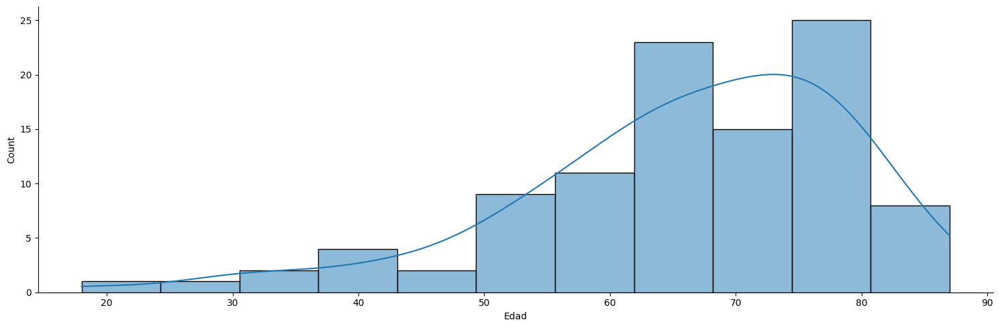

In [8]:
#visualizo la edad de los pacientes
sns.displot(data=train, x="Edad", aspect=3, kde=True)

Vemos las posibles clases de cada columna

In [ ]:
# obtenemos valores únicos de cada columna
for columna in train.columns:
    print(f"Columna: {columna}")
    print(train[columna].unique())  # Valores únicos
    print("-" * 50)  # Separador para imprimir

Columna: Id_paciente
['1MASh' '2HENX' '3HENX' '4HLSh' '5HANX' '6MASN' '7MPNX' '8HENX' '9MANX'
 '10MANX' '11HASh' '12HNSN' '13HANX' '14MLNX' '15MANX' '16HLNX' '17MANX'
 '18MANX' '19MANX' '20MMNX' '21MMiNX' '22MTNX' '23MMNX' '24MANX' '25HTNX'
 '26HMNX' '27HASD' '28HCGNX' '29HMeSX' '30MANX' '31MGNX' '32HENX' '33MANX'
 '34MASN' '35HENX' '36HENX' '37HPNX' '38HANX' '39MFNX' '40HANX' '41HAsNX'
 '42HNnNX' '43HESH' '44MTmNX' '45HNeSN' '46HANX' '47HESN' '48HTtSN'
 '49MMiSN' '50HANX' '51HFNX' '52HLNX' '53HANX' '54HANX' '55HASN' '56MANX'
 '57HTneNX' '58MASH' '59MMiNX' '60HESN' '61HASN' '62HENX' '63MESH'
 '64MESH' '65HANX' '66HBSN' '67HCnpNX' '68MANX' '69MCnpSN' '70HENX'
 '71MTmNX' '72MASH' '73MASN' '74HCeNX' '75HCeNX' '76HASNH' '77MXSH'
 '78MASN' '79MMSN' '80HXSN' '81HXSN' '82HASN' '83MESN' '84HASH' '85HASN'
 '86HANX' '87MASSN' '88HASH' '89HESH' '90HXNX' '91HASN' '92MASN' '93HESN'
 '94HCNSN' '95HASH' '96HESH' '97HASN' '98HESN' '99MASH' '100HNnSNH'
 '101HNnSN']
-------------------------------------

Limpiamos los datos y aplicamos preprocesamiento multietiqueta porque en tipo de complicacion, riesgo y patoloǵia pulmonar pueden darse varios a la vez. 

In [10]:
from sklearn.preprocessing import MultiLabelBinarizer

def procesar_columna_multietiqueta(df, columna, nombre_sin=None, reemplazos=None):
    df = df.copy()
    if reemplazos:
        for k, v in reemplazos.items():
            df[columna] = df[columna].str.replace(k, v)

    # Convertimos X en etiqueta explícita: son complicacion
    df[columna] = df[columna].fillna("X").replace("X", nombre_sin).str.strip()
    df[columna] = df[columna].str.replace(r"\s*,\s*", ",", regex=True)

    etiquetas_ordenadas = df[columna].apply(
        lambda x: sorted(set(x.split(","))) if x else [nombre_sin]
    )

    mlb = MultiLabelBinarizer()
    etiquetas_bin = pd.DataFrame(
        mlb.fit_transform(etiquetas_ordenadas),
        columns=[col.replace(" ", "_") for col in mlb.classes_],
        index=df.index
    )

    return pd.concat([df.drop(columns=[columna]), etiquetas_bin], axis=1), mlb.classes_


In [11]:
train, etiquetas_comp = procesar_columna_multietiqueta(train, "Tipo de complicación", nombre_sin="Sin complicación")
train, etiquetas_riesgo = procesar_columna_multietiqueta(train, "Factor de riesgo", nombre_sin="Sin factor de riesgo")
train, etiquetas_pato = procesar_columna_multietiqueta(train, "Patología pulmonar", nombre_sin="Sin patología pulmonar")

In [12]:
train

,Id_paciente,Sexo,Edad,Complicación,Derrame_pleural_leve,Hemorragia,Hemorragia_leve,Neumotórax,Sin_complicación,AAS,...,Enfisema_panacinar,Enfisema_paraseptal,Fibrosis_pulmonar,Fibrosis_pulmonar_idiopática,Hipertensión_pulmonar,Neoplasia_pulmonar_primaria,Neumoconiosis_con_fibrosis_pulmonar,Neumonía,Neumopatía_intersticial,Sin_patología_pulmonar
0,1MASh,Mujer,77,Sí,0,0,1,0,0,1,...,0,0,0,0,0,0,0,0,0,1
1,2HENX,Hombre,61,No,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,1
2,3HENX,Hombre,84,No,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,1
3,4HLSh,Hombre,31,Sí,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,1
4,5HANX,Hombre,62,No,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
96,97HASN,Hombre,78,Sí,0,0,0,1,0,0,...,0,0,0,0,0,0,0,0,0,1
97,98HESN,Hombre,60,Sí,0,0,0,1,0,0,...,0,0,0,0,0,0,0,0,0,1
98,99MASH,Mujer,51,Sí,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
99,100HNnSNH,Hombre,76,Sí,0,1,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0


Verifcamos los datos perdidos

In [ ]:
# verificamos valores perdidos
valores_perdidos = train.isnull().sum()
print("Valores perdidos por columna:")
print(valores_perdidos)

Valores perdidos por columna:
Id_paciente                            0
Sexo                                   0
Edad                                   0
Complicación                           0
Derrame_pleural_leve                   0
                                      ..
Neoplasia_pulmonar_primaria            0
Neumoconiosis_con_fibrosis_pulmonar    0
Neumonía                               0
Neumopatía_intersticial                0
Sin_patología_pulmonar                 0
Length: 61, dtype: int64


Vamos a normalizar la edad usando MinMaxScaler. 

In [ ]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler() #cramos un scaler
train["Edad"] = scaler.fit_transform(train[["Edad"]]) #reemplazamos la edad por ya la normalizada

# vemos el DataFrame después de la normalización
print(train.head())

  Id_paciente    Sexo      Edad Complicación  Derrame_pleural_leve  \
0       1MASh   Mujer  0.855072           Sí                     0   
1       2HENX  Hombre  0.623188           No                     0   
2       3HENX  Hombre  0.956522           No                     0   
3       4HLSh  Hombre  0.188406           Sí                     0   
4       5HANX  Hombre  0.637681           No                     0   

   Hemorragia  Hemorragia_leve  Neumotórax  Sin_complicación  AAS  ...  \
0           0                1           0                 0    1  ...   
1           0                0           0                 1    0  ...   
2           0                0           0                 1    0  ...   
3           0                1           0                 0    0  ...   
4           0                0           0                 1    0  ...   

   Enfisema_panacinar  Enfisema_paraseptal  Fibrosis_pulmonar  \
0                   0                    0                  0   
1   

Lo guardamos en un csv para poder coger los datos directamente con el multilabel hecho: 

In [15]:
train.to_csv("./datos_clinicos/datos_clinicos_procesados.csv", index=False)

Pasamos a binaria la etiqueta

In [ ]:
# cargamos datos
df = pd.read_csv("./datos_clinicos/datos_clinicos_procesados.csv")

# eliminamos columnas que indican el tipo de complicación 
tipo_complicacion_cols = [
    "Derrame_pleural_leve", "Hemorragia", "Hemorragia_leve",
    "Neumotórax", "Sin_complicación"
]
df.drop(columns=tipo_complicacion_cols, inplace=True, errors="ignore")

# convertimos la columna 'Complicación' a binaria 
df["Complicacion_binaria"] = df["Complicación"].map({"Sí": 1, "No": 0})

#  eliminar la original si ya no se necesita 
df.drop(columns=["Complicación"], inplace=True)

# Guardar el dataframe limpio
df.to_csv("./datos_clinicos/datos_clinicos_limpio.csv", index=False)

## Definición de carpetas y particiones (común)

In [8]:
import warnings
warnings.filterwarnings("ignore")

In [8]:
device = "cuda" if torch.cuda.is_available() else "cpu"

In [ ]:
# creamos un diccionario que mapee Id_paciente a Complicación
labels_dict = dict(zip(train['Id_paciente'], train['Complicación']))
labels_dict

{'1MASh': 'Sí',
 '2HENX': 'No',
 '3HENX': 'No',
 '4HLSh': 'Sí',
 '5HANX': 'No',
 '6MASN': 'Sí',
 '7MPNX': 'No',
 '8HENX': 'No',
 '9MANX': 'No',
 '10MANX': 'No',
 '11HASh': 'Sí',
 '12HNSN': 'Sí',
 '13HANX': 'No',
 '14MLNX': 'No',
 '15MANX': 'No',
 '16HLNX': 'No',
 '17MANX': 'No',
 '18MANX': 'No',
 '19MANX': 'No',
 '20MMNX': 'No',
 '21MMiNX': 'No',
 '22MTNX': 'No',
 '23MMNX': 'No',
 '24MANX': 'No',
 '25HTNX': 'No',
 '26HMNX': 'No',
 '27HASD': 'Sí',
 '28HCGNX': 'No',
 '29HMeSX': 'Sí',
 '30MANX': 'No',
 '31MGNX': 'No',
 '32HENX': 'No',
 '33MANX': 'No',
 '34MASN': 'Sí',
 '35HENX': 'No',
 '36HENX': 'No',
 '37HPNX': 'No',
 '38HANX': 'No',
 '39MFNX': 'No',
 '40HANX': 'No',
 '41HAsNX': 'No',
 '42HNnNX': 'No',
 '43HESH': 'Sí',
 '44MTmNX': 'No',
 '45HNeSN': 'Sí',
 '46HANX': 'No',
 '47HESN': 'Sí',
 '48HTtSN': 'Sí',
 '49MMiSN': 'Sí',
 '50HANX': 'No',
 '51HFNX': 'No',
 '52HLNX': 'No',
 '53HANX': 'No',
 '54HANX': 'No',
 '55HASN': 'Sí',
 '56MANX': 'No',
 '57HTneNX': 'No',
 '58MASH': 'Sí',
 '59MMiNX': 

In [ ]:
unique_labels = set(labels_dict.values())
print(f"Labels únicas: {unique_labels}")

# convertimos a numérico
labels_dict_numeric = {k: 1 if v.lower() in ['sí', 'si', 'yes', '1', 'true'] else 0 
                      for k, v in labels_dict.items()}

unique_labels_numeric = set(labels_dict_numeric.values())
print(f"Labels únicas: {unique_labels_numeric}")


Labels únicas: {'No', 'Sí'}
Labels únicas: {0, 1}


In [15]:
#vamos a contar cuantos tienen complicaciones y cuántos no
complicaciones_count = sum(labels_dict_numeric.values())
no_complicaciones_count = len(labels_dict_numeric) - complicaciones_count

print(f"Pacientes con complicaciones: {complicaciones_count}")
print(f"Pacientes sin complicaciones: {no_complicaciones_count}")

Pacientes con complicaciones: 47
Pacientes sin complicaciones: 53


In [ ]:
#datos
root_path = "./datos_anonimizados/"  
patient_dirs = [os.path.join(root_path, d) for d in os.listdir(root_path) if os.path.isdir(os.path.join(root_path, d))]


## Lectura de imágenes y preprocesamiento 3D

Procesando Paciente: Anónimo (ID: 10MANX), Carpeta: 10MANX, Volume shape: (768, 768, 292)


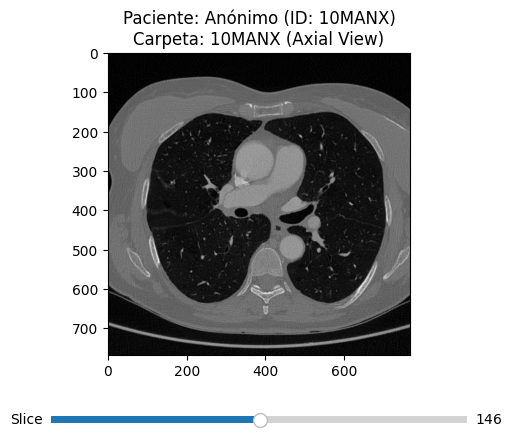

Procesando Paciente: Anónimo (ID: 11HASh), Carpeta: 11HASh, Volume shape: (512, 512, 223)


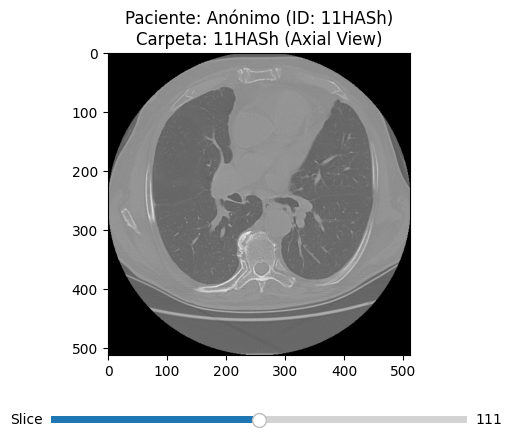

Procesando Paciente: Anónimo (ID: 12HNSN), Carpeta: 12HNSN, Volume shape: (768, 768, 364)


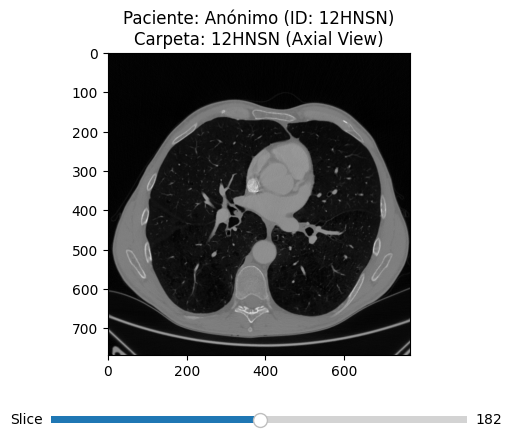

Procesando Paciente: Anónimo (ID: 13HANX), Carpeta: 13HANX, Volume shape: (512, 512, 259)


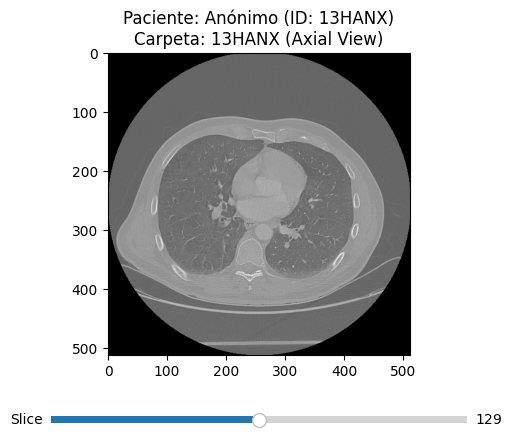

Procesando Paciente: Anónimo (ID: 15MANX), Carpeta: 15MANX, Volume shape: (512, 512, 229)


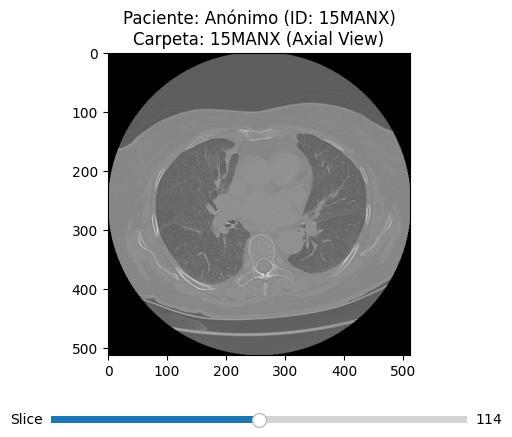

Procesando Paciente: Anónimo (ID: 16HLNX), Carpeta: 16HLNX, Volume shape: (768, 768, 300)


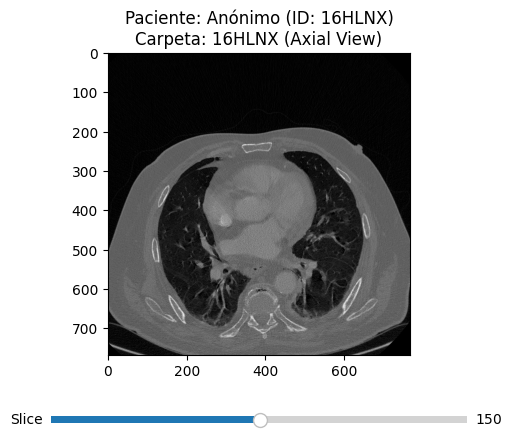

Procesando Paciente: Anónimo (ID: 17MANX), Carpeta: 17MANX, Volume shape: (512, 512, 220)


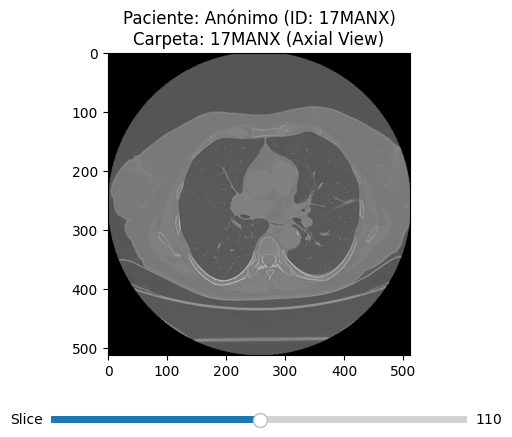

Procesando Paciente: Anónimo (ID: 18MANX), Carpeta: 18MANX, Volume shape: (512, 512, 215)


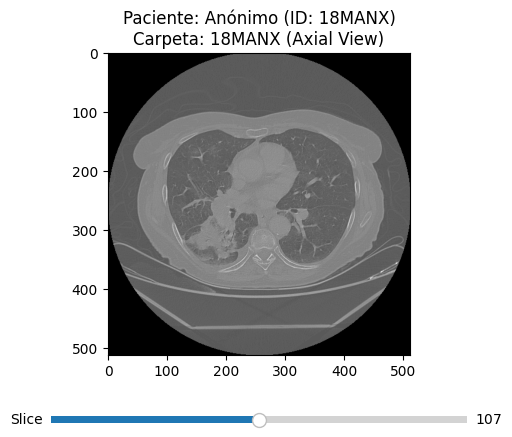

Procesando Paciente: Anónimo (ID: 19MANX), Carpeta: 19MANX, Volume shape: (512, 512, 67)


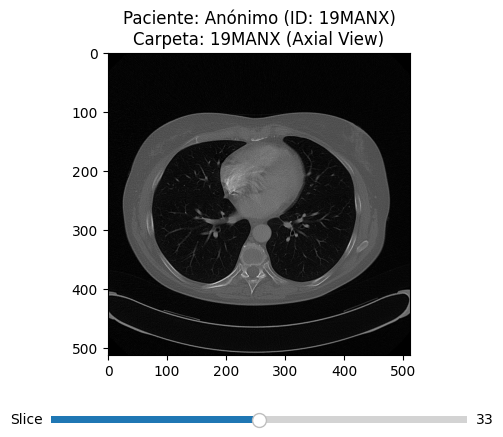

Procesando Paciente: Anónimo (ID: 1MASh), Carpeta: 1MASh, Volume shape: (768, 768, 271)


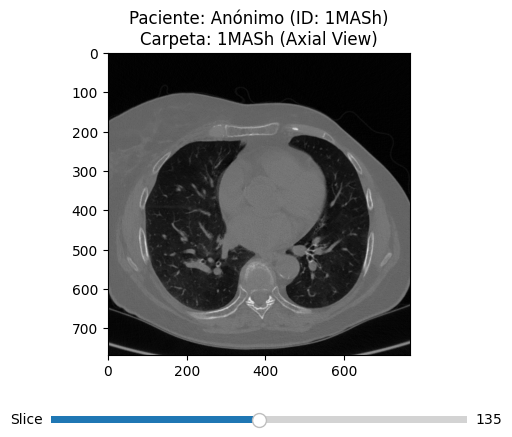

Procesando Paciente: Anónimo (ID: 22MTNX), Carpeta: 22MTNX, Volume shape: (768, 768, 545)


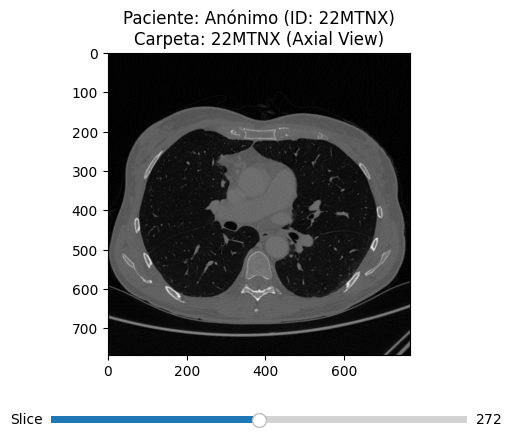

Procesando Paciente: Anónimo (ID: 23MMNX), Carpeta: 23MMNX, Volume shape: (512, 512, 231)


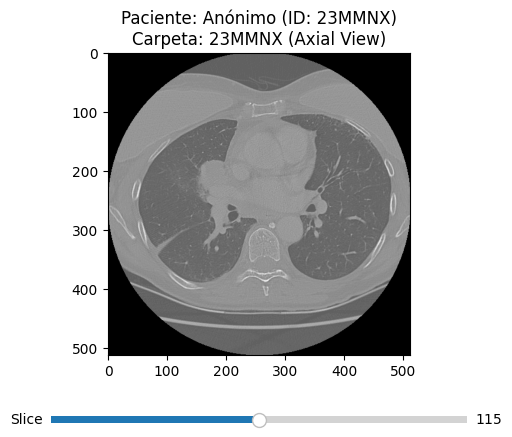

Procesando Paciente: Anónimo (ID: 24MANX), Carpeta: 24MANX, Volume shape: (768, 768, 54)


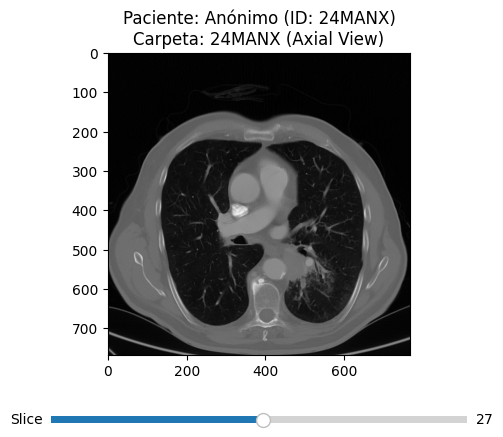

Procesando Paciente: Anónimo (ID: 25HTNX), Carpeta: 25HTNX, Volume shape: (512, 512, 208)


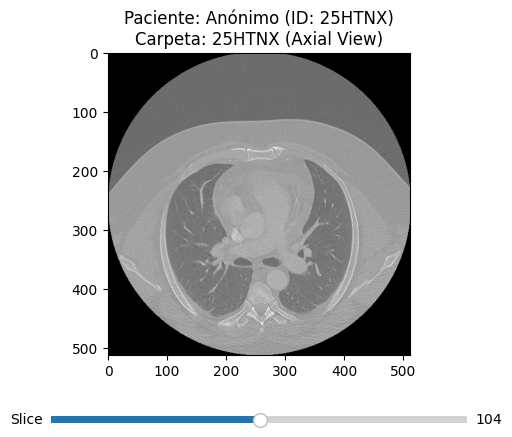

Procesando Paciente: Anónimo (ID: 26HMNX), Carpeta: 26HMNX, Volume shape: (768, 768, 301)


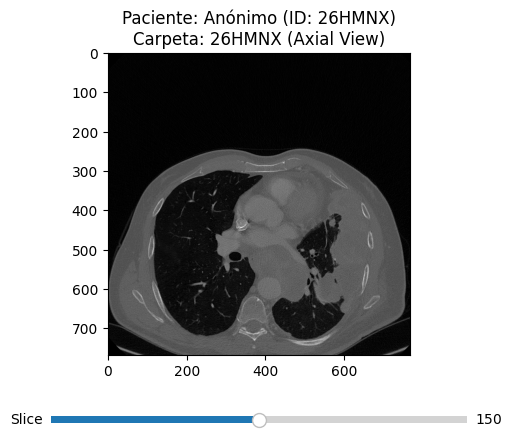

Procesando Paciente: Anónimo (ID: 27HASD), Carpeta: 27HASD, Volume shape: (768, 768, 291)


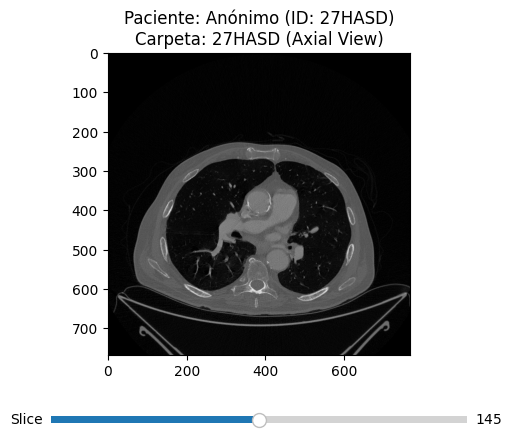

Procesando Paciente: Anónimo (ID: 28HCGNX), Carpeta: 28HCGNX, Volume shape: (768, 768, 327)


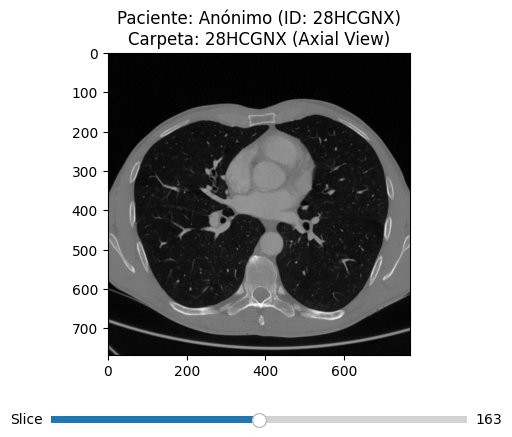

Procesando Paciente: Anónimo (ID: 29HMeSX), Carpeta: 29HMeSX, Volume shape: (768, 768, 2)


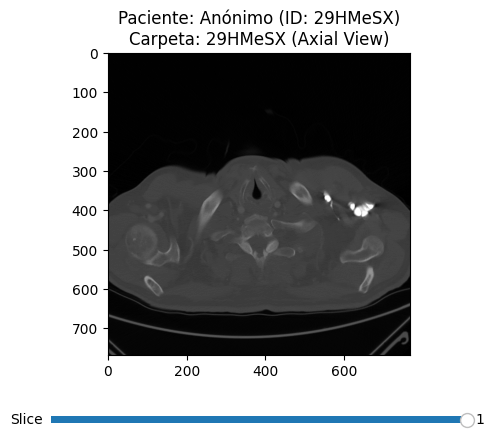

Procesando Paciente: Anónimo (ID: 2HENX), Carpeta: 2HENX, Volume shape: (768, 768, 296)


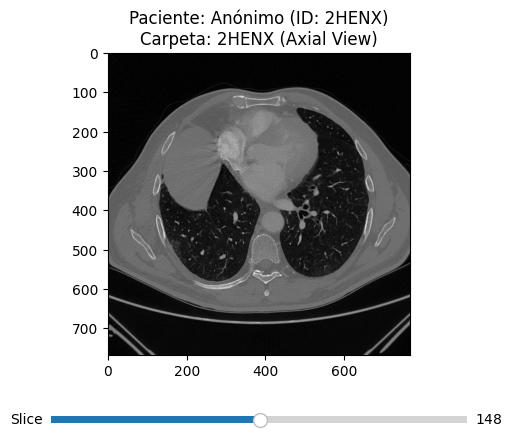

Procesando Paciente: Anónimo (ID: 30MANX), Carpeta: 30MANX, Volume shape: (768, 768, 2)


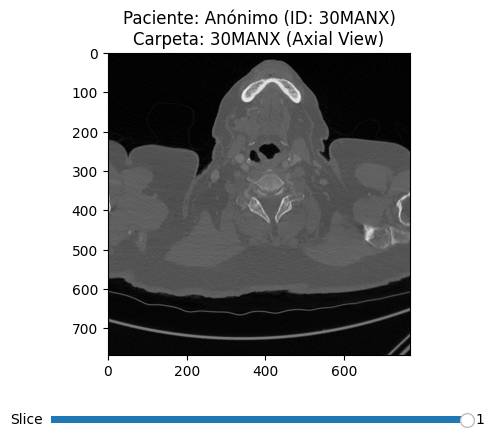

Procesando Paciente: Anónimo (ID: 31MGNX), Carpeta: 31MGNX, Volume shape: (512, 512, 463)


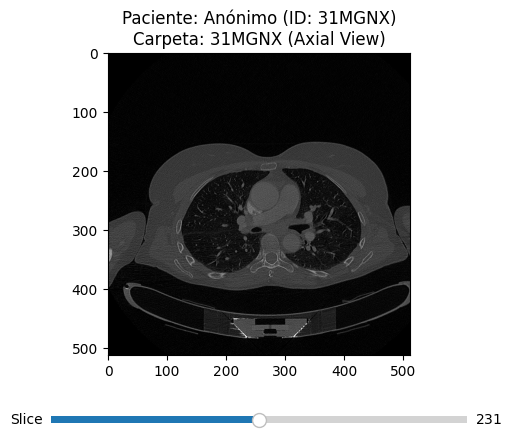

Procesando Paciente: Anónimo (ID: 32HENX), Carpeta: 32HENX, Volume shape: (512, 512, 328)


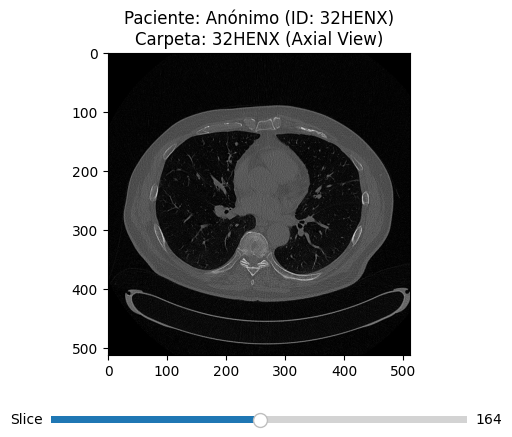

Procesando Paciente: Anónimo (ID: 33MANX), Carpeta: 33MANX, Volume shape: (768, 768, 609)


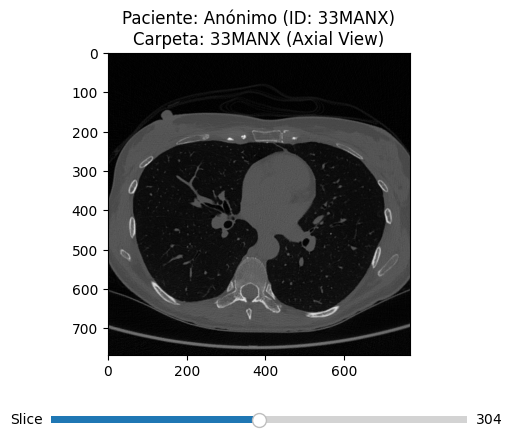

Procesando Paciente: Anónimo (ID: 34MASN), Carpeta: 34MASN, Volume shape: (512, 512, 222)


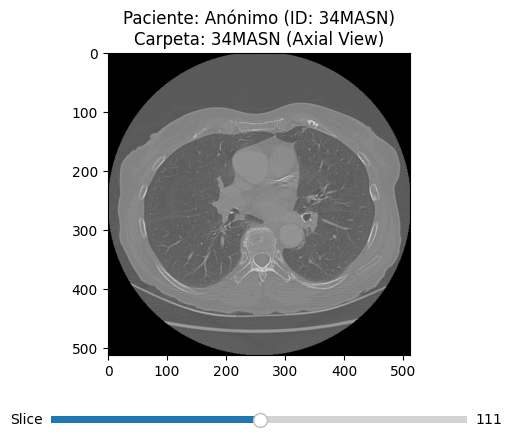

Procesando Paciente: Anónimo (ID: 35HENX), Carpeta: 35HENX, Volume shape: (768, 768, 286)


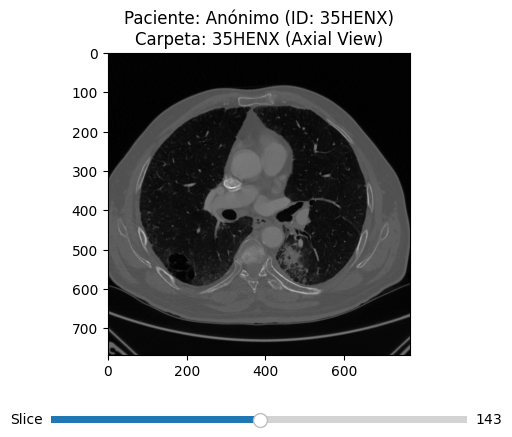

Procesando Paciente: Anónimo (ID: 36HENX), Carpeta: 36HENX, Volume shape: (768, 768, 51)


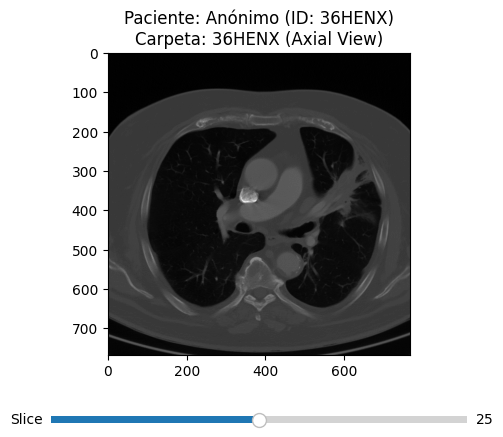

Procesando Paciente: Anónimo (ID: 37HPNX), Carpeta: 37HPNX, Volume shape: (768, 768, 290)


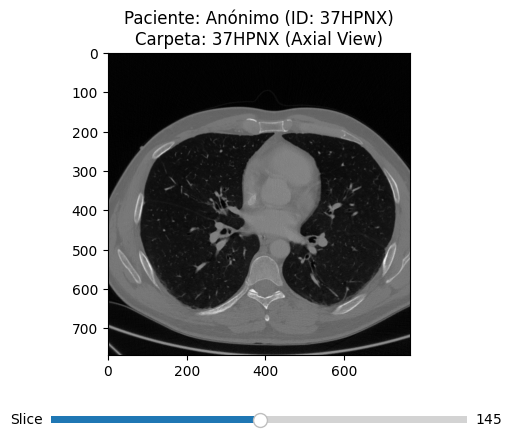

Procesando Paciente: Anónimo (ID: 38HANX), Carpeta: 38HANX, Volume shape: (512, 512, 473)


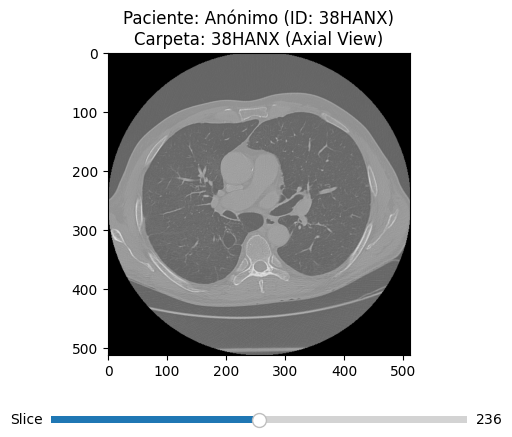

Procesando Paciente: Anónimo (ID: 39MFNX), Carpeta: 39MFNX, Volume shape: (768, 768, 285)


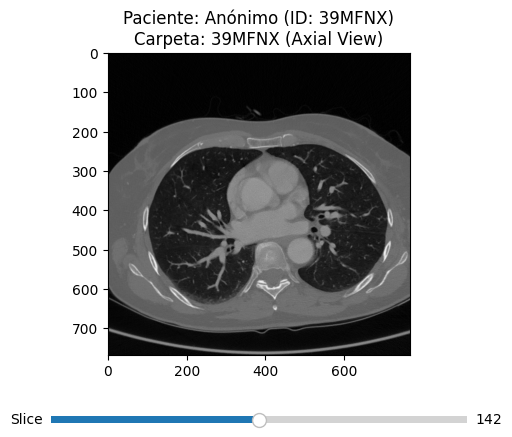

Procesando Paciente: Anónimo (ID: 3HENX), Carpeta: 3HENX, Volume shape: (768, 768, 303)


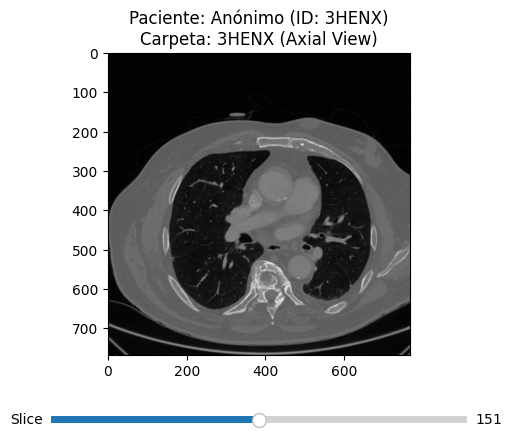

Procesando Paciente: Anónimo (ID: 40HANX), Carpeta: 40HANX, Volume shape: (512, 512, 488)


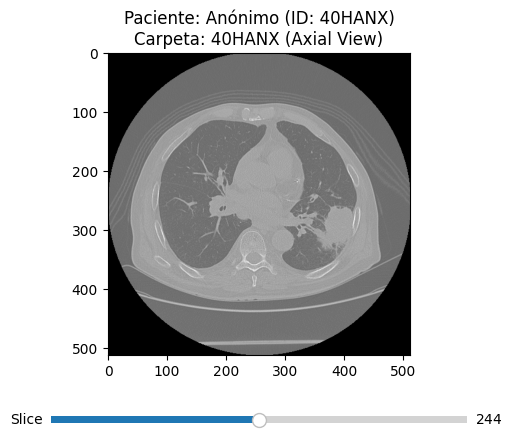

Procesando Paciente: Anónimo (ID: 41HAsNX), Carpeta: 41HAsNX, Volume shape: (512, 512, 174)


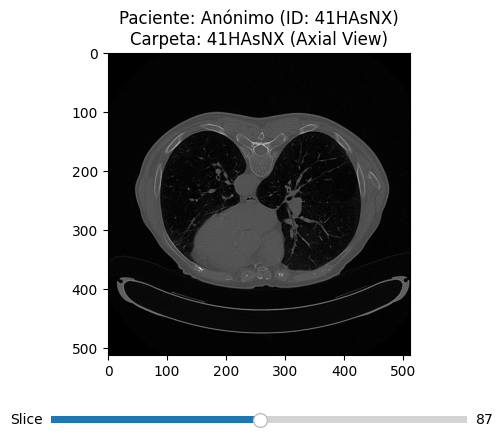

Procesando Paciente: Anónimo (ID: 42HNnNX), Carpeta: 42HNnNX, Volume shape: (512, 512, 151)


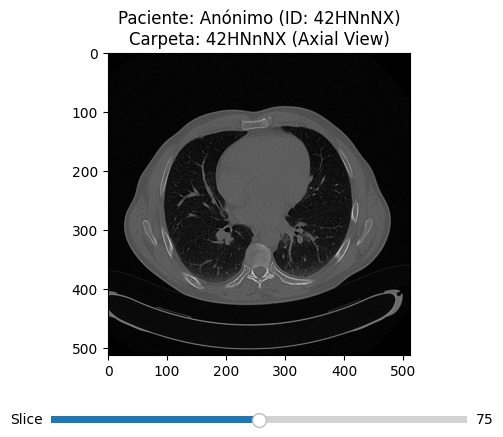

Procesando Paciente: Anónimo (ID: 43HESH), Carpeta: 43HESH, Volume shape: (512, 512, 225)


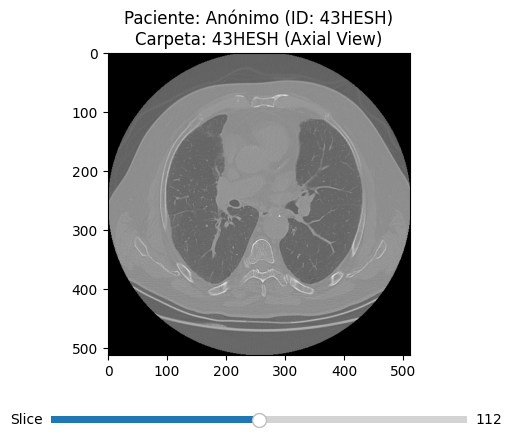

Procesando Paciente: Anónimo (ID: 45HNeSN), Carpeta: 45HNeSN, Volume shape: (768, 768, 285)


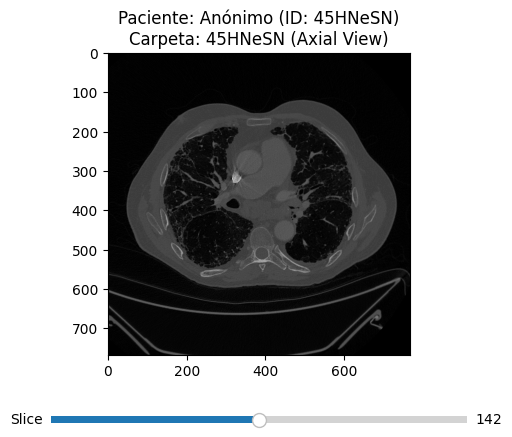

Procesando Paciente: Anónimo (ID: 46HANX), Carpeta: 46HANX, Volume shape: (512, 512, 155)


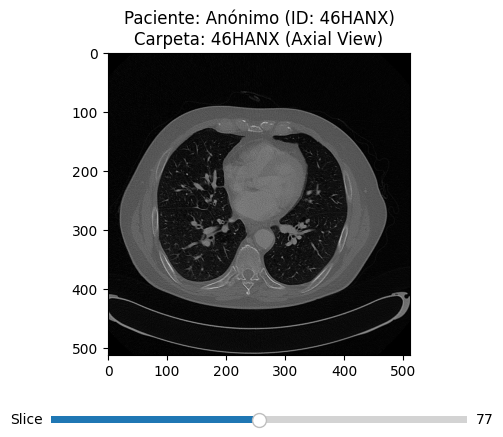

Procesando Paciente: Anónimo (ID: 47HESN), Carpeta: 47HESN, Volume shape: (768, 768, 319)


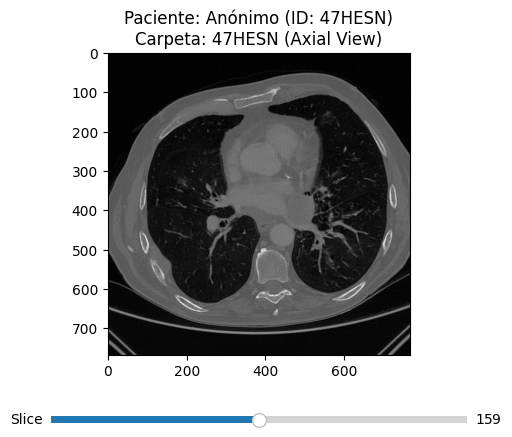

Procesando Paciente: Anónimo (ID: 48HTtSN), Carpeta: 48HTtSN, Volume shape: (512, 512, 155)


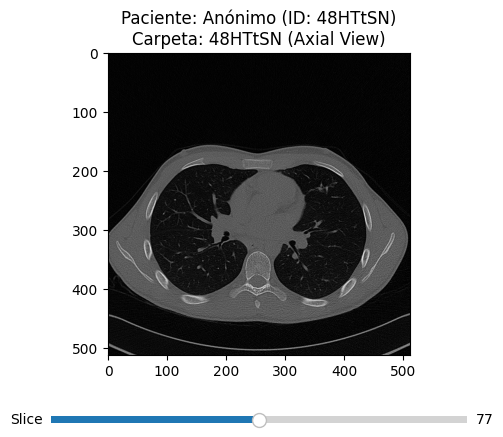

Procesando Paciente: Anónimo (ID: 4HLSh), Carpeta: 4HLSh, Volume shape: (768, 768, 320)


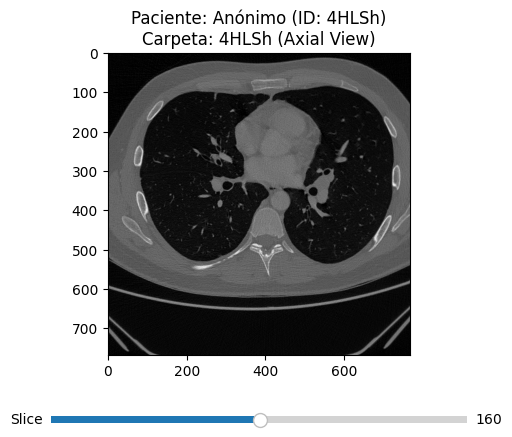

Procesando Paciente: Anónimo (ID: 50HANX), Carpeta: 50HANX, Volume shape: (768, 768, 44)


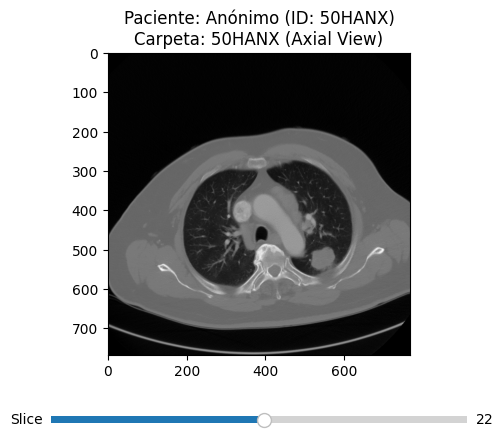

Procesando Paciente: Anónimo (ID: 51HFNX), Carpeta: 51HFNX, Volume shape: (768, 768, 295)


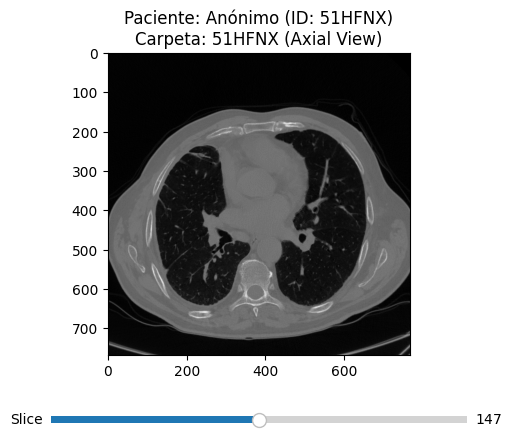

Procesando Paciente: Anónimo (ID: 52HLNX), Carpeta: 52HLNX, Volume shape: (512, 512, 222)


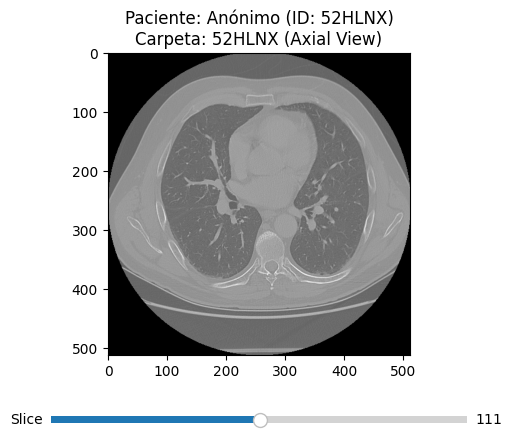

Procesando Paciente: Anónimo (ID: 53HANX), Carpeta: 53HANX, Volume shape: (512, 512, 497)


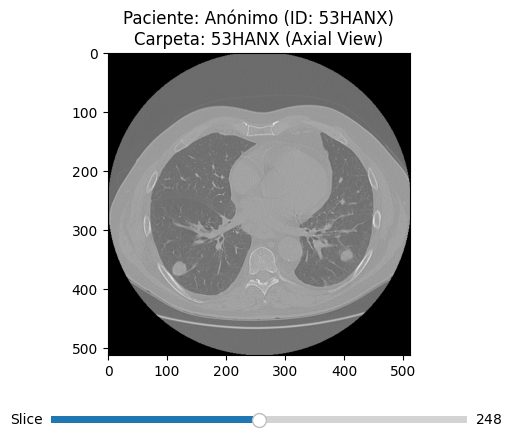

Procesando Paciente: Anónimo (ID: 54HANX), Carpeta: 54HANX, Volume shape: (768, 768, 321)


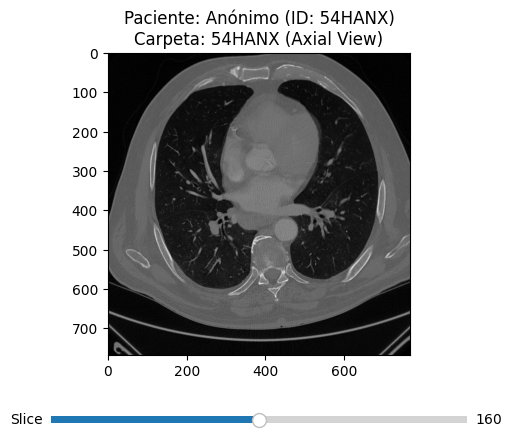

Procesando Paciente: Anónimo (ID: 55HASN), Carpeta: 55HASN, Volume shape: (512, 512, 39)


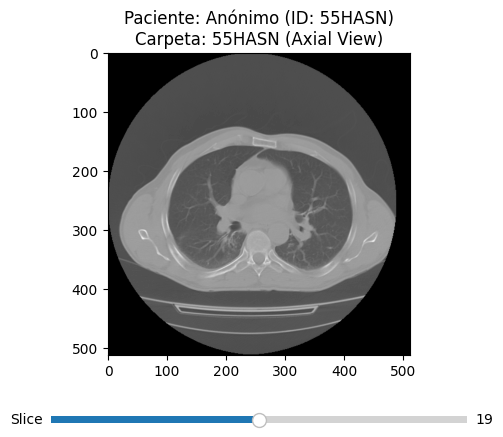

Procesando Paciente: Anónimo (ID: 56MANX), Carpeta: 56MANX, Volume shape: (768, 768, 297)


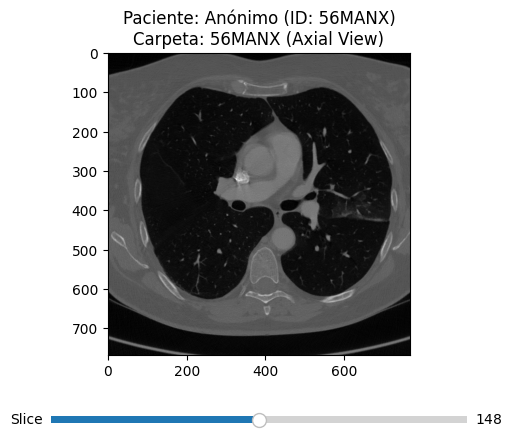

Procesando Paciente: Anónimo (ID: 57HTneNX), Carpeta: 57HTneNX, Volume shape: (512, 512, 317)


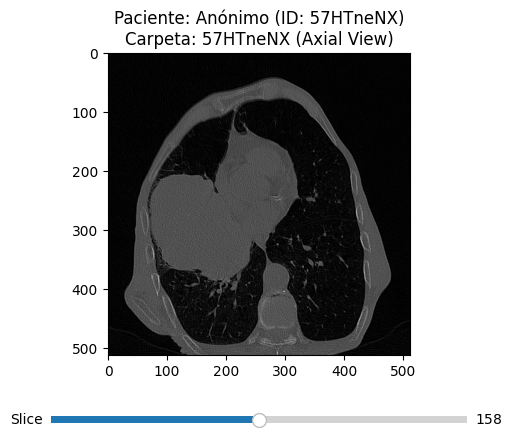

Procesando Paciente: Anónimo (ID: 58MASH), Carpeta: 58MASH, Volume shape: (512, 512, 267)


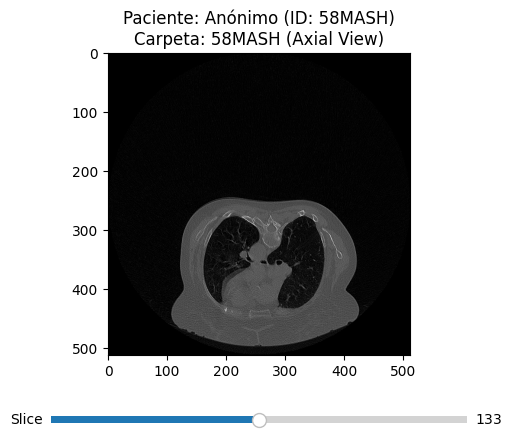

Procesando Paciente: Anónimo (ID: 59MMiNX), Carpeta: 59MMiNX, Volume shape: (512, 512, 146)


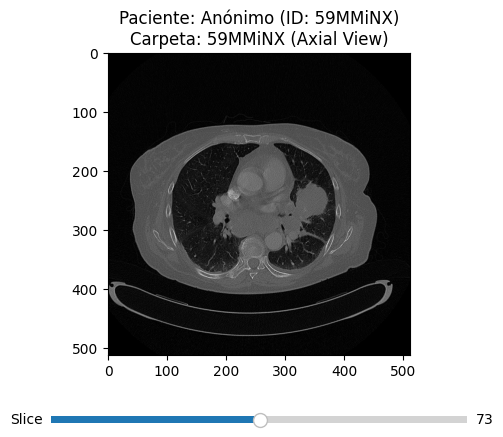

Procesando Paciente: Anónimo (ID: 5HANX), Carpeta: 5HANX, Volume shape: (512, 512, 272)


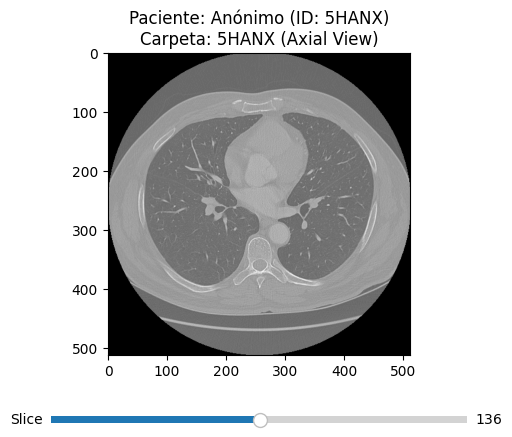

Procesando Paciente: Anónimo (ID: 60HESN), Carpeta: 60HESN, Volume shape: (768, 768, 276)


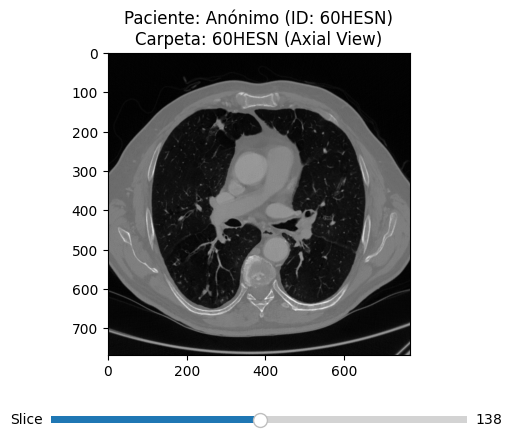

Procesando Paciente: Anónimo (ID: 6MASN), Carpeta: 6MASN, Volume shape: (512, 512, 578)


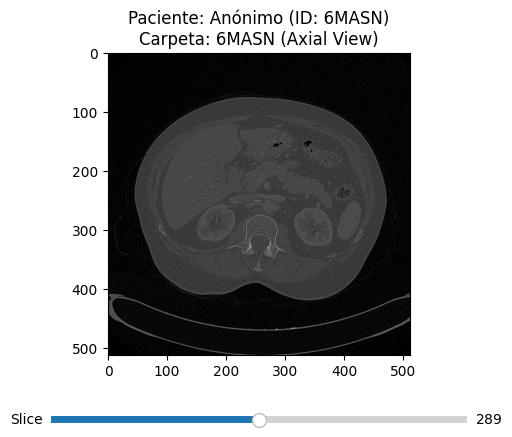

Procesando Paciente: Anónimo (ID: 7MPNX), Carpeta: 7MPNX, Volume shape: (512, 512, 270)


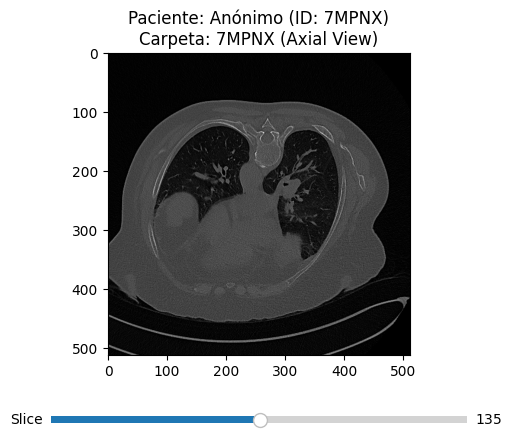

Procesando Paciente: Anónimo (ID: 8HENX), Carpeta: 8HENX, Volume shape: (768, 768, 366)


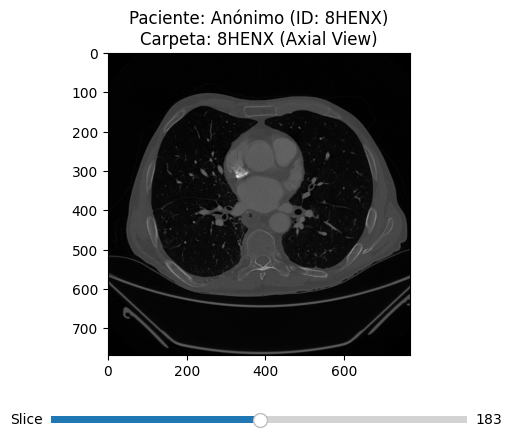

Procesando Paciente: Anónimo (ID: 9MANX), Carpeta: 9MANX, Volume shape: (512, 512, 255)


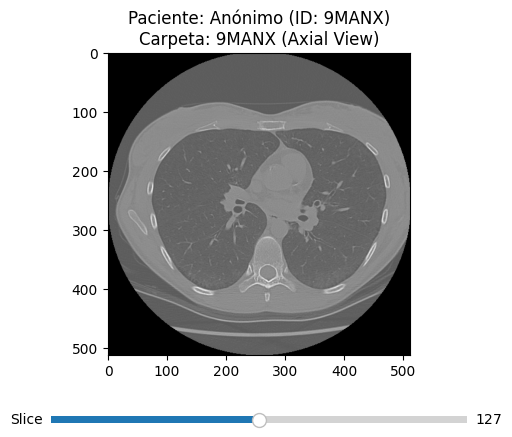

Procesando Paciente: Anónimo (ID: 14MLNX), Carpeta: 14MLNX, Volume shape: (768, 768, 741)


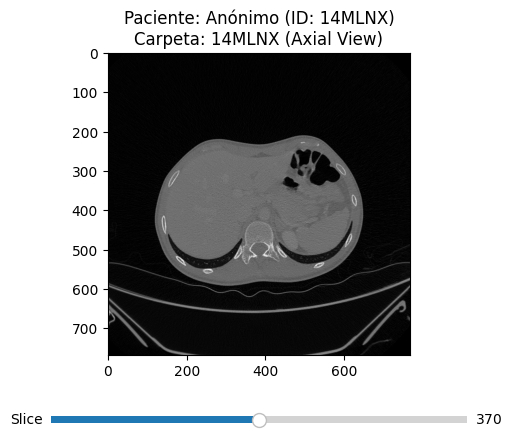

Procesando Paciente: Anónimo (ID: 20MMNX), Carpeta: 20MMNX, Volume shape: (512, 512, 232)


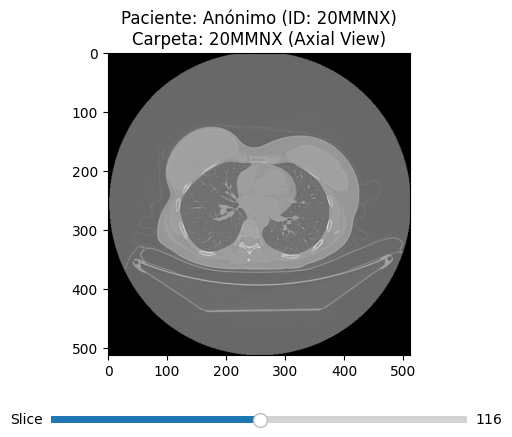

Procesando Paciente: Anónimo (ID: 21MMiNX), Carpeta: 21MMiNX, Volume shape: (768, 768, 255)


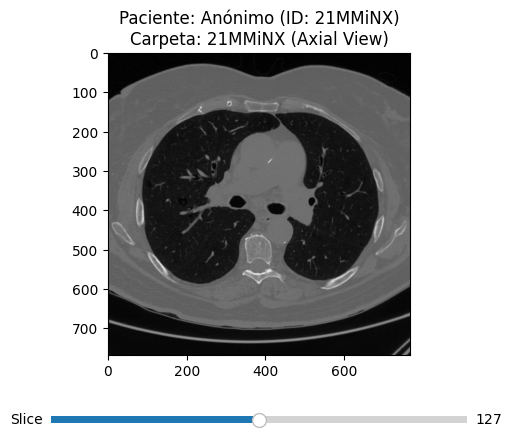

Procesando Paciente: Anónimo (ID: 44MTmNX), Carpeta: 44MTmNX, Volume shape: (768, 768, 288)


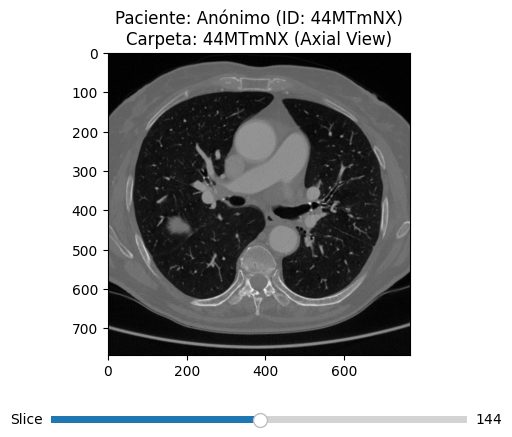

Procesando Paciente: Anónimo (ID: 49MMiSN), Carpeta: 49MMiSN, Volume shape: (768, 768, 195)


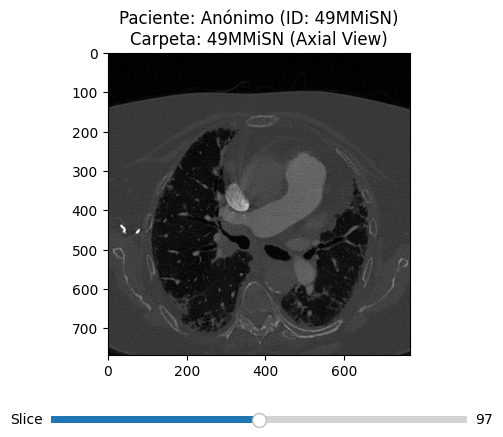

Procesando Paciente: Anónimo (ID: 61HASN), Carpeta: 61HASN, Volume shape: (512, 512, 298)


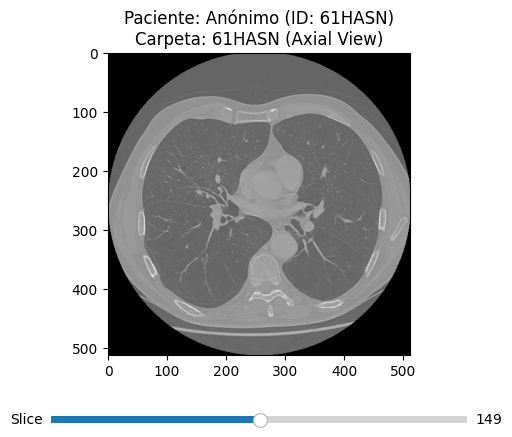

Procesando Paciente: Anónimo (ID: 62HENX), Carpeta: 62HENX, Volume shape: (512, 512, 184)


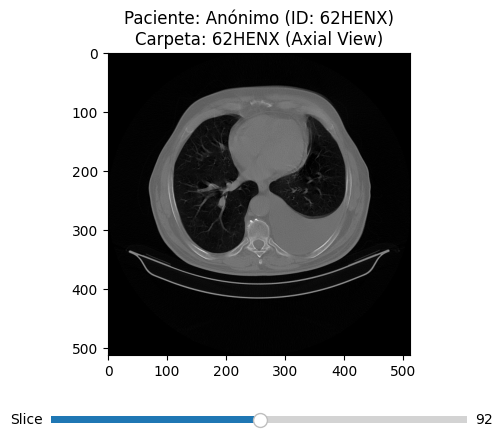

Procesando Paciente: Anónimo (ID: 63MESH), Carpeta: 63MESH, Volume shape: (512, 512, 151)


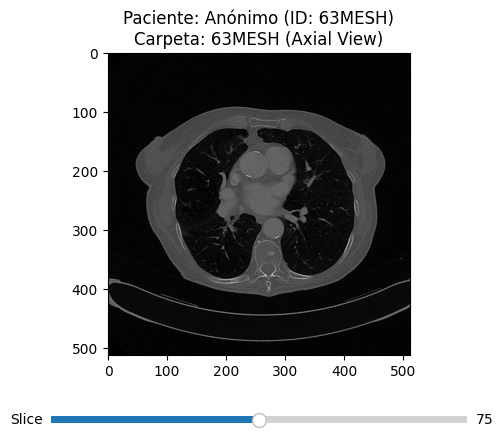

Procesando Paciente: Anónimo (ID: 65HANX), Carpeta: 65HANX, Volume shape: (768, 768, 307)


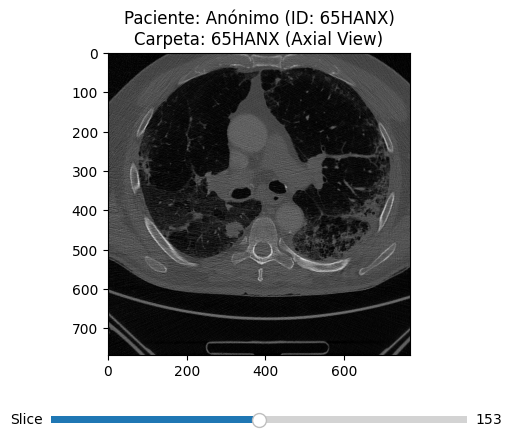

Procesando Paciente: Anónimo (ID: 66HBSN), Carpeta: 66HBSN, Volume shape: (768, 768, 451)


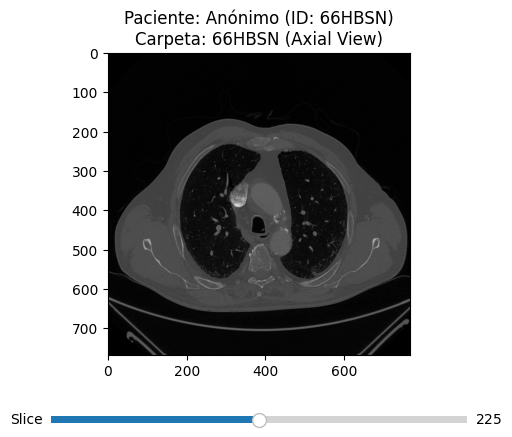

Procesando Paciente: Anónimo (ID: 67HCnpNX), Carpeta: 67HCnpNX, Volume shape: (768, 768, 385)


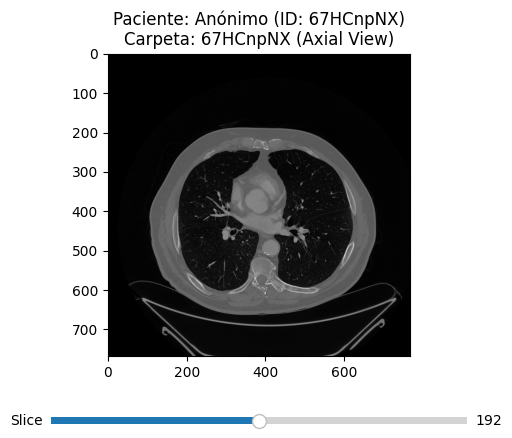

Procesando Paciente: Anónimo (ID: 68MANX), Carpeta: 68MANX, Volume shape: (512, 512, 193)


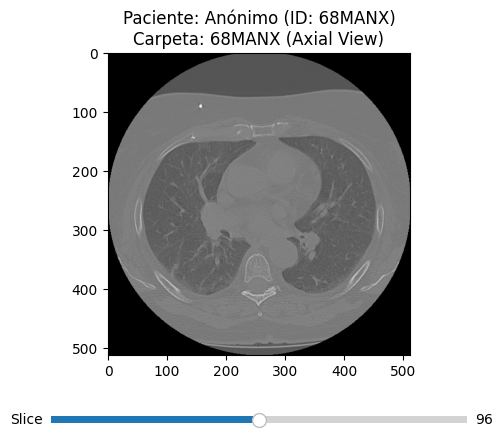

Procesando Paciente: Anónimo (ID: 69MCnpSN), Carpeta: 69MCnpSN, Volume shape: (512, 512, 314)


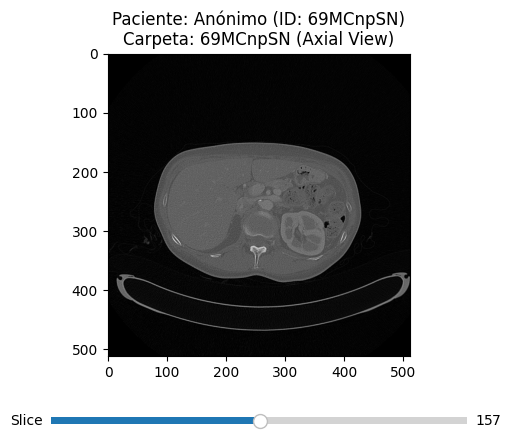

Procesando Paciente: Anónimo (ID: 70HENX), Carpeta: 70HENX, Volume shape: (512, 512, 66)


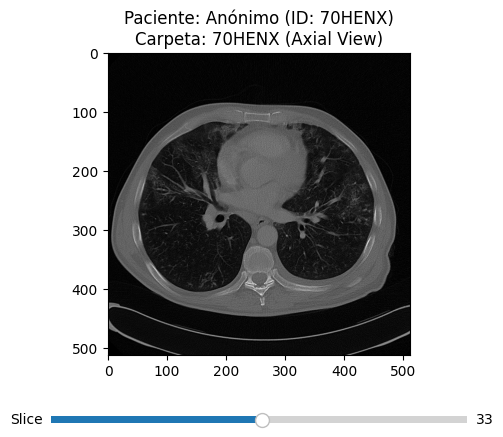

Procesando Paciente: Anónimo (ID: 71MTmNX), Carpeta: 71MTmNX, Volume shape: (768, 768, 336)


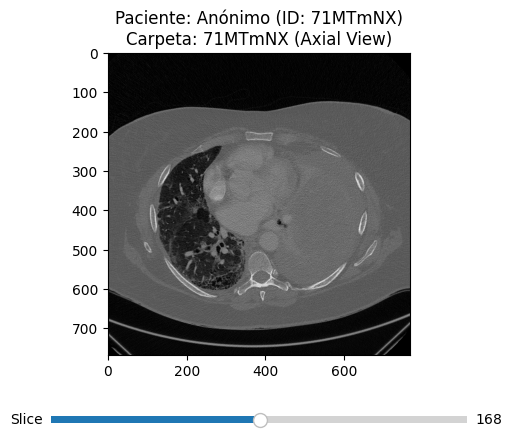

Procesando Paciente: Anónimo (ID: 72MASH), Carpeta: 72MASH, Volume shape: (512, 512, 385)


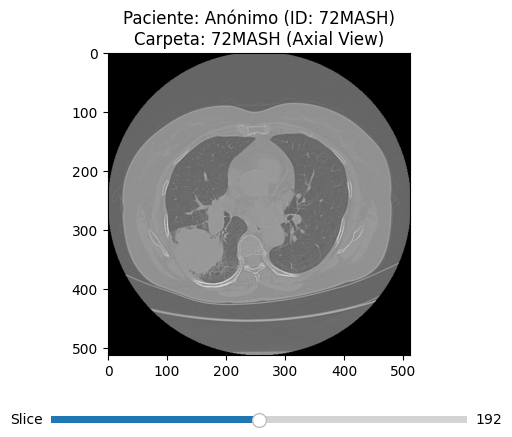

Procesando Paciente: Anónimo (ID: 73MASN), Carpeta: 73MASN, Volume shape: (512, 512, 275)


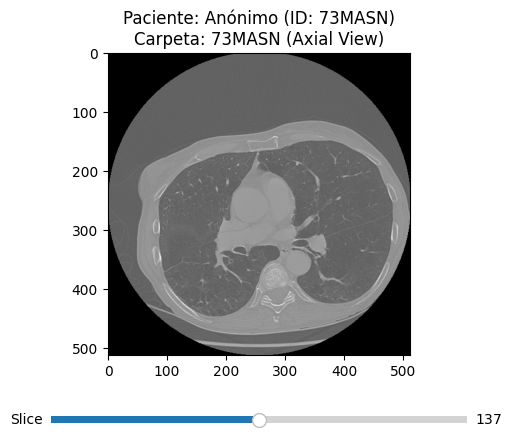

In [20]:
# Lista para almacenar el número de slices por caso
slices_per_case = []

# Iteramos sobre cada carpeta de paciente
for patient_dir in patient_dirs:
    dicom_files = []
    
    # Nombre de la carpeta = ID del paciente
    patient_id = os.path.basename(patient_dir)  # Asignamos el ID de la carpeta al paciente

    # Intentar leer todos los archivos del directorio (sin importar la extensión)
    for filename in os.listdir(patient_dir):
        filepath = os.path.join(patient_dir, filename)
        try:
            # Intentar leer el archivo como DICOM
            ds = dcmread(filepath, force=True)  # force=True permite leer aunque no tenga extensión .dcm (nosotros tenemos dicom pero no tenemos la extension esa)
            dicom_files.append(ds)
        except:
            continue  # Si falla, no es un archivo DICOM válido

    if not dicom_files:
        print(f"No se encontraron archivos DICOM en {patient_dir}. Se omite.")
        continue

    try:
        patient_slices = dicom_files
        patient_name = "Anónimo"  # Ya que está anonimizado

        # Guardar el número de slices para este caso
        slices_per_case.append(len(patient_slices))

        # Ordenar slices por posición en el volumen
        patient_slices = sorted(patient_slices, key=lambda s: getattr(s, "SliceLocation", 0))

        # Crear volumen 3D
        volume = np.stack([s.pixel_array for s in patient_slices], axis=2)

        # Mostrar información del volumen
        print(f"Procesando Paciente: {patient_name} (ID: {patient_id}), Carpeta: {patient_id}, Volume shape: {volume.shape}")

        # Mostrar el volumen con slider
        plot_slices(volume, patient_name, patient_id, patient_id)

    except Exception as e:
        print(f"Error al procesar el paciente en {patient_dir}: {e}")


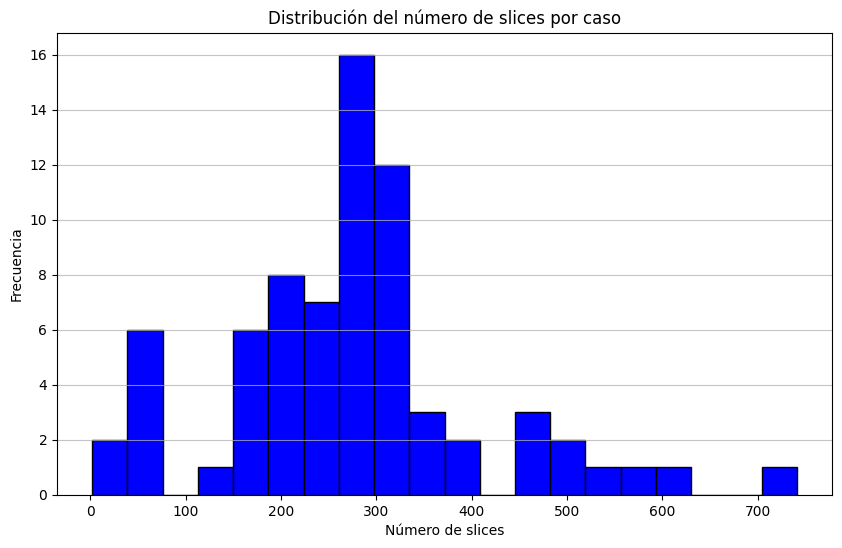

In [ ]:
# creamos el histograma donde vemos las slices que tiene cada dicom
plt.figure(figsize=(10, 6))
plt.hist(slices_per_case, bins=20, color='blue', edgecolor='black')
plt.title("Distribución del número de slices por caso")
plt.xlabel("Número de slices")
plt.ylabel("Frecuencia")
plt.grid(axis='y', alpha=0.75)

# monstramos el histograma
plt.show()

In [ ]:
#Vemos cuantas slices tenemos en total 
total_slices = sum(slices_per_case)

# mostramos el resultado
print(f"El número total de slices en todos los casos es: {total_slices}")

El número total de slices en todos los casos es: 19797


En una CNN 3D, los volúmenes de entrada deben tener un tamaño fijo, por lo que no se puede entrenar directamente con pacientes que tienen diferente número de slices. Este es nuestro caso, por lo que tenemos que aplicar alguna técnica para poder arreglar este problema.

Viendo el histograma de número de slices por pacientes, voy a empezar por la técnica de poner un número fijo de slices por pacientes. Los pacientes que les sobre slices, nos quedaremos con las centrales donde habrá más información. Los que les falten slices, vamos a hacer interpolación lineal (podriamos probar tambien con la bilineal). 

In [33]:
TARGET_SLICES = 256  # Número fijo de slices por paciente 256

# Lista para almacenar el número de slices por caso
slices_per_case = []

# Iteramos sobre cada carpeta de paciente
for patient_dir in patient_dirs:
    dicom_files = []
    
    # Nombre de la carpeta = IDTARGET_SLICES = 256  # Número fijo de slices por paciente

# Lista para almacenar el número de slices por caso
slices_per_case = []

# Iteramos sobre cada carpeta de paciente
for patient_dir in patient_dirs:
    dicom_files = []
    
    # Nombre de la carpeta = ID del paciente
    patient_id = os.path.basename(patient_dir)

    # Intentar leer todos los archivos del directorio (sin importar la extensión)
    for filename in os.listdir(patient_dir):
        filepath = os.path.join(patient_dir, filename)
        try:
            # Intentar leer el archivo como DICOM
            ds = dcmread(filepath, force=True)
            dicom_files.append(ds)
        except:
            continue  # Si falla, no es un archivo DICOM válido

    if not dicom_files:
        print(f"No se encontraron archivos DICOM en {patient_dir}. Se omite.")
        continue

    try:
        # Guardar el número de slices para este caso
        num_slices = len(dicom_files)
        slices_per_case.append(num_slices)

        # Ordenar los slices por su posición en el volumen
        dicom_files = sorted(dicom_files, key=lambda s: getattr(s, "SliceLocation", 0))

        # Crear volumen 3D
        volume = np.stack([s.pixel_array for s in dicom_files], axis=0)

        # Normalizar el volumen a 256 slices
        if num_slices > TARGET_SLICES:
            # Clipping: Tomamos los 256 centrales
            start = (num_slices - TARGET_SLICES) // 2
            volume = volume[start:start + TARGET_SLICES, :, :]
        
        elif num_slices < TARGET_SLICES:
            # Interpolación: Redimensionamos en el eje Z
            zoom_factor = TARGET_SLICES / num_slices
            volume = scipy.ndimage.zoom(volume, (zoom_factor, 1, 1), order=1)  # Interpolación lineal

        print(f"Paciente ID: {patient_id}, Volumen final: {volume.shape}")

    except Exception as e:
        print(f"Error al procesar el paciente en {patient_dir}: {e} del paciente")
    patient_id = os.path.basename(patient_dir)

    # Intentar leer todos los archivos del directorio (sin importar la extensión)
    for filename in os.listdir(patient_dir):
        filepath = os.path.join(patient_dir, filename)
        try:
            # Intentar leer el archivo como DICOM
            ds = dcmread(filepath, force=True)
            dicom_files.append(ds)
        except:
            continue  # Si falla, no es un archivo DICOM válido

    if not dicom_files:
        print(f"No se encontraron archivos DICOM en {patient_dir}. Se omite.")
        continue

    try:
        # Guardar el número de slices para este caso
        num_slices = len(dicom_files)
        slices_per_case.append(num_slices)

        # Ordenar los slices por su posición en el volumen
        dicom_files = sorted(dicom_files, key=lambda s: getattr(s, "SliceLocation", 0))

        # Crear volumen 3D
        volume = np.stack([s.pixel_array for s in dicom_files], axis=0)

        # Normalizar el volumen a 256 slices
        if num_slices > TARGET_SLICES:
            # Clipping: Tomamos los 256 centrales
            start = (num_slices - TARGET_SLICES) // 2
            volume = volume[start:start + TARGET_SLICES, :, :]
        
        elif num_slices < TARGET_SLICES:
            # Interpolación: Redimensionamos en el eje Z
            zoom_factor = TARGET_SLICES / num_slices
            volume = scipy.ndimage.zoom(volume, (zoom_factor, 1, 1), order=1)  # Interpolación lineal

        print(f"Paciente ID: {patient_id}, Volumen final: {volume.shape}")

    except Exception as e:
        print(f"Error al procesar el paciente en {patient_dir}: {e}")

Paciente ID: 10MANX, Volumen final: (256, 768, 768)
Paciente ID: 10MANX, Volumen final: (256, 768, 768)
Paciente ID: 11HASh, Volumen final: (256, 512, 512)
Paciente ID: 11HASh, Volumen final: (256, 512, 512)
Paciente ID: 12HNSN, Volumen final: (256, 768, 768)
Paciente ID: 12HNSN, Volumen final: (256, 768, 768)
Paciente ID: 13HANX, Volumen final: (256, 512, 512)
Paciente ID: 13HANX, Volumen final: (256, 512, 512)
Paciente ID: 15MANX, Volumen final: (256, 512, 512)
Paciente ID: 15MANX, Volumen final: (256, 512, 512)
Paciente ID: 16HLNX, Volumen final: (256, 768, 768)
Paciente ID: 16HLNX, Volumen final: (256, 768, 768)
Paciente ID: 17MANX, Volumen final: (256, 512, 512)
Paciente ID: 17MANX, Volumen final: (256, 512, 512)
Paciente ID: 18MANX, Volumen final: (256, 512, 512)
Paciente ID: 18MANX, Volumen final: (256, 512, 512)
Paciente ID: 19MANX, Volumen final: (256, 512, 512)
Paciente ID: 19MANX, Volumen final: (256, 512, 512)
Paciente ID: 1MASh, Volumen final: (256, 768, 768)
Paciente ID: 

In [43]:
# Parámetros fijos
TARGET_SLICES = 256
TARGET_SIZE = (512, 512)  # (Altura, Ancho)
HU_MIN, HU_MAX = -1000, 400  # Rango típico para TC de tórax
OUTPUT_DIR = "preprocessed_data_3d"  # Directorio donde se guardarán los volúmenes preprocesados

In [11]:
def preprocess_dicom_volumes(patient_dirs, output_dir=OUTPUT_DIR):
    """Preprocesa volúmenes DICOM y los guarda en un directorio como archivos .npy"""
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)  # Crear el directorio si no existe

    for patient_dir in tqdm(patient_dirs, desc="Procesando pacientes"):
        dicom_files = []
        patient_id = os.path.basename(patient_dir)  # ID del paciente
        
        # Leer archivos DICOM
        for filename in os.listdir(patient_dir):
            filepath = os.path.join(patient_dir, filename)
            try:
                ds = dcmread(filepath, force=True)  # Leer archivo DICOM
                dicom_files.append(ds)
            except:
                continue  # Si falla, ignorar

        if not dicom_files:
            print(f"No se encontraron archivos DICOM en {patient_dir}. Se omite.")
            continue

        try:
            # Ordenar slices por posición en el volumen
            dicom_files = sorted(dicom_files, key=lambda s: getattr(s, "SliceLocation", 0))
            num_slices = len(dicom_files)

            # Crear volumen 3D con píxeles en HU
            volume = np.stack([convert_to_hu(s) for s in dicom_files], axis=0)

            # Ajustar número de slices
            volume = resize_slices(volume, TARGET_SLICES)

            # Redimensionar cada slice a 512x512
            volume = np.array([cv2.resize(slice_, TARGET_SIZE, interpolation=cv2.INTER_LINEAR) for slice_ in volume])

            # Guardar volumen preprocesado
            output_path = os.path.join(output_dir, f"{patient_id}.npy")
            np.save(output_path, volume)

            print(f"Guardado: {output_path}, Shape: {volume.shape}")

        except Exception as e:
            print(f"Error procesando {patient_id}: {e}")

def convert_to_hu(dicom_slice):
    """Convierte una imagen DICOM a Hounsfield Units (HU) con ventana de [-1000, 400]"""
    image = dicom_slice.pixel_array.astype(np.float32)

    # Aplicar Rescale Intercept y Slope
    intercept = dicom_slice.RescaleIntercept if hasattr(dicom_slice, "RescaleIntercept") else 0
    slope = dicom_slice.RescaleSlope if hasattr(dicom_slice, "RescaleSlope") else 1

    if slope != 1:
        image = slope * image.astype(np.float32)
    image += intercept

    # Normalizar en el rango [-1000, 400]
    image = np.clip(image, HU_MIN, HU_MAX)
    image = (image - HU_MIN) / (HU_MAX - HU_MIN)  # Normalizar a [0, 1]

    return image

def resize_slices(volume, target_slices):
    """Ajusta el número de slices a `target_slices` con clipping o interpolación"""
    num_slices = volume.shape[0]
    
    if num_slices > target_slices:
        # Clipping: Tomamos los 256 centrales
        start = (num_slices - target_slices) // 2
        volume = volume[start:start + target_slices, :, :]
    
    elif num_slices < target_slices:
        # Interpolación: Redimensionamos en el eje Z
        zoom_factor = target_slices / num_slices
        volume = scipy.ndimage.zoom(volume, (zoom_factor, 1, 1), order=1)  # Interpolación lineal
    
    return volume

In [42]:
# PREPROCESAR 3D
#NO VOLVER A EJECUTAR
preprocess_dicom_volumes(patient_dirs)

Procesando pacientes:   1%|▏         | 1/72 [00:15<18:19, 15.48s/it]

Guardado: preprocessed_data_3d/10MANX.npy, Shape: (256, 512, 512)


Procesando pacientes:   3%|▎         | 2/72 [00:28<16:39, 14.28s/it]

Guardado: preprocessed_data_3d/11HASh.npy, Shape: (256, 512, 512)


Procesando pacientes:   4%|▍         | 3/72 [00:45<17:41, 15.38s/it]

Guardado: preprocessed_data_3d/12HNSN.npy, Shape: (256, 512, 512)


Procesando pacientes:   6%|▌         | 4/72 [00:52<13:40, 12.06s/it]

Guardado: preprocessed_data_3d/13HANX.npy, Shape: (256, 512, 512)


Procesando pacientes:   7%|▋         | 5/72 [01:03<13:04, 11.71s/it]

Guardado: preprocessed_data_3d/15MANX.npy, Shape: (256, 512, 512)


Procesando pacientes:   8%|▊         | 6/72 [01:17<13:36, 12.38s/it]

Guardado: preprocessed_data_3d/16HLNX.npy, Shape: (256, 512, 512)


Procesando pacientes:  10%|▉         | 7/72 [01:31<13:59, 12.91s/it]

Guardado: preprocessed_data_3d/17MANX.npy, Shape: (256, 512, 512)


Procesando pacientes:  11%|█         | 8/72 [01:45<14:12, 13.32s/it]

Guardado: preprocessed_data_3d/18MANX.npy, Shape: (256, 512, 512)


Procesando pacientes:  12%|█▎        | 9/72 [01:55<12:50, 12.23s/it]

Guardado: preprocessed_data_3d/19MANX.npy, Shape: (256, 512, 512)


Procesando pacientes:  14%|█▍        | 10/72 [02:06<12:09, 11.77s/it]

Guardado: preprocessed_data_3d/1MASh.npy, Shape: (256, 512, 512)


Procesando pacientes:  15%|█▌        | 11/72 [02:31<16:03, 15.80s/it]

Guardado: preprocessed_data_3d/22MTNX.npy, Shape: (256, 512, 512)


Procesando pacientes:  17%|█▋        | 12/72 [02:43<14:55, 14.92s/it]

Guardado: preprocessed_data_3d/23MMNX.npy, Shape: (256, 512, 512)


Procesando pacientes:  18%|█▊        | 13/72 [03:00<15:04, 15.33s/it]

Guardado: preprocessed_data_3d/24MANX.npy, Shape: (256, 512, 512)


Procesando pacientes:  19%|█▉        | 14/72 [03:11<13:38, 14.11s/it]

Guardado: preprocessed_data_3d/25HTNX.npy, Shape: (256, 512, 512)


Procesando pacientes:  21%|██        | 15/72 [03:25<13:29, 14.21s/it]

Guardado: preprocessed_data_3d/26HMNX.npy, Shape: (256, 512, 512)


Procesando pacientes:  22%|██▏       | 16/72 [03:41<13:41, 14.68s/it]

Guardado: preprocessed_data_3d/27HASD.npy, Shape: (256, 512, 512)


Procesando pacientes:  24%|██▎       | 17/72 [03:56<13:21, 14.57s/it]

Guardado: preprocessed_data_3d/28HCGNX.npy, Shape: (256, 512, 512)


Procesando pacientes:  25%|██▌       | 18/72 [04:09<12:55, 14.35s/it]

Guardado: preprocessed_data_3d/29HMeSX.npy, Shape: (256, 512, 512)


Procesando pacientes:  26%|██▋       | 19/72 [04:22<12:15, 13.88s/it]

Guardado: preprocessed_data_3d/2HENX.npy, Shape: (256, 512, 512)


Procesando pacientes:  28%|██▊       | 20/72 [04:36<12:07, 13.99s/it]

Guardado: preprocessed_data_3d/30MANX.npy, Shape: (256, 512, 512)


Procesando pacientes:  29%|██▉       | 21/72 [04:51<11:57, 14.06s/it]

Guardado: preprocessed_data_3d/31MGNX.npy, Shape: (256, 512, 512)


Procesando pacientes:  31%|███       | 22/72 [05:00<10:37, 12.75s/it]

Guardado: preprocessed_data_3d/32HENX.npy, Shape: (256, 512, 512)


Procesando pacientes:  32%|███▏      | 23/72 [05:23<12:45, 15.62s/it]

Guardado: preprocessed_data_3d/33MANX.npy, Shape: (256, 512, 512)


Procesando pacientes:  33%|███▎      | 24/72 [05:34<11:33, 14.45s/it]

Guardado: preprocessed_data_3d/34MASN.npy, Shape: (256, 512, 512)


Procesando pacientes:  35%|███▍      | 25/72 [05:52<11:57, 15.26s/it]

Guardado: preprocessed_data_3d/35HENX.npy, Shape: (256, 512, 512)


Procesando pacientes:  36%|███▌      | 26/72 [06:08<12:01, 15.68s/it]

Guardado: preprocessed_data_3d/36HENX.npy, Shape: (256, 512, 512)


Procesando pacientes:  38%|███▊      | 27/72 [06:19<10:38, 14.19s/it]

Guardado: preprocessed_data_3d/37HPNX.npy, Shape: (256, 512, 512)


Procesando pacientes:  39%|███▉      | 28/72 [06:30<09:39, 13.16s/it]

Guardado: preprocessed_data_3d/38HANX.npy, Shape: (256, 512, 512)


Procesando pacientes:  40%|████      | 29/72 [06:41<08:56, 12.48s/it]

Guardado: preprocessed_data_3d/39MFNX.npy, Shape: (256, 512, 512)


Procesando pacientes:  42%|████▏     | 30/72 [06:59<10:02, 14.34s/it]

Guardado: preprocessed_data_3d/3HENX.npy, Shape: (256, 512, 512)


Procesando pacientes:  43%|████▎     | 31/72 [07:14<09:58, 14.60s/it]

Guardado: preprocessed_data_3d/40HANX.npy, Shape: (256, 512, 512)


Procesando pacientes:  44%|████▍     | 32/72 [07:27<09:22, 14.06s/it]

Guardado: preprocessed_data_3d/41HAsNX.npy, Shape: (256, 512, 512)


Procesando pacientes:  46%|████▌     | 33/72 [07:37<08:21, 12.85s/it]

Guardado: preprocessed_data_3d/42HNnNX.npy, Shape: (256, 512, 512)


Procesando pacientes:  47%|████▋     | 34/72 [07:50<08:01, 12.68s/it]

Guardado: preprocessed_data_3d/43HESH.npy, Shape: (256, 512, 512)


Procesando pacientes:  49%|████▊     | 35/72 [08:03<08:00, 12.99s/it]

Guardado: preprocessed_data_3d/45HNeSN.npy, Shape: (256, 512, 512)


Procesando pacientes:  50%|█████     | 36/72 [08:15<07:37, 12.72s/it]

Guardado: preprocessed_data_3d/46HANX.npy, Shape: (256, 512, 512)


Procesando pacientes:  51%|█████▏    | 37/72 [08:30<07:41, 13.18s/it]

Guardado: preprocessed_data_3d/47HESN.npy, Shape: (256, 512, 512)


Procesando pacientes:  53%|█████▎    | 38/72 [08:40<06:56, 12.24s/it]

Guardado: preprocessed_data_3d/48HTtSN.npy, Shape: (256, 512, 512)


Procesando pacientes:  54%|█████▍    | 39/72 [08:52<06:46, 12.30s/it]

Guardado: preprocessed_data_3d/4HLSh.npy, Shape: (256, 512, 512)


Procesando pacientes:  56%|█████▌    | 40/72 [09:09<07:21, 13.81s/it]

Guardado: preprocessed_data_3d/50HANX.npy, Shape: (256, 512, 512)


Procesando pacientes:  57%|█████▋    | 41/72 [09:23<07:08, 13.84s/it]

Guardado: preprocessed_data_3d/51HFNX.npy, Shape: (256, 512, 512)


Procesando pacientes:  58%|█████▊    | 42/72 [09:37<06:54, 13.80s/it]

Guardado: preprocessed_data_3d/52HLNX.npy, Shape: (256, 512, 512)


Procesando pacientes:  60%|█████▉    | 43/72 [09:49<06:20, 13.13s/it]

Guardado: preprocessed_data_3d/53HANX.npy, Shape: (256, 512, 512)


Procesando pacientes:  61%|██████    | 44/72 [10:04<06:26, 13.79s/it]

Guardado: preprocessed_data_3d/54HANX.npy, Shape: (256, 512, 512)


Procesando pacientes:  62%|██████▎   | 45/72 [10:13<05:33, 12.36s/it]

Guardado: preprocessed_data_3d/55HASN.npy, Shape: (256, 512, 512)


Procesando pacientes:  64%|██████▍   | 46/72 [10:29<05:53, 13.60s/it]

Guardado: preprocessed_data_3d/56MANX.npy, Shape: (256, 512, 512)


Procesando pacientes:  65%|██████▌   | 47/72 [10:38<05:00, 12.02s/it]

Guardado: preprocessed_data_3d/57HTneNX.npy, Shape: (256, 512, 512)


Procesando pacientes:  67%|██████▋   | 48/72 [10:45<04:16, 10.70s/it]

Guardado: preprocessed_data_3d/58MASH.npy, Shape: (256, 512, 512)


Procesando pacientes:  68%|██████▊   | 49/72 [10:55<04:01, 10.52s/it]

Guardado: preprocessed_data_3d/59MMiNX.npy, Shape: (256, 512, 512)


Procesando pacientes:  69%|██████▉   | 50/72 [11:03<03:30,  9.57s/it]

Guardado: preprocessed_data_3d/5HANX.npy, Shape: (256, 512, 512)


Procesando pacientes:  71%|███████   | 51/72 [11:19<04:03, 11.59s/it]

Guardado: preprocessed_data_3d/60HESN.npy, Shape: (256, 512, 512)


Procesando pacientes:  72%|███████▏  | 52/72 [11:38<04:35, 13.76s/it]

Guardado: preprocessed_data_3d/6MASN.npy, Shape: (256, 512, 512)


Procesando pacientes:  74%|███████▎  | 53/72 [11:46<03:49, 12.05s/it]

Guardado: preprocessed_data_3d/7MPNX.npy, Shape: (256, 512, 512)


Procesando pacientes:  75%|███████▌  | 54/72 [12:00<03:46, 12.59s/it]

Guardado: preprocessed_data_3d/8HENX.npy, Shape: (256, 512, 512)


Procesando pacientes:  76%|███████▋  | 55/72 [12:11<03:27, 12.23s/it]

Guardado: preprocessed_data_3d/9MANX.npy, Shape: (256, 512, 512)


Procesando pacientes:  78%|███████▊  | 56/72 [12:52<05:30, 20.68s/it]

Guardado: preprocessed_data_3d/14MLNX.npy, Shape: (256, 512, 512)


Procesando pacientes:  79%|███████▉  | 57/72 [13:04<04:33, 18.23s/it]

Guardado: preprocessed_data_3d/20MMNX.npy, Shape: (256, 512, 512)


Procesando pacientes:  81%|████████  | 58/72 [13:25<04:27, 19.10s/it]

Guardado: preprocessed_data_3d/21MMiNX.npy, Shape: (256, 512, 512)


Procesando pacientes:  82%|████████▏ | 59/72 [13:41<03:54, 18.07s/it]

Guardado: preprocessed_data_3d/44MTmNX.npy, Shape: (256, 512, 512)


Procesando pacientes:  83%|████████▎ | 60/72 [14:01<03:44, 18.68s/it]

Guardado: preprocessed_data_3d/49MMiSN.npy, Shape: (256, 512, 512)


Procesando pacientes:  85%|████████▍ | 61/72 [14:09<02:48, 15.34s/it]

Guardado: preprocessed_data_3d/61HASN.npy, Shape: (256, 512, 512)


Procesando pacientes:  86%|████████▌ | 62/72 [14:19<02:18, 13.88s/it]

Guardado: preprocessed_data_3d/62HENX.npy, Shape: (256, 512, 512)


Procesando pacientes:  88%|████████▊ | 63/72 [14:30<01:56, 12.93s/it]

Guardado: preprocessed_data_3d/63MESH.npy, Shape: (256, 512, 512)


Procesando pacientes:  89%|████████▉ | 64/72 [14:47<01:52, 14.07s/it]

Guardado: preprocessed_data_3d/65HANX.npy, Shape: (256, 512, 512)


Procesando pacientes:  90%|█████████ | 65/72 [15:06<01:50, 15.75s/it]

Guardado: preprocessed_data_3d/66HBSN.npy, Shape: (256, 512, 512)


Procesando pacientes:  92%|█████████▏| 66/72 [15:19<01:28, 14.78s/it]

Guardado: preprocessed_data_3d/67HCnpNX.npy, Shape: (256, 512, 512)


Procesando pacientes:  93%|█████████▎| 67/72 [15:29<01:07, 13.58s/it]

Guardado: preprocessed_data_3d/68MANX.npy, Shape: (256, 512, 512)


Procesando pacientes:  94%|█████████▍| 68/72 [15:39<00:49, 12.33s/it]

Guardado: preprocessed_data_3d/69MCnpSN.npy, Shape: (256, 512, 512)


Procesando pacientes:  96%|█████████▌| 69/72 [15:49<00:35, 11.67s/it]

Guardado: preprocessed_data_3d/70HENX.npy, Shape: (256, 512, 512)


Procesando pacientes:  97%|█████████▋| 70/72 [16:07<00:27, 13.51s/it]

Guardado: preprocessed_data_3d/71MTmNX.npy, Shape: (256, 512, 512)


Procesando pacientes:  99%|█████████▊| 71/72 [16:18<00:12, 12.84s/it]

Guardado: preprocessed_data_3d/72MASH.npy, Shape: (256, 512, 512)


Procesando pacientes: 100%|██████████| 72/72 [16:25<00:00, 13.69s/it]

Guardado: preprocessed_data_3d/73MASN.npy, Shape: (256, 512, 512)


Comprobamos que se haya realizado bien el preprocesamiento y no se hayan estropeado los volumenes:

Dimensiones del volumen: (256, 512, 512)


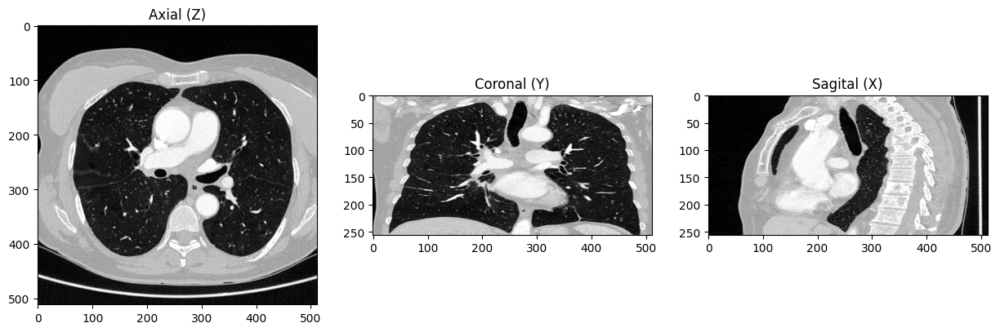

In [ ]:
# Cargar un archivo aleatorio
sample_file = os.listdir(OUTPUT_DIR)[0]
volume = np.load(os.path.join(OUTPUT_DIR, sample_file))

print(f"Dimensiones del volumen: {volume.shape}")  # Debería ser (256, 512, 512) por que hemos fijado 256 slices con dimension 512x512

# Visualizar slices en los 3 planos
def plot_orthogonal_views(vol):
    fig, axes = plt.subplots(1, 3, figsize=(15, 5))
    
    # Planos axial, sagital y coronal
    axes[0].imshow(vol[vol.shape[0]//2, :, :], cmap='gray')
    axes[0].set_title('Axial (Z)')
    
    axes[1].imshow(vol[:, vol.shape[1]//2, :], cmap='gray')
    axes[1].set_title('Coronal (Y)')
    
    axes[2].imshow(vol[:, :, vol.shape[2]//2], cmap='gray')
    axes[2].set_title('Sagital (X)')
    
    plt.show()

plot_orthogonal_views(volume)

## Dataset generico

El dataset generico esta en subcarpetas con diferentes nombres donde en las carpetas nodo tienen las imagenes dicom con extension .dcm

In [3]:
import os
import nibabel as nib

def mostrar_shapes_nii(carpeta):
    print(f"{'Archivo':<40} {'Shape':>15}")
    print("-" * 60)
    
    for archivo in os.listdir(carpeta):
        if archivo.endswith(".nii") or archivo.endswith(".nii.gz"):
            ruta = os.path.join(carpeta, archivo)
            try:
                img = nib.load(ruta)
                data = img.get_fdata()
                print(f"{archivo:<40} {str(data.shape):>15}")
            except Exception as e:
                print(f"{archivo:<40} {'Error':>15} ({e})")

# USO
carpeta_nifti = "./nii_dataset_generico_sin_preprocesar"
mostrar_shapes_nii(carpeta_nifti)


Archivo                                            Shape
------------------------------------------------------------
0_Lung_Dx-A0173.nii.gz                   (512, 512, 207)
0_Lung_Dx-A0206.nii.gz                   (512, 512, 102)
0_Lung_Dx-A0243.nii.gz                    (512, 512, 64)
0_Lung_Dx-A0184.nii.gz                   (200, 200, 419)
1_Lung_Dx-B0011.nii.gz                    (512, 512, 40)
0_Lung_Dx-A0211.nii.gz                   (200, 200, 357)
0_Lung_Dx-A0011.nii.gz                    (512, 512, 56)
1_Lung_Dx-B0020.nii.gz                    (512, 512, 21)
3_Lung_Dx-G0049.nii.gz                   (512, 512, 468)
0_Lung_Dx-A0192.nii.gz                   (512, 512, 414)
1_Lung_Dx-B0021.nii.gz                    (512, 512, 56)
2_Lung_Dx-E0002.nii.gz                    (512, 512, 51)
0_Lung_Dx-A0089.nii.gz                    (512, 512, 38)
3_Lung_Dx-G0058.nii.gz                   (200, 200, 265)
0_Lung_Dx-A0189.nii.gz                   (512, 512, 177)
0_Lung_Dx-A0074.nii.gz     

In [ ]:
#directorio dataset generico
ruta_dataset_generico="./nii_dataset_generico_sin_preprocesar"
ruta_save_dataset_generico="./preprocessed_dataset_generico"
ruta_mascaras_generico="./segmentacion/segmentacion_nodulos/dataset_generico_segmentado"

In [3]:
#El tipo de cancer esta en la carpeta contenida
def get_cancer_type(patient_id):
    """Clasifica automáticamente según la letra en el ID del paciente."""
    cancer_code = patient_id.split('-')[1][0].upper()  # Ej: Extrae 'A' de 'Lung_Dx-A0001'
    cancer_types = {
        'A': 0,  # Adenocarcinoma
        'B': 1,  # Small Cell
        'E': 2,  # Large Cell
        'G': 3   # Squamous
    }
    return cancer_types.get(cancer_code, -1)  # -1 si no coincide

In [ ]:
#preprocesar 2D
def preprocess_and_save_slices(root_dir, save_dir, target_size=(512, 512)):
    """
    Busca recursivamente archivos DICOM y los guarda como .npy con etiquetas automáticas.
    Estructura de carpetas esperada: root_dir/.../Lung_Dx-[A|B|E|G]XXXX/.../imagen.dcm
    """
    os.makedirs(save_dir, exist_ok=True)
    
    for root, _, files in os.walk(root_dir):
        for file in files:
            if file.endswith(('.dcm', '.DCM')):
                try:
                    # Obtener ID de paciente desde la ruta
                    path_parts = root.split(os.sep)
                    patient_id = next(p for p in path_parts if p.startswith('Lung_Dx-'))
                    label = get_cancer_type(patient_id)
                    
                    if label == -1:
                        continue  # Saltar pacientes no clasificables

                    # Procesar imagen DICOM
                    dicom_path = os.path.join(root, file)
                    dicom = pydicom.dcmread(dicom_path)
                    img = dicom.pixel_array.astype(np.float32)
                    
                    # Normalización según modalidad
                    if dicom.Modality == 'PT':  # PET
                        img = (img - img.min()) / (img.max() - img.min() + 1e-6)
                    elif dicom.Modality == 'CT':  # CT
                        img = (img + 1000) / 2000  # Escala típica de HU
                    
                    # Redimensionar
                    img = resize(img, target_size, mode='reflect', anti_aliasing=True)
                    
                    # Guardar con nombre estructurado: [LABEL]_[ID]_[SLICE].npy
                    slice_name = f"{label}_{patient_id}_{file.split('.')[0]}.npy"
                    np.save(os.path.join(save_dir, slice_name), img)
                
                except Exception as e:
                    print(f"Error en {file}: {str(e)}")
                    continue

In [16]:
preprocess_and_save_slices(ruta_dataset_generico, ruta_save_dataset_generico, target_size=(512, 512))

In [39]:
from torchvision import transforms

# Transformaciones para las imágenes
transform = transforms.Compose([
    transforms.Resize((512, 512)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.5], std=[0.5])  # Normalización para imágenes en escala de grises
])

In [44]:
class LungCancerPretrainDataset(Dataset):
    def __init__(self, npy_dir):
        self.filepaths = [os.path.join(npy_dir, f) for f in os.listdir(npy_dir) 
                         if f.endswith('.npy')]
        
    def __len__(self):
        return len(self.filepaths)
    
    def __getitem__(self, idx):
        filepath = self.filepaths[idx]
        img = np.load(filepath)  # Cargar imagen
        
        # Asegurar que la imagen tenga shape (512, 512)
        if img.ndim == 3:  # Si es (512,512,3)
            img = img.mean(axis=-1)  # Convertir a escala de grises promediando canales
        elif img.ndim == 4:  # Si es (1,512,512,3)
            img = img[0].mean(axis=-1)
        
        # Asegurar tamaño correcto
        img = resize(img, (512, 512)) if img.shape != (512, 512) else img
        
        # Convertir a tensor y añadir canal
        img = torch.from_numpy(img).float().unsqueeze(0)  # Shape: [1, 512, 512]
        
        # Normalización
        img = (img - img.min()) / (img.max() - img.min() + 1e-6)
        img = (img - 0.5) / 0.5
        
        # Extraer label
        label = int(os.path.basename(filepath).split('_')[0])
        
        return img, label

In [45]:
def collate_fn(batch):
    # Filtra None (imágenes problemáticas)
    batch = [b for b in batch if b is not None]
    
    # Verifica dimensiones
    images = []
    labels = []
    for img, label in batch:
        if img.ndim == 3 and img.shape[0] == 1:  # [1,512,512]
            images.append(img)
            labels.append(label)
    
    if not images:
        return None, None  # O manejar este caso según tu necesidad
    
    # Stack de imágenes y labels
    images = torch.stack(images)
    labels = torch.tensor(labels)
    return images, labels

In [46]:
# Configuración inicial
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Cargar modelo base
model = models.efficientnet_v2_s(weights=None)  # No usar ImageNet para imágenes médicas

# Modificar primera capa para 1 canal (escala de grises)
model.features[0][0] = nn.Conv2d(1, 24, kernel_size=3, stride=2, padding=1, bias=False)

# Modificar última capa para 4 clases
num_features = model.classifier[1].in_features
model.classifier[1] = nn.Linear(num_features, 4)  # 4 clases de cáncer

model = model.to(device)

In [47]:
# Hyperparámetros
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.0001)
num_epochs = 15
batch_size = 32

# DataLoader
pretrain_dataset = LungCancerPretrainDataset(ruta_save_dataset_generico)
pretrain_loader = DataLoader(
    pretrain_dataset,
    batch_size=32,
    shuffle=True,
    num_workers=4,
    collate_fn=collate_fn
)

In [48]:
for epoch in range(num_epochs):
    model.train()
    running_loss = 0.0
    correct = 0
    total = 0
    
    for batch in tqdm(pretrain_loader, desc=f"Epoch {epoch+1}/{num_epochs}"):
        if batch[0] is None:  # Batch problemático
            continue
            
        images, labels = batch
        images, labels = images.to(device), labels.to(device)
        
        optimizer.zero_grad()
        outputs = model(images)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        
        running_loss += loss.item()
        _, predicted = torch.max(outputs.data, 1)
        total += labels.size(0)
        correct += (predicted == labels).sum().item()
    
    if total > 0:
        epoch_loss = running_loss / len(pretrain_loader)
        epoch_acc = 100 * correct / total
        print(f"Epoch {epoch+1} - Loss: {epoch_loss:.4f}, Accuracy: {epoch_acc:.2f}%")

Epoch 1/15:   0%|          | 0/3507 [00:00<?, ?it/s]

Epoch 1/15: 100%|██████████| 3507/3507 [54:36<00:00,  1.07it/s]  


Epoch 1 - Loss: 0.4085, Accuracy: 86.30%


Epoch 2/15: 100%|██████████| 3507/3507 [49:15<00:00,  1.19it/s] 


Epoch 2 - Loss: 0.1714, Accuracy: 94.25%


Epoch 3/15: 100%|██████████| 3507/3507 [47:40<00:00,  1.23it/s] 


Epoch 3 - Loss: 0.0939, Accuracy: 96.73%


Epoch 4/15: 100%|██████████| 3507/3507 [46:16<00:00,  1.26it/s] 


Epoch 4 - Loss: 0.0542, Accuracy: 98.19%


Epoch 5/15: 100%|██████████| 3507/3507 [45:41<00:00,  1.28it/s] 


Epoch 5 - Loss: 0.0400, Accuracy: 98.66%


Epoch 6/15: 100%|██████████| 3507/3507 [44:16<00:00,  1.32it/s] 


Epoch 6 - Loss: 0.0313, Accuracy: 98.97%


Epoch 7/15: 100%|██████████| 3507/3507 [39:59<00:00,  1.46it/s] 


Epoch 7 - Loss: 0.0264, Accuracy: 99.11%


Epoch 8/15: 100%|██████████| 3507/3507 [39:51<00:00,  1.47it/s] 


Epoch 8 - Loss: 0.0219, Accuracy: 99.30%


Epoch 9/15: 100%|██████████| 3507/3507 [39:59<00:00,  1.46it/s] 


Epoch 9 - Loss: 0.0182, Accuracy: 99.39%


Epoch 10/15: 100%|██████████| 3507/3507 [40:01<00:00,  1.46it/s] 


Epoch 10 - Loss: 0.0180, Accuracy: 99.43%


Epoch 11/15: 100%|██████████| 3507/3507 [39:44<00:00,  1.47it/s] 


Epoch 11 - Loss: 0.0162, Accuracy: 99.47%


Epoch 12/15: 100%|██████████| 3507/3507 [39:46<00:00,  1.47it/s]


Epoch 12 - Loss: 0.0139, Accuracy: 99.54%


Epoch 13/15: 100%|██████████| 3507/3507 [39:16<00:00,  1.49it/s] 


Epoch 13 - Loss: 0.0116, Accuracy: 99.62%


Epoch 14/15: 100%|██████████| 3507/3507 [39:36<00:00,  1.48it/s]


Epoch 14 - Loss: 0.0126, Accuracy: 99.61%


Epoch 15/15: 100%|██████████| 3507/3507 [39:21<00:00,  1.48it/s]  

Epoch 15 - Loss: 0.0114, Accuracy: 99.65%


In [49]:
# Guardar TODO el modelo (arquitectura + pesos)
torch.save(model, 'modelo_preentrenado_completo.pth')

# O guardar solo los pesos (recomendado para fine-tuning)
torch.save({
    'model_state_dict': model.state_dict(),
    'optimizer_state_dict': optimizer.state_dict(),
    'epoch': num_epochs,
    'loss': loss,
}, 'pesos_preentrenados.pth')

In [64]:
# # Cargar la arquitectura base (debe ser la misma usada en pre-entrenamiento)
# model = models.efficientnet_v2_s(weights=None)
# model.features[0][0] = nn.Conv2d(1, 24, kernel_size=3, stride=2, padding=1, bias=False)

# # Cargar los pesos pre-entrenados
# checkpoint = torch.load('pesos_preentrenados.pth')
# model.load_state_dict(checkpoint['model_state_dict'])

# Modificar la última capa para tu tarea binaria
num_features = model.classifier[1].in_features
model.classifier[1] = nn.Sequential(
    nn.Linear(num_features, 1),
    nn.Sigmoid()
)

# Configurar para fine-tuning (opciones):
# Opción A: Congelar todas las capas excepto la última
# for param in model.parameters():
#     param.requires_grad = False
# for param in model.classifier.parameters():
#     param.requires_grad = True

# Opción B: Congelar solo las primeras capas
for i, (name, param) in enumerate(model.named_parameters()):
    if i < 100:  # Congelar primeros 100 parámetros
        param.requires_grad = False

model = model.to(device)

### Dataset generico para predecir tipo de cancer 3D

In [ ]:
def preprocess_and_save_3d_series_one_by_one(root_dir, save_dir, target_shape=(256, 512, 512)):
    os.makedirs(save_dir, exist_ok=True)
    nombre_usados = defaultdict(int)

    # Estructura: (label, patient_id, series_uid) -> [file paths]
    series_dicoms = defaultdict(list)

    print("[INFO] Agrupando rutas por series...")
    for dirpath, _, filenames in tqdm(list(os.walk(root_dir))):
        for file in filenames:
            if not file.lower().endswith(".dcm"):
                continue
            try:
                full_path = os.path.join(dirpath, file)
                dcm = pydicom.dcmread(full_path, stop_before_pixels=True)

                if getattr(dcm, "Modality", None) != "CT":
                    continue

                path_parts = dirpath.split(os.sep)
                patient_id = next(p for p in path_parts if p.startswith("Lung_Dx-"))
                label = get_cancer_type(patient_id)
                if label == -1:
                    continue

                series_uid = getattr(dcm, "SeriesInstanceUID", None)
                if not series_uid:
                    continue

                key = (label, patient_id, series_uid)
                series_dicoms[key].append(full_path)
            except:
                continue

    print(f"[INFO] Se detectaron {len(series_dicoms)} series CT únicas.")

    for (label, patient_id, series_uid), paths in tqdm(series_dicoms.items()):
        try:
            slices = []
            for path in paths:
                dcm = pydicom.dcmread(path)
                if dcm.pixel_array is None:
                    continue
                img = dcm.pixel_array.astype(np.float32)
                if hasattr(dcm, "RescaleIntercept") and hasattr(dcm, "RescaleSlope"):
                    img = img * dcm.RescaleSlope + dcm.RescaleIntercept
                z = dcm.ImagePositionPatient[2] if "ImagePositionPatient" in dcm else len(slices)
                slices.append((z, img))

            if len(slices) < 10:
                print(f"[!] Serie {patient_id}-{series_uid} tiene muy pocos slices. Saltando.")
                continue

            slices.sort(key=lambda x: x[0])
            volume = np.stack([s[1] for s in slices], axis=0)
            volume = (volume + 1000) / 2000
            volume = np.clip(volume, 0, 1)
            volume_resized = resize(volume, target_shape, mode='reflect', anti_aliasing=True).astype(np.float32)

            nombre_usados[(label, patient_id)] += 1
            nombre = f"{label}_{patient_id}_{nombre_usados[(label, patient_id)]}.npy"
            np.save(os.path.join(save_dir, nombre), volume_resized)

            print(f"[✓] Guardado: {nombre}")
            del volume, volume_resized, slices  # liberar memoria

        except Exception as e:
            print(f"[X] Error en {patient_id}-{series_uid}: {e}")
            continue

preprocess_and_save_3d_series_one_by_one(
    root_dir="./dataset_generico_pulmones",
    save_dir="./preprocessed_dataset_generico_3d",
    target_shape=(256, 512, 512)
)


Veamos un ejemplo de como se han quedado despues del preprocesamiento: 

In [ ]:
from ipywidgets import interact, IntSlider
save_dir_3d_generico="./preprocessed_dataset_generico_3d_reducido"
# Listado de archivos .npy
archivos = sorted([f for f in os.listdir(save_dir_3d_generico) if f.endswith(".npy")])

# Cargar un volumen por nombre
def cargar_volumen(nombre_archivo):
    ruta = os.path.join(save_dir_3d_generico, nombre_archivo)
    volumen = np.load(ruta)
    print(f" Cargado: {nombre_archivo}, shape: {volumen.shape}")
    return volumen

# Mostrar slices con slider interactivo
def mostrar_volumen_interactivo(volumen, cmap='gray'):
    profundidad = volumen.shape[0]
    
    @interact(slice=IntSlider(min=0, max=profundidad-1, step=1, value=profundidad//2))
    def mostrar_slice(slice=0):
        plt.figure(figsize=(6, 6))
        plt.imshow(volumen[slice], cmap=cmap)
        plt.title(f"Slice {slice} / {profundidad-1}")
        plt.axis("off")
        plt.show()

In [5]:
# Selecciona el archivo que quieras visualizar
archivo = archivos[0]  # o archivos[5], etc.

vol = cargar_volumen(archivo)
mostrar_volumen_interactivo(vol)


✅ Cargado: 0_Lung_Dx-A0001_1.npy, shape: (128, 256, 256)


interactive(children=(IntSlider(value=64, description='slice', max=127), Output()), _dom_classes=('widget-inte…

In [ ]:
vol = np.load('./preprocessed_dataset_generico_3d_reducido/0_Lung_Dx-A0001_1.npy')
print(vol.shape)  # debería dar (256, 512, 512)-> eso sin reducir


(128, 256, 256)


In [ ]:
#corregimos dimensiones
archivos = [f for f in os.listdir(save_dir_3d_generico) if f.endswith(".npy")]
corregidos = 0

for archivo in tqdm(archivos):
    path = os.path.join(save_dir_3d_generico, archivo)
    vol = np.load(path)
    
    if vol.ndim == 4 and vol.shape[-1] == 3:
        print(f"[!] Corrigiendo: {archivo}, shape: {vol.shape}")
        vol_corr = vol[..., 0]  # Tomamos solo el canal 0 (gris)
        np.save(path, vol_corr.astype(np.float32))
        corregidos += 1

print(f" Volúmenes corregidos: {corregidos} / {len(archivos)}")

  0%|          | 0/1107 [00:00<?, ?it/s]

[!] Corrigiendo: 3_Lung_Dx-G0033_4.npy, shape: (256, 512, 512, 3)


  1%|          | 8/1107 [00:51<2:00:55,  6.60s/it]

[!] Corrigiendo: 0_Lung_Dx-A0192_2.npy, shape: (256, 512, 512, 3)


  1%|          | 10/1107 [01:19<2:56:28,  9.65s/it]

[!] Corrigiendo: 0_Lung_Dx-A0232_3.npy, shape: (256, 512, 512, 3)


  1%|▏         | 14/1107 [01:59<2:40:58,  8.84s/it]

[!] Corrigiendo: 3_Lung_Dx-G0058_1.npy, shape: (256, 512, 512, 3)


  1%|▏         | 15/1107 [02:23<4:02:43, 13.34s/it]

[!] Corrigiendo: 0_Lung_Dx-A0262_3.npy, shape: (256, 512, 512, 3)


  2%|▏         | 17/1107 [02:52<4:02:00, 13.32s/it]

[!] Corrigiendo: 0_Lung_Dx-A0230_3.npy, shape: (256, 512, 512, 3)


  3%|▎         | 30/1107 [04:41<2:05:04,  6.97s/it]

[!] Corrigiendo: 0_Lung_Dx-A0174_4.npy, shape: (256, 512, 512, 3)


  3%|▎         | 34/1107 [05:28<2:39:21,  8.91s/it]

[!] Corrigiendo: 0_Lung_Dx-A0185_3.npy, shape: (256, 512, 512, 3)


  4%|▎         | 40/1107 [06:25<2:19:16,  7.83s/it]

[!] Corrigiendo: 0_Lung_Dx-A0253_2.npy, shape: (256, 512, 512, 3)


  4%|▍         | 42/1107 [07:00<3:28:46, 11.76s/it]

[!] Corrigiendo: 3_Lung_Dx-G0037_4.npy, shape: (256, 512, 512, 3)


  4%|▍         | 44/1107 [07:31<3:48:51, 12.92s/it]

[!] Corrigiendo: 0_Lung_Dx-A0179_4.npy, shape: (256, 512, 512, 3)


  4%|▍         | 46/1107 [08:03<3:58:40, 13.50s/it]

[!] Corrigiendo: 3_Lung_Dx-G0053_2.npy, shape: (256, 512, 512, 3)


  4%|▍         | 48/1107 [08:38<4:20:24, 14.75s/it]

[!] Corrigiendo: 1_Lung_Dx-B0037_3.npy, shape: (256, 512, 512, 3)


  5%|▍         | 51/1107 [09:20<3:51:52, 13.17s/it]

[!] Corrigiendo: 3_Lung_Dx-G0045_1.npy, shape: (256, 512, 512, 3)


  5%|▍         | 52/1107 [10:11<7:11:58, 24.57s/it]

[!] Corrigiendo: 0_Lung_Dx-A0195_4.npy, shape: (256, 512, 512, 3)


  5%|▍         | 54/1107 [10:56<6:36:45, 22.61s/it]

[!] Corrigiendo: 0_Lung_Dx-A0205_4.npy, shape: (256, 512, 512, 3)


  6%|▌         | 62/1107 [12:24<3:00:26, 10.36s/it]

[!] Corrigiendo: 0_Lung_Dx-A0170_4.npy, shape: (256, 512, 512, 3)


  6%|▌         | 64/1107 [13:03<3:59:18, 13.77s/it]

[!] Corrigiendo: 3_Lung_Dx-G0043_4.npy, shape: (256, 512, 512, 3)


  6%|▌         | 66/1107 [13:36<4:12:45, 14.57s/it]

[!] Corrigiendo: 0_Lung_Dx-A0231_2.npy, shape: (256, 512, 512, 3)


  6%|▌         | 68/1107 [14:06<4:05:01, 14.15s/it]

[!] Corrigiendo: 0_Lung_Dx-A0193_3.npy, shape: (256, 512, 512, 3)


  6%|▋         | 71/1107 [14:43<3:20:10, 11.59s/it]

[!] Corrigiendo: 0_Lung_Dx-A0176_4.npy, shape: (256, 512, 512, 3)


  7%|▋         | 78/1107 [15:44<2:04:53,  7.28s/it]

[!] Corrigiendo: 0_Lung_Dx-A0202_2.npy, shape: (256, 512, 512, 3)


  7%|▋         | 80/1107 [16:11<2:46:19,  9.72s/it]

[!] Corrigiendo: 0_Lung_Dx-A0184_3.npy, shape: (256, 512, 512, 3)


  7%|▋         | 82/1107 [16:41<3:18:27, 11.62s/it]

[!] Corrigiendo: 3_Lung_Dx-G0060_2.npy, shape: (256, 512, 512, 3)


  8%|▊         | 89/1107 [17:52<2:14:53,  7.95s/it]

[!] Corrigiendo: 3_Lung_Dx-G0041_2.npy, shape: (256, 512, 512, 3)


  8%|▊         | 94/1107 [18:42<2:14:37,  7.97s/it]

[!] Corrigiendo: 3_Lung_Dx-G0062_1.npy, shape: (256, 512, 512, 3)


  9%|▉         | 99/1107 [19:32<2:14:07,  7.98s/it]

[!] Corrigiendo: 0_Lung_Dx-A0238_2.npy, shape: (256, 512, 512, 3)


  9%|▉         | 105/1107 [20:30<2:09:40,  7.77s/it]

[!] Corrigiendo: 0_Lung_Dx-A0212_3.npy, shape: (256, 512, 512, 3)


 10%|▉         | 106/1107 [21:00<3:57:07, 14.21s/it]

[!] Corrigiendo: 0_Lung_Dx-A0180_4.npy, shape: (256, 512, 512, 3)


 10%|█         | 114/1107 [22:12<2:06:16,  7.63s/it]

[!] Corrigiendo: 1_Lung_Dx-B0037_4.npy, shape: (256, 512, 512, 3)


 11%|█         | 119/1107 [23:03<2:14:23,  8.16s/it]

[!] Corrigiendo: 0_Lung_Dx-A0261_2.npy, shape: (256, 512, 512, 3)


 11%|█         | 121/1107 [23:34<3:02:05, 11.08s/it]

[!] Corrigiendo: 0_Lung_Dx-A0223_4.npy, shape: (256, 512, 512, 3)


 11%|█         | 123/1107 [24:09<3:44:53, 13.71s/it]

[!] Corrigiendo: 3_Lung_Dx-G0042_1.npy, shape: (256, 512, 512, 3)


 11%|█▏        | 126/1107 [24:47<3:11:29, 11.71s/it]

[!] Corrigiendo: 0_Lung_Dx-A0250_3.npy, shape: (256, 512, 512, 3)


 12%|█▏        | 135/1107 [26:04<1:55:13,  7.11s/it]

[!] Corrigiendo: 0_Lung_Dx-A0240_4.npy, shape: (256, 512, 512, 3)


 13%|█▎        | 140/1107 [26:55<2:11:39,  8.17s/it]

[!] Corrigiendo: 0_Lung_Dx-A0201_4.npy, shape: (256, 512, 512, 3)


 13%|█▎        | 141/1107 [27:20<3:32:25, 13.19s/it]

[!] Corrigiendo: 0_Lung_Dx-A0217_3.npy, shape: (256, 512, 512, 3)


 13%|█▎        | 143/1107 [27:55<3:49:29, 14.28s/it]

[!] Corrigiendo: 0_Lung_Dx-A0171_2.npy, shape: (256, 512, 512, 3)


 13%|█▎        | 147/1107 [28:39<2:45:02, 10.32s/it]

[!] Corrigiendo: 0_Lung_Dx-A0226_1.npy, shape: (256, 512, 512, 3)


 14%|█▎        | 150/1107 [29:15<2:42:56, 10.22s/it]

[!] Corrigiendo: 0_Lung_Dx-A0262_1.npy, shape: (256, 512, 512, 3)


 14%|█▍        | 154/1107 [29:59<2:26:05,  9.20s/it]

[!] Corrigiendo: 0_Lung_Dx-A0246_2.npy, shape: (256, 512, 512, 3)


 14%|█▍        | 155/1107 [30:23<3:36:49, 13.67s/it]

[!] Corrigiendo: 0_Lung_Dx-A0189_1.npy, shape: (256, 512, 512, 3)


 14%|█▍        | 160/1107 [31:25<2:47:28, 10.61s/it]

[!] Corrigiendo: 3_Lung_Dx-G0038_2.npy, shape: (256, 512, 512, 3)


 15%|█▌        | 167/1107 [32:49<2:11:11,  8.37s/it]

[!] Corrigiendo: 1_Lung_Dx-B0033_3.npy, shape: (256, 512, 512, 3)


 15%|█▌        | 170/1107 [33:27<2:34:28,  9.89s/it]

[!] Corrigiendo: 0_Lung_Dx-A0243_2.npy, shape: (256, 512, 512, 3)


 16%|█▌        | 173/1107 [34:04<2:41:05, 10.35s/it]

[!] Corrigiendo: 0_Lung_Dx-A0199_4.npy, shape: (256, 512, 512, 3)


 16%|█▌        | 175/1107 [34:37<3:17:22, 12.71s/it]

[!] Corrigiendo: 1_Lung_Dx-B0033_5.npy, shape: (256, 512, 512, 3)


 16%|█▌        | 178/1107 [35:16<2:58:10, 11.51s/it]

[!] Corrigiendo: 1_Lung_Dx-B0040_5.npy, shape: (256, 512, 512, 3)


 17%|█▋        | 184/1107 [36:13<2:04:25,  8.09s/it]

[!] Corrigiendo: 0_Lung_Dx-A0175_3.npy, shape: (256, 512, 512, 3)


 17%|█▋        | 190/1107 [37:11<1:59:37,  7.83s/it]

[!] Corrigiendo: 0_Lung_Dx-A0174_3.npy, shape: (256, 512, 512, 3)


 18%|█▊        | 194/1107 [37:55<2:10:30,  8.58s/it]

[!] Corrigiendo: 0_Lung_Dx-A0210_3.npy, shape: (256, 512, 512, 3)


 18%|█▊        | 195/1107 [38:22<3:37:11, 14.29s/it]

[!] Corrigiendo: 0_Lung_Dx-A0210_4.npy, shape: (256, 512, 512, 3)


 18%|█▊        | 204/1107 [39:41<1:49:55,  7.30s/it]

[!] Corrigiendo: 3_Lung_Dx-G0055_4.npy, shape: (256, 512, 512, 3)


 19%|█▊        | 206/1107 [40:15<2:51:57, 11.45s/it]

[!] Corrigiendo: 3_Lung_Dx-G0056_4.npy, shape: (256, 512, 512, 3)


 19%|█▉        | 211/1107 [41:07<2:12:59,  8.91s/it]

[!] Corrigiendo: 3_Lung_Dx-G0057_2.npy, shape: (256, 512, 512, 3)


 19%|█▉        | 215/1107 [41:55<2:22:31,  9.59s/it]

[!] Corrigiendo: 0_Lung_Dx-A0260_1.npy, shape: (256, 512, 512, 3)


 20%|█▉        | 218/1107 [42:34<2:34:33, 10.43s/it]

[!] Corrigiendo: 0_Lung_Dx-A0254_3.npy, shape: (256, 512, 512, 3)


 21%|██        | 227/1107 [43:51<1:44:30,  7.13s/it]

[!] Corrigiendo: 0_Lung_Dx-A0191_1.npy, shape: (256, 512, 512, 3)


 21%|██        | 229/1107 [44:22<2:35:07, 10.60s/it]

[!] Corrigiendo: 0_Lung_Dx-A0195_3.npy, shape: (256, 512, 512, 3)


 21%|██        | 230/1107 [44:46<3:32:29, 14.54s/it]

[!] Corrigiendo: 0_Lung_Dx-A0177_1.npy, shape: (256, 512, 512, 3)


 21%|██        | 231/1107 [45:14<4:30:27, 18.52s/it]

[!] Corrigiendo: 0_Lung_Dx-A0214_2.npy, shape: (256, 512, 512, 3)


 22%|██▏       | 241/1107 [46:38<1:43:25,  7.17s/it]

[!] Corrigiendo: 0_Lung_Dx-A0234_2.npy, shape: (256, 512, 512, 3)


 23%|██▎       | 253/1107 [48:10<1:34:17,  6.62s/it]

[!] Corrigiendo: 3_Lung_Dx-G0040_5.npy, shape: (256, 512, 512, 3)


 23%|██▎       | 257/1107 [48:58<2:06:03,  8.90s/it]

[!] Corrigiendo: 3_Lung_Dx-G0051_1.npy, shape: (256, 512, 512, 3)


 23%|██▎       | 258/1107 [49:26<3:28:36, 14.74s/it]

[!] Corrigiendo: 3_Lung_Dx-G0051_2.npy, shape: (256, 512, 512, 3)


 23%|██▎       | 260/1107 [49:55<3:14:18, 13.76s/it]

[!] Corrigiendo: 0_Lung_Dx-A0217_4.npy, shape: (256, 512, 512, 3)


 24%|██▎       | 262/1107 [50:20<2:56:35, 12.54s/it]

[!] Corrigiendo: 1_Lung_Dx-B0043_3.npy, shape: (256, 512, 512, 3)


 24%|██▍       | 264/1107 [50:51<3:05:08, 13.18s/it]

[!] Corrigiendo: 0_Lung_Dx-A0176_2.npy, shape: (256, 512, 512, 3)


 24%|██▍       | 266/1107 [51:21<3:09:43, 13.54s/it]

[!] Corrigiendo: 0_Lung_Dx-A0171_4.npy, shape: (256, 512, 512, 3)


 24%|██▍       | 267/1107 [51:45<3:53:17, 16.66s/it]

[!] Corrigiendo: 0_Lung_Dx-A0190_2.npy, shape: (256, 512, 512, 3)


 24%|██▍       | 271/1107 [52:57<3:23:05, 14.58s/it]

[!] Corrigiendo: 0_Lung_Dx-A0221_1.npy, shape: (256, 512, 512, 3)


 25%|██▍       | 274/1107 [53:38<2:51:53, 12.38s/it]

[!] Corrigiendo: 0_Lung_Dx-A0184_4.npy, shape: (256, 512, 512, 3)


 25%|██▌       | 277/1107 [54:23<3:02:06, 13.16s/it]

[!] Corrigiendo: 0_Lung_Dx-A0173_4.npy, shape: (256, 512, 512, 3)


 26%|██▌       | 286/1107 [55:56<1:46:27,  7.78s/it]

[!] Corrigiendo: 0_Lung_Dx-A0256_4.npy, shape: (256, 512, 512, 3)


 27%|██▋       | 301/1107 [57:54<1:32:07,  6.86s/it]

[!] Corrigiendo: 0_Lung_Dx-A0227_1.npy, shape: (256, 512, 512, 3)


 27%|██▋       | 302/1107 [58:22<2:53:39, 12.94s/it]

[!] Corrigiendo: 0_Lung_Dx-A0227_2.npy, shape: (256, 512, 512, 3)


 28%|██▊       | 306/1107 [59:09<2:22:04, 10.64s/it]

[!] Corrigiendo: 0_Lung_Dx-A0187_1.npy, shape: (256, 512, 512, 3)


 28%|██▊       | 308/1107 [59:43<2:51:52, 12.91s/it]

[!] Corrigiendo: 0_Lung_Dx-A0196_1.npy, shape: (256, 512, 512, 3)


 28%|██▊       | 312/1107 [1:00:50<2:59:58, 13.58s/it]

[!] Corrigiendo: 0_Lung_Dx-A0204_1.npy, shape: (256, 512, 512, 3)


 28%|██▊       | 315/1107 [1:01:37<2:53:10, 13.12s/it]

[!] Corrigiendo: 0_Lung_Dx-A0264_2.npy, shape: (256, 512, 512, 3)


 29%|██▊       | 316/1107 [1:02:02<3:37:25, 16.49s/it]

[!] Corrigiendo: 0_Lung_Dx-A0181_4.npy, shape: (256, 512, 512, 3)


 29%|██▊       | 317/1107 [1:02:27<4:11:10, 19.08s/it]

[!] Corrigiendo: 0_Lung_Dx-A0182_2.npy, shape: (256, 512, 512, 3)


 29%|██▉       | 319/1107 [1:03:02<3:47:37, 17.33s/it]

[!] Corrigiendo: 1_Lung_Dx-B0036_2.npy, shape: (256, 512, 512, 3)


 29%|██▉       | 320/1107 [1:03:27<4:15:23, 19.47s/it]

[!] Corrigiendo: 3_Lung_Dx-G0044_2.npy, shape: (256, 512, 512, 3)


 29%|██▉       | 322/1107 [1:04:02<3:50:35, 17.62s/it]

[!] Corrigiendo: 3_Lung_Dx-G0036_1.npy, shape: (256, 512, 512, 3)


 29%|██▉       | 324/1107 [1:04:33<3:25:10, 15.72s/it]

[!] Corrigiendo: 3_Lung_Dx-G0036_4.npy, shape: (256, 512, 512, 3)


 30%|██▉       | 329/1107 [1:05:24<2:03:34,  9.53s/it]

[!] Corrigiendo: 0_Lung_Dx-A0166_3.npy, shape: (256, 512, 512, 3)


 31%|███       | 339/1107 [1:06:52<1:31:11,  7.12s/it]

[!] Corrigiendo: 0_Lung_Dx-A0197_1.npy, shape: (256, 512, 512, 3)


 31%|███       | 342/1107 [1:07:31<2:02:30,  9.61s/it]

[!] Corrigiendo: 0_Lung_Dx-A0252_4.npy, shape: (256, 512, 512, 3)


 31%|███▏      | 347/1107 [1:08:22<1:48:20,  8.55s/it]

[!] Corrigiendo: 0_Lung_Dx-A0183_4.npy, shape: (256, 512, 512, 3)


 32%|███▏      | 353/1107 [1:09:20<1:37:51,  7.79s/it]

[!] Corrigiendo: 0_Lung_Dx-A0175_2.npy, shape: (256, 512, 512, 3)


 32%|███▏      | 355/1107 [1:09:55<2:25:42, 11.63s/it]

[!] Corrigiendo: 0_Lung_Dx-A0235_3.npy, shape: (256, 512, 512, 3)


 33%|███▎      | 363/1107 [1:11:04<1:30:35,  7.31s/it]

[!] Corrigiendo: 0_Lung_Dx-A0173_3.npy, shape: (256, 512, 512, 3)


 33%|███▎      | 366/1107 [1:11:41<1:55:34,  9.36s/it]

[!] Corrigiendo: 0_Lung_Dx-A0164_4.npy, shape: (256, 512, 512, 3)


 33%|███▎      | 367/1107 [1:12:05<2:49:41, 13.76s/it]

[!] Corrigiendo: 0_Lung_Dx-A0185_1.npy, shape: (256, 512, 512, 3)


 33%|███▎      | 368/1107 [1:12:29<3:26:29, 16.77s/it]

[!] Corrigiendo: 3_Lung_Dx-G0056_1.npy, shape: (256, 512, 512, 3)


 33%|███▎      | 369/1107 [1:12:55<3:59:54, 19.50s/it]

[!] Corrigiendo: 3_Lung_Dx-G0039_2.npy, shape: (256, 512, 512, 3)


 34%|███▍      | 377/1107 [1:14:14<1:37:32,  8.02s/it]

[!] Corrigiendo: 0_Lung_Dx-A0181_1.npy, shape: (256, 512, 512, 3)


 34%|███▍      | 380/1107 [1:14:51<1:58:26,  9.78s/it]

[!] Corrigiendo: 1_Lung_Dx-B0041_4.npy, shape: (256, 512, 512, 3)


 35%|███▍      | 382/1107 [1:15:23<2:24:22, 11.95s/it]

[!] Corrigiendo: 0_Lung_Dx-A0191_4.npy, shape: (256, 512, 512, 3)


 35%|███▍      | 384/1107 [1:15:54<2:36:08, 12.96s/it]

[!] Corrigiendo: 0_Lung_Dx-A0257_1.npy, shape: (256, 512, 512, 3)


 35%|███▌      | 388/1107 [1:16:37<1:58:32,  9.89s/it]

[!] Corrigiendo: 0_Lung_Dx-A0250_4.npy, shape: (256, 512, 512, 3)


 35%|███▌      | 391/1107 [1:17:15<2:03:26, 10.34s/it]

[!] Corrigiendo: 0_Lung_Dx-A0194_3.npy, shape: (256, 512, 512, 3)


 35%|███▌      | 392/1107 [1:17:40<2:54:20, 14.63s/it]

[!] Corrigiendo: 0_Lung_Dx-A0218_3.npy, shape: (256, 512, 512, 3)


 36%|███▋      | 402/1107 [1:19:03<1:24:03,  7.15s/it]

[!] Corrigiendo: 0_Lung_Dx-A0168_4.npy, shape: (256, 512, 512, 3)


 37%|███▋      | 405/1107 [1:19:40<1:49:19,  9.34s/it]

[!] Corrigiendo: 1_Lung_Dx-B0038_1.npy, shape: (256, 512, 512, 3)


 37%|███▋      | 409/1107 [1:20:27<1:51:31,  9.59s/it]

[!] Corrigiendo: 0_Lung_Dx-A0265_3.npy, shape: (256, 512, 512, 3)


 37%|███▋      | 411/1107 [1:21:05<2:35:12, 13.38s/it]

[!] Corrigiendo: 0_Lung_Dx-A0238_1.npy, shape: (256, 512, 512, 3)


 37%|███▋      | 413/1107 [1:21:36<2:38:05, 13.67s/it]

[!] Corrigiendo: 3_Lung_Dx-G0035_3.npy, shape: (256, 512, 512, 3)


 38%|███▊      | 419/1107 [1:22:53<2:05:02, 10.90s/it]

[!] Corrigiendo: 3_Lung_Dx-G0038_3.npy, shape: (256, 512, 512, 3)


 38%|███▊      | 422/1107 [1:23:37<2:15:40, 11.88s/it]

[!] Corrigiendo: 0_Lung_Dx-A0251_3.npy, shape: (256, 512, 512, 3)


 38%|███▊      | 423/1107 [1:24:03<3:02:39, 16.02s/it]

[!] Corrigiendo: 0_Lung_Dx-A0241_2.npy, shape: (256, 512, 512, 3)


 39%|███▉      | 429/1107 [1:25:02<1:41:04,  8.94s/it]

[!] Corrigiendo: 3_Lung_Dx-G0033_1.npy, shape: (256, 512, 512, 3)


 39%|███▉      | 435/1107 [1:26:00<1:26:49,  7.75s/it]

[!] Corrigiendo: 0_Lung_Dx-A0222_4.npy, shape: (256, 512, 512, 3)


 40%|███▉      | 441/1107 [1:26:57<1:24:59,  7.66s/it]

[!] Corrigiendo: 3_Lung_Dx-G0039_4.npy, shape: (256, 512, 512, 3)


 40%|████      | 443/1107 [1:27:28<1:58:53, 10.74s/it]

[!] Corrigiendo: 3_Lung_Dx-G0059_1.npy, shape: (256, 512, 512, 3)


 40%|████      | 444/1107 [1:27:51<2:41:32, 14.62s/it]

[!] Corrigiendo: 0_Lung_Dx-A0196_3.npy, shape: (256, 512, 512, 3)


 40%|████      | 446/1107 [1:28:22<2:34:51, 14.06s/it]

[!] Corrigiendo: 3_Lung_Dx-G0053_1.npy, shape: (256, 512, 512, 3)


 41%|████      | 455/1107 [1:29:38<1:17:42,  7.15s/it]

[!] Corrigiendo: 0_Lung_Dx-A0194_4.npy, shape: (256, 512, 512, 3)


 42%|████▏     | 465/1107 [1:31:05<1:15:36,  7.07s/it]

[!] Corrigiendo: 0_Lung_Dx-A0229_4.npy, shape: (256, 512, 512, 3)


 42%|████▏     | 468/1107 [1:31:46<1:45:21,  9.89s/it]

[!] Corrigiendo: 0_Lung_Dx-A0221_3.npy, shape: (256, 512, 512, 3)


 43%|████▎     | 471/1107 [1:32:27<1:54:56, 10.84s/it]

[!] Corrigiendo: 0_Lung_Dx-A0208_2.npy, shape: (256, 512, 512, 3)


 43%|████▎     | 473/1107 [1:32:57<2:08:41, 12.18s/it]

[!] Corrigiendo: 0_Lung_Dx-A0243_3.npy, shape: (256, 512, 512, 3)


 43%|████▎     | 474/1107 [1:33:22<2:49:05, 16.03s/it]

[!] Corrigiendo: 0_Lung_Dx-A0247_4.npy, shape: (256, 512, 512, 3)


 43%|████▎     | 481/1107 [1:34:21<1:18:42,  7.54s/it]

[!] Corrigiendo: 0_Lung_Dx-A0249_3.npy, shape: (256, 512, 512, 3)


 44%|████▎     | 484/1107 [1:34:58<1:38:42,  9.51s/it]

[!] Corrigiendo: 0_Lung_Dx-A0200_1.npy, shape: (256, 512, 512, 3)


 44%|████▍     | 491/1107 [1:36:02<1:16:11,  7.42s/it]

[!] Corrigiendo: 3_Lung_Dx-G0046_2.npy, shape: (256, 512, 512, 3)


 45%|████▍     | 493/1107 [1:36:33<1:48:46, 10.63s/it]

[!] Corrigiendo: 0_Lung_Dx-A0235_4.npy, shape: (256, 512, 512, 3)


 45%|████▍     | 497/1107 [1:37:18<1:37:09,  9.56s/it]

[!] Corrigiendo: 0_Lung_Dx-A0228_1.npy, shape: (256, 512, 512, 3)


 46%|████▌     | 504/1107 [1:38:30<1:22:49,  8.24s/it]

[!] Corrigiendo: 0_Lung_Dx-A0179_3.npy, shape: (256, 512, 512, 3)


 46%|████▌     | 507/1107 [1:39:34<2:32:35, 15.26s/it]

[!] Corrigiendo: 3_Lung_Dx-G0047_2.npy, shape: (256, 512, 512, 3)


 47%|████▋     | 516/1107 [1:40:52<1:13:13,  7.43s/it]

[!] Corrigiendo: 1_Lung_Dx-B0036_1.npy, shape: (256, 512, 512, 3)


 47%|████▋     | 518/1107 [1:41:32<2:04:16, 12.66s/it]

[!] Corrigiendo: 0_Lung_Dx-A0205_3.npy, shape: (256, 512, 512, 3)


 48%|████▊     | 532/1107 [1:43:37<1:33:04,  9.71s/it]

[!] Corrigiendo: 0_Lung_Dx-A0225_2.npy, shape: (256, 512, 512, 3)


 48%|████▊     | 534/1107 [1:44:25<2:26:18, 15.32s/it]

[!] Corrigiendo: 0_Lung_Dx-A0237_2.npy, shape: (256, 512, 512, 3)


 49%|████▉     | 546/1107 [1:46:05<1:04:48,  6.93s/it]

[!] Corrigiendo: 0_Lung_Dx-A0224_4.npy, shape: (256, 512, 512, 3)


 50%|████▉     | 551/1107 [1:46:55<1:12:29,  7.82s/it]

[!] Corrigiendo: 0_Lung_Dx-A0244_3.npy, shape: (256, 512, 512, 3)


 50%|████▉     | 553/1107 [1:47:25<1:39:31, 10.78s/it]

[!] Corrigiendo: 1_Lung_Dx-B0040_6.npy, shape: (256, 512, 512, 3)


 50%|█████     | 555/1107 [1:47:56<1:54:11, 12.41s/it]

[!] Corrigiendo: 3_Lung_Dx-G0038_1.npy, shape: (256, 512, 512, 3)


 50%|█████     | 559/1107 [1:48:38<1:26:52,  9.51s/it]

[!] Corrigiendo: 0_Lung_Dx-A0239_4.npy, shape: (256, 512, 512, 3)


 51%|█████     | 561/1107 [1:49:09<1:45:51, 11.63s/it]

[!] Corrigiendo: 3_Lung_Dx-G0046_3.npy, shape: (256, 512, 512, 3)


 51%|█████     | 562/1107 [1:49:33<2:18:45, 15.28s/it]

[!] Corrigiendo: 0_Lung_Dx-A0189_2.npy, shape: (256, 512, 512, 3)


 51%|█████     | 563/1107 [1:49:56<2:41:02, 17.76s/it]

[!] Corrigiendo: 0_Lung_Dx-A0188_4.npy, shape: (256, 512, 512, 3)


 51%|█████     | 566/1107 [1:50:33<1:57:15, 13.00s/it]

[!] Corrigiendo: 0_Lung_Dx-A0206_3.npy, shape: (256, 512, 512, 3)


 51%|█████▏    | 568/1107 [1:51:08<2:07:07, 14.15s/it]

[!] Corrigiendo: 0_Lung_Dx-A0180_2.npy, shape: (256, 512, 512, 3)


 51%|█████▏    | 569/1107 [1:51:32<2:34:19, 17.21s/it]

[!] Corrigiendo: 0_Lung_Dx-A0211_3.npy, shape: (256, 512, 512, 3)


 52%|█████▏    | 571/1107 [1:52:02<2:15:42, 15.19s/it]

[!] Corrigiendo: 3_Lung_Dx-G0035_2.npy, shape: (256, 512, 512, 3)


 52%|█████▏    | 572/1107 [1:52:26<2:39:14, 17.86s/it]

[!] Corrigiendo: 0_Lung_Dx-A0183_2.npy, shape: (256, 512, 512, 3)


 54%|█████▍    | 600/1107 [1:55:49<1:09:53,  8.27s/it]

[!] Corrigiendo: 0_Lung_Dx-A0170_2.npy, shape: (256, 512, 512, 3)


 55%|█████▌    | 614/1107 [1:58:18<55:40,  6.78s/it]  

[!] Corrigiendo: 1_Lung_Dx-B0042_3.npy, shape: (256, 512, 512, 3)


 56%|█████▌    | 618/1107 [1:59:02<1:09:16,  8.50s/it]

[!] Corrigiendo: 0_Lung_Dx-A0242_3.npy, shape: (256, 512, 512, 3)


 56%|█████▋    | 625/1107 [2:00:07<1:00:06,  7.48s/it]

[!] Corrigiendo: 0_Lung_Dx-A0177_3.npy, shape: (256, 512, 512, 3)


 57%|█████▋    | 626/1107 [2:00:31<1:39:43, 12.44s/it]

[!] Corrigiendo: 0_Lung_Dx-A0234_1.npy, shape: (256, 512, 512, 3)


 57%|█████▋    | 630/1107 [2:01:16<1:18:59,  9.94s/it]

[!] Corrigiendo: 0_Lung_Dx-A0165_4.npy, shape: (256, 512, 512, 3)


 57%|█████▋    | 631/1107 [2:01:59<2:36:24, 19.71s/it]

[!] Corrigiendo: 0_Lung_Dx-A0164_5.npy, shape: (256, 512, 512, 3)


 57%|█████▋    | 632/1107 [2:02:33<3:11:33, 24.20s/it]

[!] Corrigiendo: 0_Lung_Dx-A0252_2.npy, shape: (256, 512, 512, 3)


 57%|█████▋    | 633/1107 [2:02:57<3:09:04, 23.93s/it]

[!] Corrigiendo: 0_Lung_Dx-A0214_4.npy, shape: (256, 512, 512, 3)


 57%|█████▋    | 636/1107 [2:03:34<1:58:27, 15.09s/it]

[!] Corrigiendo: 0_Lung_Dx-A0236_1.npy, shape: (256, 512, 512, 3)


 58%|█████▊    | 640/1107 [2:04:18<1:22:00, 10.54s/it]

[!] Corrigiendo: 0_Lung_Dx-A0169_2.npy, shape: (256, 512, 512, 3)


 58%|█████▊    | 644/1107 [2:05:02<1:12:01,  9.33s/it]

[!] Corrigiendo: 0_Lung_Dx-A0218_4.npy, shape: (256, 512, 512, 3)


 58%|█████▊    | 645/1107 [2:05:26<1:45:18, 13.68s/it]

[!] Corrigiendo: 0_Lung_Dx-A0167_4.npy, shape: (256, 512, 512, 3)


 58%|█████▊    | 647/1107 [2:05:57<1:45:55, 13.82s/it]

[!] Corrigiendo: 1_Lung_Dx-B0041_1.npy, shape: (256, 512, 512, 3)


 59%|█████▊    | 649/1107 [2:06:30<1:48:48, 14.25s/it]

[!] Corrigiendo: 0_Lung_Dx-A0242_2.npy, shape: (256, 512, 512, 3)


 59%|█████▉    | 654/1107 [2:07:21<1:09:32,  9.21s/it]

[!] Corrigiendo: 0_Lung_Dx-A0248_4.npy, shape: (256, 512, 512, 3)


 59%|█████▉    | 657/1107 [2:08:00<1:17:34, 10.34s/it]

[!] Corrigiendo: 3_Lung_Dx-G0034_4.npy, shape: (256, 512, 512, 3)


 60%|█████▉    | 659/1107 [2:08:39<1:43:47, 13.90s/it]

[!] Corrigiendo: 0_Lung_Dx-A0169_1.npy, shape: (256, 512, 512, 3)


 60%|█████▉    | 662/1107 [2:09:23<1:34:34, 12.75s/it]

[!] Corrigiendo: 0_Lung_Dx-A0233_4.npy, shape: (256, 512, 512, 3)


 60%|█████▉    | 663/1107 [2:09:48<2:02:02, 16.49s/it]

[!] Corrigiendo: 0_Lung_Dx-A0261_1.npy, shape: (256, 512, 512, 3)


 61%|██████    | 671/1107 [2:11:35<1:25:09, 11.72s/it]

[!] Corrigiendo: 0_Lung_Dx-A0241_4.npy, shape: (256, 512, 512, 3)


 61%|██████    | 675/1107 [2:12:35<1:24:08, 11.69s/it]

[!] Corrigiendo: 0_Lung_Dx-A0225_3.npy, shape: (256, 512, 512, 3)


 61%|██████    | 677/1107 [2:13:08<1:33:55, 13.11s/it]

[!] Corrigiendo: 0_Lung_Dx-A0231_1.npy, shape: (256, 512, 512, 3)


 62%|██████▏   | 689/1107 [2:14:59<45:42,  6.56s/it]  

[!] Corrigiendo: 0_Lung_Dx-A0178_3.npy, shape: (256, 512, 512, 3)


 62%|██████▏   | 691/1107 [2:15:29<1:10:52, 10.22s/it]

[!] Corrigiendo: 0_Lung_Dx-A0265_1.npy, shape: (256, 512, 512, 3)


 63%|██████▎   | 692/1107 [2:15:53<1:39:57, 14.45s/it]

[!] Corrigiendo: 0_Lung_Dx-A0202_4.npy, shape: (256, 512, 512, 3)


 63%|██████▎   | 695/1107 [2:16:31<1:21:14, 11.83s/it]

[!] Corrigiendo: 3_Lung_Dx-G0037_3.npy, shape: (256, 512, 512, 3)


 63%|██████▎   | 697/1107 [2:17:02<1:27:49, 12.85s/it]

[!] Corrigiendo: 0_Lung_Dx-A0263_4.npy, shape: (256, 512, 512, 3)


 63%|██████▎   | 700/1107 [2:17:39<1:16:52, 11.33s/it]

[!] Corrigiendo: 0_Lung_Dx-A0256_3.npy, shape: (256, 512, 512, 3)


 64%|██████▎   | 705/1107 [2:18:23<51:42,  7.72s/it]  

[!] Corrigiendo: 0_Lung_Dx-A0213_4.npy, shape: (256, 512, 512, 3)


 64%|██████▍   | 707/1107 [2:18:55<1:14:58, 11.25s/it]

[!] Corrigiendo: 3_Lung_Dx-G0035_5.npy, shape: (256, 512, 512, 3)


 64%|██████▍   | 712/1107 [2:19:51<59:27,  9.03s/it]  

[!] Corrigiendo: 0_Lung_Dx-A0165_2.npy, shape: (256, 512, 512, 3)


 65%|██████▍   | 719/1107 [2:20:58<52:09,  8.06s/it]  

[!] Corrigiendo: 0_Lung_Dx-A0213_1.npy, shape: (256, 512, 512, 3)


 66%|██████▌   | 726/1107 [2:22:02<47:18,  7.45s/it]  

[!] Corrigiendo: 0_Lung_Dx-A0228_2.npy, shape: (256, 512, 512, 3)


 66%|██████▌   | 728/1107 [2:22:32<1:07:09, 10.63s/it]

[!] Corrigiendo: 3_Lung_Dx-G0045_2.npy, shape: (256, 512, 512, 3)


 66%|██████▋   | 736/1107 [2:23:47<46:01,  7.44s/it]  

[!] Corrigiendo: 3_Lung_Dx-G0049_4.npy, shape: (256, 512, 512, 3)


 67%|██████▋   | 739/1107 [2:24:40<1:13:45, 12.03s/it]

[!] Corrigiendo: 0_Lung_Dx-A0258_4.npy, shape: (256, 512, 512, 3)


 67%|██████▋   | 743/1107 [2:25:26<1:00:52, 10.04s/it]

[!] Corrigiendo: 0_Lung_Dx-A0259_2.npy, shape: (256, 512, 512, 3)


 68%|██████▊   | 752/1107 [2:26:40<40:35,  6.86s/it]  

[!] Corrigiendo: 0_Lung_Dx-A0237_1.npy, shape: (256, 512, 512, 3)


 68%|██████▊   | 758/1107 [2:27:37<43:34,  7.49s/it]  

[!] Corrigiendo: 0_Lung_Dx-A0190_1.npy, shape: (256, 512, 512, 3)


 69%|██████▊   | 761/1107 [2:28:15<54:11,  9.40s/it]  

[!] Corrigiendo: 1_Lung_Dx-B0034_4.npy, shape: (256, 512, 512, 3)


 69%|██████▉   | 763/1107 [2:28:44<1:04:28, 11.25s/it]

[!] Corrigiendo: 0_Lung_Dx-A0226_2.npy, shape: (256, 512, 512, 3)


 69%|██████▉   | 764/1107 [2:29:08<1:26:16, 15.09s/it]

[!] Corrigiendo: 0_Lung_Dx-A0166_1.npy, shape: (256, 512, 512, 3)


 69%|██████▉   | 766/1107 [2:29:43<1:27:53, 15.47s/it]

[!] Corrigiendo: 0_Lung_Dx-A0204_2.npy, shape: (256, 512, 512, 3)


 69%|██████▉   | 769/1107 [2:30:20<1:08:17, 12.12s/it]

[!] Corrigiendo: 0_Lung_Dx-A0203_2.npy, shape: (256, 512, 512, 3)


 70%|██████▉   | 771/1107 [2:30:50<1:11:47, 12.82s/it]

[!] Corrigiendo: 0_Lung_Dx-A0253_1.npy, shape: (256, 512, 512, 3)


 70%|██████▉   | 772/1107 [2:31:14<1:30:17, 16.17s/it]

[!] Corrigiendo: 0_Lung_Dx-A0212_4.npy, shape: (256, 512, 512, 3)


 70%|███████   | 780/1107 [2:32:26<41:33,  7.62s/it]  

[!] Corrigiendo: 3_Lung_Dx-G0047_3.npy, shape: (256, 512, 512, 3)


 71%|███████   | 781/1107 [2:32:51<1:09:44, 12.84s/it]

[!] Corrigiendo: 0_Lung_Dx-A0220_3.npy, shape: (256, 512, 512, 3)


 71%|███████   | 783/1107 [2:33:27<1:18:01, 14.45s/it]

[!] Corrigiendo: 0_Lung_Dx-A0247_2.npy, shape: (256, 512, 512, 3)


 71%|███████   | 784/1107 [2:33:54<1:36:54, 18.00s/it]

[!] Corrigiendo: 1_Lung_Dx-B0033_1.npy, shape: (256, 512, 512, 3)


 71%|███████▏  | 790/1107 [2:34:52<46:29,  8.80s/it]  

[!] Corrigiendo: 0_Lung_Dx-A0260_2.npy, shape: (256, 512, 512, 3)


 72%|███████▏  | 793/1107 [2:35:30<52:45, 10.08s/it]  

[!] Corrigiendo: 3_Lung_Dx-G0048_1.npy, shape: (256, 512, 512, 3)


 72%|███████▏  | 799/1107 [2:36:29<40:45,  7.94s/it]  

[!] Corrigiendo: 0_Lung_Dx-A0198_1.npy, shape: (256, 512, 512, 3)


 73%|███████▎  | 804/1107 [2:37:24<42:10,  8.35s/it]  

[!] Corrigiendo: 0_Lung_Dx-A0192_1.npy, shape: (256, 512, 512, 3)


 73%|███████▎  | 807/1107 [2:38:02<48:46,  9.76s/it]  

[!] Corrigiendo: 3_Lung_Dx-G0034_1.npy, shape: (256, 512, 512, 3)


 73%|███████▎  | 809/1107 [2:38:36<1:02:01, 12.49s/it]

[!] Corrigiendo: 0_Lung_Dx-A0233_1.npy, shape: (256, 512, 512, 3)


 73%|███████▎  | 813/1107 [2:39:19<47:56,  9.78s/it]  

[!] Corrigiendo: 3_Lung_Dx-G0058_2.npy, shape: (256, 512, 512, 3)


 74%|███████▎  | 814/1107 [2:39:43<1:08:42, 14.07s/it]

[!] Corrigiendo: 3_Lung_Dx-G0050_4.npy, shape: (256, 512, 512, 3)


 74%|███████▍  | 818/1107 [2:40:30<50:46, 10.54s/it]  

[!] Corrigiendo: 0_Lung_Dx-A0200_2.npy, shape: (256, 512, 512, 3)


 74%|███████▍  | 819/1107 [2:40:54<1:10:37, 14.71s/it]

[!] Corrigiendo: 3_Lung_Dx-G0060_1.npy, shape: (256, 512, 512, 3)


 74%|███████▍  | 820/1107 [2:41:23<1:30:43, 18.97s/it]

[!] Corrigiendo: 0_Lung_Dx-A0178_2.npy, shape: (256, 512, 512, 3)


 74%|███████▍  | 821/1107 [2:41:51<1:42:44, 21.55s/it]

[!] Corrigiendo: 3_Lung_Dx-G0055_1.npy, shape: (256, 512, 512, 3)


 74%|███████▍  | 823/1107 [2:42:22<1:24:29, 17.85s/it]

[!] Corrigiendo: 0_Lung_Dx-A0206_4.npy, shape: (256, 512, 512, 3)


 74%|███████▍  | 824/1107 [2:42:47<1:34:25, 20.02s/it]

[!] Corrigiendo: 0_Lung_Dx-A0240_3.npy, shape: (256, 512, 512, 3)


 75%|███████▌  | 831/1107 [2:43:47<35:46,  7.78s/it]  

[!] Corrigiendo: 1_Lung_Dx-B0043_4.npy, shape: (256, 512, 512, 3)


 75%|███████▌  | 833/1107 [2:44:14<45:25,  9.95s/it]

[!] Corrigiendo: 3_Lung_Dx-G0052_1.npy, shape: (256, 512, 512, 3)


 76%|███████▌  | 840/1107 [2:45:09<29:23,  6.61s/it]

[!] Corrigiendo: 0_Lung_Dx-A0197_4.npy, shape: (256, 512, 512, 3)


 76%|███████▋  | 845/1107 [2:45:53<30:34,  7.00s/it]

[!] Corrigiendo: 0_Lung_Dx-A0167_1.npy, shape: (256, 512, 512, 3)


 77%|███████▋  | 852/1107 [2:46:56<34:16,  8.06s/it]

[!] Corrigiendo: 0_Lung_Dx-A0257_3.npy, shape: (256, 512, 512, 3)


 78%|███████▊  | 860/1107 [2:48:01<26:33,  6.45s/it]

[!] Corrigiendo: 3_Lung_Dx-G0062_4.npy, shape: (256, 512, 512, 3)


 78%|███████▊  | 863/1107 [2:48:41<38:10,  9.39s/it]

[!] Corrigiendo: 3_Lung_Dx-G0057_1.npy, shape: (256, 512, 512, 3)


 78%|███████▊  | 864/1107 [2:49:02<52:14, 12.90s/it]

[!] Corrigiendo: 0_Lung_Dx-A0236_3.npy, shape: (256, 512, 512, 3)


 78%|███████▊  | 866/1107 [2:49:29<50:10, 12.49s/it]  

[!] Corrigiendo: 0_Lung_Dx-A0222_2.npy, shape: (256, 512, 512, 3)


 78%|███████▊  | 868/1107 [2:49:57<49:17, 12.37s/it]  

[!] Corrigiendo: 3_Lung_Dx-G0044_1.npy, shape: (256, 512, 512, 3)


 79%|███████▊  | 869/1107 [2:50:21<1:03:22, 15.98s/it]

[!] Corrigiendo: 0_Lung_Dx-A0224_3.npy, shape: (256, 512, 512, 3)


 79%|███████▉  | 872/1107 [2:50:54<45:41, 11.67s/it]  

[!] Corrigiendo: 0_Lung_Dx-A0201_3.npy, shape: (256, 512, 512, 3)


 79%|███████▉  | 879/1107 [2:51:48<24:55,  6.56s/it]

[!] Corrigiendo: 3_Lung_Dx-G0036_2.npy, shape: (256, 512, 512, 3)


 80%|███████▉  | 881/1107 [2:52:14<35:15,  9.36s/it]

[!] Corrigiendo: 0_Lung_Dx-A0216_5.npy, shape: (256, 512, 512, 3)


 80%|████████  | 890/1107 [2:53:19<21:21,  5.90s/it]

[!] Corrigiendo: 0_Lung_Dx-A0254_4.npy, shape: (256, 512, 512, 3)


 80%|████████  | 891/1107 [2:53:40<37:34, 10.44s/it]

[!] Corrigiendo: 0_Lung_Dx-A0246_1.npy, shape: (256, 512, 512, 3)


 81%|████████  | 892/1107 [2:54:01<48:21, 13.50s/it]

[!] Corrigiendo: 3_Lung_Dx-G0050_1.npy, shape: (256, 512, 512, 3)


 81%|████████  | 899/1107 [2:54:56<24:14,  6.99s/it]

[!] Corrigiendo: 0_Lung_Dx-A0229_2.npy, shape: (256, 512, 512, 3)


 82%|████████▏ | 904/1107 [2:55:40<23:51,  7.05s/it]

[!] Corrigiendo: 1_Lung_Dx-B0034_3.npy, shape: (256, 512, 512, 3)


 83%|████████▎ | 914/1107 [2:57:25<23:36,  7.34s/it]

[!] Corrigiendo: 0_Lung_Dx-A0232_4.npy, shape: (256, 512, 512, 3)


 83%|████████▎ | 919/1107 [2:58:10<22:32,  7.19s/it]

[!] Corrigiendo: 0_Lung_Dx-A0182_1.npy, shape: (256, 512, 512, 3)


 84%|████████▎ | 925/1107 [2:59:00<20:21,  6.71s/it]

[!] Corrigiendo: 0_Lung_Dx-A0255_2.npy, shape: (256, 512, 512, 3)


 84%|████████▎ | 927/1107 [2:59:30<30:51, 10.28s/it]

[!] Corrigiendo: 0_Lung_Dx-A0251_4.npy, shape: (256, 512, 512, 3)


 84%|████████▍ | 929/1107 [2:59:57<33:12, 11.20s/it]

[!] Corrigiendo: 0_Lung_Dx-A0244_2.npy, shape: (256, 512, 512, 3)


 84%|████████▍ | 933/1107 [3:00:41<28:59, 10.00s/it]

[!] Corrigiendo: 3_Lung_Dx-G0042_3.npy, shape: (256, 512, 512, 3)


 85%|████████▍ | 936/1107 [3:01:37<39:19, 13.80s/it]

[!] Corrigiendo: 0_Lung_Dx-A0249_1.npy, shape: (256, 512, 512, 3)


 85%|████████▍ | 938/1107 [3:02:05<36:26, 12.94s/it]

[!] Corrigiendo: 3_Lung_Dx-G0040_3.npy, shape: (256, 512, 512, 3)


 85%|████████▌ | 942/1107 [3:02:41<24:34,  8.94s/it]

[!] Corrigiendo: 0_Lung_Dx-A0263_2.npy, shape: (256, 512, 512, 3)


 86%|████████▌ | 948/1107 [3:03:31<18:14,  6.88s/it]

[!] Corrigiendo: 3_Lung_Dx-G0054_2.npy, shape: (256, 512, 512, 3)


 86%|████████▌ | 952/1107 [3:04:09<19:38,  7.60s/it]

[!] Corrigiendo: 3_Lung_Dx-G0037_5.npy, shape: (256, 512, 512, 3)


 86%|████████▌ | 953/1107 [3:04:30<29:44, 11.59s/it]

[!] Corrigiendo: 3_Lung_Dx-G0054_1.npy, shape: (256, 512, 512, 3)


 86%|████████▋ | 956/1107 [3:05:04<26:13, 10.42s/it]

[!] Corrigiendo: 0_Lung_Dx-A0208_1.npy, shape: (256, 512, 512, 3)


 87%|████████▋ | 960/1107 [3:05:44<21:28,  8.76s/it]

[!] Corrigiendo: 3_Lung_Dx-G0041_4.npy, shape: (256, 512, 512, 3)


 87%|████████▋ | 962/1107 [3:06:12<25:29, 10.55s/it]

[!] Corrigiendo: 0_Lung_Dx-A0259_4.npy, shape: (256, 512, 512, 3)


 87%|████████▋ | 963/1107 [3:06:33<33:18, 13.88s/it]

[!] Corrigiendo: 0_Lung_Dx-A0178_5.npy, shape: (256, 512, 512, 3)


 87%|████████▋ | 965/1107 [3:07:00<30:54, 13.06s/it]

[!] Corrigiendo: 3_Lung_Dx-G0040_1.npy, shape: (256, 512, 512, 3)


 88%|████████▊ | 972/1107 [3:07:57<15:40,  6.96s/it]

[!] Corrigiendo: 0_Lung_Dx-A0168_5.npy, shape: (256, 512, 512, 3)


 88%|████████▊ | 974/1107 [3:08:25<21:42,  9.79s/it]

[!] Corrigiendo: 3_Lung_Dx-G0048_2.npy, shape: (256, 512, 512, 3)


 88%|████████▊ | 979/1107 [3:09:30<24:48, 11.63s/it]

[!] Corrigiendo: 0_Lung_Dx-A0230_4.npy, shape: (256, 512, 512, 3)


 89%|████████▊ | 980/1107 [3:09:58<35:10, 16.61s/it]

[!] Corrigiendo: 0_Lung_Dx-A0258_5.npy, shape: (256, 512, 512, 3)


 90%|████████▉ | 991/1107 [3:11:17<11:46,  6.09s/it]

[!] Corrigiendo: 3_Lung_Dx-G0034_3.npy, shape: (256, 512, 512, 3)


 90%|████████▉ | 992/1107 [3:11:38<20:21, 10.62s/it]

[!] Corrigiendo: 0_Lung_Dx-A0220_2.npy, shape: (256, 512, 512, 3)


 91%|█████████ | 1004/1107 [3:13:07<10:40,  6.22s/it]

[!] Corrigiendo: 0_Lung_Dx-A0188_3.npy, shape: (256, 512, 512, 3)


 91%|█████████ | 1006/1107 [3:13:34<15:33,  9.25s/it]

[!] Corrigiendo: 3_Lung_Dx-G0039_5.npy, shape: (256, 512, 512, 3)


 92%|█████████▏| 1015/1107 [3:14:47<09:50,  6.42s/it]

[!] Corrigiendo: 0_Lung_Dx-A0203_1.npy, shape: (256, 512, 512, 3)


 92%|█████████▏| 1016/1107 [3:15:08<16:25, 10.83s/it]

[!] Corrigiendo: 0_Lung_Dx-A0239_1.npy, shape: (256, 512, 512, 3)


 92%|█████████▏| 1019/1107 [3:15:41<14:17,  9.75s/it]

[!] Corrigiendo: 3_Lung_Dx-G0052_3.npy, shape: (256, 512, 512, 3)


 93%|█████████▎| 1025/1107 [3:16:31<09:33,  6.99s/it]

[!] Corrigiendo: 1_Lung_Dx-B0038_2.npy, shape: (256, 512, 512, 3)


 93%|█████████▎| 1033/1107 [3:17:31<07:31,  6.10s/it]

[!] Corrigiendo: 3_Lung_Dx-G0043_1.npy, shape: (256, 512, 512, 3)


 93%|█████████▎| 1034/1107 [3:17:52<13:04, 10.75s/it]

[!] Corrigiendo: 0_Lung_Dx-A0248_1.npy, shape: (256, 512, 512, 3)


 93%|█████████▎| 1035/1107 [3:18:19<18:30, 15.42s/it]

[!] Corrigiendo: 0_Lung_Dx-A0193_4.npy, shape: (256, 512, 512, 3)


 94%|█████████▍| 1041/1107 [3:19:08<08:18,  7.56s/it]

[!] Corrigiendo: 0_Lung_Dx-A0223_2.npy, shape: (256, 512, 512, 3)


 95%|█████████▍| 1047/1107 [3:20:14<07:35,  7.59s/it]

[!] Corrigiendo: 0_Lung_Dx-A0199_2.npy, shape: (256, 512, 512, 3)


 95%|█████████▌| 1054/1107 [3:21:12<06:12,  7.03s/it]

[!] Corrigiendo: 0_Lung_Dx-A0264_3.npy, shape: (256, 512, 512, 3)


 95%|█████████▌| 1055/1107 [3:21:35<10:14, 11.82s/it]

[!] Corrigiendo: 0_Lung_Dx-A0216_3.npy, shape: (256, 512, 512, 3)


 96%|█████████▌| 1062/1107 [3:22:34<05:21,  7.15s/it]

[!] Corrigiendo: 0_Lung_Dx-A0211_1.npy, shape: (256, 512, 512, 3)


 97%|█████████▋| 1070/1107 [3:23:35<03:47,  6.14s/it]

[!] Corrigiendo: 3_Lung_Dx-G0059_2.npy, shape: (256, 512, 512, 3)


 97%|█████████▋| 1074/1107 [3:24:13<04:03,  7.39s/it]

[!] Corrigiendo: 3_Lung_Dx-G0049_3.npy, shape: (256, 512, 512, 3)


 99%|█████████▉| 1096/1107 [3:26:35<01:03,  5.74s/it]

[!] Corrigiendo: 0_Lung_Dx-A0198_4.npy, shape: (256, 512, 512, 3)


100%|██████████| 1107/1107 [3:27:54<00:00, 11.27s/it]

✅ Volúmenes corregidos: 272 / 1107


In [7]:
NUM_CLASSES = 4 #tenemos 4 tipos de cancer

In [8]:
# Crear el diccionario con los labels a partir de los IDs
labels_dict_cancer = {}

for filename in os.listdir(ruta_save_dataset_generico):
    if filename.endswith(".npy"):
        patient_id = filename.replace(".npy", "")
        label = get_cancer_type(patient_id)
        if label != -1:  # aseguramos que es un tipo válido
            labels_dict_cancer[patient_id] = label


In [9]:
labels_dict_cancer

{'0_Lung_Dx-A0228_6-059': 0,
 '0_Lung_Dx-A0202_5-019': 0,
 '0_Lung_Dx-A0184_3-002': 0,
 '0_Lung_Dx-A0198_1-125': 0,
 '0_Lung_Dx-A0198_1-390': 0,
 '3_Lung_Dx-G0029_1-22': 3,
 '0_Lung_Dx-A0054_1-039': 0,
 '0_Lung_Dx-A0054_3-040': 0,
 '1_Lung_Dx-B0040_1-039': 1,
 '0_Lung_Dx-A0042_1-26': 0,
 '0_Lung_Dx-A0011_1-185': 0,
 '0_Lung_Dx-A0232_1-301': 0,
 '0_Lung_Dx-A0200_1-130': 0,
 '0_Lung_Dx-A0203_4-048': 0,
 '3_Lung_Dx-G0035_1-125': 3,
 '0_Lung_Dx-A0263_6-017': 0,
 '0_Lung_Dx-A0199_1-247': 0,
 '0_Lung_Dx-A0208_1-107': 0,
 '0_Lung_Dx-A0197_5-037': 0,
 '3_Lung_Dx-G0058_1-362': 3,
 '0_Lung_Dx-A0262_1-126': 0,
 '0_Lung_Dx-A0046_1-051': 0,
 '0_Lung_Dx-A0046_3-001': 0,
 '3_Lung_Dx-G0046_1-025': 3,
 '3_Lung_Dx-G0038_1-122': 3,
 '0_Lung_Dx-A0224_6-014': 0,
 '0_Lung_Dx-A0072_1-027': 0,
 '0_Lung_Dx-A0239_1-148': 0,
 '0_Lung_Dx-A0082_1-09': 0,
 '0_Lung_Dx-A0031_1-052': 0,
 '0_Lung_Dx-A0031_3-028': 0,
 '2_Lung_Dx-E0005_1-028': 2,
 '0_Lung_Dx-A0174_6-081': 0,
 '0_Lung_Dx-A0033_1-015': 0,
 '0_Lung_Dx-A0210

In [22]:
class Cancer3DDataset(Dataset):
    def __init__(self, file_paths, labels, transform=None):
        self.file_paths = file_paths
        self.labels = labels
        self.transform = transform
    
    def __len__(self):
        return len(self.file_paths)
    
    def __getitem__(self, idx):
        volume = np.load(self.file_paths[idx])
        if volume.ndim == 4 and volume.shape[-1] == 3:
            volume = volume[..., 0]  # eliminar canal RGB si lo tuviera
        volume = np.clip(volume, 0, 1)
        volume = np.expand_dims(volume, axis=0).astype(np.float32)
        if self.transform:
            volume = self.transform(volume)
        label = self.labels[idx]
        return volume, torch.tensor(label, dtype=torch.long)

In [ ]:
def train_model(model, train_loader, val_loader, criterion, optimizer, device, epochs=10):
    best_val_f1 = 0
    best_model_wts = None
    best_epoch_results = {}

    for epoch in range(epochs):
        model.train()
        running_loss = 0.0
        all_preds, all_labels = [], []
        for inputs, labels in tqdm(train_loader, desc=f"Epoch {epoch+1}"):
            inputs, labels = inputs.to(device), labels.to(device)
            optimizer.zero_grad()
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()
            running_loss += loss.item()
            preds = torch.argmax(outputs, dim=1).cpu().numpy()
            all_preds.extend(preds)
            all_labels.extend(labels.cpu().numpy())

        acc = accuracy_score(all_labels, all_preds)
        f1 = f1_score(all_labels, all_preds, average='weighted')
        print(f"[Train] Epoch {epoch+1}, Loss: {running_loss:.4f}, Acc: {acc:.4f}, F1: {f1:.4f}")

        model.eval()
        val_preds, val_labels = [], []
        val_loss = 0.0
        with torch.no_grad():
            for inputs, labels in val_loader:
                inputs, labels = inputs.to(device), labels.to(device)
                outputs = model(inputs)
                val_loss += criterion(outputs, labels).item()
                preds = torch.argmax(outputs, dim=1).cpu().numpy()
                val_preds.extend(preds)
                val_labels.extend(labels.cpu().numpy())

        val_acc = accuracy_score(val_labels, val_preds)
        val_f1 = f1_score(val_labels, val_preds, average='weighted')
        print(f"[Val] Epoch {epoch+1}, Loss: {val_loss:.4f}, Acc: {val_acc:.4f}, F1: {val_f1:.4f}")

        # Guardar el mejor modelo
        if val_f1 > best_val_f1:
            best_val_f1 = val_f1
            best_model_wts = model.state_dict()
            best_epoch_results = {
                'train_preds': all_preds,
                'train_labels': all_labels,
                'val_preds': val_preds,
                'val_labels': val_labels
            }

    model.load_state_dict(best_model_wts)
    torch.save(model.state_dict(), "modelo_preentrenado_generico_3d_tipos_cancer.pth")
    return model, best_epoch_results


In [24]:
from sklearn.metrics import accuracy_score, f1_score, confusion_matrix, ConfusionMatrixDisplay

def evaluate_model(best_results):
    val_preds = best_results['val_preds']
    val_labels = best_results['val_labels']
    cm = confusion_matrix(val_labels, val_preds)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=["Adeno", "Small", "Large", "Squamous"])
    disp.plot(cmap='Blues')
    plt.title("Matriz de Confusión Mejor Epoch (Validación)")
    plt.show()
    print(f"Accuracy: {accuracy_score(val_labels, val_preds):.4f}")
    print(f"F1-Score: {f1_score(val_labels, val_preds, average='weighted'):.4f}")

In [ ]:
def apply_gradcam(model, volume_tensor, target_class, device):
    model.eval()
    gradients = []
    activations = []

    # Buscamos automáticamente la última capa convolucional
    for module in model.modules():
        if isinstance(module, torch.nn.Conv3d):
            final_conv = module

    def save_activation(module, input, output):
        activations.append(output)

    def save_gradient(module, grad_input, grad_output):
        gradients.append(grad_output[0])

    # Hook a la última capa conv encontrada
    handle1 = final_conv.register_forward_hook(save_activation)
    handle2 = final_conv.register_full_backward_hook(save_gradient) 

    volume_tensor = volume_tensor.to(device)
    output = model(volume_tensor)
    loss = output[0, target_class]
    loss.backward()

    grads = gradients[0].cpu().numpy()[0]
    acts = activations[0].detach().cpu().numpy()[0]
    weights = np.mean(grads, axis=(1, 2, 3))
    cam = np.sum(weights[:, np.newaxis, np.newaxis, np.newaxis] * acts, axis=0)
    cam = np.maximum(cam, 0)
    cam = cam / np.max(cam) if np.max(cam) != 0 else cam

    cam_resized = resize(cam, volume_tensor.shape[2:], mode='reflect')

    mid_slice = cam_resized.shape[0] // 2
    plt.imshow(volume_tensor[0, 0, mid_slice].detach().cpu(), cmap='gray')
    plt.imshow(cam_resized[mid_slice], cmap='jet', alpha=0.4)
    plt.title("Grad-CAM (slice central)")
    plt.axis('off')
    plt.show()

    # Limpiar hooks
    handle1.remove()
    handle2.remove()


In [25]:
batch_size = 8 #al haber reducido la dimensionalidad puedo aumentarlo
epochs = 5
num_classes = 4
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [26]:
# Hacemos el train y el valid estratificado
from sklearn.model_selection import train_test_split

input_dir = "./preprocessed_dataset_generico_3d"
output_dir = "./preprocessed_dataset_generico_3d_reducido"
# Ruta del dataset reducido
all_files = [f for f in os.listdir(output_dir) if f.endswith(".npy")]
all_paths = [os.path.join(output_dir, f) for f in all_files]
all_labels = [get_cancer_type(f.replace(".npy", "")) for f in all_files]

# Eliminar casos inválidos
filtered = [(p, l) for p, l in zip(all_paths, all_labels) if l != -1]
file_paths, labels = zip(*filtered)

# División estratificada
train_paths, val_paths, train_labels, val_labels = train_test_split(
    file_paths, labels, test_size=0.15, stratify=labels, random_state=42
)

In [27]:
from monai.transforms import Compose, EnsureType

transform = Compose([EnsureType()])

In [ ]:
train_dataset = Cancer3DDataset(train_paths, train_labels, transform=transform)
val_dataset = Cancer3DDataset(val_paths, val_labels, transform=transform)

In [ ]:
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=2, pin_memory=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False, num_workers=2, pin_memory=True)

In [29]:
model = DenseNet121(
    spatial_dims=3,
    in_channels=1,
    out_channels=num_classes
).to(device)

In [ ]:
from collections import Counter

# Calcular pesos de clase
class_counts = Counter(train_labels)
total = sum(class_counts.values())
weights = [total / class_counts[i] for i in range(num_classes)]
class_weights = torch.tensor(weights, dtype=torch.float).to(device)

# Usar en la pérdida
criterion = nn.CrossEntropyLoss(weight=class_weights)


In [30]:
optimizer = optim.Adam(model.parameters(), lr=1e-4)

In [31]:
device = "cuda" if torch.cuda.is_available() else "cpu"

Epoch 1: 100%|██████████| 118/118 [08:29<00:00,  4.32s/it]

[Train] Epoch 1, Loss: 151.9421, Acc: 0.4245, F1: 0.4683


[Val] Epoch 1, Loss: 26.3068, Acc: 0.5090, F1: 0.5542


Epoch 2: 100%|██████████| 118/118 [08:26<00:00,  4.29s/it]

[Train] Epoch 2, Loss: 144.5344, Acc: 0.5202, F1: 0.5532


[Val] Epoch 2, Loss: 26.5849, Acc: 0.2695, F1: 0.2788


Epoch 3: 100%|██████████| 118/118 [08:27<00:00,  4.30s/it]

[Train] Epoch 3, Loss: 143.4622, Acc: 0.4957, F1: 0.5341


[Val] Epoch 3, Loss: 24.0634, Acc: 0.6108, F1: 0.6335


Epoch 4: 100%|██████████| 118/118 [08:27<00:00,  4.30s/it]

[Train] Epoch 4, Loss: 139.4959, Acc: 0.5266, F1: 0.5569


[Val] Epoch 4, Loss: 25.7881, Acc: 0.3593, F1: 0.4165


Epoch 5: 100%|██████████| 118/118 [08:25<00:00,  4.28s/it]

[Train] Epoch 5, Loss: 143.7423, Acc: 0.5064, F1: 0.5431


[Val] Epoch 5, Loss: 23.4254, Acc: 0.5988, F1: 0.5876


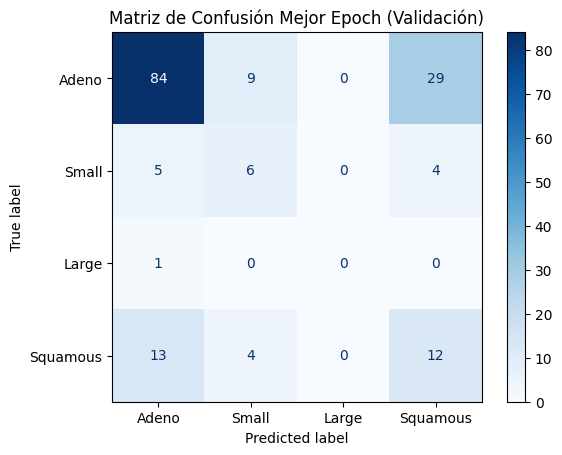

Accuracy: 0.6108
F1-Score: 0.6335


In [ ]:
trained_model, best_results = train_model(model, train_loader, val_loader, criterion, optimizer, device, epochs)
evaluate_model(best_results)

In [80]:
def get_prediction_info(model, val_paths, val_labels, device):
    model.eval()
    predicted = []
    actual = []
    all_paths = []

    for path, label in zip(val_paths, val_labels):
        vol = np.load(path)
        vol = np.clip(vol, 0, 1)
        vol = np.expand_dims(vol, axis=0).astype(np.float32)
        tensor = torch.tensor(vol).unsqueeze(0).to(device)
        with torch.no_grad():
            out = model(tensor)
            pred = torch.argmax(out, dim=1).item()
        predicted.append(pred)
        actual.append(label)
        all_paths.append(path)

    return list(zip(all_paths, actual, predicted))

In [ ]:
def mostrar_gradcams_varios(model, val_paths, val_labels, device, max_ejemplos=5):
    casos = get_prediction_info(model, val_paths, val_labels, device)
    por_clase = {i: {"aciertos": [], "fallos": []} for i in range(4)}

    for path, real, pred in casos:
        if real == pred:
            por_clase[real]["aciertos"].append((path, real, pred))
        else:
            por_clase[real]["fallos"].append((path, real, pred))

    for clase in range(4):
        print(f"\n Visualizando para clase {clase}:")

        # ACIERTOS
        aciertos = por_clase[clase]["aciertos"][:max_ejemplos]
        print(f"\n {len(aciertos)} casos correctamente clasificados")
        for path, real, pred in aciertos:
            vol = np.load(path)
            vol = np.clip(vol, 0, 1)
            vol = np.expand_dims(vol, axis=0).astype(np.float32)
            tensor = torch.tensor(vol).unsqueeze(0)
            print(f" {os.path.basename(path)} — Real: {real}, Predicho: {pred}")
            apply_gradcam(model, tensor, target_class=real, device=device)

        # FALLOS
        fallos = por_clase[clase]["fallos"][:max_ejemplos]
        print(f"\n {len(fallos)} casos mal clasificados")
        for path, real, pred in fallos:
            vol = np.load(path)
            vol = np.clip(vol, 0, 1)
            vol = np.expand_dims(vol, axis=0).astype(np.float32)
            tensor = torch.tensor(vol).unsqueeze(0)
            print(f" {os.path.basename(path)} — Real: {real}, Predicho: {pred}")
            apply_gradcam(model, tensor, target_class=pred, device=device)



🔍 Visualizando para clase 0:

✅ 5 casos correctamente clasificados
✅ 0_Lung_Dx-A0221_5.npy — Real: 0, Predicho: 0


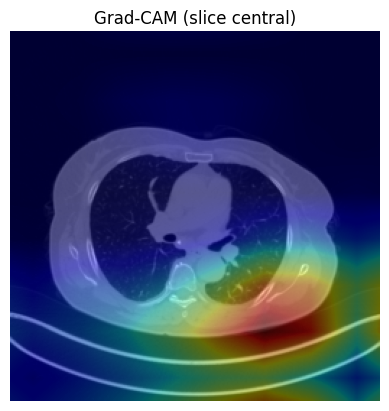

✅ 0_Lung_Dx-A0042_2.npy — Real: 0, Predicho: 0


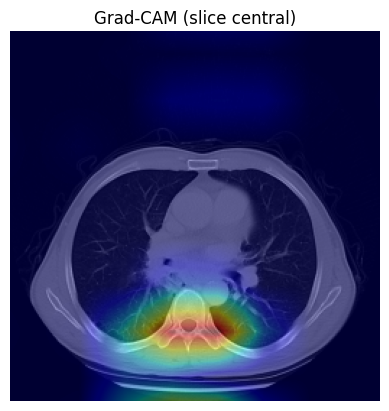

✅ 0_Lung_Dx-A0072_1.npy — Real: 0, Predicho: 0


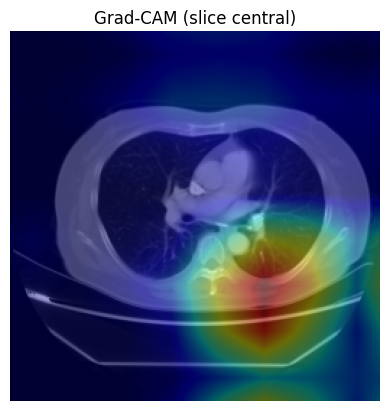

✅ 0_Lung_Dx-A0016_4.npy — Real: 0, Predicho: 0


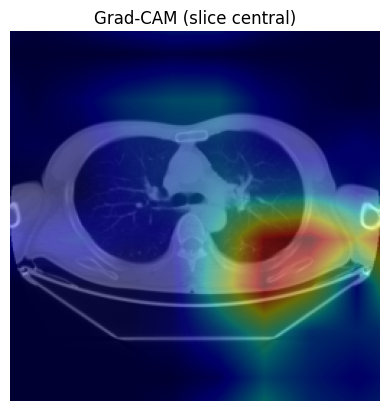

✅ 0_Lung_Dx-A0068_3.npy — Real: 0, Predicho: 0


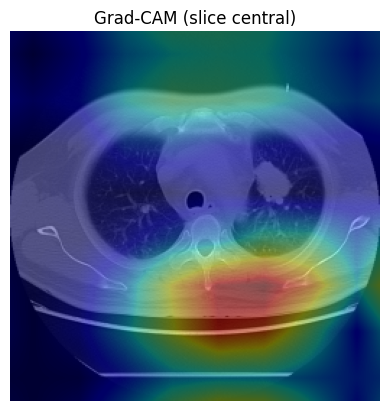


❌ 5 casos mal clasificados
❌ 0_Lung_Dx-A0213_4.npy — Real: 0, Predicho: 3


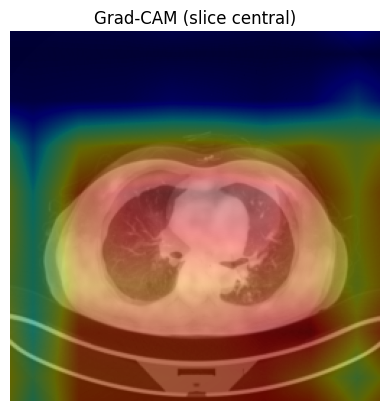

❌ 0_Lung_Dx-A0193_1.npy — Real: 0, Predicho: 3


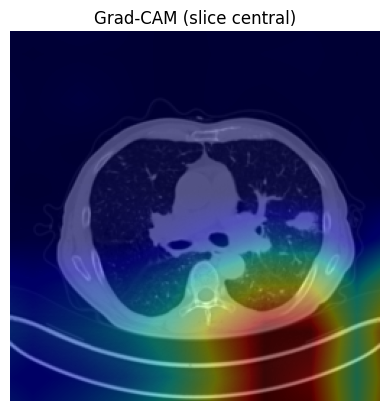

❌ 0_Lung_Dx-A0167_1.npy — Real: 0, Predicho: 3


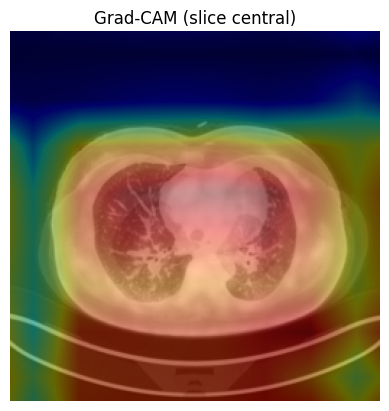

❌ 0_Lung_Dx-A0176_2.npy — Real: 0, Predicho: 3


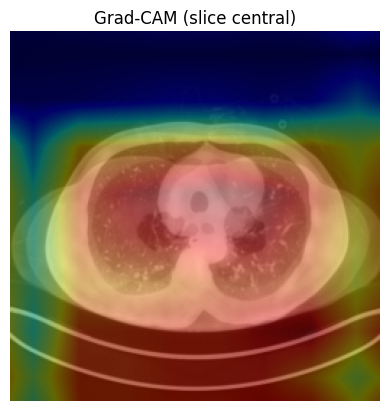

❌ 0_Lung_Dx-A0233_4.npy — Real: 0, Predicho: 3


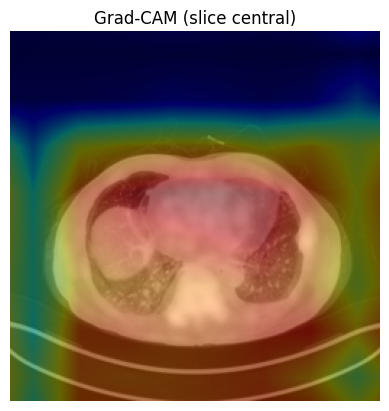


🔍 Visualizando para clase 1:

✅ 0 casos correctamente clasificados

❌ 5 casos mal clasificados
❌ 1_Lung_Dx-B0034_2.npy — Real: 1, Predicho: 0


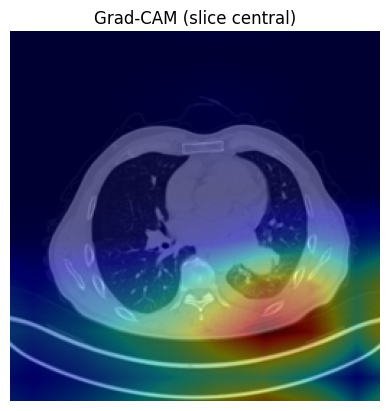

❌ 1_Lung_Dx-B0034_4.npy — Real: 1, Predicho: 3


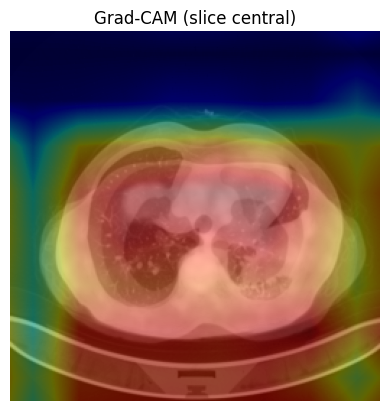

❌ 1_Lung_Dx-B0026_1.npy — Real: 1, Predicho: 0


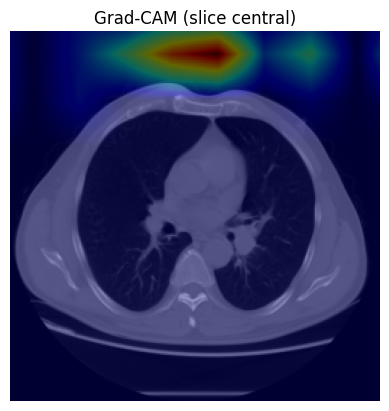

❌ 1_Lung_Dx-B0037_3.npy — Real: 1, Predicho: 3


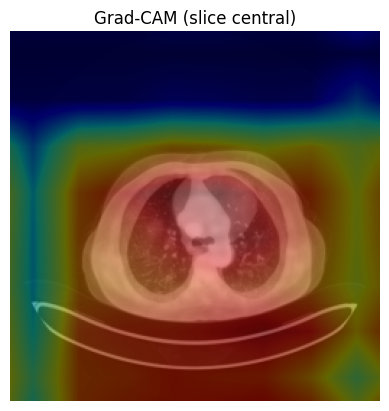

❌ 1_Lung_Dx-B0040_4.npy — Real: 1, Predicho: 0


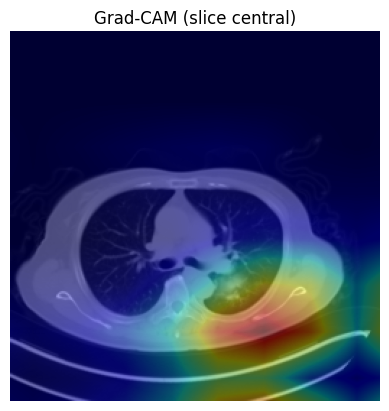


🔍 Visualizando para clase 2:

✅ 0 casos correctamente clasificados

❌ 1 casos mal clasificados
❌ 2_Lung_Dx-E0004_1.npy — Real: 2, Predicho: 0


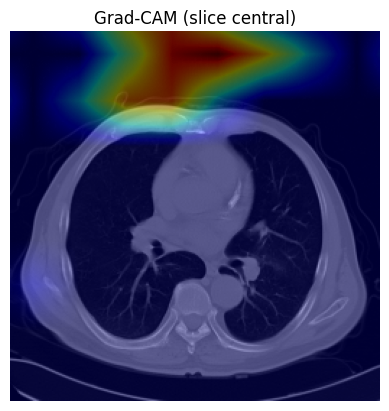


🔍 Visualizando para clase 3:

✅ 5 casos correctamente clasificados
✅ 3_Lung_Dx-G0045_2.npy — Real: 3, Predicho: 3


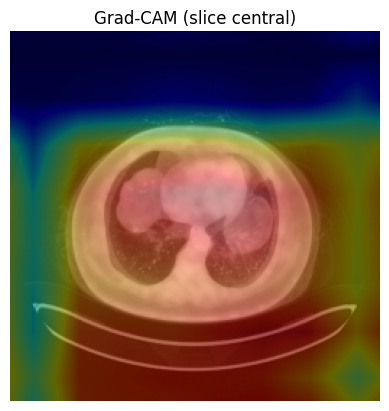

✅ 3_Lung_Dx-G0051_1.npy — Real: 3, Predicho: 3


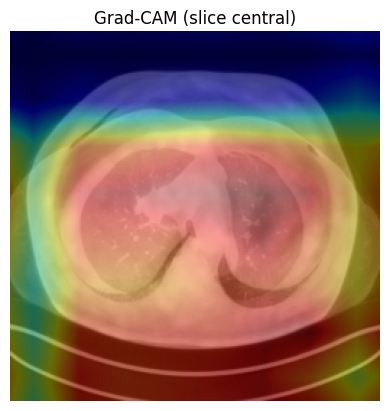

✅ 3_Lung_Dx-G0044_2.npy — Real: 3, Predicho: 3


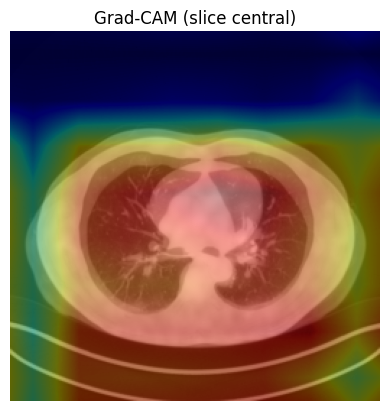

✅ 3_Lung_Dx-G0033_1.npy — Real: 3, Predicho: 3


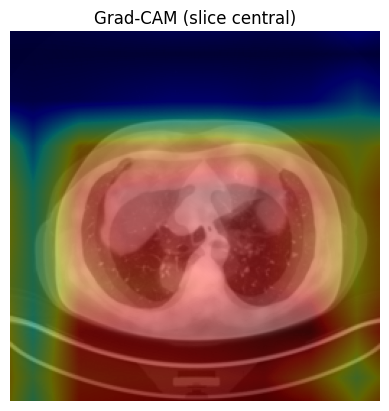

✅ 3_Lung_Dx-G0060_2.npy — Real: 3, Predicho: 3


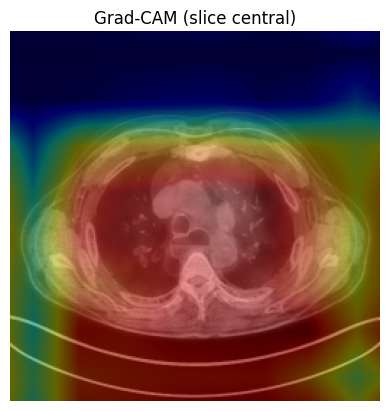


❌ 5 casos mal clasificados
❌ 3_Lung_Dx-G0032_4.npy — Real: 3, Predicho: 0


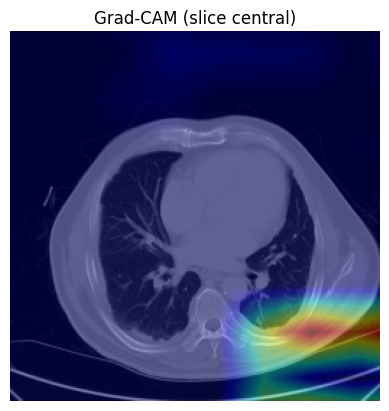

❌ 3_Lung_Dx-G0013_2.npy — Real: 3, Predicho: 0


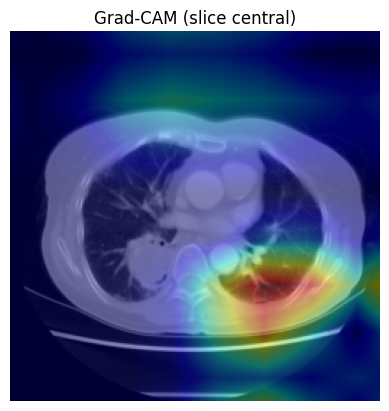

❌ 3_Lung_Dx-G0040_2.npy — Real: 3, Predicho: 0


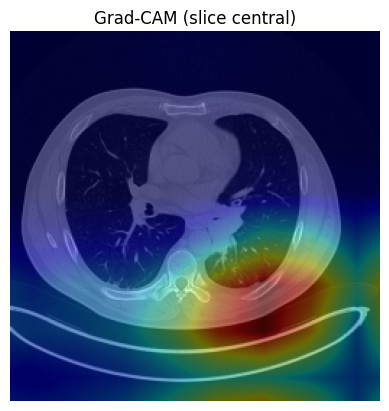

❌ 3_Lung_Dx-G0016_1.npy — Real: 3, Predicho: 0


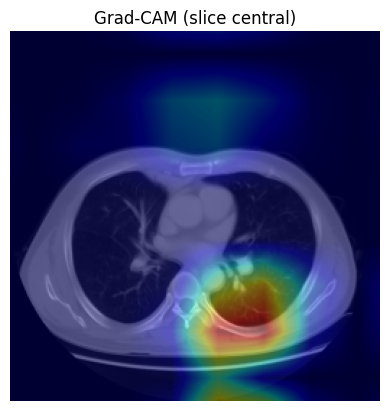

❌ 3_Lung_Dx-G0053_4.npy — Real: 3, Predicho: 0


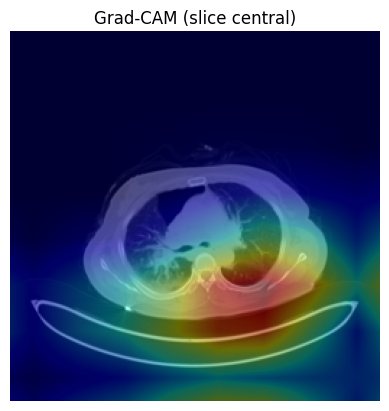

In [ ]:
mostrar_gradcams_varios(model, val_paths, val_labels, device, max_ejemplos=5)

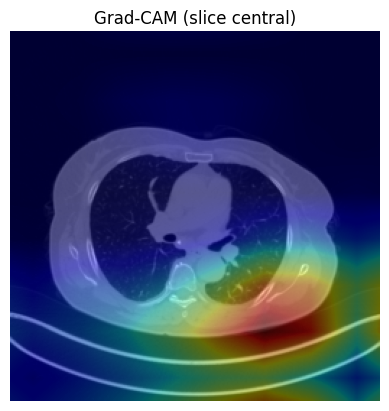

In [ ]:
# Visualizar con Grad-CAM
sample_path = val_paths[0]
sample_label = val_labels[0]
sample_volume = np.load(sample_path)
sample_volume = np.clip(sample_volume, 0, 1)
sample_volume = np.expand_dims(sample_volume, axis=0).astype(np.float32)
sample_tensor = torch.tensor(sample_volume).unsqueeze(0)
apply_gradcam(model, sample_tensor, target_class=sample_label, device=device)

In [ ]:
torch.save(model.state_dict(), "modelo_preentrenado_dataset_generico_3d_tipos_cancer.pth")

Con WeightedRandomSampler:

In [ ]:
from torch.utils.data import WeightedRandomSampler

# 1. Contar frecuencia de cada clase en train
class_counts = Counter(train_labels)
class_weights = {cls: 1.0 / count for cls, count in class_counts.items()}

# 2. Asignar peso a cada muestra
sample_weights = [class_weights[label] for label in train_labels]

# 3. Crear sampler
sampler = WeightedRandomSampler(
    weights=sample_weights,
    num_samples=len(sample_weights),
    replacement=True
)

In [ ]:
# 4. DataLoader con sampler (sin shuffle)
train_loader = DataLoader(
    train_dataset,
    batch_size=batch_size,
    sampler=sampler,
    num_workers=2,
    pin_memory=True
)

In [ ]:
criterion = nn.CrossEntropyLoss()

Epoch 1: 100%|██████████| 118/118 [08:29<00:00,  4.32s/it]

[Train] Epoch 1, Loss: 134.1229, Acc: 0.4798, F1: 0.4608


[Val] Epoch 1, Loss: 19.3664, Acc: 0.6287, F1: 0.6438


Epoch 2: 100%|██████████| 118/118 [08:22<00:00,  4.26s/it]

[Train] Epoch 2, Loss: 111.9202, Acc: 0.5638, F1: 0.5485


[Val] Epoch 2, Loss: 42.9277, Acc: 0.1437, F1: 0.1063


Epoch 3: 100%|██████████| 118/118 [08:23<00:00,  4.27s/it]

[Train] Epoch 3, Loss: 103.0800, Acc: 0.5894, F1: 0.5762


[Val] Epoch 3, Loss: 40.0029, Acc: 0.2096, F1: 0.2592


Epoch 4: 100%|██████████| 118/118 [08:24<00:00,  4.27s/it]

[Train] Epoch 4, Loss: 92.6891, Acc: 0.6351, F1: 0.6326


[Val] Epoch 4, Loss: 27.5938, Acc: 0.2934, F1: 0.2682


Epoch 5: 100%|██████████| 118/118 [08:21<00:00,  4.25s/it]

[Train] Epoch 5, Loss: 92.0192, Acc: 0.6234, F1: 0.6085


[Val] Epoch 5, Loss: 17.9313, Acc: 0.6347, F1: 0.6331


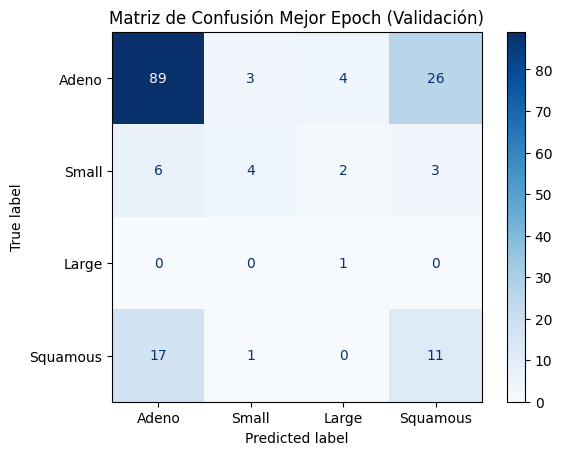

Accuracy: 0.6287
F1-Score: 0.6438


In [ ]:
trained_model, best_results = train_model(model, train_loader, val_loader, criterion, optimizer, device, epochs)
evaluate_model(best_results)


🔍 Visualizando para clase 0:

✅ 5 casos correctamente clasificados
✅ 0_Lung_Dx-A0221_5.npy — Real: 0, Predicho: 0


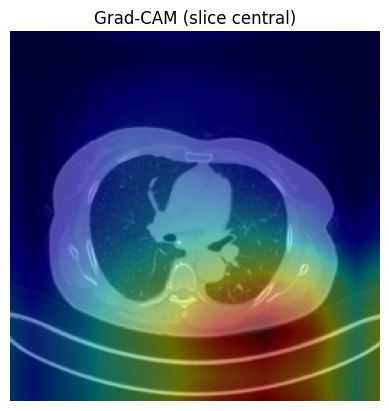

✅ 0_Lung_Dx-A0042_2.npy — Real: 0, Predicho: 0


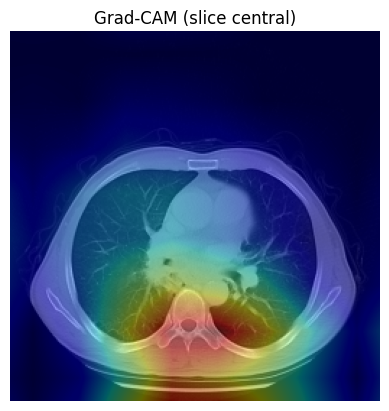

✅ 0_Lung_Dx-A0213_4.npy — Real: 0, Predicho: 0


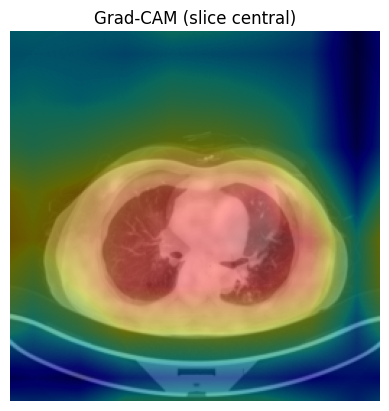

✅ 0_Lung_Dx-A0072_1.npy — Real: 0, Predicho: 0


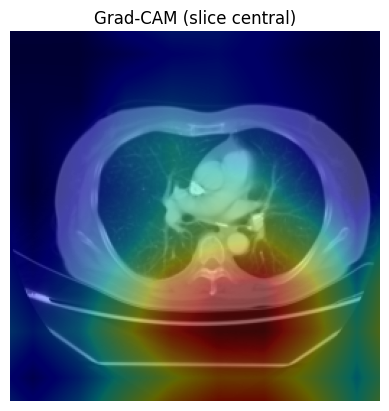

✅ 0_Lung_Dx-A0016_4.npy — Real: 0, Predicho: 0


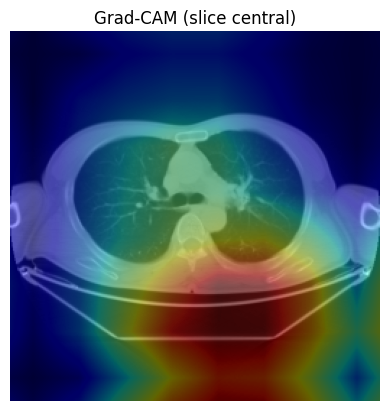


❌ 5 casos mal clasificados
❌ 0_Lung_Dx-A0143_2.npy — Real: 0, Predicho: 3


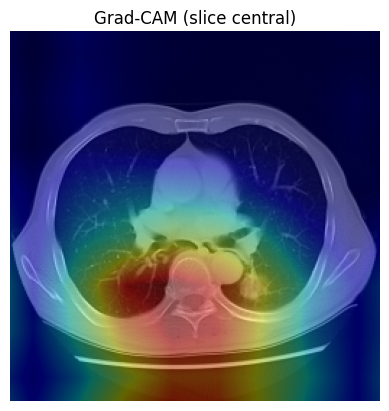

❌ 0_Lung_Dx-A0157_1.npy — Real: 0, Predicho: 1


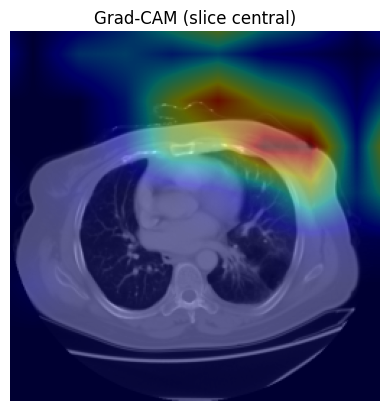

❌ 0_Lung_Dx-A0193_1.npy — Real: 0, Predicho: 3


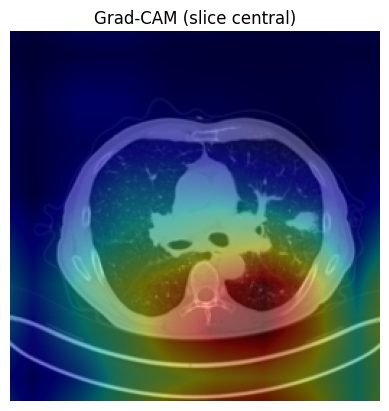

❌ 0_Lung_Dx-A0003_3.npy — Real: 0, Predicho: 1


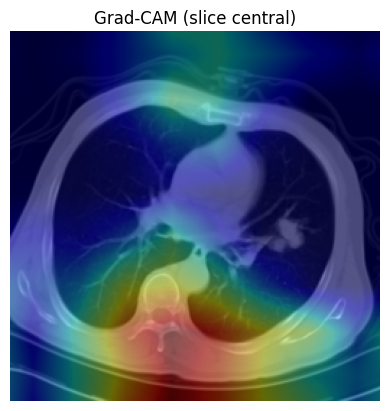

❌ 0_Lung_Dx-A0061_1.npy — Real: 0, Predicho: 1


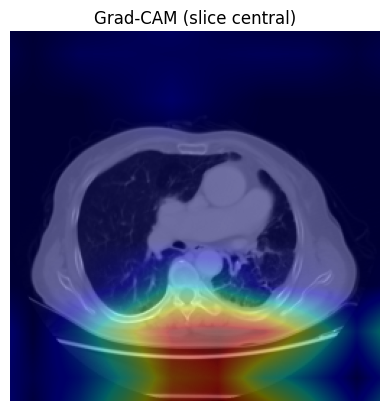


🔍 Visualizando para clase 1:

✅ 5 casos correctamente clasificados
✅ 1_Lung_Dx-B0026_1.npy — Real: 1, Predicho: 1


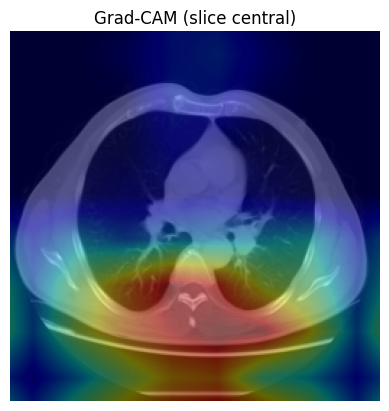

✅ 1_Lung_Dx-B0023_2.npy — Real: 1, Predicho: 1


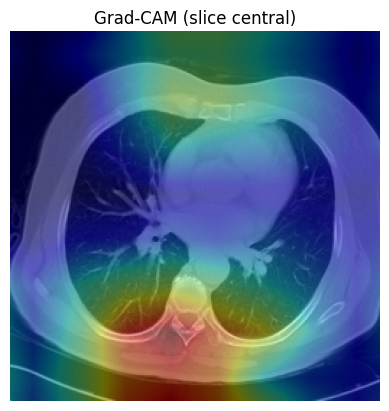

✅ 1_Lung_Dx-B0006_2.npy — Real: 1, Predicho: 1


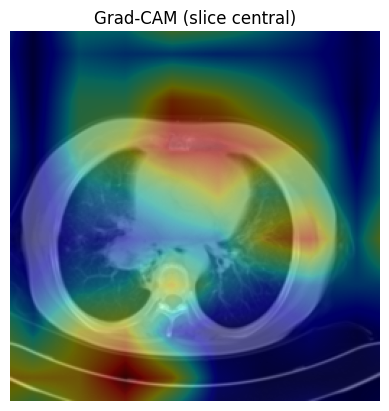

✅ 1_Lung_Dx-B0019_1.npy — Real: 1, Predicho: 1


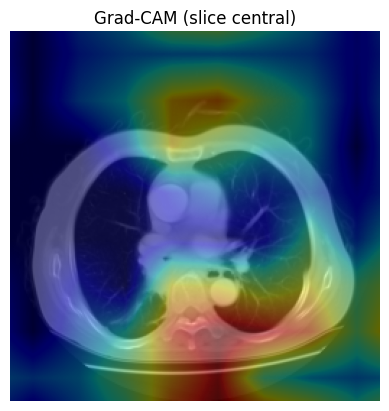

✅ 1_Lung_Dx-B0025_1.npy — Real: 1, Predicho: 1


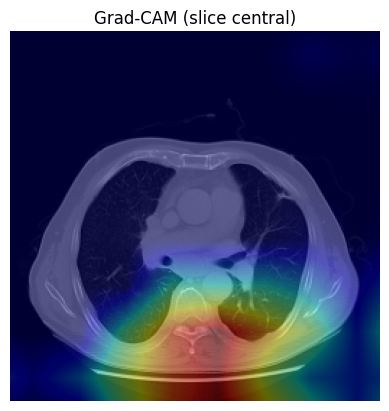


❌ 5 casos mal clasificados
❌ 1_Lung_Dx-B0034_2.npy — Real: 1, Predicho: 3


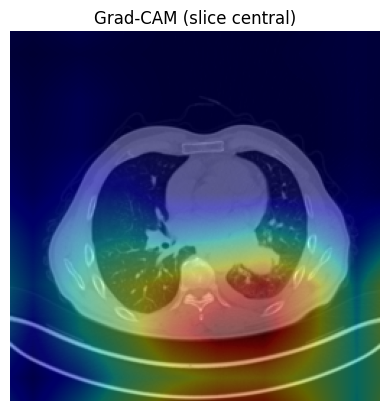

❌ 1_Lung_Dx-B0034_4.npy — Real: 1, Predicho: 0


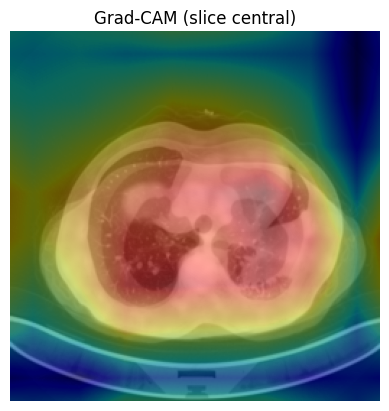

❌ 1_Lung_Dx-B0037_3.npy — Real: 1, Predicho: 0


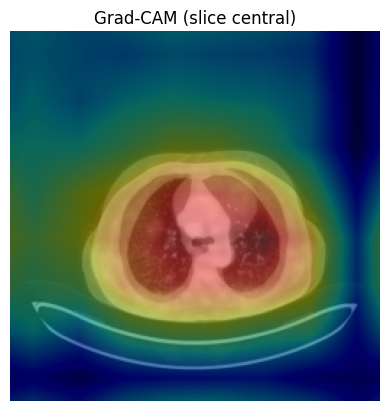

❌ 1_Lung_Dx-B0040_4.npy — Real: 1, Predicho: 0


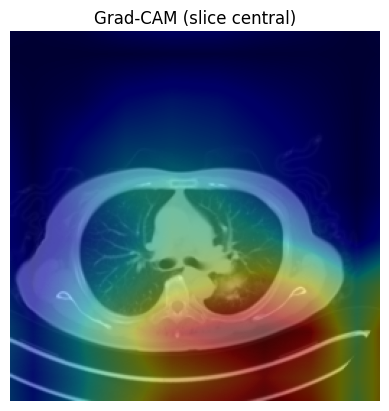

❌ 1_Lung_Dx-B0003_2.npy — Real: 1, Predicho: 0


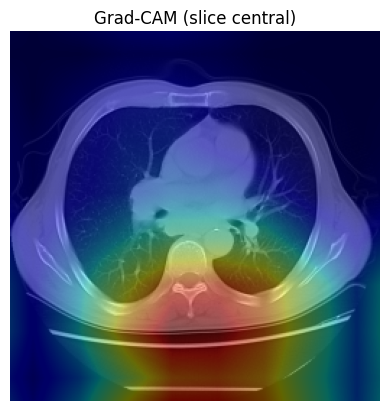


🔍 Visualizando para clase 2:

✅ 1 casos correctamente clasificados
✅ 2_Lung_Dx-E0004_1.npy — Real: 2, Predicho: 2


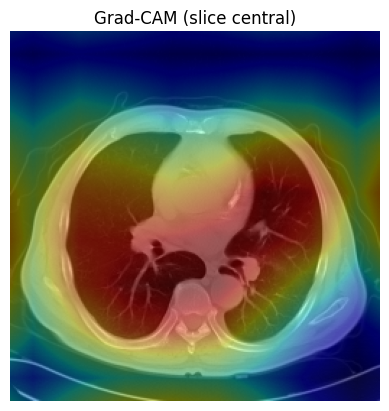


❌ 0 casos mal clasificados

🔍 Visualizando para clase 3:

✅ 5 casos correctamente clasificados
✅ 3_Lung_Dx-G0032_4.npy — Real: 3, Predicho: 3


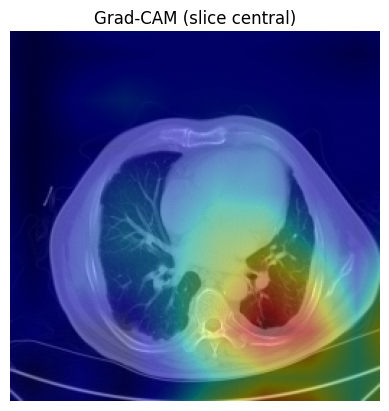

✅ 3_Lung_Dx-G0016_1.npy — Real: 3, Predicho: 3


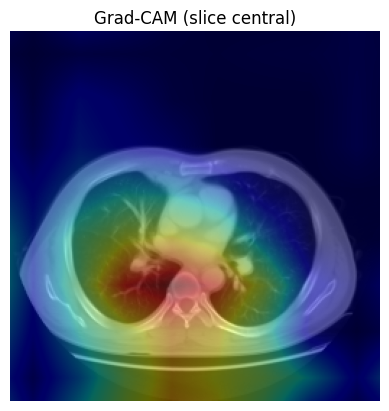

✅ 3_Lung_Dx-G0050_2.npy — Real: 3, Predicho: 3


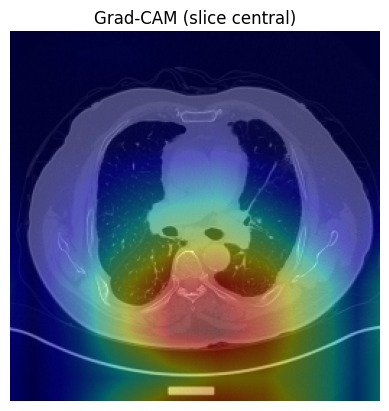

✅ 3_Lung_Dx-G0020_2.npy — Real: 3, Predicho: 3


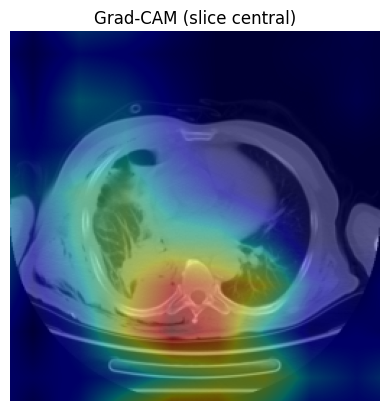

✅ 3_Lung_Dx-G0003_1.npy — Real: 3, Predicho: 3


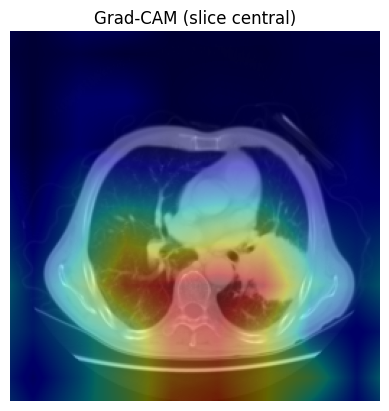


❌ 5 casos mal clasificados
❌ 3_Lung_Dx-G0045_2.npy — Real: 3, Predicho: 0


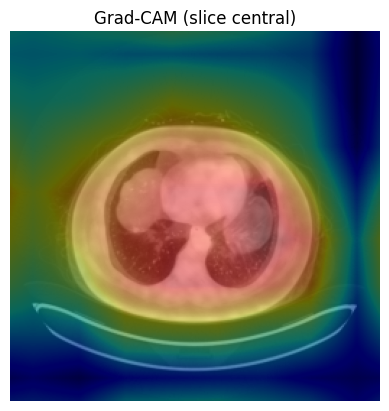

❌ 3_Lung_Dx-G0051_1.npy — Real: 3, Predicho: 0


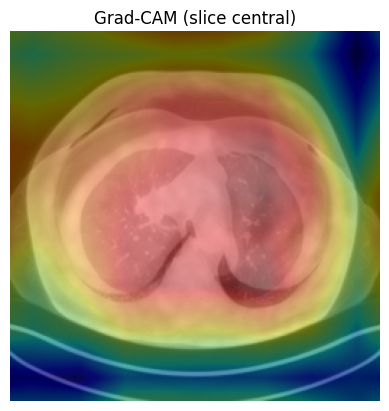

❌ 3_Lung_Dx-G0013_2.npy — Real: 3, Predicho: 1


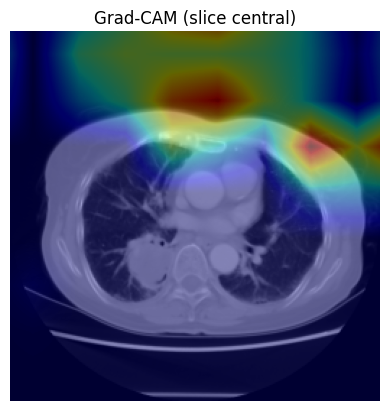

❌ 3_Lung_Dx-G0040_2.npy — Real: 3, Predicho: 0


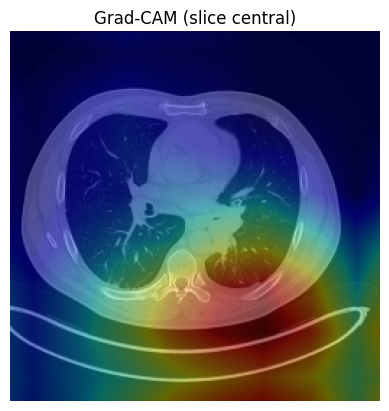

❌ 3_Lung_Dx-G0053_4.npy — Real: 3, Predicho: 0


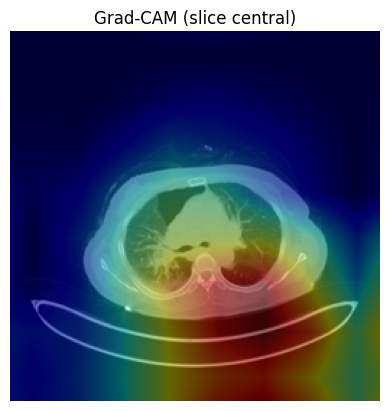

In [ ]:
mostrar_gradcams_varios(model, val_paths, val_labels, device, max_ejemplos=5)

## 3D con mi dataset

In [6]:
device = "cuda" if torch.cuda.is_available() else "cpu"

In [6]:
def apply_3d_window(volume, window_level=-600, window_width=1500):
    """
    Aplica ventana HU a un volumen 3D completo.
    
    Parámetros:
        volume: numpy array 3D (depth, height, width) en unidades Hounsfield (HU)
        window_level: Centro de la ventana (típico pulmonar: -600 HU)
        window_width: Ancho de ventana (típico pulmonar: 1500 HU)
    
    Returns:
        Volumen normalizado a [0,1] según la ventana seleccionada
    """
    min_val = window_level - window_width/2
    max_val = window_level + window_width/2
    
    # Aplicar ventana y normalizar
    windowed = np.clip(volume, min_val, max_val)
    normalized = (windowed - min_val) / (max_val - min_val)
    
    return normalized.astype(np.float32)

In [9]:
class LungCTDataset(Dataset):
    def __init__(self, data_dir, labels_dict, transform=None):
        self.data_dir = data_dir
        self.patients = list(labels_dict.keys())
        self.labels = labels_dict
        self.transform = transform
    
    def __len__(self):
        return len(self.patients)
    
    def __getitem__(self, idx):
        patient_id = self.patients[idx]
        volume_path = os.path.join(self.data_dir, f"{patient_id}.npy")
        volume = np.load(volume_path)  # Cargar volumen preprocesado (256, 512, 512)
        # Aplicar ventana pulmonar
        volume = apply_3d_window(volume, window_level=-600, window_width=1500)
        volume = np.expand_dims(volume, axis=0)
        label = self.labels[patient_id]
        
        if self.transform:
            volume = self.transform(volume)
        
        return volume, torch.tensor(label, dtype=torch.long)

In [10]:
from monai.transforms import Compose, EnsureChannelFirst, ScaleIntensity, ToTensor, EnsureType

transform = Compose([
    #EnsureChannelFirst(), #para que sea del tipo (1, 256, 512, 512)
    EnsureType()
])

In [11]:
NPY_DIR="preprocessed_data_3d"
BATCH_SIZE = 1 #(he intentado subirlo mas pero da out of memory)
TARGET_SIZE = (512, 512)

In [13]:
dataset = LungCTDataset(NPY_DIR, labels_dict_numeric, transform=transform)

In [14]:
# División en 85% entrenamiento y 15% validación
train_size = int(0.86 * len(dataset))
val_size = len(dataset) - train_size
train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

In [15]:
#obtenemos los indices de cada conjunto
train_indices = train_dataset.indices  # Índices del conjunto de entrenamiento
val_indices = val_dataset.indices  

In [16]:
from collections import Counter
# 2. Contar etiquetas en cada conjunto
def count_labels(dataset, indices):
    labels = []
    for idx in indices:
        _, label = dataset[idx]  # Asumiendo que tu dataset devuelve (volumen, label, id)
        labels.append(label.item() if torch.is_tensor(label) else label)
    return Counter(labels)

# Contar en train y val
train_counts = count_labels(dataset, train_indices)
val_counts = count_labels(dataset, val_indices)


In [17]:
# 3. Mostrar resultados
print("\nDistribución de clases:")
print(f"Entrenamiento - Total: {train_size} | Clase 0: {train_counts[0]} | Clase 1: {train_counts[1]}")
print(f"Validación - Total: {val_size} | Clase 0: {val_counts[0]} | Clase 1: {val_counts[1]}")



Distribución de clases:
Entrenamiento - Total: 61 | Clase 0: 40 | Clase 1: 21
Validación - Total: 11 | Clase 0: 10 | Clase 1: 1


In [18]:
train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=2, pin_memory=True)
val_loader = DataLoader(val_dataset, batch_size=BATCH_SIZE, shuffle=False, num_workers=2, pin_memory=True)

In [19]:
#modelo MONAI
model = DenseNet121(
    spatial_dims=3,          # 3D
    in_channels=1,           # Canales de entrada
    out_channels=2          # Salida binaria
    #pretrained=False,        # sin pesos preentrenados
    #dropout_prob=0.2         # Regularización
).to(device)

In [39]:
optimizer = optim.Adam(model.parameters(), lr=1e-4)

In [40]:
# Configuración de entrenamiento sin ponderacion de pesos
criterion = nn.CrossEntropyLoss()

In [32]:
# Loop de entrenamiento
def train_model(model, train_loader, val_loader, criterion, optimizer, epochs=10):
    model.train()
    for epoch in range(epochs):
        running_loss = 0.0
        all_preds, all_labels = [], []
        for inputs, labels in tqdm(train_loader):
            #labels = labels.float().unsqueeze(1)
            inputs, labels = inputs.cuda(), labels.cuda()
            optimizer.zero_grad()
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()
            running_loss += loss.item()
            
            preds = torch.argmax(outputs, dim=1).cpu().numpy()
            all_preds.extend(preds)
            all_labels.extend(labels.cpu().numpy())
        
        acc = accuracy_score(all_labels, all_preds)
        f1 = f1_score(all_labels, all_preds)
        print(f"Epoch {epoch+1}, Loss: {running_loss:.4f}, Accuracy: {acc:.4f}, F1 Score: {f1:.4f}")
        
        # Validación
        model.eval()
        val_preds, val_labels = [], []
        val_loss = 0.0
        with torch.no_grad():
            for val_inputs, val_labels_batch in tqdm(val_loader):
                val_inputs, val_labels_batch = val_inputs.cuda(), val_labels_batch.cuda()
                val_outputs = model(val_inputs)
                val_loss += criterion(val_outputs, val_labels_batch).item()
                
                val_preds_batch = torch.argmax(val_outputs, dim=1).cpu().numpy()
                val_preds.extend(val_preds_batch)
                val_labels.extend(val_labels_batch.cpu().numpy())
        
        val_acc = accuracy_score(val_labels, val_preds)
        val_f1 = f1_score(val_labels, val_preds)
        print(f"Validation - Loss: {val_loss:.4f}, Accuracy: {val_acc:.4f}, F1 Score: {val_f1:.4f}")
        model.train()

In [42]:
train_model(model, train_loader, val_loader, criterion, optimizer, epochs=10)

100%|██████████| 61/61 [01:40<00:00,  1.65s/it]


Epoch 1, Loss: 41.1475, Accuracy: 0.6557, F1 Score: 0.0000


100%|██████████| 11/11 [00:35<00:00,  3.21s/it]


Validation - Loss: 6.1806, Accuracy: 0.7273, F1 Score: 0.0000


100%|██████████| 61/61 [01:33<00:00,  1.53s/it]


Epoch 2, Loss: 39.4691, Accuracy: 0.6885, F1 Score: 0.0000


100%|██████████| 11/11 [00:21<00:00,  1.99s/it]


Validation - Loss: 6.7601, Accuracy: 0.7273, F1 Score: 0.0000


100%|██████████| 61/61 [01:45<00:00,  1.73s/it]


Epoch 3, Loss: 38.1825, Accuracy: 0.6885, F1 Score: 0.0000


100%|██████████| 11/11 [00:19<00:00,  1.81s/it]


Validation - Loss: 5.9557, Accuracy: 0.7273, F1 Score: 0.0000


100%|██████████| 61/61 [01:47<00:00,  1.76s/it]


Epoch 4, Loss: 37.9609, Accuracy: 0.6885, F1 Score: 0.0000


100%|██████████| 11/11 [00:24<00:00,  2.21s/it]


Validation - Loss: 6.5499, Accuracy: 0.7273, F1 Score: 0.0000


100%|██████████| 61/61 [01:46<00:00,  1.74s/it]


Epoch 5, Loss: 38.0871, Accuracy: 0.6885, F1 Score: 0.0000


100%|██████████| 11/11 [00:06<00:00,  1.81it/s]


Validation - Loss: 6.6696, Accuracy: 0.7273, F1 Score: 0.0000


100%|██████████| 61/61 [01:41<00:00,  1.67s/it]


Epoch 6, Loss: 39.6044, Accuracy: 0.6885, F1 Score: 0.0000


100%|██████████| 11/11 [00:08<00:00,  1.25it/s]


Validation - Loss: 6.6600, Accuracy: 0.7273, F1 Score: 0.0000


100%|██████████| 61/61 [01:32<00:00,  1.52s/it]


Epoch 7, Loss: 38.5076, Accuracy: 0.6885, F1 Score: 0.0000


100%|██████████| 11/11 [00:14<00:00,  1.31s/it]


Validation - Loss: 6.6848, Accuracy: 0.7273, F1 Score: 0.0000


100%|██████████| 61/61 [01:35<00:00,  1.56s/it]


Epoch 8, Loss: 37.1545, Accuracy: 0.6885, F1 Score: 0.0000


100%|██████████| 11/11 [00:13<00:00,  1.27s/it]


Validation - Loss: 6.5136, Accuracy: 0.7273, F1 Score: 0.0000


100%|██████████| 61/61 [01:46<00:00,  1.75s/it]


Epoch 9, Loss: 36.2459, Accuracy: 0.7377, F1 Score: 0.2727


100%|██████████| 11/11 [00:10<00:00,  1.03it/s]


Validation - Loss: 7.4414, Accuracy: 0.7273, F1 Score: 0.0000


100%|██████████| 61/61 [01:38<00:00,  1.61s/it]


Epoch 10, Loss: 37.3396, Accuracy: 0.6885, F1 Score: 0.0000


100%|██████████| 11/11 [00:12<00:00,  1.18s/it]

Validation - Loss: 6.8520, Accuracy: 0.6364, F1 Score: 0.0000


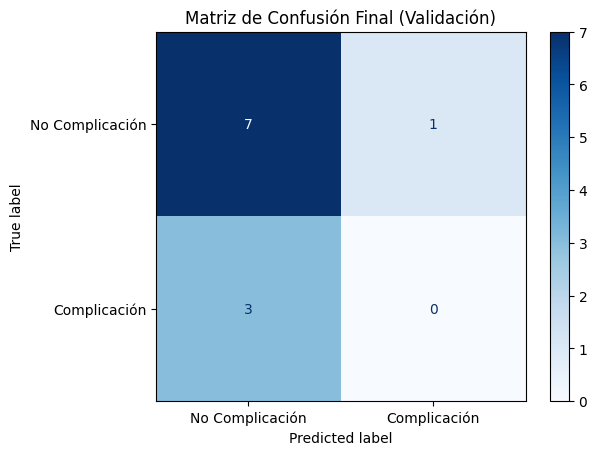

Accuracy: 0.6364
F1-Score: 0.0000


In [43]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

# 1. Poner el modelo en modo evaluación
model.eval()

# 2. Listas para almacenar predicciones y etiquetas reales
all_preds = []
all_labels = []

# 3. Iterar sobre el DataLoader de validación
with torch.no_grad():
    for inputs, labels in val_loader:
        inputs = inputs.to(device)
        outputs = model(inputs)
        
        # Para clasificación binaria con 2 neuronas de salida (out_channels=2)
        preds = torch.argmax(outputs, dim=1).cpu().numpy()
        
        all_preds.extend(preds)
        all_labels.extend(labels.cpu().numpy())

# 4. Calcular y mostrar la matriz
cm = confusion_matrix(all_labels, all_preds)
disp = ConfusionMatrixDisplay(confusion_matrix=cm,
                             display_labels=["No Complicación", "Complicación"])
disp.plot(cmap='Blues')
plt.title("Matriz de Confusión Final (Validación)")
plt.show()

# 5. Métricas adicionales
print(f"Accuracy: {accuracy_score(all_labels, all_preds):.4f}")
print(f"F1-Score: {f1_score(all_labels, all_preds):.4f}")

#### Ponderacion con CrossEntropyLoss

Vamos a intentar remediar el problema del desbalanceo de las clases. Primero vamos a probar a ponderar la pérdidad con CrossEntropyLoss agregando pesos para balancear el impacto de cada clase. 

In [27]:
from monai.transforms import Compose, EnsureChannelFirst, ScaleIntensity, ToTensor, EnsureType

transform = Compose([
    #EnsureChannelFirst(), #para que sea del tipo (1, 256, 512, 512)
    EnsureType()
])

In [28]:
dataset = LungCTDataset(NPY_DIR, labels_dict_numeric, transform=transform)

In [29]:
# División en 86% entrenamiento y 14% validación
train_size = int(0.86 * len(dataset))
val_size = len(dataset) - train_size
train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

In [30]:
# Contar la cantidad de ejemplos por clase
labels = np.array(list(labels_dict_numeric.values()))
class_counts = np.bincount(labels)  # Cuenta 0s y 1s
total_samples = len(labels)

# Calcular pesos inversos (menos ejemplos = más peso)
weights = torch.tensor([total_samples / class_counts[0], total_samples / class_counts[1]], dtype=torch.float32).cuda()

In [31]:
# Configuración de entrenamiento con la loss ponderada
criterion = nn.CrossEntropyLoss(weight=weights)

In [32]:
train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=2, pin_memory=True)
val_loader = DataLoader(val_dataset, batch_size=BATCH_SIZE, shuffle=False, num_workers=2, pin_memory=True)

In [ ]:
#modelo MONAI
model = DenseNet121(
    spatial_dims=3,          # 3D
    in_channels=1,           # Canales de entrada
    out_channels=2          # Salida binaria
    #pretrained=False,        # sin pesos preentrenados
    #dropout_prob=0.2         # Regularización
).to(device)

In [35]:
optimizer = optim.Adam(model.parameters(), lr=1e-4)

In [89]:
#prueba con ponderacion de perdida con CrossEntropyLoss(weight=weights)
train_model(model, train_loader, val_loader, criterion, optimizer, epochs=10)

100%|██████████| 61/61 [02:05<00:00,  2.05s/it]


Epoch 1, Loss: 39.0879, Accuracy: 0.6721, F1 Score: 0.2857


100%|██████████| 11/11 [00:25<00:00,  2.30s/it]


Validation - Loss: 6.7185, Accuracy: 0.6364, F1 Score: 0.0000


100%|██████████| 61/61 [02:09<00:00,  2.12s/it]


Epoch 2, Loss: 38.0017, Accuracy: 0.7049, F1 Score: 0.0000


100%|██████████| 11/11 [00:28<00:00,  2.59s/it]


Validation - Loss: 7.2644, Accuracy: 0.6364, F1 Score: 0.0000


100%|██████████| 61/61 [02:33<00:00,  2.52s/it]


Epoch 3, Loss: 38.0827, Accuracy: 0.7049, F1 Score: 0.0000


100%|██████████| 11/11 [00:17<00:00,  1.58s/it]


Validation - Loss: 6.6970, Accuracy: 0.7273, F1 Score: 0.4000


100%|██████████| 61/61 [02:00<00:00,  1.98s/it]


Epoch 4, Loss: 37.3971, Accuracy: 0.7049, F1 Score: 0.0000


100%|██████████| 11/11 [00:31<00:00,  2.82s/it]


Validation - Loss: 8.2766, Accuracy: 0.6364, F1 Score: 0.0000


100%|██████████| 61/61 [02:11<00:00,  2.16s/it]


Epoch 5, Loss: 36.9704, Accuracy: 0.7049, F1 Score: 0.0000


100%|██████████| 11/11 [00:41<00:00,  3.77s/it]


Validation - Loss: 6.9541, Accuracy: 0.6364, F1 Score: 0.5000


100%|██████████| 61/61 [02:01<00:00,  1.99s/it]


Epoch 6, Loss: 36.9477, Accuracy: 0.7049, F1 Score: 0.1818


100%|██████████| 11/11 [00:17<00:00,  1.59s/it]


Validation - Loss: 7.7570, Accuracy: 0.6364, F1 Score: 0.0000


100%|██████████| 61/61 [02:00<00:00,  1.98s/it]


Epoch 7, Loss: 38.5735, Accuracy: 0.7049, F1 Score: 0.0000


100%|██████████| 11/11 [00:27<00:00,  2.48s/it]


Validation - Loss: 7.2328, Accuracy: 0.6364, F1 Score: 0.3333


100%|██████████| 61/61 [02:05<00:00,  2.06s/it]


Epoch 8, Loss: 38.2189, Accuracy: 0.7049, F1 Score: 0.0000


100%|██████████| 11/11 [00:32<00:00,  2.98s/it]


Validation - Loss: 7.1034, Accuracy: 0.6364, F1 Score: 0.0000


100%|██████████| 61/61 [02:15<00:00,  2.22s/it]


Epoch 9, Loss: 36.8207, Accuracy: 0.7049, F1 Score: 0.0000


100%|██████████| 11/11 [00:10<00:00,  1.03it/s]


Validation - Loss: 7.1141, Accuracy: 0.6364, F1 Score: 0.0000


100%|██████████| 61/61 [02:00<00:00,  1.98s/it]


Epoch 10, Loss: 36.9277, Accuracy: 0.7049, F1 Score: 0.0000


100%|██████████| 11/11 [00:27<00:00,  2.46s/it]


Validation - Loss: 7.2888, Accuracy: 0.6364, F1 Score: 0.0000


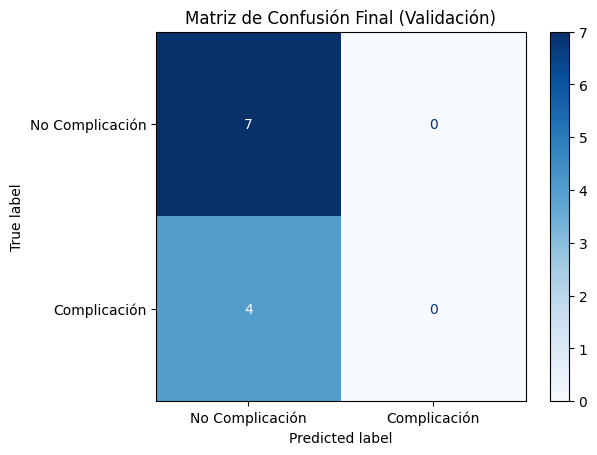

Accuracy: 0.6364
F1-Score: 0.0000


In [90]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

# 1. Poner el modelo en modo evaluación
model.eval()

# 2. Listas para almacenar predicciones y etiquetas reales
all_preds = []
all_labels = []

# 3. Iterar sobre el DataLoader de validación
with torch.no_grad():
    for inputs, labels in val_loader:
        inputs = inputs.to(device)
        outputs = model(inputs)
        
        # Para clasificación binaria con 2 neuronas de salida (out_channels=2)
        preds = torch.argmax(outputs, dim=1).cpu().numpy()
        
        all_preds.extend(preds)
        all_labels.extend(labels.cpu().numpy())

# 4. Calcular y mostrar la matriz
cm = confusion_matrix(all_labels, all_preds)
disp = ConfusionMatrixDisplay(confusion_matrix=cm,
                             display_labels=["No Complicación", "Complicación"])
disp.plot(cmap='Blues')
plt.title("Matriz de Confusión Final (Validación)")
plt.show()

# 5. Métricas adicionales
print(f"Accuracy: {accuracy_score(all_labels, all_preds):.4f}")
print(f"F1-Score: {f1_score(all_labels, all_preds):.4f}")

In [91]:
print(labels_dict)
print(labels_dict_numeric)

{'1MASh': 'Sí', '2HENX': 'No', '3HENX': 'No', '4HLSh': 'Sí', '5HANX': 'No', '6MASN': 'Sí', '7MPNX': 'No', '8HENX': 'No', '9MANX': 'No', '10MANX': 'No', '11HASh': 'Sí', '12HNSN': 'Sí', '13HANX': 'No', '14MLNX': 'No', '15MANX': 'No', '16HLNX': 'No', '17MANX': 'No', '18MANX': 'No', '19MANX': 'No', '20MMNX': 'No', '21MMiNX': 'No', '22MTNX': 'No', '23MMNX': 'No', '24MANX': 'No', '25HTNX': 'No', '26HMNX': 'No', '27HASD': 'Sí', '28HCGNX': 'No', '29HMeSX': 'Sí', '30MANX': 'No', '31MGNX': 'No', '32HENX': 'No', '33MANX': 'No', '34MASN': 'Sí', '35HENX': 'No', '36HENX': 'No', '37HPNX': 'No', '38HANX': 'No', '39MFNX': 'No', '40HANX': 'No', '41HAsNX': 'No', '42HNnNX': 'No', '43HESH': 'Sí', '44MTmNX': 'No', '45HNeSN': 'Sí', '46HANX': 'No', '47HESN': 'Sí', '48HTtSN': 'Sí', '49MMiSN': 'Sí', '50HANX': 'No', '51HFNX': 'No', '52HLNX': 'No', '53HANX': 'No', '54HANX': 'No', '55HASN': 'Sí', '56MANX': 'No', '57HTneNX': 'No', '58MASH': 'Sí', '59MMiNX': 'No', '60HESN': 'Sí', '61HASN': 'Sí', '62HENX': 'No', '63M

#### Oversampling de la clase minororitaria duplicando imagenes de la minoritaria

Vamos a hacer oversamplig de la clase minoritaria con WeightedRandomSampler (duplica ejemplos de la clase minoritaria)

In [55]:
from monai.transforms import Compose, EnsureChannelFirst, ScaleIntensity, ToTensor, EnsureType

transform = Compose([
    #EnsureChannelFirst(), #para que sea del tipo (1, 256, 512, 512)
    EnsureType()
])

In [56]:
dataset = LungCTDataset(NPY_DIR, labels_dict_numeric, transform=transform)

In [47]:
# División en 86% entrenamiento y 14% validación
train_size = int(0.86 * len(dataset))
val_size = len(dataset) - train_size
train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

In [57]:
# División en 86% entrenamiento y 14% validación
train_size = int(0.91 * len(dataset))
val_size = len(dataset) - train_size
train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

In [58]:
from torch.utils.data import WeightedRandomSampler
#calculamos el sampler para cada el train
def get_sampler(subset, power=1.0):
    # Obtener labels del subset
    subset_labels = [dataset.labels[dataset.patients[idx]] for idx in subset.indices]
    class_counts = np.bincount(subset_labels)
    weights = 1. / torch.tensor(class_counts**power, dtype=torch.float) #inverso al cuadrado para darle aun más peso a las clases minoritarias
    samples_weights = weights[subset_labels]
    return WeightedRandomSampler(samples_weights, len(samples_weights), replacement=True)


In [59]:
train_sampler = get_sampler(train_dataset, 1.7)

In [60]:
train_loader = DataLoader(
    train_dataset,
    batch_size=BATCH_SIZE,
    sampler=train_sampler, # Sampler de entrenamiento
    num_workers=4,
    pin_memory=True
)

val_loader = DataLoader(
    val_dataset,
    batch_size=BATCH_SIZE,
    num_workers=4,
    pin_memory=True
)

This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.


In [61]:
#modelo MONAI
model = DenseNet121(
    spatial_dims=3,          # 3D
    in_channels=1,           # Canales de entrada
    out_channels=2,          # Salida binaria
    #pretrained=False,        # sin pesos preentrenados
    dropout_prob=0.4         # Regularización
).to(device)

In [62]:
#optimizer = optim.Adam(model.parameters(), lr=1e-4)
optimizer = torch.optim.AdamW(model.parameters(), lr=1e-4, weight_decay=1e-5)
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', patience=2)

In [63]:
class FocalLoss(nn.Module):
    def __init__(self, alpha=0.25, gamma=2):
        super().__init__()
        self.alpha = alpha
        self.gamma = gamma

    def forward(self, inputs, targets):
        BCE_loss = F.cross_entropy(inputs, targets, reduction='none')
        pt = torch.exp(-BCE_loss)
        loss = self.alpha * (1-pt)**self.gamma * BCE_loss
        return loss.mean()

# Configuración de entrenamiento (con focal loss)
criterion = FocalLoss(alpha=0.9, gamma=1.8) # alpha ~1/clase_minoritaria

In [64]:
# con power=1.5
train_model(model, train_loader, val_loader, criterion, optimizer, epochs=10)


100%|██████████| 65/65 [02:09<00:00,  2.00s/it]


Epoch 1, Loss: 11.7288, Accuracy: 0.6462, F1 Score: 0.7810


100%|██████████| 7/7 [00:23<00:00,  3.36s/it]


Validation - Loss: 1.9904, Accuracy: 0.2857, F1 Score: 0.4444


100%|██████████| 65/65 [02:12<00:00,  2.04s/it]


Epoch 2, Loss: 11.7939, Accuracy: 0.5692, F1 Score: 0.6889


100%|██████████| 7/7 [00:18<00:00,  2.61s/it]


Validation - Loss: 1.7621, Accuracy: 0.2857, F1 Score: 0.4444


100%|██████████| 65/65 [02:07<00:00,  1.96s/it]


Epoch 3, Loss: 11.6982, Accuracy: 0.5231, F1 Score: 0.6667


100%|██████████| 7/7 [00:15<00:00,  2.28s/it]


Validation - Loss: 5.0847, Accuracy: 0.2857, F1 Score: 0.4444


100%|██████████| 65/65 [02:19<00:00,  2.14s/it]


Epoch 4, Loss: 11.9455, Accuracy: 0.5846, F1 Score: 0.7379


100%|██████████| 7/7 [00:21<00:00,  3.03s/it]


Validation - Loss: 4.6816, Accuracy: 0.2857, F1 Score: 0.4444


100%|██████████| 65/65 [02:08<00:00,  1.98s/it]


Epoch 5, Loss: 11.6107, Accuracy: 0.6000, F1 Score: 0.7500


100%|██████████| 7/7 [00:17<00:00,  2.48s/it]


Validation - Loss: 2.7389, Accuracy: 0.2857, F1 Score: 0.4444


100%|██████████| 65/65 [02:16<00:00,  2.09s/it]


Epoch 6, Loss: 11.5996, Accuracy: 0.5846, F1 Score: 0.7216


100%|██████████| 7/7 [00:14<00:00,  2.12s/it]


Validation - Loss: 2.0926, Accuracy: 0.2857, F1 Score: 0.4444


100%|██████████| 65/65 [02:09<00:00,  1.99s/it]


Epoch 7, Loss: 11.4314, Accuracy: 0.6308, F1 Score: 0.7647


100%|██████████| 7/7 [00:15<00:00,  2.14s/it]


Validation - Loss: 4.3266, Accuracy: 0.2857, F1 Score: 0.4444


100%|██████████| 65/65 [02:12<00:00,  2.04s/it]


Epoch 8, Loss: 10.5860, Accuracy: 0.7077, F1 Score: 0.8288


100%|██████████| 7/7 [00:10<00:00,  1.47s/it]


Validation - Loss: 3.8086, Accuracy: 0.2857, F1 Score: 0.4444


100%|██████████| 65/65 [02:07<00:00,  1.96s/it]


Epoch 9, Loss: 10.5346, Accuracy: 0.7077, F1 Score: 0.8288


100%|██████████| 7/7 [00:11<00:00,  1.57s/it]


Validation - Loss: 2.4604, Accuracy: 0.2857, F1 Score: 0.4444


100%|██████████| 65/65 [02:06<00:00,  1.95s/it]


Epoch 10, Loss: 11.5958, Accuracy: 0.6462, F1 Score: 0.7850


100%|██████████| 7/7 [00:12<00:00,  1.78s/it]

Validation - Loss: 3.0322, Accuracy: 0.2857, F1 Score: 0.4444


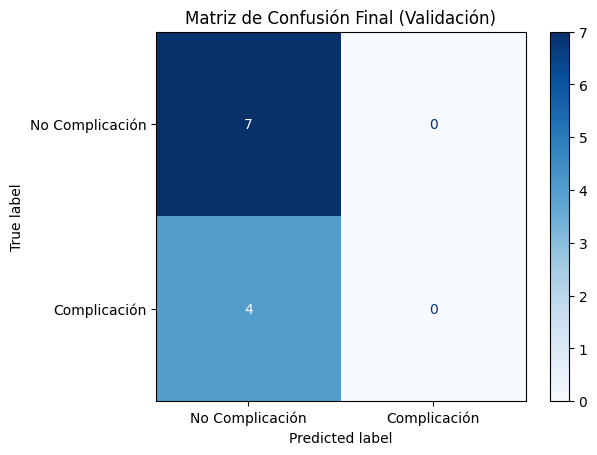

Accuracy: 0.6364
F1-Score: 0.0000


In [ ]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

# 1. Poner el modelo en modo evaluación
model.eval()

# 2. Listas para almacenar predicciones y etiquetas reales
all_preds = []
all_labels = []

# 3. Iterar sobre el DataLoader de validación
with torch.no_grad():
    for inputs, labels in val_loader:
        inputs = inputs.to(device)
        outputs = model(inputs)
        
        # Para clasificación binaria con 2 neuronas de salida (out_channels=2)
        preds = torch.argmax(outputs, dim=1).cpu().numpy()
        
        all_preds.extend(preds)
        all_labels.extend(labels.cpu().numpy())

# 4. Calcular y mostrar la matriz
cm = confusion_matrix(all_labels, all_preds)
disp = ConfusionMatrixDisplay(confusion_matrix=cm,
                             display_labels=["No Complicación", "Complicación"])
disp.plot(cmap='Blues')
plt.title("Matriz de Confusión Final (Validación)")
plt.show()

# 5. Métricas adicionales
print(f"Accuracy: {accuracy_score(all_labels, all_preds):.4f}")
print(f"F1-Score: {f1_score(all_labels, all_preds):.4f}")

In [33]:
# Guardar el modelo entrenado
torch.save(model.state_dict(), 'modelo_entrenado_WeightedRandomSampler.pth')
# Guardar el modelo completo (arquitectura + pesos)
torch.save(model, 'modelo_entrenado_completo_WeightedRandomSampler.pth')

In [34]:
# con power=2.0
train_model(model, train_loader, val_loader, criterion, optimizer, epochs=10)
# Guardar el modelo entrenado
torch.save(model.state_dict(), 'modelo_entrenado.pth')
# Guardar el modelo completo (arquitectura + pesos)
torch.save(model, 'modelo_entrenado_completo.pth')

100%|██████████| 61/61 [01:34<00:00,  1.55s/it]


Epoch 1, Loss: 42.1666, Accuracy: 0.5738, F1 Score: 0.7174


100%|██████████| 11/11 [00:16<00:00,  1.53s/it]


Validation - Loss: 8.6915, Accuracy: 0.4545, F1 Score: 0.5714


100%|██████████| 61/61 [01:38<00:00,  1.61s/it]


Epoch 2, Loss: 34.2594, Accuracy: 0.7705, F1 Score: 0.8704


100%|██████████| 11/11 [00:06<00:00,  1.80it/s]


Validation - Loss: 13.9807, Accuracy: 0.3636, F1 Score: 0.5333


100%|██████████| 61/61 [01:31<00:00,  1.50s/it]


Epoch 3, Loss: 35.9780, Accuracy: 0.7213, F1 Score: 0.8381


100%|██████████| 11/11 [00:09<00:00,  1.22it/s]


Validation - Loss: 12.7057, Accuracy: 0.3636, F1 Score: 0.5333


100%|██████████| 61/61 [01:45<00:00,  1.73s/it]


Epoch 4, Loss: 40.1477, Accuracy: 0.5902, F1 Score: 0.7368


100%|██████████| 11/11 [00:07<00:00,  1.38it/s]


Validation - Loss: 8.9344, Accuracy: 0.3636, F1 Score: 0.4615


100%|██████████| 61/61 [01:54<00:00,  1.88s/it]


Epoch 5, Loss: 38.3494, Accuracy: 0.6066, F1 Score: 0.7500


100%|██████████| 11/11 [00:09<00:00,  1.12it/s]


Validation - Loss: 9.6597, Accuracy: 0.4545, F1 Score: 0.5000


100%|██████████| 61/61 [01:32<00:00,  1.51s/it]


Epoch 6, Loss: 32.6662, Accuracy: 0.7541, F1 Score: 0.8598


100%|██████████| 11/11 [00:06<00:00,  1.74it/s]


Validation - Loss: 13.4827, Accuracy: 0.3636, F1 Score: 0.5333


100%|██████████| 61/61 [01:31<00:00,  1.50s/it]


Epoch 7, Loss: 30.0709, Accuracy: 0.7541, F1 Score: 0.8571


100%|██████████| 11/11 [00:07<00:00,  1.55it/s]


Validation - Loss: 20.7159, Accuracy: 0.3636, F1 Score: 0.5333


100%|██████████| 61/61 [01:35<00:00,  1.56s/it]


Epoch 8, Loss: 33.2581, Accuracy: 0.7213, F1 Score: 0.8381


100%|██████████| 11/11 [00:06<00:00,  1.77it/s]


Validation - Loss: 10.2582, Accuracy: 0.3636, F1 Score: 0.5333


100%|██████████| 61/61 [01:34<00:00,  1.55s/it]


Epoch 9, Loss: 39.2322, Accuracy: 0.6230, F1 Score: 0.7527


100%|██████████| 11/11 [00:06<00:00,  1.82it/s]


Validation - Loss: 9.2727, Accuracy: 0.3636, F1 Score: 0.5333


100%|██████████| 61/61 [01:31<00:00,  1.50s/it]


Epoch 10, Loss: 33.9952, Accuracy: 0.7377, F1 Score: 0.8491


100%|██████████| 11/11 [00:07<00:00,  1.43it/s]


Validation - Loss: 10.9687, Accuracy: 0.3636, F1 Score: 0.5333


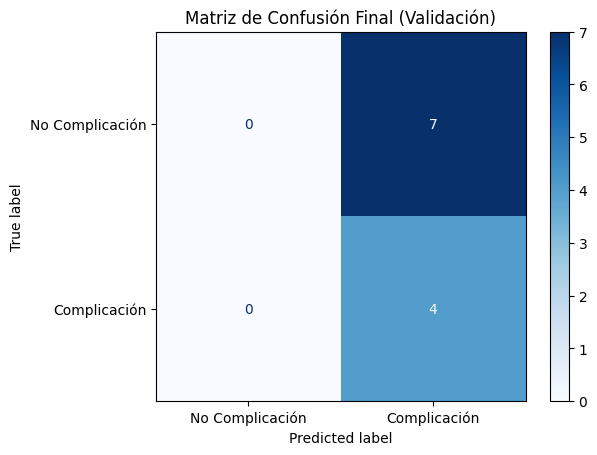

Accuracy: 0.3636
F1-Score: 0.5333


In [35]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

# 1. Poner el modelo en modo evaluación
model.eval()

# 2. Listas para almacenar predicciones y etiquetas reales
all_preds = []
all_labels = []

# 3. Iterar sobre el DataLoader de validación
with torch.no_grad():
    for inputs, labels in val_loader:
        inputs = inputs.to(device)
        outputs = model(inputs)
        
        # Para clasificación binaria con 2 neuronas de salida (out_channels=2)
        preds = torch.argmax(outputs, dim=1).cpu().numpy()
        
        all_preds.extend(preds)
        all_labels.extend(labels.cpu().numpy())

# 4. Calcular y mostrar la matriz
cm = confusion_matrix(all_labels, all_preds)
disp = ConfusionMatrixDisplay(confusion_matrix=cm,
                             display_labels=["No Complicación", "Complicación"])
disp.plot(cmap='Blues')
plt.title("Matriz de Confusión Final (Validación)")
plt.show()

# 5. Métricas adicionales
print(f"Accuracy: {accuracy_score(all_labels, all_preds):.4f}")
print(f"F1-Score: {f1_score(all_labels, all_preds):.4f}")

In [18]:
#cambiamos de optimizador para ajustar el learning rate dinamicamente
from torch.optim.lr_scheduler import ReduceLROnPlateau

optimizer = torch.optim.AdamW(model.parameters(), lr=3e-4, weight_decay=1e-5)
scheduler = ReduceLROnPlateau(optimizer, 'min', patience=2, factor=0.5)

In [19]:
def train_model_lr_automatic(model, train_loader, val_loader, criterion, optimizer, epochs=10):
    model.train()
    for epoch in range(epochs):
        running_loss = 0.0
        all_preds, all_labels = [], []
        for inputs, labels in tqdm(train_loader):
            #labels = labels.float().unsqueeze(1)
            inputs, labels = inputs.cuda(), labels.cuda()
            optimizer.zero_grad()
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()
            running_loss += loss.item()
            
            preds = torch.argmax(outputs, dim=1).cpu().numpy()
            all_preds.extend(preds)
            all_labels.extend(labels.cpu().numpy())
        
        acc = accuracy_score(all_labels, all_preds)
        f1 = f1_score(all_labels, all_preds)
        print(f"Epoch {epoch+1}, Loss: {running_loss:.4f}, Accuracy: {acc:.4f}, F1 Score: {f1:.4f}")
        
        # Validación
        model.eval()
        val_preds, val_labels = [], []
        val_loss = 0.0
        with torch.no_grad():
            for val_inputs, val_labels_batch in tqdm(val_loader):
                val_inputs, val_labels_batch = val_inputs.cuda(), val_labels_batch.cuda()
                val_outputs = model(val_inputs)
                val_loss += criterion(val_outputs, val_labels_batch).item()
                
                val_preds_batch = torch.argmax(val_outputs, dim=1).cpu().numpy()
                val_preds.extend(val_preds_batch)
                val_labels.extend(val_labels_batch.cpu().numpy())
        scheduler.step(val_loss)
        current_lr = optimizer.param_groups[0]['lr']
        val_acc = accuracy_score(val_labels, val_preds)
        val_f1 = f1_score(val_labels, val_preds)
        print(f"Validation - Loss: {val_loss:.4f}, Accuracy: {val_acc:.4f}, F1 Score: {val_f1:.4f}")
        print(f"Current LR: {current_lr:.2e}")
        model.train()

In [20]:
# con power=1.5
train_model_lr_automatic(model, train_loader, val_loader, criterion, optimizer, epochs=10)
# Guardar el modelo entrenado
torch.save(model.state_dict(), 'modelo_entrenado_lr_automatico.pth')
# Guardar el modelo completo (arquitectura + pesos)
torch.save(model, 'modelo_entrenado_completo_lr_automatico.pth')

100%|██████████| 61/61 [01:37<00:00,  1.59s/it]


Epoch 1, Loss: 44.6596, Accuracy: 0.5738, F1 Score: 0.6829


100%|██████████| 11/11 [00:11<00:00,  1.06s/it]


Validation - Loss: 12.5645, Accuracy: 0.4545, F1 Score: 0.6250
Current LR: 3.00e-04


100%|██████████| 61/61 [01:35<00:00,  1.56s/it]


Epoch 2, Loss: 39.6012, Accuracy: 0.7049, F1 Score: 0.8269


100%|██████████| 11/11 [00:06<00:00,  1.72it/s]


Validation - Loss: 29.1625, Accuracy: 0.4545, F1 Score: 0.6250
Current LR: 3.00e-04


100%|██████████| 61/61 [01:32<00:00,  1.52s/it]


Epoch 3, Loss: 41.5254, Accuracy: 0.6393, F1 Score: 0.7800


100%|██████████| 11/11 [00:07<00:00,  1.52it/s]


Validation - Loss: 64.4449, Accuracy: 0.4545, F1 Score: 0.6250
Current LR: 3.00e-04


100%|██████████| 61/61 [01:31<00:00,  1.50s/it]


Epoch 4, Loss: 35.6342, Accuracy: 0.7377, F1 Score: 0.8491


100%|██████████| 11/11 [00:06<00:00,  1.69it/s]


Validation - Loss: 25.9542, Accuracy: 0.4545, F1 Score: 0.6250
Current LR: 1.50e-04


100%|██████████| 61/61 [01:34<00:00,  1.55s/it]


Epoch 5, Loss: 46.4823, Accuracy: 0.5902, F1 Score: 0.7126


100%|██████████| 11/11 [00:06<00:00,  1.83it/s]


Validation - Loss: 8.5107, Accuracy: 0.6364, F1 Score: 0.7143
Current LR: 1.50e-04


100%|██████████| 61/61 [01:31<00:00,  1.50s/it]


Epoch 6, Loss: 42.6159, Accuracy: 0.5902, F1 Score: 0.7191


100%|██████████| 11/11 [00:06<00:00,  1.67it/s]


Validation - Loss: 7.6191, Accuracy: 0.5455, F1 Score: 0.5455
Current LR: 1.50e-04


100%|██████████| 61/61 [01:55<00:00,  1.89s/it]


Epoch 7, Loss: 39.3560, Accuracy: 0.6885, F1 Score: 0.7397


100%|██████████| 11/11 [00:16<00:00,  1.48s/it]


Validation - Loss: 9.1392, Accuracy: 0.6364, F1 Score: 0.7143
Current LR: 1.50e-04


100%|██████████| 61/61 [01:37<00:00,  1.59s/it]


Epoch 8, Loss: 39.1007, Accuracy: 0.6230, F1 Score: 0.7629


100%|██████████| 11/11 [00:05<00:00,  1.90it/s]


Validation - Loss: 10.5040, Accuracy: 0.4545, F1 Score: 0.6250
Current LR: 1.50e-04


100%|██████████| 61/61 [01:32<00:00,  1.52s/it]


Epoch 9, Loss: 35.8024, Accuracy: 0.8033, F1 Score: 0.8571


100%|██████████| 11/11 [00:05<00:00,  1.88it/s]


Validation - Loss: 6.3169, Accuracy: 0.7273, F1 Score: 0.7273
Current LR: 1.50e-04


100%|██████████| 61/61 [01:31<00:00,  1.50s/it]


Epoch 10, Loss: 36.2640, Accuracy: 0.7213, F1 Score: 0.8350


100%|██████████| 11/11 [00:06<00:00,  1.60it/s]


Validation - Loss: 10.2098, Accuracy: 0.4545, F1 Score: 0.6250
Current LR: 1.50e-04


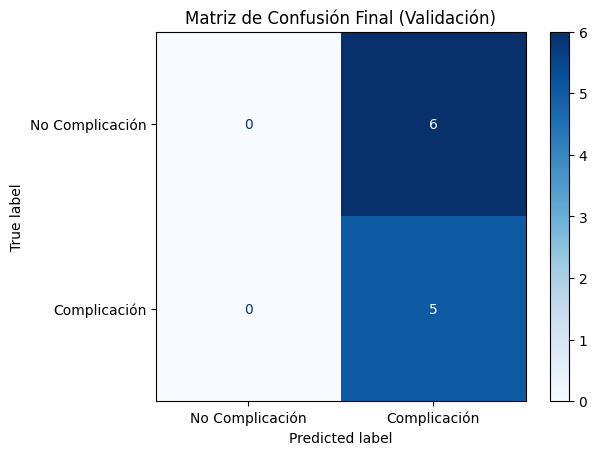

Accuracy: 0.4545
F1-Score: 0.6250


In [21]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

# 1. Poner el modelo en modo evaluación
model.eval()

# 2. Listas para almacenar predicciones y etiquetas reales
all_preds = []
all_labels = []

# 3. Iterar sobre el DataLoader de validación
with torch.no_grad():
    for inputs, labels in val_loader:
        inputs = inputs.to(device)
        outputs = model(inputs)
        
        # Para clasificación binaria con 2 neuronas de salida (out_channels=2)
        preds = torch.argmax(outputs, dim=1).cpu().numpy()
        
        all_preds.extend(preds)
        all_labels.extend(labels.cpu().numpy())

# 4. Calcular y mostrar la matriz
cm = confusion_matrix(all_labels, all_preds)
disp = ConfusionMatrixDisplay(confusion_matrix=cm,
                             display_labels=["No Complicación", "Complicación"])
disp.plot(cmap='Blues')
plt.title("Matriz de Confusión Final (Validación)")
plt.show()

# 5. Métricas adicionales
print(f"Accuracy: {accuracy_score(all_labels, all_preds):.4f}")
print(f"F1-Score: {f1_score(all_labels, all_preds):.4f}")

#### Data augmentation de clase minoritaria creando datos sinteticos

In [22]:
from monai.transforms import RandFlip, RandAffine, RandGaussianNoise

augment_transform = Compose([
    RandFlip(spatial_axis=0, prob=0.5),
    RandAffine(prob=0.5, translate_range=(5,5,5)),
    RandGaussianNoise(prob=0.2, mean=0.0, std=0.1)
])

In [23]:
class LungCTDataset(Dataset):
    def __init__(self, data_dir, labels_dict, transform=None):
        self.data_dir = data_dir
        self.patients = list(labels_dict.keys())
        self.labels = labels_dict
        self.transform = transform
    
    def __len__(self):
        return len(self.patients)
    
    def __getitem__(self, idx):
        patient_id = self.patients[idx]
        volume_path = os.path.join(self.data_dir, f"{patient_id}.npy")
        volume = np.load(volume_path)  # Cargar volumen preprocesado (256, 512, 512)
        volume = np.expand_dims(volume, axis=0)
        label = self.labels[patient_id]

        if label == 1:  #a la clase minoritaria creamos datos sinteticos
            volume = augment_transform(volume)
        
        if self.transform:
            volume = self.transform(volume)
        
        return volume, torch.tensor(label, dtype=torch.long)

In [24]:
from monai.transforms import Compose, EnsureChannelFirst, ScaleIntensity, ToTensor, EnsureType

transform = Compose([
    #EnsureChannelFirst(), #para que sea del tipo (1, 256, 512, 512)
    EnsureType()
])

In [25]:
dataset = LungCTDataset(NPY_DIR, labels_dict_numeric, transform=transform)

In [26]:
# División en 90% entrenamiento y 10% validación
train_size = int(0.9 * len(dataset))
val_size = len(dataset) - train_size
train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

In [27]:
train_sampler = get_sampler(train_dataset, power=1)

In [28]:
train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, sampler=train_sampler, num_workers=2, pin_memory=True)
val_loader = DataLoader(val_dataset, batch_size=BATCH_SIZE,  num_workers=2, pin_memory=True)

In [29]:
#modelo MONAI
model = DenseNet121(
    spatial_dims=3,          # 3D
    in_channels=1,           # Canales de entrada
    out_channels=2          # Salida binaria
    #pretrained=False,        # sin pesos preentrenados
    #dropout_prob=0.2         # Regularización
).to(device)

In [ ]:
optimizer = optim.Adam(model.parameters(), lr=1e-4)

In [30]:
# Configuración de entrenamiento sin ponderacion de pesos
criterion = nn.CrossEntropyLoss()

In [31]:
#prueba con data augmentation creando datos sinteticos de la clase minoritaria con RandFlip, RandAffine, RandGaussianNoise
train_model_lr_automatic(model, train_loader, val_loader, criterion, optimizer, epochs=10)

100%|██████████| 64/64 [04:34<00:00,  4.29s/it]


Epoch 1, Loss: 44.6536, Accuracy: 0.5312, F1 Score: 0.0000


100%|██████████| 8/8 [00:44<00:00,  5.57s/it]


Validation - Loss: 6.0618, Accuracy: 0.6250, F1 Score: 0.0000
Current LR: 1.50e-04


100%|██████████| 64/64 [03:57<00:00,  3.72s/it]


Epoch 2, Loss: 42.8675, Accuracy: 0.6094, F1 Score: 0.0000


100%|██████████| 8/8 [00:38<00:00,  4.78s/it]


Validation - Loss: 6.2113, Accuracy: 0.6250, F1 Score: 0.0000
Current LR: 1.50e-04


100%|██████████| 64/64 [04:39<00:00,  4.37s/it]


Epoch 3, Loss: 45.3605, Accuracy: 0.5000, F1 Score: 0.0000


100%|██████████| 8/8 [00:36<00:00,  4.60s/it]


Validation - Loss: 6.2063, Accuracy: 0.6250, F1 Score: 0.0000
Current LR: 1.50e-04


100%|██████████| 64/64 [03:54<00:00,  3.66s/it]


Epoch 4, Loss: 43.9378, Accuracy: 0.5625, F1 Score: 0.0000


100%|██████████| 8/8 [00:33<00:00,  4.14s/it]


Validation - Loss: 6.0774, Accuracy: 0.6250, F1 Score: 0.0000
Current LR: 7.50e-05


100%|██████████| 64/64 [04:24<00:00,  4.13s/it]


Epoch 5, Loss: 45.9878, Accuracy: 0.4688, F1 Score: 0.0000


100%|██████████| 8/8 [00:34<00:00,  4.26s/it]


Validation - Loss: 6.2068, Accuracy: 0.6250, F1 Score: 0.0000
Current LR: 7.50e-05


100%|██████████| 64/64 [04:13<00:00,  3.97s/it]


Epoch 6, Loss: 43.2624, Accuracy: 0.5938, F1 Score: 0.0000


100%|██████████| 8/8 [00:42<00:00,  5.37s/it]


Validation - Loss: 6.5355, Accuracy: 0.6250, F1 Score: 0.0000
Current LR: 7.50e-05


100%|██████████| 64/64 [03:57<00:00,  3.71s/it]


Epoch 7, Loss: 44.9754, Accuracy: 0.5156, F1 Score: 0.0000


100%|██████████| 8/8 [00:35<00:00,  4.44s/it]


Validation - Loss: 5.9956, Accuracy: 0.6250, F1 Score: 0.0000
Current LR: 7.50e-05


100%|██████████| 64/64 [04:29<00:00,  4.21s/it]


Epoch 8, Loss: 46.7408, Accuracy: 0.4375, F1 Score: 0.0000


100%|██████████| 8/8 [00:47<00:00,  5.99s/it]


Validation - Loss: 5.7840, Accuracy: 0.6250, F1 Score: 0.0000
Current LR: 7.50e-05


100%|██████████| 64/64 [04:26<00:00,  4.17s/it]


Epoch 9, Loss: 45.6877, Accuracy: 0.4844, F1 Score: 0.0000


100%|██████████| 8/8 [00:31<00:00,  3.93s/it]


Validation - Loss: 5.8629, Accuracy: 0.6250, F1 Score: 0.0000
Current LR: 7.50e-05


100%|██████████| 64/64 [04:47<00:00,  4.49s/it]


Epoch 10, Loss: 47.3254, Accuracy: 0.4062, F1 Score: 0.0000


100%|██████████| 8/8 [00:31<00:00,  3.92s/it]

Validation - Loss: 6.1603, Accuracy: 0.6250, F1 Score: 0.0000
Current LR: 7.50e-05


In [ ]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

# 1. Poner el modelo en modo evaluación
model.eval()

# 2. Listas para almacenar predicciones y etiquetas reales
all_preds = []
all_labels = []

# 3. Iterar sobre el DataLoader de validación
with torch.no_grad():
    for inputs, labels in val_loader:
        inputs = inputs.to(device)
        outputs = model(inputs)
        
        # Para clasificación binaria con 2 neuronas de salida (out_channels=2)
        preds = torch.argmax(outputs, dim=1).cpu().numpy()
        
        all_preds.extend(preds)
        all_labels.extend(labels.cpu().numpy())

# 4. Calcular y mostrar la matriz
cm = confusion_matrix(all_labels, all_preds)
disp = ConfusionMatrixDisplay(confusion_matrix=cm,
                             display_labels=["No Complicación", "Complicación"])
disp.plot(cmap='Blues')
plt.title("Matriz de Confusión Final (Validación)")
plt.show()

# 5. Métricas adicionales
print(f"Accuracy: {accuracy_score(all_labels, all_preds):.4f}")
print(f"F1-Score: {f1_score(all_labels, all_preds):.4f}")

#### Modelo preentrenado generico

In [10]:
class LungCTDataset(Dataset):
    def __init__(self, data_dir, labels_dict, transform=None):
        self.data_dir = data_dir
        self.patients = list(labels_dict.keys())
        self.labels = labels_dict
        self.transform = transform
    
    def __len__(self):
        return len(self.patients)
    
    def __getitem__(self, idx):
        patient_id = self.patients[idx]
        volume_path = os.path.join(self.data_dir, f"{patient_id}.npy")
        volume = np.load(volume_path)  # Cargar volumen preprocesado (256, 512, 512)
        # Aplicar ventana pulmonar
        volume = apply_3d_window(volume, window_level=-600, window_width=1500)
        volume = np.expand_dims(volume, axis=0)
        label = self.labels[patient_id]
        
        if self.transform:
            volume = self.transform(volume)
        
        return volume, torch.tensor(label, dtype=torch.long)

In [46]:
from monai.transforms import Compose, EnsureChannelFirst, ScaleIntensity, ToTensor, EnsureType

transform = Compose([
    #EnsureChannelFirst(), #para que sea del tipo (1, 256, 512, 512)
    EnsureType()
])

In [12]:
NPY_DIR="preprocessed_data_3d"
BATCH_SIZE = 1
TARGET_SIZE = (512, 512)

In [16]:
dataset = LungCTDataset(NPY_DIR, labels_dict_numeric, transform=transform)

In [17]:
from sklearn.model_selection import train_test_split

# Obtener los IDs de pacientes y las etiquetas asociadas
patient_ids = dataset.patients
labels = [dataset.labels[pid] for pid in patient_ids]

# División estratificada 85/15
train_ids, val_ids = train_test_split(
    patient_ids,
    test_size=0.15,
    stratify=labels,
    random_state=42
)

# Crear los datasets con los subconjuntos
train_labels_dict = {pid: dataset.labels[pid] for pid in train_ids}
val_labels_dict = {pid: dataset.labels[pid] for pid in val_ids}

train_dataset = LungCTDataset(data_dir=dataset.data_dir, labels_dict=train_labels_dict, transform=transform)
val_dataset = LungCTDataset(data_dir=dataset.data_dir, labels_dict=val_labels_dict, transform=transform)


In [18]:
train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=2, pin_memory=True)
val_loader = DataLoader(val_dataset, batch_size=BATCH_SIZE, shuffle=False, num_workers=2, pin_memory=True)

In [21]:
from monai.networks.nets import DenseNet121

model = DenseNet121(
    spatial_dims=3,
    in_channels=1,
    out_channels=4  # Tiene que ser 4 para poder cargar los pesos
).to(device)

In [22]:
pretrained_path = "modelo_preentrenado_generico_3d_tipos_cancer.pth"
model.load_state_dict(torch.load(pretrained_path))

You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.


<All keys matched successfully>

In [23]:
from torch import nn

# Adaptar la última capa al nuevo número de clases
model.class_layers = nn.Sequential(
    nn.AdaptiveAvgPool3d(output_size=1),
    nn.Flatten(),
    nn.Linear(in_features=1024, out_features=2)  # para binario
)

In [ ]:
# Congelar todas las capas excepto la última
for param in model.features.parameters():
    param.requires_grad = False


In [29]:
model = model.to(device)
criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(filter(lambda p: p.requires_grad, model.parameters()), lr=1e-4)


In [ ]:
import copy
from sklearn.metrics import accuracy_score, f1_score

def train_model(model, train_loader, val_loader, criterion, optimizer, device, epochs=10):
    best_val_f1 = 0.0
    best_model_wts = copy.deepcopy(model.state_dict())
    best_metrics = {}

    for epoch in range(epochs):
        model.train()
        running_loss = 0.0
        all_preds, all_labels = [], []

        for inputs, labels in tqdm(train_loader, desc=f"Epoch {epoch+1}"):
            inputs, labels = inputs.to(device), labels.to(device)
            optimizer.zero_grad()
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()
            running_loss += loss.item()

            preds = torch.argmax(outputs, dim=1).cpu().numpy()
            all_preds.extend(preds)
            all_labels.extend(labels.cpu().numpy())

        acc = accuracy_score(all_labels, all_preds)
        f1 = f1_score(all_labels, all_preds, average='weighted')
        print(f"[Train] Epoch {epoch+1}, Loss: {running_loss:.4f}, Acc: {acc:.4f}, F1: {f1:.4f}")

        # Validación
        model.eval()
        val_preds, val_labels = [], []
        val_loss = 0.0
        with torch.no_grad():
            for val_inputs, val_labels_batch in val_loader:
                val_inputs, val_labels_batch = val_inputs.to(device), val_labels_batch.to(device)
                val_outputs = model(val_inputs)
                val_loss += criterion(val_outputs, val_labels_batch).item()

                val_preds_batch = torch.argmax(val_outputs, dim=1).cpu().numpy()
                val_preds.extend(val_preds_batch)
                val_labels.extend(val_labels_batch.cpu().numpy())

        val_acc = accuracy_score(val_labels, val_preds)
        val_f1 = f1_score(val_labels, val_preds, average='weighted')
        print(f"[Val] Epoch {epoch+1}, Loss: {val_loss:.4f}, Acc: {val_acc:.4f}, F1: {val_f1:.4f}")

        # Guardar mejor modelo
        if val_f1 > best_val_f1:
            best_val_f1 = val_f1
            best_model_wts = copy.deepcopy(model.state_dict())
            best_metrics = {
                'train_acc': acc,
                'train_f1': f1,
                'val_loss': val_loss,
                'val_acc': val_acc,
                'val_f1': val_f1
            }

    # Cargar mejor modelo
    model.load_state_dict(best_model_wts)

    print("\n Mejor modelo guardado con F1 de validación más alto:")
    print(f"Train Acc: {best_metrics['train_acc']:.4f} | Train F1: {best_metrics['train_f1']:.4f}")
    print(f"Val Loss: {best_metrics['val_loss']:.4f} | Val Acc: {best_metrics['val_acc']:.4f} | Val F1: {best_metrics['val_f1']:.4f}")

    return model


In [ ]:
train_model(model, train_loader, val_loader, criterion, optimizer, device, epochs=10)

Epoch 1: 100%|██████████| 61/61 [03:04<00:00,  3.02s/it]

[Train] Epoch 1, Loss: 42.1873, Acc: 0.6885, F1: 0.5615


[Val] Epoch 1, Loss: 8.5880, Acc: 0.2727, F1: 0.1169


Epoch 2: 100%|██████████| 61/61 [02:38<00:00,  2.60s/it]

[Train] Epoch 2, Loss: 42.0360, Acc: 0.6885, F1: 0.5615


[Val] Epoch 2, Loss: 7.6094, Acc: 0.6364, F1: 0.6364


Epoch 3: 100%|██████████| 61/61 [01:55<00:00,  1.90s/it]

[Train] Epoch 3, Loss: 41.9082, Acc: 0.6885, F1: 0.5615


[Val] Epoch 3, Loss: 7.6802, Acc: 0.4545, F1: 0.4838


Epoch 4: 100%|██████████| 61/61 [01:29<00:00,  1.46s/it]

[Train] Epoch 4, Loss: 41.7744, Acc: 0.6885, F1: 0.5615


[Val] Epoch 4, Loss: 7.4704, Acc: 0.7273, F1: 0.7080


Epoch 5: 100%|██████████| 61/61 [01:14<00:00,  1.21s/it]

[Train] Epoch 5, Loss: 41.6389, Acc: 0.6885, F1: 0.5615


[Val] Epoch 5, Loss: 7.6341, Acc: 0.6364, F1: 0.6364


Epoch 6: 100%|██████████| 61/61 [01:25<00:00,  1.40s/it]

[Train] Epoch 6, Loss: 41.5194, Acc: 0.6885, F1: 0.5615


[Val] Epoch 6, Loss: 7.5366, Acc: 0.6364, F1: 0.6364


Epoch 7: 100%|██████████| 61/61 [01:49<00:00,  1.80s/it]

[Train] Epoch 7, Loss: 41.4000, Acc: 0.6885, F1: 0.5615


[Val] Epoch 7, Loss: 7.2632, Acc: 0.7273, F1: 0.7080


Epoch 8: 100%|██████████| 61/61 [01:48<00:00,  1.78s/it]

[Train] Epoch 8, Loss: 41.2841, Acc: 0.6885, F1: 0.5615


[Val] Epoch 8, Loss: 7.7508, Acc: 0.4545, F1: 0.4838


Epoch 9: 100%|██████████| 61/61 [01:31<00:00,  1.50s/it]

[Train] Epoch 9, Loss: 41.1709, Acc: 0.6885, F1: 0.5615


[Val] Epoch 9, Loss: 7.7015, Acc: 0.6364, F1: 0.6364


Epoch 10: 100%|██████████| 61/61 [01:39<00:00,  1.62s/it]

[Train] Epoch 10, Loss: 41.0602, Acc: 0.6885, F1: 0.5615


[Val] Epoch 10, Loss: 7.4657, Acc: 0.6364, F1: 0.6364

✅ Mejor modelo guardado con F1 de validación más alto:
Train Acc: 0.6885 | Train F1: 0.5615
Val Loss: 7.4704 | Val Acc: 0.7273 | Val F1: 0.7080


DenseNet121(
  (features): Sequential(
    (conv0): Conv3d(1, 64, kernel_size=(7, 7, 7), stride=(2, 2, 2), padding=(3, 3, 3), bias=False)
    (norm0): BatchNorm3d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu0): ReLU(inplace=True)
    (pool0): MaxPool3d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (denseblock1): _DenseBlock(
      (denselayer1): _DenseLayer(
        (layers): Sequential(
          (norm1): BatchNorm3d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (relu1): ReLU(inplace=True)
          (conv1): Conv3d(64, 128, kernel_size=(1, 1, 1), stride=(1, 1, 1), bias=False)
          (norm2): BatchNorm3d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (relu2): ReLU(inplace=True)
          (conv2): Conv3d(128, 32, kernel_size=(3, 3, 3), stride=(1, 1, 1), padding=(1, 1, 1), bias=False)
        )
      )
      (denselayer2): _DenseLayer(
        (layers): Sequential(
 

In [ ]:
import matplotlib.pyplot as plt
from sklearn.metrics import accuracy_score, f1_score, confusion_matrix, ConfusionMatrixDisplay
import os

def evaluate_model(model, val_loader, device):
    """
    Evalúa un modelo binario en validación y guarda la matriz de confusión como imagen.

    Args:
        model: modelo PyTorch ya entrenado
        val_loader: DataLoader de validación
        device: cuda o cpu
        save_path: ruta para guardar la imagen de la matriz
    """
    model.eval()
    all_preds, all_labels = [], []

    with torch.no_grad():
        for inputs, labels in val_loader:
            inputs = inputs.to(device)
            outputs = model(inputs)
            preds = torch.argmax(outputs, dim=1).cpu().numpy()
            all_preds.extend(preds)
            all_labels.extend(labels.cpu().numpy())

    acc = accuracy_score(all_labels, all_preds)
    f1 = f1_score(all_labels, all_preds, average='weighted')
    cm = confusion_matrix(all_labels, all_preds)

    # Mostrar y guardar matriz
    class_names = ["Sin complicación", "Con complicación"]
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_names)
    fig, ax = plt.subplots(figsize=(6, 5))
    disp.plot(cmap='Blues', ax=ax)
    plt.title("Matriz de Confusión - Complicación Sí/No")
    plt.show()

    print(f"\n Accuracy:  {acc:.4f}")
    print(f" F1-Score:  {f1:.4f}")
    print(f" Matriz de Confusión:\n{cm}")




In [ ]:
evaluate_model(model, val_loader, device)

In [78]:
def get_prediction_info(model, val_labels_dict, device, data_dir):
    """
    Devuelve una lista de tuplas (path, etiqueta real, etiqueta predicha) del conjunto de validación.
    """
    model.eval()
    casos = []
    for patient_id, true_label in val_labels_dict.items():
        volume_path = os.path.join(data_dir, f"{patient_id}.npy")
        volume = np.load(volume_path)
        volume = apply_3d_window(volume, window_level=-600, window_width=1500)
        volume = np.clip(volume, 0, 1)
        volume = np.expand_dims(volume, axis=0).astype(np.float32)
        tensor = torch.tensor(volume).unsqueeze(0).to(device)

        with torch.no_grad():
            output = model(tensor)
            pred = torch.argmax(output, dim=1).item()

        casos.append((volume_path, true_label, pred))
    return casos


In [ ]:
import torch.nn as nn
import numpy as np
import matplotlib.pyplot as plt

def find_last_conv_layer(model):
    for name, module in reversed(list(model.named_modules())):
        if isinstance(module, nn.Conv3d):
            return module
    raise ValueError("No se encontró ninguna capa Conv3D en el modelo.")

def apply_gradcam(model, input_tensor, target_class, device):
    model.eval()
    input_tensor = input_tensor.to(device)

    activations = []
    gradients = []

    def save_activation(module, input, output):
        activations.append(output)

    def save_gradient(module, grad_input, grad_output):
        gradients.append(grad_output[0])

    # Hook en la última capa convolucional
    final_conv = find_last_conv_layer(model)
    h1 = final_conv.register_forward_hook(save_activation)
    h2 = final_conv.register_full_backward_hook(save_gradient)

    # Forward y backward
    output = model(input_tensor)
    model.zero_grad()
    loss = output[0, target_class]
    loss.backward()

    # Comprobación de gradientes y activaciones
    if not gradients or not activations:
        print(" No se registraron activaciones o gradientes. Revisa si el modelo está conectado correctamente.")
        h1.remove()
        h2.remove()
        return

    # Procesar activaciones y gradientes
    grads = gradients[0].cpu().numpy()[0]
    acts = activations[0].detach().cpu().numpy()[0]

    # Procesar activaciones y gradientes
    grads = gradients[0].cpu().numpy()[0]
    acts = activations[0].detach().cpu().numpy()[0]
    weights = np.mean(grads, axis=(1, 2, 3))

    cam = np.zeros(acts.shape[1:], dtype=np.float32)
    for i, w in enumerate(weights):
        cam += w * acts[i]
    cam = np.maximum(cam, 0)
    cam = cam / cam.max() if cam.max() > 0 else cam

    # Mostrar slice medio
    mid_slice = cam.shape[0] // 2
    plt.imshow(cam[mid_slice], cmap='jet')
    plt.title(f"Grad-CAM - Clase {target_class}")
    plt.axis('off')
    plt.colorbar()
    plt.show()

    h1.remove()
    h2.remove()


In [ ]:
import numpy as np
import torch
import torch.nn as nn
import matplotlib.pyplot as plt
from scipy.ndimage import zoom
import cv2

def apply_gradcam_midataset(model, input_tensor, target_class, device):
    model.eval()
    input_tensor = input_tensor.to(device)

    activations = []
    gradients = []

    def save_activation(module, input, output):
        activations.append(output)

    def save_gradient(module, grad_input, grad_output):
        gradients.append(grad_output[0])

    # Hook en la última capa convolucional
    final_conv = None
    for name, module in reversed(list(model.named_modules())):
        if isinstance(module, nn.Conv3d):
            final_conv = module
            break

    if final_conv is None:
        print(" No se encontró ninguna capa Conv3D.")
        return

    h1 = final_conv.register_forward_hook(save_activation)
    h2 = final_conv.register_full_backward_hook(save_gradient)

    # Forward y backward
    output = model(input_tensor)
    model.zero_grad()
    loss = output[0, target_class]
    loss.backward()

    # Comprobación de gradientes y activaciones
    if not gradients or not activations:
        print(" No se registraron activaciones o gradientes.")
        h1.remove()
        h2.remove()
        return

    grads = gradients[0].cpu().numpy()[0]
    acts = activations[0].detach().cpu().numpy()[0]

    weights = np.mean(grads, axis=(1, 2, 3))
    cam = np.zeros(acts.shape[1:], dtype=np.float32)
    for i, w in enumerate(weights):
        cam += w * acts[i]
    cam = np.maximum(cam, 0)
    cam = cam / cam.max() if cam.max() > 0 else cam

    # Escalar Grad-CAM al tamaño original
    original_volume = input_tensor.cpu().numpy()[0, 0]
    cam_resized = zoom(cam, (
        original_volume.shape[0] / cam.shape[0],
        original_volume.shape[1] / cam.shape[1],
        original_volume.shape[2] / cam.shape[2]
    ))

    # Mostrar slice del medio
    mid_slice = original_volume.shape[0] // 2
    original_slice = original_volume[mid_slice]
    cam_slice = cam_resized[mid_slice]

    plt.imshow(original_slice, cmap='gray')
    plt.imshow(cam_slice, cmap='jet', alpha=0.4)
    plt.title(f"Grad-CAM - Clase {target_class}")
    plt.axis('off')
    plt.colorbar()
    plt.show()

    h1.remove()
    h2.remove()


In [ ]:
def mostrar_gradcams_binario(model, val_labels_dict, device, data_dir, mask_dir, max_ejemplos=5 ):
    casos = get_prediction_info(model, val_labels_dict, device, data_dir, mask_dir)
    por_clase = {i: {"aciertos": [], "fallos": []} for i in range(2)}
    nombre_clase = {0: "Sin complicación", 1: "Con complicación"}

    for path, real, pred in casos:
        if real == pred:
            por_clase[real]["aciertos"].append((path, real, pred))
        else:
            por_clase[real]["fallos"].append((path, real, pred))

    for clase in range(2):
        print(f"\n Visualizando para clase {clase} ({nombre_clase[clase]}):")

        # ACIERTOS
        aciertos = por_clase[clase]["aciertos"][:max_ejemplos]
        print(f"\n {len(aciertos)} casos correctamente clasificados")
        for path, real, pred in aciertos:
            vol = np.load(path)
            vol = np.clip(vol, 0, 1)
            vol = np.expand_dims(vol, axis=0).astype(np.float32)
            tensor = torch.tensor(vol).unsqueeze(0)
            print(f" {os.path.basename(path)} — Real: {real}, Predicho: {pred}")
            apply_gradcam_midataset(model, tensor, target_class=real, device=device)

        # FALLOS
        fallos = por_clase[clase]["fallos"][:max_ejemplos]
        print(f"\n {len(fallos)} casos mal clasificados")
        for path, real, pred in fallos:
            vol = np.load(path)
            vol = np.clip(vol, 0, 1)
            vol = np.expand_dims(vol, axis=0).astype(np.float32)
            tensor = torch.tensor(vol).unsqueeze(0)
            print(f" {os.path.basename(path)} — Real: {real}, Predicho: {pred}")
            apply_gradcam_midataset(model, tensor, target_class=pred, device=device)


In [ ]:
mostrar_gradcams_binario(model, val_labels_dict, device, data_dir=NPY_DIR)


🔍 Visualizando para clase 0 (Sin complicación):

✅ 5 casos correctamente clasificados
✅ 37HPNX.npy — Real: 0, Predicho: 0
❌ No se registraron activaciones o gradientes. Revisa si el modelo está conectado correctamente.
✅ 13HANX.npy — Real: 0, Predicho: 0
❌ No se registraron activaciones o gradientes. Revisa si el modelo está conectado correctamente.
✅ 52HLNX.npy — Real: 0, Predicho: 0
❌ No se registraron activaciones o gradientes. Revisa si el modelo está conectado correctamente.
✅ 71MTmNX.npy — Real: 0, Predicho: 0
❌ No se registraron activaciones o gradientes. Revisa si el modelo está conectado correctamente.
✅ 24MANX.npy — Real: 0, Predicho: 0
❌ No se registraron activaciones o gradientes. Revisa si el modelo está conectado correctamente.

❌ 1 casos mal clasificados
❌ 20MMNX.npy — Real: 0, Predicho: 1
❌ No se registraron activaciones o gradientes. Revisa si el modelo está conectado correctamente.

🔍 Visualizando para clase 1 (Con complicación):

✅ 1 casos correctamente clasificados

In [ ]:
# sin congelar
train_model(model, train_loader, val_loader, criterion, optimizer, device, epochs=10)

Epoch 1: 100%|██████████| 61/61 [03:13<00:00,  3.18s/it]

[Train] Epoch 1, Loss: 41.8568, Acc: 0.6885, F1: 0.5615


[Val] Epoch 1, Loss: 7.6976, Acc: 0.3636, F1: 0.3963


Epoch 2: 100%|██████████| 61/61 [02:50<00:00,  2.79s/it]

[Train] Epoch 2, Loss: 41.1493, Acc: 0.6885, F1: 0.5615


[Val] Epoch 2, Loss: 7.2589, Acc: 0.7273, F1: 0.6124


Epoch 3: 100%|██████████| 61/61 [02:13<00:00,  2.18s/it]

[Train] Epoch 3, Loss: 40.4019, Acc: 0.6885, F1: 0.5615


[Val] Epoch 3, Loss: 7.0922, Acc: 0.7273, F1: 0.6124


Epoch 4: 100%|██████████| 61/61 [02:16<00:00,  2.23s/it]

[Train] Epoch 4, Loss: 39.5665, Acc: 0.6885, F1: 0.5615


[Val] Epoch 4, Loss: 6.8760, Acc: 0.7273, F1: 0.6124


Epoch 5: 100%|██████████| 61/61 [02:17<00:00,  2.26s/it]

[Train] Epoch 5, Loss: 39.0169, Acc: 0.6885, F1: 0.5615


[Val] Epoch 5, Loss: 6.8680, Acc: 0.7273, F1: 0.6124


Epoch 6: 100%|██████████| 61/61 [02:02<00:00,  2.01s/it]

[Train] Epoch 6, Loss: 38.5768, Acc: 0.6885, F1: 0.5615


[Val] Epoch 6, Loss: 6.7672, Acc: 0.7273, F1: 0.6124


Epoch 7: 100%|██████████| 61/61 [02:02<00:00,  2.00s/it]

[Train] Epoch 7, Loss: 38.3589, Acc: 0.6885, F1: 0.5615


[Val] Epoch 7, Loss: 6.7298, Acc: 0.7273, F1: 0.6124


Epoch 8:  74%|███████▍  | 45/61 [01:25<00:28,  1.81s/it]

In [ ]:
evaluate_model(model, val_loader, device)

In [ ]:
mostrar_gradcams_binario(model, val_labels_dict, device, data_dir=NPY_DIR)

In [24]:
#pruebo a hacer una mixta de descongelar y congelar
# 1. Entrena solo la última capa (cabeza) unas pocas épocas
for param in model.features.parameters():
    param.requires_grad = False

# 2. Luego descongela parcialmente (por ejemplo, denseblock4)
for param in model.features.denseblock4.parameters():
    param.requires_grad = True

# 3. Finalmente, fine-tuning completo (todo el modelo)
for param in model.parameters():
    param.requires_grad = True


In [25]:
#esto se me ha olvidado ponerlo a ejecutar
optimizer = torch.optim.Adam(filter(lambda p: p.requires_grad, model.parameters()), lr=1e-5)

In [32]:
train_model(model, train_loader, val_loader, criterion, optimizer, device, epochs=10)

Epoch 1: 100%|██████████| 61/61 [06:02<00:00,  5.94s/it]

[Train] Epoch 1, Loss: 41.6874, Acc: 0.6885, F1: 0.5615


[Val] Epoch 1, Loss: 6.8962, Acc: 0.7273, F1: 0.6124


Epoch 2: 100%|██████████| 61/61 [05:08<00:00,  5.05s/it]

[Train] Epoch 2, Loss: 40.9940, Acc: 0.6885, F1: 0.5615


[Val] Epoch 2, Loss: 7.1611, Acc: 0.7273, F1: 0.6124


Epoch 3: 100%|██████████| 61/61 [02:11<00:00,  2.16s/it]

[Train] Epoch 3, Loss: 40.2187, Acc: 0.6885, F1: 0.5615


[Val] Epoch 3, Loss: 7.0413, Acc: 0.7273, F1: 0.6124


Epoch 4: 100%|██████████| 61/61 [02:14<00:00,  2.21s/it]

[Train] Epoch 4, Loss: 39.4535, Acc: 0.6885, F1: 0.5615


[Val] Epoch 4, Loss: 6.8165, Acc: 0.7273, F1: 0.6124


Epoch 5: 100%|██████████| 61/61 [02:43<00:00,  2.68s/it]

[Train] Epoch 5, Loss: 38.8771, Acc: 0.6885, F1: 0.5615


[Val] Epoch 5, Loss: 6.6592, Acc: 0.7273, F1: 0.6124


Epoch 6: 100%|██████████| 61/61 [03:55<00:00,  3.86s/it]

[Train] Epoch 6, Loss: 38.4926, Acc: 0.6885, F1: 0.5615


[Val] Epoch 6, Loss: 6.6821, Acc: 0.7273, F1: 0.6124


Epoch 7: 100%|██████████| 61/61 [02:01<00:00,  2.00s/it]

[Train] Epoch 7, Loss: 38.2513, Acc: 0.6885, F1: 0.5615


[Val] Epoch 7, Loss: 6.5761, Acc: 0.7273, F1: 0.6124


Epoch 8: 100%|██████████| 61/61 [01:48<00:00,  1.77s/it]

[Train] Epoch 8, Loss: 38.1135, Acc: 0.6885, F1: 0.5615


[Val] Epoch 8, Loss: 6.6138, Acc: 0.7273, F1: 0.6124


Epoch 9: 100%|██████████| 61/61 [01:43<00:00,  1.69s/it]

[Train] Epoch 9, Loss: 38.0183, Acc: 0.6885, F1: 0.5615


[Val] Epoch 9, Loss: 6.5811, Acc: 0.7273, F1: 0.6124


Epoch 10: 100%|██████████| 61/61 [01:38<00:00,  1.61s/it]

[Train] Epoch 10, Loss: 37.9713, Acc: 0.6885, F1: 0.5615


[Val] Epoch 10, Loss: 6.6916, Acc: 0.7273, F1: 0.6124

✅ Mejor modelo guardado con F1 de validación más alto:
Train Acc: 0.6885 | Train F1: 0.5615
Val Loss: 6.8962 | Val Acc: 0.7273 | Val F1: 0.6124


DenseNet121(
  (features): Sequential(
    (conv0): Conv3d(1, 64, kernel_size=(7, 7, 7), stride=(2, 2, 2), padding=(3, 3, 3), bias=False)
    (norm0): BatchNorm3d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu0): ReLU(inplace=True)
    (pool0): MaxPool3d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (denseblock1): _DenseBlock(
      (denselayer1): _DenseLayer(
        (layers): Sequential(
          (norm1): BatchNorm3d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (relu1): ReLU(inplace=True)
          (conv1): Conv3d(64, 128, kernel_size=(1, 1, 1), stride=(1, 1, 1), bias=False)
          (norm2): BatchNorm3d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (relu2): ReLU(inplace=True)
          (conv2): Conv3d(128, 32, kernel_size=(3, 3, 3), stride=(1, 1, 1), padding=(1, 1, 1), bias=False)
        )
      )
      (denselayer2): _DenseLayer(
        (layers): Sequential(
 

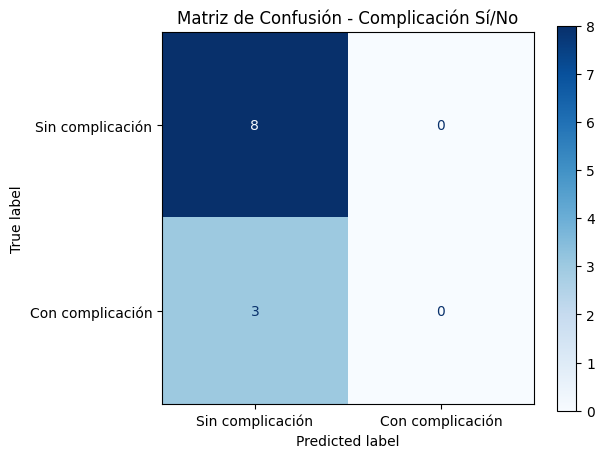


✅ Accuracy:  0.7273
✅ F1-Score:  0.6124
✅ Matriz de Confusión:
[[8 0]
 [3 0]]


In [36]:
evaluate_model(model, val_loader, device)


🔍 Visualizando para clase 0 (Sin complicación):

✅ 5 casos correctamente clasificados
✅ 37HPNX.npy — Real: 0, Predicho: 0


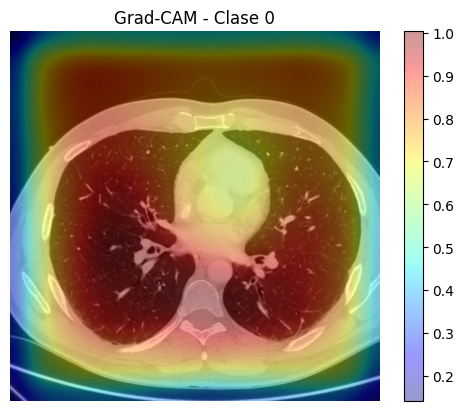

✅ 13HANX.npy — Real: 0, Predicho: 0


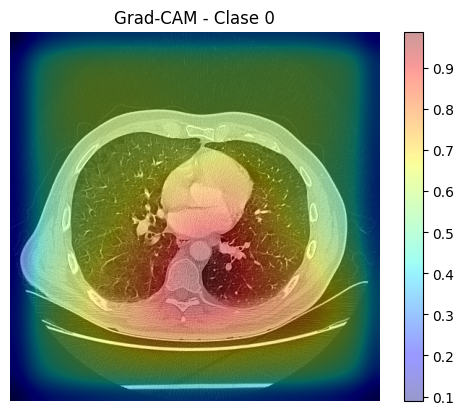

✅ 52HLNX.npy — Real: 0, Predicho: 0


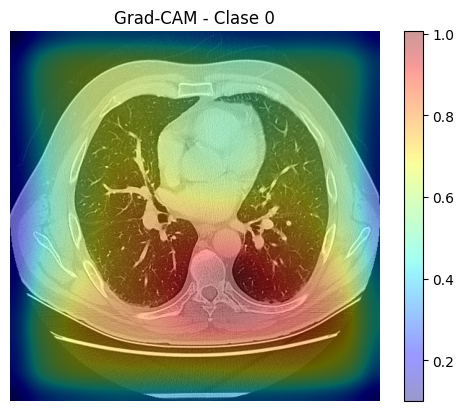

✅ 20MMNX.npy — Real: 0, Predicho: 0


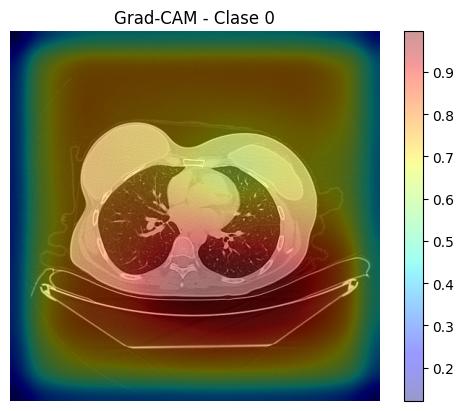

✅ 71MTmNX.npy — Real: 0, Predicho: 0


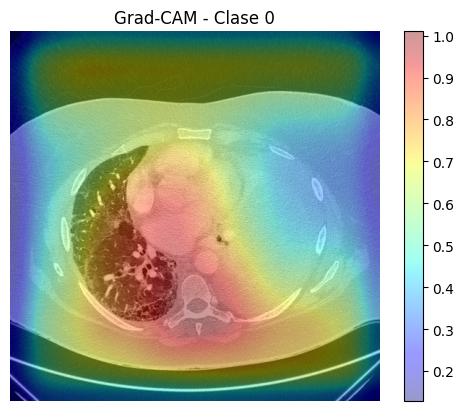


❌ 0 casos mal clasificados

🔍 Visualizando para clase 1 (Con complicación):

✅ 0 casos correctamente clasificados

❌ 3 casos mal clasificados
❌ 4HLSh.npy — Real: 1, Predicho: 0


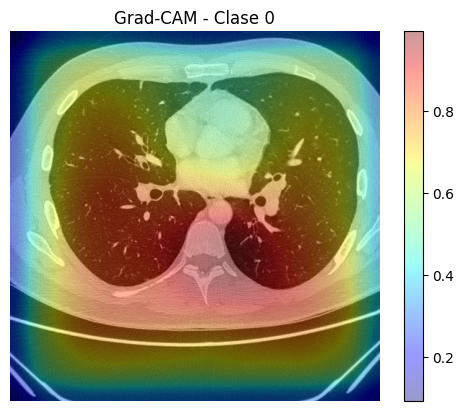

❌ 72MASH.npy — Real: 1, Predicho: 0


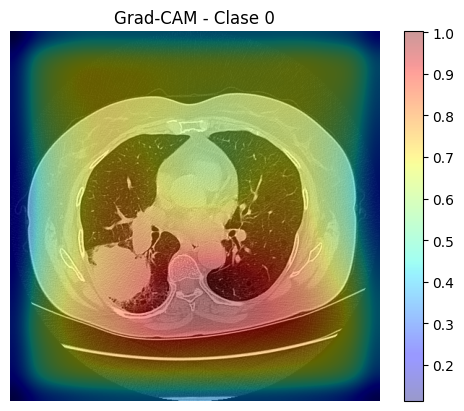

❌ 43HESH.npy — Real: 1, Predicho: 0


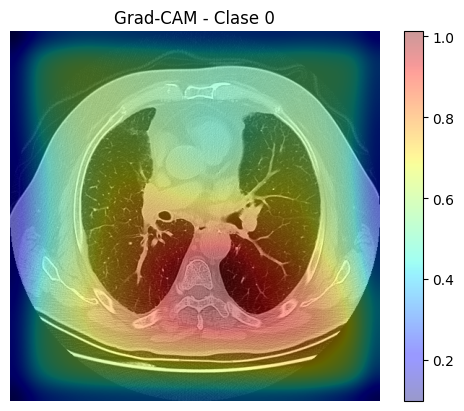

In [43]:
mostrar_gradcams_binario(model, val_labels_dict, device, data_dir=NPY_DIR)

## 2D
Viendo que cada caso tiene un número muy variable de slices y como volumen 3D no es fija la profundidad, vamos a optar por hacer un estudio de cada caso con slices 2D. 

Cada slice se va a tratar como una muestra independiente, es decir, ae almacenan los metadatos relevantes (PatientID, SliceLocation, etc.) junto con cada imagen.

Además, hemos visto que el tamaño de ancho y alto tambien difiere: 512x512 y 768x68. Esto depende de la máquina con la que se haya realizado la imagen. Por tanto, voy a ponerlas todas en un tamaño fijo de 512x512.

Añadimos las etiquetas del diccionario con la información del CSV para saber cada imagen si tiene complicación o no. 

### Preprocesar imágenes 
Le cambio el formato de DICOM a npy. Corto en slices independientes. 

In [13]:
#Funcion para preprocesar las slices 2D sin depende de un dataset
def preprocess_and_save_slices_from_folders(root_dir, save_dir, labels_dict, target_size=(512, 512)):
    """
    Preprocesa las imágenes DICOM de las subcarpetas de pacientes y las guarda en archivos .npy.

    Args:
        root_dir (str): Directorio raíz que contiene las subcarpetas de los pacientes.
        save_dir (str): Directorio donde se guardarán las imágenes preprocesadas.
        labels_dict (dict): Diccionario que mapea Id_paciente a Complicación (etiqueta).
        target_size (tuple): Tamaño objetivo para redimensionar las imágenes (por defecto 512x512).
    """
    # Crear el directorio de guardado si no existe
    os.makedirs(save_dir, exist_ok=True)

    # Recorrer todas las subcarpetas de pacientes
    for patient_folder in tqdm(os.listdir(root_dir), desc="Procesando pacientes"):
        patient_path = os.path.join(root_dir, patient_folder)

        # Verificar si es una carpeta
        if not os.path.isdir(patient_path):
            continue

        # Obtener el Id_paciente (nombre de la subcarpeta)
        patient_id = patient_folder

        # Obtener la etiqueta del diccionario
        if patient_id not in labels_dict:
            print(f"Advertencia: No se encontró la etiqueta para el paciente {patient_id}. Saltando...")
            continue
        label = labels_dict[patient_id]

        # Recorrer todas las slices (archivos DICOM) en la carpeta del paciente
        for slice_filename in os.listdir(patient_path):
            slice_path = os.path.join(patient_path, slice_filename)

            # Cargar la imagen DICOM
            dicom_data = pydicom.dcmread(slice_path)
            slice_array = dicom_data.pixel_array  # Extraer el array de píxeles

            # Redimensionar la imagen al tamaño objetivo (512x512)
            if slice_array.shape != target_size:
                slice_array = resize(slice_array, target_size, mode='reflect', anti_aliasing=True)

            # Guardar la slice en un archivo .npy
            slice_save_name = f"{patient_id}_{slice_filename.split('.')[0]}.npy"
            slice_save_path = os.path.join(save_dir, slice_save_name)
            np.save(slice_save_path, slice_array)

In [14]:
# Directorios para guardar las imágenes preprocesadas
all_preprocessed_dir = "preprocessed/all"

In [11]:
# preprocesar nuevos datos
pacientes_nuevos_dir="pacientes_nuevos_21marzo"
paciente_nuevo="/mnt/homeGPU/mcribilles/TFG/pacientes_prueba_nuevos/"

In [15]:
#NO VOLVER A EJECUTAR
#PREPROCESAR IMAGENES ANONIMIZADOS
preprocess_and_save_slices_from_folders(paciente_nuevo, all_preprocessed_dir, labels_dict, (512, 512))

Procesando pacientes: 100%|██████████| 2/2 [00:09<00:00,  4.77s/it]


### Dataset 2D

In [56]:
# Directorios para guardar las imágenes preprocesadas
all_preprocessed_dir = "preprocessed/all"

In [54]:
class PreprocessedDataset(Dataset):
    def __init__(self, preprocessed_dir, labels_dict, cases):
        """
        Args:
            preprocessed_dir (str): Directorio donde están las imágenes preprocesadas.
            labels_dict (dict): Diccionario con las etiquetas de los pacientes.
            cases (list): Lista de casos (patient_id) que se incluirán en este dataset.
        """
        self.preprocessed_dir = preprocessed_dir
        self.labels_dict = labels_dict
        self.cases = cases

        # Obtener la lista de archivos .npy en el directorio
        self.slice_files = [
            os.path.join(preprocessed_dir, f) 
            for f in os.listdir(preprocessed_dir) 
            if f.endswith('.npy') and self._is_patient_in_cases(f)
        ]

    def _extract_case_number(self, patient_id):
        """
        Extrae el número de caso del patient_id.

        Args:
            patient_id (str): ID del paciente (por ejemplo, "10MANX" o "1MASh").

        Returns:
            int: Número de caso (por ejemplo, 10 o 1).
        """
        # Usar una expresión regular para encontrar todos los dígitos al principio del string
        match = re.match(r'^\d+', patient_id)
        if match:
            return int(match.group())  # Convertir a entero
        return 0  # Si no hay dígitos, devolver 0 (o un valor por defecto)

    def _is_patient_in_cases(self, filename):
        """
        Verifica si el paciente asociado a un archivo está en la lista de casos permitidos.

        Args:
            filename (str): Nombre del archivo.

        Returns:
            bool: True si el paciente está en la lista de casos, False en caso contrario.
        """
        # Extraer el patient_id del nombre del archivo
        patient_id = os.path.basename(filename).split('_')[0]
        # Extraer el número de caso del patient_id
        case_number = self._extract_case_number(patient_id)
        # Verificar si está en la lista de casos permitidos
        return case_number in self.cases

    def __len__(self):
        return len(self.slice_files)

    def __getitem__(self, idx):
        # Cargar la slice desde el archivo .npy
        slice_path = self.slice_files[idx]
        slice_2d = np.load(slice_path)  # Cargar como numpy array

        # Asegurar que tenga una dimensión de canal (1, 512, 512)
        if len(slice_2d.shape) == 2:  # Si es (512, 512), agregar dimensión de canal
            slice_2d = np.expand_dims(slice_2d, axis=0)

        # Convertir a tensor de PyTorch
        slice_2d = torch.tensor(slice_2d, dtype=torch.float32)

        # Obtener el ID del paciente desde el nombre del archivo
        filename = os.path.basename(slice_path)
        patient_id = filename.split('_')[0]

        # Obtener la etiqueta del paciente
        label = 1 if self.labels_dict[patient_id] == "Sí" else 0

        return slice_2d, label, patient_id

In [91]:
#Crear un dataset con todo
all_dataset_preprocessed = PreprocessedDataset(all_preprocessed_dir, labels_dict, all_cases)

In [20]:
#HOLD-OUT
train_dataset_2d_preprocessed=PreprocessedDataset(all_preprocessed_dir, labels_dict, train_cases)
val_dataset_2d_preprocessed=PreprocessedDataset(all_preprocessed_dir, labels_dict, val_cases)

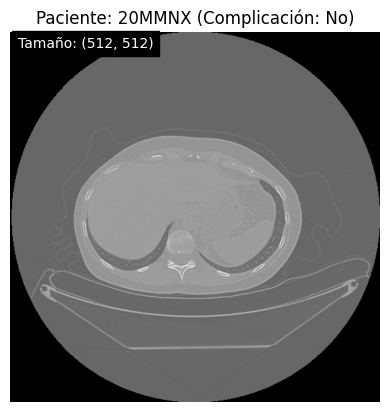

In [21]:
# Obtener una slice del dataset
slice_2d, label, patient_id = train_dataset_2d_preprocessed[700]  # Obtener la slice 2D y su etiqueta
slice_2d = slice_2d.squeeze().numpy()  # Eliminar dimensiones adicionales y convertir a NumPy

# Obtener el tamaño de la slice
slice_size = slice_2d.shape

# Obtener la etiqueta original del diccionario
original_label = labels_dict.get(patient_id, "Desconocido")  # Si no existe, mostrar "Desconocido"


# Visualizar la slice
plt.imshow(slice_2d, cmap='gray')
#plt.title(f"Slice del paciente (Label: {'Sí' if label == 1 else 'No'})")
# plt.title(labels_dict, f"Slice del paciente (Label: )")
#plt.title(f"Paciente: {patient_id} (Label: {'Sí' if label == 1 else 'No'})")  # Mostrar ID y etiqueta
plt.title(f"Paciente: {patient_id} (Complicación: {original_label})")  # Mostrar ID y etiqueta real
plt.text(10, 20, f"Tamaño: {slice_size}", color='white', backgroundcolor='black')  # Agregar texto con el tamaño
plt.axis('off')
plt.show()

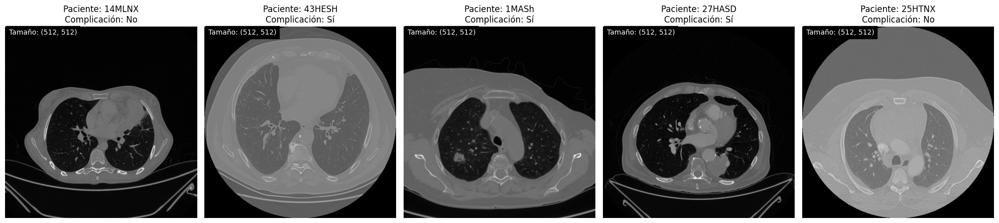

In [22]:
# Seleccionar 5 índices aleatorios del dataset
random_indices = random.sample(range(len(train_dataset_2d_preprocessed)), 5)

# Crear una figura con 5 subgráficos (1 fila, 5 columnas)
fig, axes = plt.subplots(1, 5, figsize=(20, 5))

for i, idx in enumerate(random_indices):
    slice_2d, label, patient_id = train_dataset_2d_preprocessed[idx]  # Obtener la slice, etiqueta y el ID del paciente
    slice_2d = slice_2d.squeeze().numpy()  # Convertir a NumPy
    slice_size = slice_2d.shape  # Obtener el tamaño de la slice

    # Obtener la etiqueta original del diccionario
    original_label = labels_dict.get(patient_id, "Desconocido")

    # Mostrar la imagen en su subgráfico correspondiente
    axes[i].imshow(slice_2d, cmap='gray')
    axes[i].set_title(f"Paciente: {patient_id}\nComplicación: {original_label}")
    axes[i].text(10, 20, f"Tamaño: {slice_size}", color='white', backgroundcolor='black')
    axes[i].axis('off')  # Ocultar ejes

# Ajustar espaciado y mostrar la figura
plt.tight_layout()
plt.show()



In [ ]:
# Obtener los patient_id únicos en el dataset de entrenamiento
unique_patient_ids = set()
for slice_2d, label, patient_id in train_dataset_2d_preprocessed:
    unique_patient_ids.add((patient_id))

print("Pacientes en train:", sorted(unique_patient_ids))

Pacientes en train: ['10MANX', '11HASh', '12HNSN', '13HANX', '15MANX', '16HLNX', '17MANX', '18MANX', '19MANX', '1MASh', '22MTNX', '23MMNX', '24MANX', '25HTNX', '26HMNX', '27HASD', '28HCGNX', '29HMeSX', '2HENX', '30MANX', '31MGNX', '32HENX', '33MANX', '34MASN', '35HENX', '36HENX', '37HPNX', '38HANX', '39MFNX', '3HENX', '40HANX', '41HAsNX', '42HNnNX', '43HESH', '45HNeSN', '46HANX', '47HESN', '48HTtSN', '4HLSh', '5HANX', '6MASN', '7MPNX', '8HENX', '9MANX']


### Modelo 

#### EfficientNetV2-S

In [52]:
#Activamos la GPU
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print (device)

cuda


In [19]:
#EfficientNetV2-S preentrenado (entrenando todas las capas)
model = models.efficientnet_v2_s(weights="IMAGENET1K_V1")

# Convolucion para modificar la primera capa para aceptar imágenes en escala de grises (1 canal en vez de 3)
model.features[0][0] = nn.Conv2d(1, 24, kernel_size=3, stride=2, padding=1, bias=False)

# Modificar la última capa para clasificación binaria
num_features = model.classifier[1].in_features
model.classifier[1] = nn.Sequential(
    nn.Linear(num_features, 1),  # Salida binaria
    nn.Sigmoid()  # Activación sigmoide para clasificación binaria
)

# Enviar modelo a GPU si está disponible
model = model.to(device)

# Mostrar la arquitectura modificada
print(model)

EfficientNet(
  (features): Sequential(
    (0): Conv2dNormActivation(
      (0): Conv2d(1, 24, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(24, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
      (2): SiLU(inplace=True)
    )
    (1): Sequential(
      (0): FusedMBConv(
        (block): Sequential(
          (0): Conv2dNormActivation(
            (0): Conv2d(24, 24, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
            (1): BatchNorm2d(24, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
            (2): SiLU(inplace=True)
          )
        )
        (stochastic_depth): StochasticDepth(p=0.0, mode=row)
      )
      (1): FusedMBConv(
        (block): Sequential(
          (0): Conv2dNormActivation(
            (0): Conv2d(24, 24, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
            (1): BatchNorm2d(24, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  

In [28]:
# Definir función de pérdida y optimizador
criterion = nn.BCELoss()  # Binary Cross Entropy para clasificación binaria
optimizer = optim.Adam(model.parameters(), lr=0.001)

In [26]:
#Definimos los dataloaders
train_dataloader_2d = DataLoader(train_dataset_2d_preprocessed, batch_size=32, shuffle=True, num_workers=8)
val_dataloader_2d = DataLoader(val_dataset_2d_preprocessed, batch_size=32, shuffle=True, num_workers=8)

In [85]:
# Inspeccionar la forma de las imágenes
for images, labels, patient_ids in train_dataloader_2d:
    print(images.shape)  # Debería ser [batch_size, channels, height, width]
    break

torch.Size([32, 1, 512, 512])


Validando Época 1: 100%|██████████| 129/129 [00:49<00:00,  2.61it/s]


Época 1
  Train Loss: 0.4271, Train Accuracy: 0.8193, Train F1-Score: 0.3925
  Val Loss: 2.6993, Val Accuracy: 0.5508, Val F1-Score: 0.0806


Validando Época 2: 100%|██████████| 129/129 [00:30<00:00,  4.21it/s]


Época 2
  Train Loss: 0.3368, Train Accuracy: 0.8558, Train F1-Score: 0.5486
  Val Loss: 3.8591, Val Accuracy: 0.5596, Val F1-Score: 0.1429


Validando Época 3: 100%|██████████| 129/129 [00:23<00:00,  5.45it/s]


Época 3
  Train Loss: 0.3288, Train Accuracy: 0.8593, Train F1-Score: 0.5604
  Val Loss: 0.8856, Val Accuracy: 0.6232, Val F1-Score: 0.5210


Validando Época 4: 100%|██████████| 129/129 [00:23<00:00,  5.50it/s]


Época 4
  Train Loss: 0.3232, Train Accuracy: 0.8610, Train F1-Score: 0.5671
  Val Loss: 3.8006, Val Accuracy: 0.4708, Val F1-Score: 0.0628


Validando Época 5: 100%|██████████| 129/129 [00:38<00:00,  3.37it/s]


Época 5
  Train Loss: 0.3270, Train Accuracy: 0.8601, Train F1-Score: 0.5639
  Val Loss: 2.3889, Val Accuracy: 0.5493, Val F1-Score: 0.1401


Validando Época 6: 100%|██████████| 129/129 [00:35<00:00,  3.59it/s]


Época 6
  Train Loss: 0.3260, Train Accuracy: 0.8631, Train F1-Score: 0.5733
  Val Loss: 3.4805, Val Accuracy: 0.5472, Val F1-Score: 0.1395


Validando Época 7: 100%|██████████| 129/129 [00:24<00:00,  5.21it/s]


Época 7
  Train Loss: 0.3192, Train Accuracy: 0.8627, Train F1-Score: 0.5717
  Val Loss: 2.4986, Val Accuracy: 0.5542, Val F1-Score: 0.1414


Validando Época 8: 100%|██████████| 129/129 [00:27<00:00,  4.64it/s]


Época 8
  Train Loss: 0.3190, Train Accuracy: 0.8629, Train F1-Score: 0.5729
  Val Loss: 5.2158, Val Accuracy: 0.5569, Val F1-Score: 0.1421


Validando Época 9: 100%|██████████| 129/129 [00:35<00:00,  3.66it/s]


Época 9
  Train Loss: 0.3263, Train Accuracy: 0.8610, Train F1-Score: 0.5672
  Val Loss: 2.1174, Val Accuracy: 0.5637, Val F1-Score: 0.1432


Validando Época 10: 100%|██████████| 129/129 [00:34<00:00,  3.71it/s]


Época 10
  Train Loss: 0.3170, Train Accuracy: 0.8633, Train F1-Score: 0.5742
  Val Loss: 4.8968, Val Accuracy: 0.5569, Val F1-Score: 0.1214


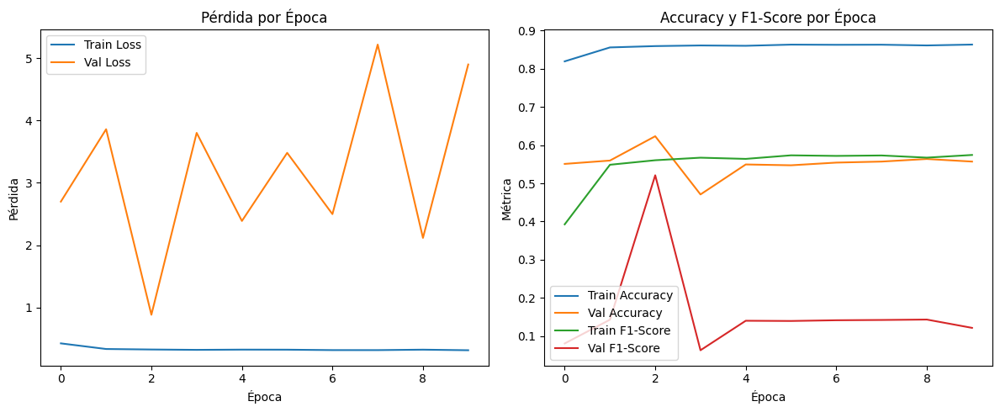

In [86]:
#MAS COMPLETO (GRÁFICAS Y MÉTRICAS)

# Listas para almacenar métricas
train_losses = []
val_losses = []
train_accuracies = []
val_accuracies = []
train_f1_scores = []
val_f1_scores = []

# Loop de entrenamiento y validación
for epoch in range(10):  # Número de épocas
    model.train()  # Modo entrenamiento
    epoch_train_loss = 0.0
    epoch_train_preds = []
    epoch_train_labels = []

    # Entrenamiento
    for images, labels, patient_ids in tqdm(train_dataloader_2d, desc=f"Entrenando Época {epoch+1}"):
        images, labels = images.to(device), labels.float().to(device)

        optimizer.zero_grad()
        #outputs = model(images).squeeze()
        outputs = model(images)  # No usar .squeeze() aquí

        # Ajustar la forma de labels
        labels = labels.unsqueeze(1)  # Convertir de [bs] a [bs, 1] (si no coinciden la dimensionalidad de labels y outputs hay problemas)

        # Inspeccionar formas
        # print(f"Forma de outputs: {outputs.shape}")
        # print(f"Forma de labels: {labels.shape}")

        loss = criterion(outputs, labels) #outputs y labels tengan misma dimensionalidad
        loss.backward()
        optimizer.step()

        epoch_train_loss += loss.item()
        preds = (outputs > 0.5).float()  # Convertir probabilidades a predicciones binarias (0 o 1)
        epoch_train_preds.extend(preds.cpu().numpy().flatten())
        epoch_train_labels.extend(labels.cpu().numpy())

    # Calcular métricas de entrenamiento
    train_loss = epoch_train_loss / len(train_dataloader_2d)
    train_accuracy = accuracy_score(epoch_train_labels, epoch_train_preds)
    train_f1 = f1_score(epoch_train_labels, epoch_train_preds)

    train_losses.append(train_loss)
    train_accuracies.append(train_accuracy)
    train_f1_scores.append(train_f1)

    # Validación
    model.eval()  # Modo evaluación
    epoch_val_loss = 0.0
    epoch_val_preds = []
    epoch_val_labels = []

    with torch.no_grad():  # Desactivar cálculo de gradientes
        for images, labels, patient_ids in tqdm(val_dataloader_2d, desc=f"Validando Época {epoch+1}"):
            images, labels = images.to(device), labels.float().to(device)

            outputs = model(images)

            #Ajustar la forma de labels
            labels = labels.unsqueeze(1)

            loss = criterion(outputs, labels)

            epoch_val_loss += loss.item()
            preds = (outputs > 0.5).float()  # Convertir probabilidades a predicciones binarias (0 o 1)
            epoch_val_preds.extend(preds.cpu().numpy().flatten())
            epoch_val_labels.extend(labels.cpu().numpy())

    # Calcular métricas de validación
    val_loss = epoch_val_loss / len(val_dataloader_2d)
    val_accuracy = accuracy_score(epoch_val_labels, epoch_val_preds)
    val_f1 = f1_score(epoch_val_labels, epoch_val_preds)

    val_losses.append(val_loss)
    val_accuracies.append(val_accuracy)
    val_f1_scores.append(val_f1)

    # Mostrar métricas por época
    print(f"Época {epoch+1}")
    print(f"  Train Loss: {train_loss:.4f}, Train Accuracy: {train_accuracy:.4f}, Train F1-Score: {train_f1:.4f}")
    print(f"  Val Loss: {val_loss:.4f}, Val Accuracy: {val_accuracy:.4f}, Val F1-Score: {val_f1:.4f}")

# Gráficas
plt.figure(figsize=(12, 5))

# Gráfica de pérdida
plt.subplot(1, 2, 1)
plt.plot(train_losses, label="Train Loss")
plt.plot(val_losses, label="Val Loss")
plt.xlabel("Época")
plt.ylabel("Pérdida")
plt.title("Pérdida por Época")
plt.legend()

# Gráfica de accuracy y F1-score
plt.subplot(1, 2, 2)
plt.plot(train_accuracies, label="Train Accuracy")
plt.plot(val_accuracies, label="Val Accuracy")
plt.plot(train_f1_scores, label="Train F1-Score")
plt.plot(val_f1_scores, label="Val F1-Score")
plt.xlabel("Época")
plt.ylabel("Métrica")
plt.title("Accuracy y F1-Score por Época")
plt.legend()

plt.tight_layout()
plt.show()

#### Fine tuning
Vamos a congerlar las capas inciales (ya han aprendido características generales de las imágenes como bordes o texturas)

In [23]:
# Congelar todas las capas excepto las últimas
for param in model.features.parameters():
    param.requires_grad = False  # Congelar parámetros

# Asegurarse de que las capas del clasificador se entrenen
for param in model.classifier.parameters():
    param.requires_grad = True

In [24]:
# Definir el optimizador solo para las capas no congeladas
optimizer = optim.Adam(
    filter(lambda p: p.requires_grad, model.parameters()),  # Solo parámetros no congelados
    lr=0.0001,  # Learning rate más bajo
    weight_decay=1e-5  # Regularización L2
)

Entrenando Época 1:   0%|          | 0/473 [00:00<?, ?it/s]

Validando Época 1: 100%|██████████| 147/147 [00:53<00:00,  2.75it/s]


Época 1
  Train Loss: 0.5491, Train Accuracy: 0.7543, Train F1-Score: 0.1606
  Val Loss: 1.1358, Val Accuracy: 0.4696, Val F1-Score: 0.0000


Validando Época 2: 100%|██████████| 147/147 [00:35<00:00,  4.20it/s]


Época 2
  Train Loss: 0.5175, Train Accuracy: 0.7780, Train F1-Score: 0.1257
  Val Loss: 1.1950, Val Accuracy: 0.4495, Val F1-Score: 0.0008


Validando Época 3: 100%|██████████| 147/147 [00:26<00:00,  5.52it/s]


Época 3
  Train Loss: 0.5076, Train Accuracy: 0.7807, Train F1-Score: 0.1464
  Val Loss: 1.1457, Val Accuracy: 0.4393, Val F1-Score: 0.0023


Validando Época 4: 100%|██████████| 147/147 [00:26<00:00,  5.50it/s]


Época 4
  Train Loss: 0.5016, Train Accuracy: 0.7835, Train F1-Score: 0.1628
  Val Loss: 1.1727, Val Accuracy: 0.4743, Val F1-Score: 0.0000


Validando Época 5: 100%|██████████| 147/147 [00:49<00:00,  2.96it/s]


Época 5
  Train Loss: 0.4950, Train Accuracy: 0.7855, Train F1-Score: 0.1709
  Val Loss: 1.2338, Val Accuracy: 0.4508, Val F1-Score: 0.0000


Validando Época 6: 100%|██████████| 147/147 [00:35<00:00,  4.18it/s]


Época 6
  Train Loss: 0.4918, Train Accuracy: 0.7879, Train F1-Score: 0.1872
  Val Loss: 1.3226, Val Accuracy: 0.4180, Val F1-Score: 0.0236


Validando Época 7: 100%|██████████| 147/147 [00:27<00:00,  5.33it/s]


Época 7
  Train Loss: 0.4946, Train Accuracy: 0.7874, Train F1-Score: 0.1884
  Val Loss: 1.3074, Val Accuracy: 0.4199, Val F1-Score: 0.0109


Validando Época 8: 100%|██████████| 147/147 [00:25<00:00,  5.66it/s]


Época 8
  Train Loss: 0.4886, Train Accuracy: 0.7891, Train F1-Score: 0.1917
  Val Loss: 1.1736, Val Accuracy: 0.4107, Val F1-Score: 0.0150


Validando Época 9: 100%|██████████| 147/147 [00:42<00:00,  3.42it/s]


Época 9
  Train Loss: 0.4932, Train Accuracy: 0.7863, Train F1-Score: 0.1905
  Val Loss: 1.3580, Val Accuracy: 0.4222, Val F1-Score: 0.0073


Validando Época 10: 100%|██████████| 147/147 [00:36<00:00,  3.98it/s]


Época 10
  Train Loss: 0.4875, Train Accuracy: 0.7895, Train F1-Score: 0.2046
  Val Loss: 1.5094, Val Accuracy: 0.4340, Val F1-Score: 0.0008


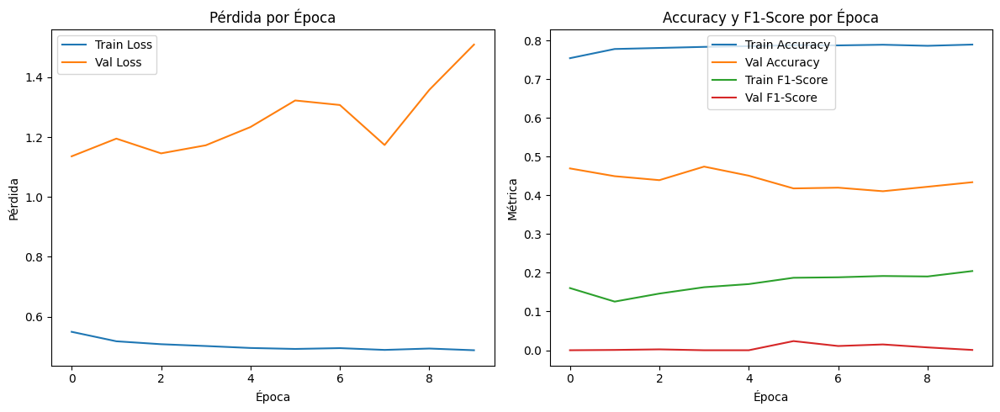

In [29]:
# Listas para almacenar métricas
train_losses = []
val_losses = []
train_accuracies = []
val_accuracies = []
train_f1_scores = []
val_f1_scores = []

# Loop de entrenamiento y validación
for epoch in range(10):  # Número de épocas
    model.train()  # Modo entrenamiento
    epoch_train_loss = 0.0
    epoch_train_preds = []
    epoch_train_labels = []

    # Entrenamiento
    for images, labels, patient_ids in tqdm(train_dataloader_2d, desc=f"Entrenando Época {epoch+1}"):
        images, labels = images.to(device), labels.float().to(device)

        optimizer.zero_grad()
        outputs = model(images)

        # Ajustar la forma de labels
        labels = labels.unsqueeze(1)

        # Calcular la pérdida
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

        epoch_train_loss += loss.item()
        preds = (outputs > 0.5).float()  # Convertir probabilidades a predicciones binarias (0 o 1)
        epoch_train_preds.extend(preds.cpu().numpy().flatten())
        epoch_train_labels.extend(labels.cpu().numpy())

    # Calcular métricas de entrenamiento
    train_loss = epoch_train_loss / len(train_dataloader_2d)
    train_accuracy = accuracy_score(epoch_train_labels, epoch_train_preds)
    train_f1 = f1_score(epoch_train_labels, epoch_train_preds)

    train_losses.append(train_loss)
    train_accuracies.append(train_accuracy)
    train_f1_scores.append(train_f1)

    # Validación
    model.eval()  # Modo evaluación
    epoch_val_loss = 0.0
    epoch_val_preds = []
    epoch_val_labels = []

    with torch.no_grad():  # Desactivar cálculo de gradientes
        for images, labels, patient_ids in tqdm(val_dataloader_2d, desc=f"Validando Época {epoch+1}"):
            images, labels = images.to(device), labels.float().to(device)

            outputs = model(images)

            # Ajustar la forma de labels
            labels = labels.unsqueeze(1)

            # Calcular la pérdida
            loss = criterion(outputs, labels)

            epoch_val_loss += loss.item()
            preds = (outputs > 0.5).float()  # Convertir probabilidades a predicciones binarias (0 o 1)
            epoch_val_preds.extend(preds.cpu().numpy().flatten())
            epoch_val_labels.extend(labels.cpu().numpy())

    # Calcular métricas de validación
    val_loss = epoch_val_loss / len(val_dataloader_2d)
    val_accuracy = accuracy_score(epoch_val_labels, epoch_val_preds)
    val_f1 = f1_score(epoch_val_labels, epoch_val_preds)

    val_losses.append(val_loss)
    val_accuracies.append(val_accuracy)
    val_f1_scores.append(val_f1)

    # Mostrar métricas por época
    print(f"Época {epoch+1}")
    print(f"  Train Loss: {train_loss:.4f}, Train Accuracy: {train_accuracy:.4f}, Train F1-Score: {train_f1:.4f}")
    print(f"  Val Loss: {val_loss:.4f}, Val Accuracy: {val_accuracy:.4f}, Val F1-Score: {val_f1:.4f}")

    # Gráficas
plt.figure(figsize=(12, 5))

# Gráfica de pérdida
plt.subplot(1, 2, 1)
plt.plot(train_losses, label="Train Loss")
plt.plot(val_losses, label="Val Loss")
plt.xlabel("Época")
plt.ylabel("Pérdida")
plt.title("Pérdida por Época")
plt.legend()

# Gráfica de accuracy y F1-score
plt.subplot(1, 2, 2)
plt.plot(train_accuracies, label="Train Accuracy")
plt.plot(val_accuracies, label="Val Accuracy")
plt.plot(train_f1_scores, label="Train F1-Score")
plt.plot(val_f1_scores, label="Val F1-Score")
plt.xlabel("Época")
plt.ylabel("Métrica")
plt.title("Accuracy y F1-Score por Época")
plt.legend()

plt.tight_layout()
plt.show()

#### Efficientnet-v2-s con fine-tuning y 5-fold

In [27]:
# tenemos en la carpeta all todos las imagenes del 1 al 60 preprocesadas. Luego vamos a trabajar y dividir all_cases

# Crear el dataset con todos los casos con las imagenes preprocesadas
all_dataset_preprocessed = PreprocessedDataset(all_preprocessed_dir, labels_dict)

# Crear el dataloader preprocesado
all_loader_2d_preprocessed = DataLoader(all_dataset_preprocessed, batch_size=32, shuffle=True, num_workers=8, pin_memory=True)


Fold 1/5
Validando Época 3: 100%|██████████| 185/185 [00:15<00:00, 11.80it/s]


Validando Época 1: 100%|██████████| 185/185 [00:30<00:00,  6.14it/s]


Época 1
  Train Loss: 0.1044, Train Accuracy: 0.9591, Train F1-Score: 0.9185
  Val Loss: 0.0174, Val Accuracy: 0.9946, Val F1-Score: 0.9895


Validando Época 2: 100%|██████████| 185/185 [00:27<00:00,  6.62it/s]


Época 2
  Train Loss: 0.0195, Train Accuracy: 0.9940, Train F1-Score: 0.9885
  Val Loss: 0.0010, Val Accuracy: 1.0000, Val F1-Score: 1.0000


Validando Época 3: 100%|██████████| 185/185 [00:15<00:00, 11.89it/s]


Época 3
  Train Loss: 0.0082, Train Accuracy: 0.9976, Train F1-Score: 0.9954
  Val Loss: 0.0001, Val Accuracy: 1.0000, Val F1-Score: 1.0000


Entrenando Época 4:  39%|███▊      | 285/737 [01:20<02:06,  3.59it/s]

Época 3
  Train Loss: 0.0084, Train Accuracy: 0.9981, Train F1-Score: 0.9965
  Val Loss: 0.0019, Val Accuracy: 0.9997, Val F1-Score: 0.9993


Validando Época 4: 100%|██████████| 185/185 [00:16<00:00, 11.02it/s]


Época 4
  Train Loss: 0.0155, Train Accuracy: 0.9957, Train F1-Score: 0.9918
  Val Loss: 0.0257, Val Accuracy: 0.9942, Val F1-Score: 0.9885


Validando Época 5: 100%|██████████| 185/185 [00:16<00:00, 10.89it/s]


Época 5
  Train Loss: 0.0032, Train Accuracy: 0.9992, Train F1-Score: 0.9984
  Val Loss: 0.0001, Val Accuracy: 1.0000, Val F1-Score: 1.0000


Validando Época 6: 100%|██████████| 185/185 [00:15<00:00, 11.70it/s]


Época 6
  Train Loss: 0.0094, Train Accuracy: 0.9972, Train F1-Score: 0.9947
  Val Loss: 0.0058, Val Accuracy: 0.9990, Val F1-Score: 0.9979


Validando Época 7: 100%|██████████| 185/185 [00:15<00:00, 11.77it/s]


Época 7
  Train Loss: 0.0012, Train Accuracy: 0.9997, Train F1-Score: 0.9995
  Val Loss: 0.0230, Val Accuracy: 0.9925, Val F1-Score: 0.9847


Validando Época 8: 100%|██████████| 185/185 [00:16<00:00, 11.00it/s]


Época 8
  Train Loss: 0.0066, Train Accuracy: 0.9984, Train F1-Score: 0.9969
  Val Loss: 0.0000, Val Accuracy: 1.0000, Val F1-Score: 1.0000


Validando Época 9: 100%|██████████| 185/185 [00:18<00:00, 10.16it/s]


Época 9
  Train Loss: 0.0069, Train Accuracy: 0.9980, Train F1-Score: 0.9963
  Val Loss: 0.0003, Val Accuracy: 1.0000, Val F1-Score: 1.0000


Validando Época 10: 100%|██████████| 185/185 [00:16<00:00, 11.02it/s]


Época 10
  Train Loss: 0.0133, Train Accuracy: 0.9980, Train F1-Score: 0.9963
  Val Loss: 0.0008, Val Accuracy: 1.0000, Val F1-Score: 1.0000

Fold 3/5


Validando Época 1: 100%|██████████| 185/185 [00:16<00:00, 10.92it/s]


Época 1
  Train Loss: 0.1021, Train Accuracy: 0.9630, Train F1-Score: 0.9265
  Val Loss: 0.0227, Val Accuracy: 0.9888, Val F1-Score: 0.9780


Validando Época 2: 100%|██████████| 185/185 [00:16<00:00, 11.53it/s]


Época 2
  Train Loss: 0.0179, Train Accuracy: 0.9946, Train F1-Score: 0.9896
  Val Loss: 0.0258, Val Accuracy: 0.9874, Val F1-Score: 0.9764


Validando Época 3: 100%|██████████| 185/185 [00:16<00:00, 11.52it/s]


Época 3
  Train Loss: 0.0086, Train Accuracy: 0.9979, Train F1-Score: 0.9959
  Val Loss: 0.0005, Val Accuracy: 1.0000, Val F1-Score: 1.0000


Validando Época 4: 100%|██████████| 185/185 [00:17<00:00, 10.50it/s]


Época 4
  Train Loss: 0.0088, Train Accuracy: 0.9977, Train F1-Score: 0.9956
  Val Loss: 0.0127, Val Accuracy: 0.9946, Val F1-Score: 0.9895


Validando Época 5: 100%|██████████| 185/185 [00:16<00:00, 10.94it/s]


Época 5
  Train Loss: 0.0051, Train Accuracy: 0.9986, Train F1-Score: 0.9974
  Val Loss: 0.0000, Val Accuracy: 1.0000, Val F1-Score: 1.0000


Validando Época 6: 100%|██████████| 185/185 [00:15<00:00, 11.86it/s]


Época 6
  Train Loss: 0.0006, Train Accuracy: 0.9999, Train F1-Score: 0.9998
  Val Loss: 0.0000, Val Accuracy: 1.0000, Val F1-Score: 1.0000


Validando Época 7: 100%|██████████| 185/185 [00:15<00:00, 11.91it/s]


Época 7
  Train Loss: 0.0001, Train Accuracy: 1.0000, Train F1-Score: 1.0000
  Val Loss: 0.0000, Val Accuracy: 1.0000, Val F1-Score: 1.0000


Validando Época 8: 100%|██████████| 185/185 [00:15<00:00, 11.81it/s]


Época 8
  Train Loss: 0.0202, Train Accuracy: 0.9943, Train F1-Score: 0.9891
  Val Loss: 0.0001, Val Accuracy: 1.0000, Val F1-Score: 1.0000


Validando Época 9: 100%|██████████| 185/185 [00:15<00:00, 11.96it/s]


Época 9
  Train Loss: 0.0004, Train Accuracy: 1.0000, Train F1-Score: 1.0000
  Val Loss: 0.0000, Val Accuracy: 1.0000, Val F1-Score: 1.0000


Validando Época 10: 100%|██████████| 185/185 [00:15<00:00, 11.90it/s]


Época 10
  Train Loss: 0.0129, Train Accuracy: 0.9982, Train F1-Score: 0.9966
  Val Loss: 0.0001, Val Accuracy: 1.0000, Val F1-Score: 1.0000

Fold 4/5


Validando Época 1: 100%|██████████| 185/185 [00:15<00:00, 11.84it/s]


Época 1
  Train Loss: 0.1172, Train Accuracy: 0.9546, Train F1-Score: 0.9091
  Val Loss: 0.0037, Val Accuracy: 0.9997, Val F1-Score: 0.9994


Validando Época 2: 100%|██████████| 185/185 [00:15<00:00, 11.88it/s]


Época 2
  Train Loss: 0.0157, Train Accuracy: 0.9950, Train F1-Score: 0.9904
  Val Loss: 0.0021, Val Accuracy: 0.9997, Val F1-Score: 0.9994


Validando Época 3: 100%|██████████| 185/185 [00:15<00:00, 11.81it/s]


Época 3
  Train Loss: 0.0048, Train Accuracy: 0.9986, Train F1-Score: 0.9974
  Val Loss: 0.0001, Val Accuracy: 1.0000, Val F1-Score: 1.0000


Validando Época 4: 100%|██████████| 185/185 [00:15<00:00, 11.67it/s]


Época 4
  Train Loss: 0.0123, Train Accuracy: 0.9960, Train F1-Score: 0.9923
  Val Loss: 0.0061, Val Accuracy: 0.9980, Val F1-Score: 0.9961


Validando Época 5: 100%|██████████| 185/185 [00:15<00:00, 11.84it/s]


Época 5
  Train Loss: 0.0114, Train Accuracy: 0.9984, Train F1-Score: 0.9969
  Val Loss: 0.0003, Val Accuracy: 1.0000, Val F1-Score: 1.0000


Validando Época 6: 100%|██████████| 185/185 [00:15<00:00, 11.83it/s]


Época 6
  Train Loss: 0.0212, Train Accuracy: 0.9960, Train F1-Score: 0.9923
  Val Loss: 0.0211, Val Accuracy: 0.9953, Val F1-Score: 0.9910


Validando Época 7: 100%|██████████| 185/185 [00:15<00:00, 11.75it/s]


Época 7
  Train Loss: 0.0071, Train Accuracy: 0.9989, Train F1-Score: 0.9979
  Val Loss: 0.0000, Val Accuracy: 1.0000, Val F1-Score: 1.0000


Validando Época 8: 100%|██████████| 185/185 [00:15<00:00, 11.79it/s]


Época 8
  Train Loss: 0.0045, Train Accuracy: 0.9991, Train F1-Score: 0.9982
  Val Loss: 0.0000, Val Accuracy: 1.0000, Val F1-Score: 1.0000


Validando Época 9: 100%|██████████| 185/185 [00:15<00:00, 11.75it/s]


Época 9
  Train Loss: 0.0002, Train Accuracy: 1.0000, Train F1-Score: 1.0000
  Val Loss: 0.0000, Val Accuracy: 1.0000, Val F1-Score: 1.0000


Validando Época 10: 100%|██████████| 185/185 [00:15<00:00, 11.96it/s]


Época 10
  Train Loss: 0.0073, Train Accuracy: 0.9977, Train F1-Score: 0.9956
  Val Loss: 0.0001, Val Accuracy: 1.0000, Val F1-Score: 1.0000

Fold 5/5


Validando Época 1: 100%|██████████| 185/185 [00:15<00:00, 11.82it/s]


Época 1
  Train Loss: 0.1036, Train Accuracy: 0.9629, Train F1-Score: 0.9252
  Val Loss: 0.0032, Val Accuracy: 0.9990, Val F1-Score: 0.9981


Validando Época 2: 100%|██████████| 185/185 [00:15<00:00, 11.87it/s]


Época 2
  Train Loss: 0.0165, Train Accuracy: 0.9958, Train F1-Score: 0.9918
  Val Loss: 0.0027, Val Accuracy: 1.0000, Val F1-Score: 1.0000


Validando Época 3: 100%|██████████| 185/185 [00:15<00:00, 11.76it/s]


Época 3
  Train Loss: 0.0117, Train Accuracy: 0.9972, Train F1-Score: 0.9946
  Val Loss: 0.0001, Val Accuracy: 1.0000, Val F1-Score: 1.0000


Validando Época 4: 100%|██████████| 185/185 [00:15<00:00, 11.78it/s]


Época 4
  Train Loss: 0.0137, Train Accuracy: 0.9966, Train F1-Score: 0.9934
  Val Loss: 0.0057, Val Accuracy: 0.9980, Val F1-Score: 0.9963


Validando Época 5: 100%|██████████| 185/185 [00:15<00:00, 11.87it/s]


Época 5
  Train Loss: 0.0091, Train Accuracy: 0.9973, Train F1-Score: 0.9947
  Val Loss: 0.0001, Val Accuracy: 1.0000, Val F1-Score: 1.0000


Validando Época 6: 100%|██████████| 185/185 [00:15<00:00, 11.85it/s]


Época 6
  Train Loss: 0.0152, Train Accuracy: 0.9966, Train F1-Score: 0.9934
  Val Loss: 0.0002, Val Accuracy: 1.0000, Val F1-Score: 1.0000


Validando Época 7: 100%|██████████| 185/185 [00:15<00:00, 11.92it/s]


Época 7
  Train Loss: 0.0306, Train Accuracy: 0.9970, Train F1-Score: 0.9942
  Val Loss: 0.0000, Val Accuracy: 1.0000, Val F1-Score: 1.0000


Validando Época 8: 100%|██████████| 185/185 [00:15<00:00, 11.81it/s]


Época 8
  Train Loss: 0.0003, Train Accuracy: 1.0000, Train F1-Score: 1.0000
  Val Loss: 0.0001, Val Accuracy: 1.0000, Val F1-Score: 1.0000


Validando Época 9: 100%|██████████| 185/185 [00:15<00:00, 11.80it/s]


Época 9
  Train Loss: 0.0003, Train Accuracy: 1.0000, Train F1-Score: 1.0000
  Val Loss: 0.0000, Val Accuracy: 1.0000, Val F1-Score: 1.0000


Validando Época 10: 100%|██████████| 185/185 [00:15<00:00, 11.78it/s]


Época 10
  Train Loss: 0.0001, Train Accuracy: 1.0000, Train F1-Score: 1.0000
  Val Loss: 0.0000, Val Accuracy: 1.0000, Val F1-Score: 1.0000


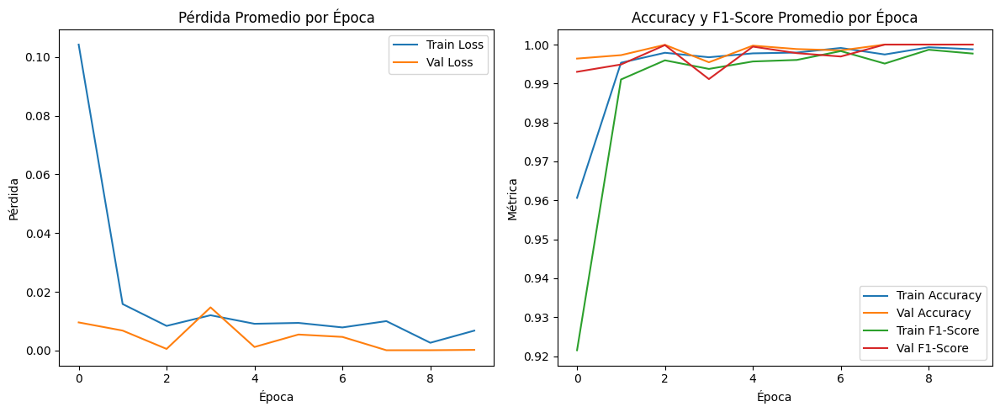

In [ ]:
# Convertir tu dataset a un formato compatible con KFold
X = np.arange(len(all_dataset_preprocessed))  # Índices de las muestras
y = np.array([label for _, label, _ in all_dataset_preprocessed])  # Etiquetas

# Inicializar KFold
kf = KFold(n_splits=5, shuffle=True, random_state=42)

# Listas para almacenar métricas promedio
all_train_losses = []
all_val_losses = []
all_train_accuracies = []
all_val_accuracies = []
all_train_f1_scores = []
all_val_f1_scores = []

# Bucle de 5-Fold Cross-Validation
for fold, (train_idx, val_idx) in enumerate(kf.split(X)):
    print(f"\nFold {fold + 1}/5")

    # Crear datasets de entrenamiento y validación para este fold
    train_fold_dataset = torch.utils.data.Subset(all_dataset_preprocessed, train_idx)
    val_fold_dataset = torch.utils.data.Subset(all_dataset_preprocessed, val_idx)

    # Crear DataLoaders para este fold
    train_fold_loader = DataLoader(train_fold_dataset, batch_size=16, shuffle=True)
    val_fold_loader = DataLoader(val_fold_dataset, batch_size=16, shuffle=False)

    # Reiniciar el modelo para cada fold
    model = models.efficientnet_v2_s(weights="IMAGENET1K_V1")
    model.features[0][0] = nn.Conv2d(1, 24, kernel_size=3, stride=2, padding=1, bias=False)
    model.classifier[1] = nn.Sequential(
        nn.Linear(num_features, 1),  # Salida binaria
        nn.Sigmoid()  # Activación sigmoide para clasificación binaria
    )
    model = model.to(device)

    # Definir función de pérdida y optimizador
    criterion = nn.BCELoss()
    optimizer = optim.Adam(model.parameters(), lr=0.0001, weight_decay=1e-5)

    # Listas para almacenar métricas de este fold
    train_losses = []
    val_losses = []
    train_accuracies = []
    val_accuracies = []
    train_f1_scores = []
    val_f1_scores = []

    # Loop de entrenamiento y validación para este fold
    for epoch in range(10):  # Número de épocas
        model.train()  # Modo entrenamiento
        epoch_train_loss = 0.0
        epoch_train_preds = []
        epoch_train_labels = []

        # Entrenamiento
        for images, labels, patient_ids in tqdm(train_fold_loader, desc=f"Entrenando Época {epoch+1}"):
            images, labels = images.to(device), labels.float().to(device)

            optimizer.zero_grad()
            outputs = model(images)

            # Ajustar la forma de labels
            labels = labels.unsqueeze(1)

            # Calcular la pérdida
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()

            epoch_train_loss += loss.item()
            preds = (outputs > 0.5).float()  # Convertir probabilidades a predicciones binarias (0 o 1)
            epoch_train_preds.extend(preds.cpu().numpy().flatten())
            epoch_train_labels.extend(labels.cpu().numpy())

        # Calcular métricas de entrenamiento
        train_loss = epoch_train_loss / len(train_fold_loader)
        train_accuracy = accuracy_score(epoch_train_labels, epoch_train_preds)
        train_f1 = f1_score(epoch_train_labels, epoch_train_preds, zero_division=0)

        train_losses.append(train_loss)
        train_accuracies.append(train_accuracy)
        train_f1_scores.append(train_f1)

        # Validación
        model.eval()  # Modo evaluación
        epoch_val_loss = 0.0
        epoch_val_preds = []
        epoch_val_labels = []

        with torch.no_grad():  # Desactivar cálculo de gradientes
            for images, labels, patient_ids in tqdm(val_fold_loader, desc=f"Validando Época {epoch+1}"):
                images, labels = images.to(device), labels.float().to(device)

                outputs = model(images)

                # Ajustar la forma de labels
                labels = labels.unsqueeze(1)

                # Calcular la pérdida
                loss = criterion(outputs, labels)

                epoch_val_loss += loss.item()
                preds = (outputs > 0.5).float()  # Convertir probabilidades a predicciones binarias (0 o 1)
                epoch_val_preds.extend(preds.cpu().numpy().flatten())
                epoch_val_labels.extend(labels.cpu().numpy())

        # Calcular métricas de validación
        val_loss = epoch_val_loss / len(val_fold_loader)
        val_accuracy = accuracy_score(epoch_val_labels, epoch_val_preds)
        val_f1 = f1_score(epoch_val_labels, epoch_val_preds, zero_division=0)

        val_losses.append(val_loss)
        val_accuracies.append(val_accuracy)
        val_f1_scores.append(val_f1)

        # Mostrar métricas por época
        print(f"Época {epoch+1}")
        print(f"  Train Loss: {train_loss:.4f}, Train Accuracy: {train_accuracy:.4f}, Train F1-Score: {train_f1:.4f}")
        print(f"  Val Loss: {val_loss:.4f}, Val Accuracy: {val_accuracy:.4f}, Val F1-Score: {val_f1:.4f}")

    # Guardar métricas de este fold
    all_train_losses.append(train_losses)
    all_val_losses.append(val_losses)
    all_train_accuracies.append(train_accuracies)
    all_val_accuracies.append(val_accuracies)
    all_train_f1_scores.append(train_f1_scores)
    all_val_f1_scores.append(val_f1_scores)

# Calcular métricas promedio de todos los folds
avg_train_losses = np.mean(all_train_losses, axis=0)
avg_val_losses = np.mean(all_val_losses, axis=0)
avg_train_accuracies = np.mean(all_train_accuracies, axis=0)
avg_val_accuracies = np.mean(all_val_accuracies, axis=0)
avg_train_f1_scores = np.mean(all_train_f1_scores, axis=0)
avg_val_f1_scores = np.mean(all_val_f1_scores, axis=0)

# Gráficas de métricas promedio
plt.figure(figsize=(12, 5))

# Gráfica de pérdida
plt.subplot(1, 2, 1)
plt.plot(avg_train_losses, label="Train Loss")
plt.plot(avg_val_losses, label="Val Loss")
plt.xlabel("Época")
plt.ylabel("Pérdida")
plt.title("Pérdida Promedio por Época")
plt.legend()

# Gráfica de accuracy y F1-score
plt.subplot(1, 2, 2)
plt.plot(avg_train_accuracies, label="Train Accuracy")
plt.plot(avg_val_accuracies, label="Val Accuracy")
plt.plot(avg_train_f1_scores, label="Train F1-Score")
plt.plot(avg_val_f1_scores, label="Val F1-Score")
plt.xlabel("Época")
plt.ylabel("Métrica")
plt.title("Accuracy y F1-Score Promedio por Época")
plt.legend()

plt.tight_layout()
plt.show()

#### Efficientnet-v2-s y 5-fold con test (sin validacion)

In [18]:
# tenemos en la carpeta all todos las imagenes del 1 al 60 preprocesadas. Luego vamos a trabajar y dividir all_cases

# Crear el dataset con todos los casos con las imagenes preprocesadas
all_dataset_preprocessed = PreprocessedDataset(all_preprocessed_dir, labels_dict)


In [28]:
# Convertir tu dataset a un formato compatible con KFold
X = np.arange(len(all_dataset_preprocessed))  # Índices de las muestras
y = np.array([label for _, label, _ in all_dataset_preprocessed])  # Etiquetas

# Inicializar KFold
kf = KFold(n_splits=5, shuffle=True, random_state=42)

# Listas para almacenar métricas de "test"
all_test_losses = []
all_test_accuracies = []
all_test_f1_scores = []

# Bucle de 5-Fold Cross-Validation (usando un fold como "test")
for fold, (train_val_idx, test_idx) in enumerate(kf.split(X)):
    print(f"\nFold {fold + 1}/5")

    # Crear datasets de entrenamiento+validación y test para este fold
    train_val_dataset = torch.utils.data.Subset(all_dataset_preprocessed, train_val_idx)
    test_dataset = torch.utils.data.Subset(all_dataset_preprocessed, test_idx)

    # Crear DataLoaders para este fold
    train_val_loader = DataLoader(train_val_dataset, batch_size=16, shuffle=True, num_workers=8, pin_memory=True)
    test_loader = DataLoader(test_dataset, batch_size=16, shuffle=False, num_workers=8, pin_memory=True)

    # Reiniciar el modelo para cada fold
    model = models.efficientnet_v2_s(weights="IMAGENET1K_V1")
    model.features[0][0] = nn.Conv2d(1, 24, kernel_size=3, stride=2, padding=1, bias=False)
    model.classifier[1] = nn.Sequential(
        nn.Linear(num_features, 1),  # Salida binaria
        nn.Sigmoid()  # Activación sigmoide para clasificación binaria
    )
    model = model.to(device)

    # Definir función de pérdida y optimizador
    criterion = nn.BCELoss()
    optimizer = optim.Adam(model.parameters(), lr=0.0001, weight_decay=1e-5)

    # Entrenar el modelo en train+validation
    for epoch in range(10):  # Número de épocas
        model.train()  # Modo entrenamiento
        epoch_train_loss = 0.0

        # Entrenamiento
        for images, labels, patient_ids in tqdm(train_val_loader, desc=f"Entrenando Época {epoch+1}"):
            images, labels = images.to(device), labels.float().to(device)

            optimizer.zero_grad()
            outputs = model(images)

            # Ajustar la forma de labels
            labels = labels.unsqueeze(1)

            # Calcular la pérdida
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()

            epoch_train_loss += loss.item()

    # Evaluar el modelo en el conjunto de "test"
    model.eval()  # Modo evaluación
    test_loss = 0.0
    test_preds = []
    test_labels = []

    with torch.no_grad():  # Desactivar cálculo de gradientes
        for images, labels, patient_ids in tqdm(test_loader, desc="Evaluando en Test"):
            images, labels = images.to(device), labels.float().to(device)

            outputs = model(images)

            # Ajustar la forma de labels
            labels = labels.unsqueeze(1)

            # Calcular la pérdida
            loss = criterion(outputs, labels)

            test_loss += loss.item()
            preds = (outputs > 0.5).float()  # Convertir probabilidades a predicciones binarias (0 o 1)
            test_preds.extend(preds.cpu().numpy().flatten())
            test_labels.extend(labels.cpu().numpy())

    # Calcular métricas en "test"
    test_loss = test_loss / len(test_loader)
    test_accuracy = accuracy_score(test_labels, test_preds)
    test_f1 = f1_score(test_labels, test_preds, zero_division=0)

    # Guardar métricas de este fold
    all_test_losses.append(test_loss)
    all_test_accuracies.append(test_accuracy)
    all_test_f1_scores.append(test_f1)

    # Mostrar métricas por fold
    print(f"Fold {fold + 1}")
    print(f"  Test Loss: {test_loss:.4f}, Test Accuracy: {test_accuracy:.4f}, Test F1-Score: {test_f1:.4f}")

# Calcular métricas promedio de todos los folds
avg_test_loss = np.mean(all_test_losses)
avg_test_accuracy = np.mean(all_test_accuracies)
avg_test_f1 = np.mean(all_test_f1_scores)

print(f"\nMétricas Promedio en Test:")
print(f"  Test Loss: {avg_test_loss:.4f}, Test Accuracy: {avg_test_accuracy:.4f}, Test F1-Score: {avg_test_f1:.4f}")


Fold 1/5


Evaluando en Test: 100%|██████████| 185/185 [00:13<00:00, 13.43it/s]


Fold 1
  Test Loss: 0.0008, Test Accuracy: 1.0000, Test F1-Score: 1.0000

Fold 2/5


Evaluando en Test: 100%|██████████| 185/185 [00:13<00:00, 13.92it/s]


Fold 2
  Test Loss: 0.0000, Test Accuracy: 1.0000, Test F1-Score: 1.0000

Fold 3/5


Evaluando en Test: 100%|██████████| 185/185 [00:13<00:00, 13.67it/s]


Fold 3
  Test Loss: 0.0000, Test Accuracy: 1.0000, Test F1-Score: 1.0000

Fold 4/5


Evaluando en Test: 100%|██████████| 185/185 [00:13<00:00, 13.79it/s]


Fold 4
  Test Loss: 0.0007, Test Accuracy: 1.0000, Test F1-Score: 1.0000

Fold 5/5


Evaluando en Test: 100%|██████████| 185/185 [00:13<00:00, 13.86it/s]

Fold 5
  Test Loss: 0.0001, Test Accuracy: 1.0000, Test F1-Score: 1.0000

Métricas Promedio en Test:
  Test Loss: 0.0003, Test Accuracy: 1.0000, Test F1-Score: 1.0000


#### Efficientnet-v2-s y 5-fold estratificado (con test y sin validacion)

In [24]:
import pandas as pd  # Importar pandas para crear la tabla

# Convertir tu dataset a un formato compatible con StratifiedKFold
X = np.arange(len(all_dataset_preprocessed))  # Índices de las muestras
y = np.array([label for _, label, _ in all_dataset_preprocessed])  # Etiquetas

# Inicializar StratifiedKFold
skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)  # Estratificado

# Listas para almacenar métricas de "test"
all_test_losses = []
all_test_accuracies = []
all_test_f1_scores = []

# Lista para almacenar los resultados de cada fold
all_fold_results = []

# Bucle de 5-Fold Cross-Validation Estratificado (usando un fold como "test")
for fold, (train_val_idx, test_idx) in enumerate(skf.split(X, y)):  # Pasar X e y a skf.split
    print(f"\nFold {fold + 1}/5")

    # Crear datasets de entrenamiento+validación y test para este fold
    train_val_dataset = torch.utils.data.Subset(all_dataset_preprocessed, train_val_idx)
    test_dataset = torch.utils.data.Subset(all_dataset_preprocessed, test_idx)

    # Crear DataLoaders para este fold
    train_val_loader = DataLoader(train_val_dataset, batch_size=16, shuffle=True, num_workers=8, pin_memory=True)
    test_loader = DataLoader(test_dataset, batch_size=16, shuffle=False, num_workers=8, pin_memory=True)

    # Reiniciar el modelo para cada fold
    model = models.efficientnet_v2_s(weights="IMAGENET1K_V1")
    model.features[0][0] = nn.Conv2d(1, 24, kernel_size=3, stride=2, padding=1, bias=False)
    model.classifier[1] = nn.Sequential(
        nn.Linear(num_features, 1),  # Salida binaria
        nn.Sigmoid()  # Activación sigmoide para clasificación binaria
    )
    model = model.to(device)

    # Definir función de pérdida y optimizador
    criterion = nn.BCELoss()
    optimizer = optim.Adam(model.parameters(), lr=0.0001, weight_decay=1e-5)

    # Entrenar el modelo en train+validation
    for epoch in range(10):  # Número de épocas
        model.train()  # Modo entrenamiento
        epoch_train_loss = 0.0

        # Entrenamiento
        for images, labels, patient_ids in tqdm(train_val_loader, desc=f"Entrenando Época {epoch+1}"):
            images, labels = images.to(device), labels.float().to(device)

            optimizer.zero_grad()
            outputs = model(images)

            # Ajustar la forma de labels
            labels = labels.unsqueeze(1)

            # Calcular la pérdida
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()

            epoch_train_loss += loss.item()

    # Evaluar el modelo en el conjunto de "test"
    model.eval()  # Modo evaluación
    test_loss = 0.0
    test_preds = []
    test_labels = []
    test_ids = []  # Lista para almacenar los IDs de las imágenes
    test_probs = []  # Lista para almacenar las probabilidades de predicción

    with torch.no_grad():  # Desactivar cálculo de gradientes
        for images, labels, patient_ids in tqdm(test_loader, desc="Evaluando en Test"):
            images, labels = images.to(device), labels.float().to(device)

            outputs = model(images)

            # Ajustar la forma de labels
            labels = labels.unsqueeze(1)

            # Calcular la pérdida
            loss = criterion(outputs, labels)

            test_loss += loss.item()
            preds = (outputs > 0.5).float()  # Convertir probabilidades a predicciones binarias (0 o 1)
            test_preds.extend(preds.cpu().numpy().flatten())
            test_labels.extend(labels.cpu().numpy())
            test_ids.extend(patient_ids)  # Almacenar los IDs de las imágenes
            test_probs.extend(outputs.cpu().numpy().flatten())  # Almacenar las probabilidades de predicción

    # Calcular métricas en "test"
    test_loss = test_loss / len(test_loader)
    test_accuracy = accuracy_score(test_labels, test_preds)
    test_f1 = f1_score(test_labels, test_preds, zero_division=0)

    # Guardar métricas de este fold
    all_test_losses.append(test_loss)
    all_test_accuracies.append(test_accuracy)
    all_test_f1_scores.append(test_f1)

    # Crear un DataFrame con los resultados de este fold
    fold_results = pd.DataFrame({
        "ID": test_ids,  # ID de la imagen
        "Clase Real": test_labels,  # Clase real (0 o 1)
        "Predicción": test_preds,  # Predicción del modelo (0 o 1)
        "Probabilidad": test_probs  # Probabilidad de la predicción
    })

    # Guardar los resultados de este fold
    all_fold_results.append(fold_results)

    # Mostrar métricas por fold
    print(f"Fold {fold + 1}")
    print(f"  Test Loss: {test_loss:.4f}, Test Accuracy: {test_accuracy:.4f}, Test F1-Score: {test_f1:.4f}")
    print(f"  Resultados en Test:")
    print(fold_results)  # Mostrar la tabla de resultados de este fold

# Calcular métricas promedio de todos los folds
avg_test_loss = np.mean(all_test_losses)
avg_test_accuracy = np.mean(all_test_accuracies)
avg_test_f1 = np.mean(all_test_f1_scores)

print(f"\nMétricas Promedio en Test:")
print(f"  Test Loss: {avg_test_loss:.4f}, Test Accuracy: {avg_test_accuracy:.4f}, Test F1-Score: {avg_test_f1:.4f}")

# Combinar los resultados de todos los folds en una sola tabla
all_results = pd.concat(all_fold_results, ignore_index=True)

# Mostrar la tabla completa con todos los resultados
print("\nResultados Completos en Test:")
print(all_results)


Fold 1/5


Evaluando en Test: 100%|██████████| 185/185 [00:13<00:00, 13.89it/s]


Fold 1
  Test Loss: 0.0000, Test Accuracy: 1.0000, Test F1-Score: 1.0000
  Resultados en Test:
          ID Clase Real  Predicción  Probabilidad
0     13HANX      [0.0]         0.0  3.783434e-07
1     17MANX      [0.0]         0.0  2.692944e-07
2     31MGNX      [0.0]         0.0  5.884536e-07
3     39MFNX      [0.0]         0.0  1.245013e-05
4     39MFNX      [0.0]         0.0  7.708994e-06
...      ...        ...         ...           ...
2944   2HENX      [0.0]         0.0  5.072463e-06
2945  47HESN      [1.0]         1.0  9.999985e-01
2946  51HFNX      [0.0]         0.0  5.888449e-06
2947  27HASD      [1.0]         1.0  9.999998e-01
2948  53HANX      [0.0]         0.0  1.101405e-06

[2949 rows x 4 columns]

Fold 2/5


Evaluando en Test: 100%|██████████| 185/185 [00:13<00:00, 14.01it/s]


Fold 2
  Test Loss: 0.0000, Test Accuracy: 1.0000, Test F1-Score: 1.0000
  Resultados en Test:
           ID Clase Real  Predicción  Probabilidad
0      10MANX      [0.0]         0.0      0.000025
1      13HANX      [0.0]         0.0      0.000006
2      16HLNX      [0.0]         0.0      0.000017
3      27HASD      [1.0]         1.0      0.999997
4      27HASD      [1.0]         1.0      0.999999
...       ...        ...         ...           ...
2943   25HTNX      [0.0]         0.0      0.000015
2944  45HNeSN      [1.0]         1.0      0.999992
2945  42HNnNX      [0.0]         0.0      0.000039
2946  45HNeSN      [1.0]         1.0      0.999997
2947   22MTNX      [0.0]         0.0      0.000030

[2948 rows x 4 columns]

Fold 3/5


Evaluando en Test: 100%|██████████| 185/185 [00:13<00:00, 13.81it/s]


Fold 3
  Test Loss: 0.0000, Test Accuracy: 1.0000, Test F1-Score: 1.0000
  Resultados en Test:
          ID Clase Real  Predicción  Probabilidad
0     22MTNX      [0.0]         0.0      0.000004
1     24MANX      [0.0]         0.0      0.000030
2     25HTNX      [0.0]         0.0      0.000007
3     33MANX      [0.0]         0.0      0.000003
4     33MANX      [0.0]         0.0      0.000005
...      ...        ...         ...           ...
2943   8HENX      [0.0]         0.0      0.000005
2944  31MGNX      [0.0]         0.0      0.000008
2945  32HENX      [0.0]         0.0      0.000001
2946  32HENX      [0.0]         0.0      0.000001
2947   3HENX      [0.0]         0.0      0.000004

[2948 rows x 4 columns]

Fold 4/5


Evaluando en Test: 100%|██████████| 185/185 [00:13<00:00, 13.82it/s]


Fold 4
  Test Loss: 0.0000, Test Accuracy: 1.0000, Test F1-Score: 1.0000
  Resultados en Test:
           ID Clase Real  Predicción  Probabilidad
0      10MANX      [0.0]         0.0  3.165654e-07
1      12HNSN      [1.0]         1.0  9.999994e-01
2      17MANX      [0.0]         0.0  3.825685e-06
3      19MANX      [0.0]         0.0  7.053796e-05
4      26HMNX      [0.0]         0.0  1.459215e-06
...       ...        ...         ...           ...
2943    5HANX      [0.0]         0.0  2.161279e-05
2944   40HANX      [0.0]         0.0  5.172830e-07
2945  28HCGNX      [0.0]         0.0  1.334558e-07
2946  45HNeSN      [1.0]         1.0  9.999999e-01
2947    9MANX      [0.0]         0.0  6.980739e-07

[2948 rows x 4 columns]

Fold 5/5


Evaluando en Test: 100%|██████████| 185/185 [00:13<00:00, 13.83it/s]

Fold 5
  Test Loss: 0.0067, Test Accuracy: 0.9969, Test F1-Score: 0.9942
  Resultados en Test:
          ID Clase Real  Predicción  Probabilidad
0     12HNSN      [1.0]         1.0      0.999943
1     25HTNX      [0.0]         0.0      0.000420
2     27HASD      [1.0]         1.0      0.999924
3      2HENX      [0.0]         0.0      0.000302
4     40HANX      [0.0]         0.0      0.000006
...      ...        ...         ...           ...
2943  40HANX      [0.0]         0.0      0.000009
2944  40HANX      [0.0]         0.0      0.000007
2945  38HANX      [0.0]         0.0      0.000010
2946  60HESN      [1.0]         1.0      0.997567
2947   2HENX      [0.0]         0.0      0.000058

[2948 rows x 4 columns]

Métricas Promedio en Test:
  Test Loss: 0.0014, Test Accuracy: 0.9994, Test F1-Score: 0.9988

Resultados Completos en Test:
           ID Clase Real  Predicción  Probabilidad
0      13HANX      [0.0]         0.0  3.783434e-07
1      17MANX      [0.0]         0.0  2.692944e-07
2 

Vemos como hace perfecta la predicción. Esto se debe a que estamos sacando de cada paciente muchas slices, por lo que va haber slices de un mismo paciente tanto en train como en test. 

A continuación vamos a agrupar por pacientes las slices para que el test sean realmente datos que no hayamos visto nunca. 

#### StratifiedGroupKFold (5-fold estratificado agrupado por pacientes)

In [92]:
# Convertir tu dataset a un formato compatible con StratifiedGroupKFold
X = np.arange(len(all_dataset_preprocessed))  # Índices de las muestras
y = np.array([label for _, label, _ in all_dataset_preprocessed])  # Etiquetas
groups = np.array([patient_id for _, _, patient_id in all_dataset_preprocessed])  # IDs de los pacientes
print(groups)

# Inicializar StratifiedGroupKFold
sgkf = StratifiedGroupKFold(n_splits=5, shuffle=True, random_state=42)  # Estratificado y agrupado

# Listas para almacenar métricas de "test"
all_test_losses = []
all_test_accuracies = []
all_test_f1_scores = []

# Lista para almacenar los resultados de cada fold
all_fold_results = []

# Bucle de 5-Fold Cross-Validation Estratificado y Agrupado
for fold, (train_val_idx, test_idx) in enumerate(sgkf.split(X, y, groups)):  # Pasar X, y y groups
    print(f"\nFold {fold + 1}/5")

    # Crear datasets de entrenamiento+validación y test para este fold
    train_val_dataset = Subset(all_dataset_preprocessed, train_val_idx)
    test_dataset = Subset(all_dataset_preprocessed, test_idx)

    # Crear DataLoaders para este fold   
    train_val_loader = DataLoader(train_val_dataset, batch_size=32, shuffle=True, num_workers=8, pin_memory=True)
    test_loader = DataLoader(test_dataset, batch_size=32, shuffle=False, num_workers=8, pin_memory=True)

    # Reiniciar el modelo para cada fold
    model = models.efficientnet_v2_s(weights="IMAGENET1K_V1")
    model.features[0][0] = nn.Conv2d(1, 24, kernel_size=3, stride=2, padding=1, bias=False)
    model.classifier[1] = nn.Sequential(
        nn.Linear(num_features, 1),  # Salida binaria
        nn.Sigmoid()  # Activación sigmoide para clasificación binaria
    )
    model = model.to(device)

    # Congelar todas las capas excepto las últimas
    for param in model.features.parameters():
        param.requires_grad = False  # Congelar parámetros

    # Asegurarse de que las capas del clasificador se entrenen
    for param in model.classifier.parameters():
        param.requires_grad = True

    # Definir función de pérdida y optimizador
    criterion = nn.BCELoss()
    optimizer = optim.Adam(model.parameters(), lr=0.0001, weight_decay=1e-5)

    # Entrenar el modelo en train+validation
    for epoch in range(10):  # Número de épocas
        model.train()  # Modo entrenamiento
        epoch_train_loss = 0.0

        # Entrenamiento
        for images, labels, patient_ids in tqdm(train_val_loader, desc=f"Entrenando Época {epoch+1}"):
            images, labels = images.to(device), labels.float().to(device)

            optimizer.zero_grad()
            outputs = model(images)

            # Ajustar la forma de labels
            labels = labels.unsqueeze(1)

            # Calcular la pérdida
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()

            epoch_train_loss += loss.item()

    # Evaluar el modelo en el conjunto de "test"
    model.eval()  # Modo evaluación
    test_loss = 0.0
    test_preds = []
    test_labels = []
    test_ids = []  # Lista para almacenar los IDs de las imágenes
    test_probs = []  # Lista para almacenar las probabilidades de predicción

    with torch.no_grad():  # Desactivar cálculo de gradientes
        for images, labels, patient_ids in tqdm(test_loader, desc="Evaluando en Test"):
            images, labels = images.to(device), labels.float().to(device)

            outputs = model(images)

            # Ajustar la forma de labels
            labels = labels.unsqueeze(1)

            # Calcular la pérdida
            loss = criterion(outputs, labels)

            test_loss += loss.item()
            preds = (outputs > 0.5).float()  # Convertir probabilidades a predicciones binarias (0 o 1)
            test_preds.extend(preds.cpu().numpy().flatten())
            test_labels.extend(labels.cpu().numpy())
            test_ids.extend(patient_ids)  # Almacenar los IDs de las imágenes
            test_probs.extend(outputs.cpu().numpy().flatten())  # Almacenar las probabilidades de predicción

    # Calcular métricas en "test"
    test_loss = test_loss / len(test_loader)
    test_accuracy = accuracy_score(test_labels, test_preds)
    test_f1 = f1_score(test_labels, test_preds, zero_division=0)

    # Guardar métricas de este fold
    all_test_losses.append(test_loss)
    all_test_accuracies.append(test_accuracy)
    all_test_f1_scores.append(test_f1)

    # Crear un DataFrame con los resultados de este fold
    fold_results = pd.DataFrame({
        "ID": test_ids,  # ID de la imagen
        "Clase Real": test_labels,  # Clase real (0 o 1)
        "Predicción": test_preds,  # Predicción del modelo (0 o 1)
        "Probabilidad": test_probs  # Probabilidad de la predicción
    })

    # Guardar los resultados de este fold
    all_fold_results.append(fold_results)

    # Mostrar métricas por fold
    print(f"Fold {fold + 1}")
    print(f"  Test Loss: {test_loss:.4f}, Test Accuracy: {test_accuracy:.4f}, Test F1-Score: {test_f1:.4f}")
    print(f"  Resultados en Test:")
    print(fold_results)  # Mostrar la tabla de resultados de este fold

# Calcular métricas promedio de todos los folds
avg_test_loss = np.mean(all_test_losses)
avg_test_accuracy = np.mean(all_test_accuracies)
avg_test_f1 = np.mean(all_test_f1_scores)

print(f"\nMétricas Promedio en Test:")
print(f"  Test Loss: {avg_test_loss:.4f}, Test Accuracy: {avg_test_accuracy:.4f}, Test F1-Score: {avg_test_f1:.4f}")

# Combinar los resultados de todos los folds en una sola tabla
all_results = pd.concat(all_fold_results, ignore_index=True)

# Mostrar la tabla completa con todos los resultados
print("\nResultados Completos en Test:")
print(all_results)

['11HASh' '11HASh' '11HASh' ... '6MASN' '47HESN' '25HTNX']

Fold 1/5


Evaluando en Test: 100%|██████████| 98/98 [00:27<00:00,  3.61it/s]


Fold 1
  Test Loss: 0.7301, Test Accuracy: 0.7029, Test F1-Score: 0.0000
  Resultados en Test:
          ID Clase Real  Predicción  Probabilidad
0     13HANX      [0.0]         0.0      0.255518
1     13HANX      [0.0]         0.0      0.362675
2     23MMNX      [0.0]         0.0      0.331756
3     38HANX      [0.0]         0.0      0.322077
4     38HANX      [0.0]         0.0      0.282067
...      ...        ...         ...           ...
3119  70HENX      [0.0]         0.0      0.206625
3120  20MMNX      [0.0]         0.0      0.337423
3121  19MANX      [0.0]         0.0      0.265316
3122   6MASN      [1.0]         0.0      0.195638
3123  25HTNX      [0.0]         0.0      0.265400

[3124 rows x 4 columns]

Fold 2/5


Evaluando en Test: 100%|██████████| 116/116 [01:04<00:00,  1.81it/s]


Fold 2
  Test Loss: 0.7246, Test Accuracy: 0.6389, Test F1-Score: 0.0000
  Resultados en Test:
          ID Clase Real  Predicción  Probabilidad
0     15MANX      [0.0]         0.0      0.209484
1     15MANX      [0.0]         0.0      0.215880
2     22MTNX      [0.0]         0.0      0.219611
3     22MTNX      [0.0]         0.0      0.219617
4     22MTNX      [0.0]         0.0      0.219602
...      ...        ...         ...           ...
3681  26HMNX      [0.0]         0.0      0.219620
3682  22MTNX      [0.0]         0.0      0.219608
3683  50HANX      [0.0]         0.0      0.219620
3684  27HASD      [1.0]         0.0      0.219584
3685   9MANX      [0.0]         0.0      0.332590

[3686 rows x 4 columns]

Fold 3/5


Evaluando en Test: 100%|██████████| 107/107 [00:46<00:00,  2.32it/s]


Fold 3
  Test Loss: 0.5924, Test Accuracy: 0.7640, Test F1-Score: 0.0025
  Resultados en Test:
          ID Clase Real  Predicción  Probabilidad
0     11HASh      [1.0]         0.0      0.221151
1     11HASh      [1.0]         0.0      0.150749
2     11HASh      [1.0]         0.0      0.231478
3     11HASh      [1.0]         0.0      0.196432
4     11HASh      [1.0]         0.0      0.256981
...      ...        ...         ...           ...
3419  31MGNX      [0.0]         0.0      0.355283
3420  14MLNX      [0.0]         0.0      0.310790
3421  14MLNX      [0.0]         0.0      0.310781
3422  14MLNX      [0.0]         0.0      0.310777
3423  58MASH      [1.0]         0.0      0.363343

[3424 rows x 4 columns]

Fold 4/5


Evaluando en Test: 100%|██████████| 145/145 [00:54<00:00,  2.66it/s]


Fold 4
  Test Loss: 0.6291, Test Accuracy: 0.7788, Test F1-Score: 0.0000
  Resultados en Test:
            ID Clase Real  Predicción  Probabilidad
0       12HNSN      [1.0]         0.0      0.242375
1       18MANX      [0.0]         0.0      0.128655
2        1MASh      [1.0]         0.0      0.242348
3       32HENX      [0.0]         0.0      0.455184
4       32HENX      [0.0]         0.0      0.469781
...        ...        ...         ...           ...
4619  57HTneNX      [0.0]         0.0      0.395757
4620    32HENX      [0.0]         0.0      0.476453
4621     7MPNX      [0.0]         0.0      0.387769
4622    12HNSN      [1.0]         0.0      0.242371
4623    51HFNX      [0.0]         0.0      0.242363

[4624 rows x 4 columns]

Fold 5/5


Evaluando en Test: 100%|██████████| 137/137 [01:04<00:00,  2.13it/s]


Fold 5
  Test Loss: 0.7662, Test Accuracy: 0.6470, Test F1-Score: 0.0000
  Resultados en Test:
          ID Clase Real  Predicción  Probabilidad
0      2HENX      [0.0]         0.0      0.207509
1      2HENX      [0.0]         0.0      0.207510
2     34MASN      [1.0]         0.0      0.081360
3     34MASN      [1.0]         0.0      0.036360
4     34MASN      [1.0]         0.0      0.060091
...      ...        ...         ...           ...
4361  66HBSN      [1.0]         0.0      0.207528
4362  47HESN      [1.0]         0.0      0.207515
4363   2HENX      [0.0]         0.0      0.207511
4364  34MASN      [1.0]         0.0      0.143534
4365  47HESN      [1.0]         0.0      0.207508

[4366 rows x 4 columns]

Métricas Promedio en Test:
  Test Loss: 0.6885, Test Accuracy: 0.7063, Test F1-Score: 0.0005

Resultados Completos en Test:
           ID Clase Real  Predicción  Probabilidad
0      13HANX      [0.0]         0.0      0.255518
1      13HANX      [0.0]         0.0      0.362675
2 

#### Leave-one-out
Dejamos un paciente fuera cada vez

In [ ]:
# Obtener la lista única de pacientes
patient_ids = np.array([patient_id for _, _, patient_id in all_dataset_preprocessed])
unique_patients = np.unique(patient_ids)

# Listas para almacenar métricas de "test"
all_test_losses = []
all_test_accuracies = []
all_test_f1_scores = []

# Lista para almacenar los resultados de cada fold
all_fold_results = []

# Bucle de Leave-One-Patient-Out (LOPO)
for i, patient in enumerate(unique_patients):
    print(f"\nFold {i + 1}/{len(unique_patients)} - Paciente: {patient}")

    # Crear datasets de entrenamiento+validación y test para este fold
    train_val_idx = np.where(patient_ids != patient)[0]  # Índices de todos los pacientes excepto el actual
    test_idx = np.where(patient_ids == patient)[0]  # Índices del paciente actual

    train_val_dataset = Subset(all_dataset_preprocessed, train_val_idx)
    test_dataset = Subset(all_dataset_preprocessed, test_idx)

    # Crear DataLoaders para este fold
    train_val_loader = DataLoader(train_val_dataset, batch_size=64, shuffle=True, num_workers=8, pin_memory=True)
    test_loader = DataLoader(test_dataset, batch_size=64, shuffle=False, num_workers=8, pin_memory=True)

    # Reiniciar el modelo para cada fold
    model = models.efficientnet_v2_s(weights="IMAGENET1K_V1")
    model.features[0][0] = nn.Conv2d(1, 24, kernel_size=3, stride=2, padding=1, bias=False)
    model.classifier[1] = nn.Sequential(
        nn.Linear(num_features, 1),  # Salida binaria
        nn.Sigmoid()  # Activación sigmoide para clasificación binaria
    )
    model = model.to(device)

    # Congelar todas las capas excepto las últimas
    for param in model.features.parameters():
        param.requires_grad = False  # Congelar parámetros

    # Asegurarse de que las capas del clasificador se entrenen
    for param in model.classifier.parameters():
        param.requires_grad = True

    # Definir función de pérdida y optimizador
    criterion = nn.BCELoss()
    optimizer = optim.Adam(model.parameters(), lr=0.0001, weight_decay=1e-5)

    # Entrenar el modelo en train+validation
    for epoch in range(10):  # Número de épocas
        model.train()  # Modo entrenamiento
        epoch_train_loss = 0.0

        # Entrenamiento
        for images, labels, patient_ids_train in tqdm(train_val_loader, desc=f"Entrenando Época {epoch+1}"):
            images, labels = images.to(device), labels.float().to(device)

            optimizer.zero_grad()
            outputs = model(images)

            # Ajustar la forma de labels
            labels = labels.unsqueeze(1)

            # Calcular la pérdida
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()

            epoch_train_loss += loss.item()

    # Evaluar el modelo en el conjunto de "test"
    model.eval()  # Modo evaluación
    test_loss = 0.0
    test_preds = []
    test_labels = []
    test_ids = []  # Lista para almacenar los IDs de las imágenes
    test_probs = []  # Lista para almacenar las probabilidades de predicción

    with torch.no_grad():  # Desactivar cálculo de gradientes
        for images, labels, patient_ids_test in tqdm(test_loader, desc="Evaluando en Test"):
            images, labels = images.to(device), labels.float().to(device)

            outputs = model(images)

            # Ajustar la forma de labels
            labels = labels.unsqueeze(1)

            # Calcular la pérdida
            loss = criterion(outputs, labels)

            test_loss += loss.item()
            preds = (outputs > 0.5).float()  # Convertir probabilidades a predicciones binarias (0 o 1)
            test_preds.extend(preds.cpu().numpy().flatten())
            test_labels.extend(labels.cpu().numpy())
            test_ids.extend(patient_ids_test)  # Almacenar los IDs de las imágenes
            test_probs.extend(outputs.cpu().numpy().flatten())  # Almacenar las probabilidades de predicción

    # Calcular métricas en "test"
    test_loss = test_loss / len(test_loader)
    test_accuracy = accuracy_score(test_labels, test_preds)
    test_f1 = f1_score(test_labels, test_preds, zero_division=0)

    # Guardar métricas de este fold
    all_test_losses.append(test_loss)
    all_test_accuracies.append(test_accuracy)
    all_test_f1_scores.append(test_f1)

    # Crear un DataFrame con los resultados de este fold
    fold_results = pd.DataFrame({
        "ID": test_ids,  # ID de la imagen
        "Clase Real": test_labels,  # Clase real (0 o 1)
        "Predicción": test_preds,  # Predicción del modelo (0 o 1)
        "Probabilidad": test_probs  # Probabilidad de la predicción
    })

    # Guardar los resultados de este fold
    all_fold_results.append(fold_results)

    # Mostrar métricas por fold
    print(f"Fold {i + 1} - Paciente: {patient}")
    print(f"  Test Loss: {test_loss:.4f}, Test Accuracy: {test_accuracy:.4f}, Test F1-Score: {test_f1:.4f}")
    print(f"  Resultados en Test:")
    print(fold_results)  # Mostrar la tabla de resultados de este fold

# Calcular métricas promedio de todos los folds
avg_test_loss = np.mean(all_test_losses)
avg_test_accuracy = np.mean(all_test_accuracies)
avg_test_f1 = np.mean(all_test_f1_scores)

print(f"\nMétricas Promedio en Test:")
print(f"  Test Loss: {avg_test_loss:.4f}, Test Accuracy: {avg_test_accuracy:.4f}, Test F1-Score: {avg_test_f1:.4f}")

# Combinar los resultados de todos los folds en una sola tabla
all_results = pd.concat(all_fold_results, ignore_index=True)

# Mostrar la tabla completa con todos los resultados
print("\nResultados Completos en Test:")
print(all_results)


Fold 1/55 - Paciente: 10MANX


Evaluando en Test: 100%|██████████| 5/5 [00:02<00:00,  2.44it/s]


Fold 1 - Paciente: 10MANX
  Test Loss: 0.3471, Test Accuracy: 0.9897, Test F1-Score: 0.0000
  Resultados en Test:
         ID Clase Real  Predicción  Probabilidad
0    10MANX      [0.0]         0.0      0.165032
1    10MANX      [0.0]         0.0      0.309063
2    10MANX      [0.0]         0.0      0.284796
3    10MANX      [0.0]         0.0      0.324274
4    10MANX      [0.0]         0.0      0.245523
..      ...        ...         ...           ...
287  10MANX      [0.0]         0.0      0.276626
288  10MANX      [0.0]         0.0      0.256732
289  10MANX      [0.0]         0.0      0.293005
290  10MANX      [0.0]         0.0      0.398126
291  10MANX      [0.0]         0.0      0.279519

[292 rows x 4 columns]

Fold 2/55 - Paciente: 11HASh


Evaluando en Test: 100%|██████████| 4/4 [00:01<00:00,  2.34it/s]


Fold 2 - Paciente: 11HASh
  Test Loss: 1.9285, Test Accuracy: 0.0000, Test F1-Score: 0.0000
  Resultados en Test:
         ID Clase Real  Predicción  Probabilidad
0    11HASh      [1.0]         0.0      0.155880
1    11HASh      [1.0]         0.0      0.229059
2    11HASh      [1.0]         0.0      0.100493
3    11HASh      [1.0]         0.0      0.163092
4    11HASh      [1.0]         0.0      0.145257
..      ...        ...         ...           ...
218  11HASh      [1.0]         0.0      0.120338
219  11HASh      [1.0]         0.0      0.156092
220  11HASh      [1.0]         0.0      0.199587
221  11HASh      [1.0]         0.0      0.081580
222  11HASh      [1.0]         0.0      0.184539

[223 rows x 4 columns]

Fold 3/55 - Paciente: 12HNSN


Evaluando en Test: 100%|██████████| 6/6 [00:02<00:00,  2.32it/s]


Fold 3 - Paciente: 12HNSN
  Test Loss: 1.4187, Test Accuracy: 0.0027, Test F1-Score: 0.0055
  Resultados en Test:
         ID Clase Real  Predicción  Probabilidad
0    12HNSN      [1.0]         0.0      0.162464
1    12HNSN      [1.0]         0.0      0.282016
2    12HNSN      [1.0]         0.0      0.285853
3    12HNSN      [1.0]         0.0      0.315226
4    12HNSN      [1.0]         0.0      0.382715
..      ...        ...         ...           ...
359  12HNSN      [1.0]         0.0      0.223053
360  12HNSN      [1.0]         0.0      0.346406
361  12HNSN      [1.0]         0.0      0.243022
362  12HNSN      [1.0]         0.0      0.440123
363  12HNSN      [1.0]         0.0      0.251895

[364 rows x 4 columns]

Fold 4/55 - Paciente: 13HANX


Evaluando en Test: 100%|██████████| 5/5 [00:02<00:00,  1.98it/s]


Fold 4 - Paciente: 13HANX
  Test Loss: 0.2192, Test Accuracy: 1.0000, Test F1-Score: 0.0000
  Resultados en Test:
         ID Clase Real  Predicción  Probabilidad
0    13HANX      [0.0]         0.0      0.159634
1    13HANX      [0.0]         0.0      0.263033
2    13HANX      [0.0]         0.0      0.203288
3    13HANX      [0.0]         0.0      0.154622
4    13HANX      [0.0]         0.0      0.167308
..      ...        ...         ...           ...
254  13HANX      [0.0]         0.0      0.224610
255  13HANX      [0.0]         0.0      0.219607
256  13HANX      [0.0]         0.0      0.130856
257  13HANX      [0.0]         0.0      0.228340
258  13HANX      [0.0]         0.0      0.190328

[259 rows x 4 columns]

Fold 5/55 - Paciente: 15MANX


Evaluando en Test: 100%|██████████| 4/4 [00:01<00:00,  2.17it/s]


Fold 5 - Paciente: 15MANX
  Test Loss: 0.2091, Test Accuracy: 1.0000, Test F1-Score: 0.0000
  Resultados en Test:
         ID Clase Real  Predicción  Probabilidad
0    15MANX      [0.0]         0.0      0.220239
1    15MANX      [0.0]         0.0      0.151217
2    15MANX      [0.0]         0.0      0.340203
3    15MANX      [0.0]         0.0      0.207179
4    15MANX      [0.0]         0.0      0.246219
..      ...        ...         ...           ...
224  15MANX      [0.0]         0.0      0.232089
225  15MANX      [0.0]         0.0      0.197894
226  15MANX      [0.0]         0.0      0.182100
227  15MANX      [0.0]         0.0      0.178700
228  15MANX      [0.0]         0.0      0.168922

[229 rows x 4 columns]

Fold 6/55 - Paciente: 16HLNX


Evaluando en Test: 100%|██████████| 5/5 [00:02<00:00,  2.23it/s]


Fold 6 - Paciente: 16HLNX
  Test Loss: 0.3247, Test Accuracy: 0.9967, Test F1-Score: 0.0000
  Resultados en Test:
         ID Clase Real  Predicción  Probabilidad
0    16HLNX      [0.0]         0.0      0.274003
1    16HLNX      [0.0]         0.0      0.133746
2    16HLNX      [0.0]         0.0      0.297907
3    16HLNX      [0.0]         0.0      0.278642
4    16HLNX      [0.0]         0.0      0.198117
..      ...        ...         ...           ...
295  16HLNX      [0.0]         0.0      0.267818
296  16HLNX      [0.0]         0.0      0.222457
297  16HLNX      [0.0]         0.0      0.203371
298  16HLNX      [0.0]         0.0      0.277230
299  16HLNX      [0.0]         0.0      0.224312

[300 rows x 4 columns]

Fold 7/55 - Paciente: 17MANX


Evaluando en Test: 100%|██████████| 4/4 [00:01<00:00,  2.32it/s]


Fold 7 - Paciente: 17MANX
  Test Loss: 0.1414, Test Accuracy: 1.0000, Test F1-Score: 0.0000
  Resultados en Test:
         ID Clase Real  Predicción  Probabilidad
0    17MANX      [0.0]         0.0      0.110492
1    17MANX      [0.0]         0.0      0.180617
2    17MANX      [0.0]         0.0      0.175281
3    17MANX      [0.0]         0.0      0.225783
4    17MANX      [0.0]         0.0      0.117454
..      ...        ...         ...           ...
215  17MANX      [0.0]         0.0      0.184859
216  17MANX      [0.0]         0.0      0.151287
217  17MANX      [0.0]         0.0      0.162561
218  17MANX      [0.0]         0.0      0.164406
219  17MANX      [0.0]         0.0      0.145154

[220 rows x 4 columns]

Fold 8/55 - Paciente: 18MANX


Evaluando en Test: 100%|██████████| 4/4 [00:01<00:00,  2.34it/s]


Fold 8 - Paciente: 18MANX
  Test Loss: 0.2044, Test Accuracy: 1.0000, Test F1-Score: 0.0000
  Resultados en Test:
         ID Clase Real  Predicción  Probabilidad
0    18MANX      [0.0]         0.0      0.186285
1    18MANX      [0.0]         0.0      0.187796
2    18MANX      [0.0]         0.0      0.199355
3    18MANX      [0.0]         0.0      0.107338
4    18MANX      [0.0]         0.0      0.091788
..      ...        ...         ...           ...
210  18MANX      [0.0]         0.0      0.218905
211  18MANX      [0.0]         0.0      0.225478
212  18MANX      [0.0]         0.0      0.220310
213  18MANX      [0.0]         0.0      0.236084
214  18MANX      [0.0]         0.0      0.193332

[215 rows x 4 columns]

Fold 9/55 - Paciente: 19MANX


Evaluando en Test: 100%|██████████| 2/2 [00:00<00:00,  2.35it/s]


Fold 9 - Paciente: 19MANX
  Test Loss: 0.3743, Test Accuracy: 1.0000, Test F1-Score: 0.0000
  Resultados en Test:
        ID Clase Real  Predicción  Probabilidad
0   19MANX      [0.0]         0.0      0.178400
1   19MANX      [0.0]         0.0      0.338676
2   19MANX      [0.0]         0.0      0.217369
3   19MANX      [0.0]         0.0      0.421483
4   19MANX      [0.0]         0.0      0.323970
..     ...        ...         ...           ...
62  19MANX      [0.0]         0.0      0.284689
63  19MANX      [0.0]         0.0      0.149542
64  19MANX      [0.0]         0.0      0.334365
65  19MANX      [0.0]         0.0      0.256809
66  19MANX      [0.0]         0.0      0.322661

[67 rows x 4 columns]

Fold 10/55 - Paciente: 1MASh


Evaluando en Test: 100%|██████████| 5/5 [00:02<00:00,  2.45it/s]


Fold 10 - Paciente: 1MASh
  Test Loss: 1.6649, Test Accuracy: 0.0000, Test F1-Score: 0.0000
  Resultados en Test:
        ID Clase Real  Predicción  Probabilidad
0    1MASh      [1.0]         0.0      0.228690
1    1MASh      [1.0]         0.0      0.227198
2    1MASh      [1.0]         0.0      0.279245
3    1MASh      [1.0]         0.0      0.162064
4    1MASh      [1.0]         0.0      0.166430
..     ...        ...         ...           ...
266  1MASh      [1.0]         0.0      0.193975
267  1MASh      [1.0]         0.0      0.314352
268  1MASh      [1.0]         0.0      0.209285
269  1MASh      [1.0]         0.0      0.193518
270  1MASh      [1.0]         0.0      0.231192

[271 rows x 4 columns]

Fold 11/55 - Paciente: 22MTNX


Evaluando en Test: 100%|██████████| 9/9 [00:03<00:00,  2.49it/s]


Fold 11 - Paciente: 22MTNX
  Test Loss: 0.4691, Test Accuracy: 0.9284, Test F1-Score: 0.0000
  Resultados en Test:
         ID Clase Real  Predicción  Probabilidad
0    22MTNX      [0.0]         1.0      0.531472
1    22MTNX      [0.0]         0.0      0.407627
2    22MTNX      [0.0]         0.0      0.473893
3    22MTNX      [0.0]         0.0      0.325454
4    22MTNX      [0.0]         0.0      0.242893
..      ...        ...         ...           ...
540  22MTNX      [0.0]         0.0      0.444506
541  22MTNX      [0.0]         0.0      0.449337
542  22MTNX      [0.0]         0.0      0.338242
543  22MTNX      [0.0]         0.0      0.499680
544  22MTNX      [0.0]         1.0      0.579711

[545 rows x 4 columns]

Fold 12/55 - Paciente: 23MMNX


Evaluando en Test: 100%|██████████| 4/4 [00:01<00:00,  2.27it/s]


Fold 12 - Paciente: 23MMNX
  Test Loss: 0.2463, Test Accuracy: 1.0000, Test F1-Score: 0.0000
  Resultados en Test:
         ID Clase Real  Predicción  Probabilidad
0    23MMNX      [0.0]         0.0      0.195009
1    23MMNX      [0.0]         0.0      0.239094
2    23MMNX      [0.0]         0.0      0.183907
3    23MMNX      [0.0]         0.0      0.176947
4    23MMNX      [0.0]         0.0      0.172330
..      ...        ...         ...           ...
226  23MMNX      [0.0]         0.0      0.310433
227  23MMNX      [0.0]         0.0      0.192673
228  23MMNX      [0.0]         0.0      0.332274
229  23MMNX      [0.0]         0.0      0.184932
230  23MMNX      [0.0]         0.0      0.299552

[231 rows x 4 columns]

Fold 13/55 - Paciente: 24MANX


Evaluando en Test: 100%|██████████| 1/1 [00:00<00:00,  1.37it/s]


Fold 13 - Paciente: 24MANX
  Test Loss: 0.4389, Test Accuracy: 0.9444, Test F1-Score: 0.0000
  Resultados en Test:
        ID Clase Real  Predicción  Probabilidad
0   24MANX      [0.0]         0.0      0.356343
1   24MANX      [0.0]         0.0      0.336486
2   24MANX      [0.0]         0.0      0.308325
3   24MANX      [0.0]         0.0      0.329428
4   24MANX      [0.0]         0.0      0.319158
5   24MANX      [0.0]         0.0      0.329700
6   24MANX      [0.0]         0.0      0.338048
7   24MANX      [0.0]         0.0      0.331830
8   24MANX      [0.0]         0.0      0.456461
9   24MANX      [0.0]         1.0      0.507656
10  24MANX      [0.0]         0.0      0.284590
11  24MANX      [0.0]         0.0      0.280146
12  24MANX      [0.0]         0.0      0.389000
13  24MANX      [0.0]         0.0      0.264446
14  24MANX      [0.0]         0.0      0.326511
15  24MANX      [0.0]         0.0      0.291274
16  24MANX      [0.0]         0.0      0.273176
17  24MANX      [0.0]

Evaluando en Test: 100%|██████████| 4/4 [00:01<00:00,  2.48it/s]


Fold 14 - Paciente: 25HTNX
  Test Loss: 0.1424, Test Accuracy: 1.0000, Test F1-Score: 0.0000
  Resultados en Test:
         ID Clase Real  Predicción  Probabilidad
0    25HTNX      [0.0]         0.0      0.173421
1    25HTNX      [0.0]         0.0      0.165872
2    25HTNX      [0.0]         0.0      0.114362
3    25HTNX      [0.0]         0.0      0.157642
4    25HTNX      [0.0]         0.0      0.132166
..      ...        ...         ...           ...
203  25HTNX      [0.0]         0.0      0.112893
204  25HTNX      [0.0]         0.0      0.085944
205  25HTNX      [0.0]         0.0      0.167115
206  25HTNX      [0.0]         0.0      0.109833
207  25HTNX      [0.0]         0.0      0.173754

[208 rows x 4 columns]

Fold 15/55 - Paciente: 26HMNX


Evaluando en Test: 100%|██████████| 5/5 [00:02<00:00,  2.21it/s]


Fold 15 - Paciente: 26HMNX
  Test Loss: 0.3376, Test Accuracy: 1.0000, Test F1-Score: 0.0000
  Resultados en Test:
         ID Clase Real  Predicción  Probabilidad
0    26HMNX      [0.0]         0.0      0.190973
1    26HMNX      [0.0]         0.0      0.238733
2    26HMNX      [0.0]         0.0      0.219744
3    26HMNX      [0.0]         0.0      0.229851
4    26HMNX      [0.0]         0.0      0.443649
..      ...        ...         ...           ...
296  26HMNX      [0.0]         0.0      0.391877
297  26HMNX      [0.0]         0.0      0.252553
298  26HMNX      [0.0]         0.0      0.221211
299  26HMNX      [0.0]         0.0      0.226905
300  26HMNX      [0.0]         0.0      0.362492

[301 rows x 4 columns]

Fold 16/55 - Paciente: 27HASD


Evaluando en Test: 100%|██████████| 5/5 [00:02<00:00,  2.30it/s]


Fold 16 - Paciente: 27HASD
  Test Loss: 1.3276, Test Accuracy: 0.0069, Test F1-Score: 0.0137
  Resultados en Test:
         ID Clase Real  Predicción  Probabilidad
0    27HASD      [1.0]         0.0      0.351499
1    27HASD      [1.0]         0.0      0.331273
2    27HASD      [1.0]         0.0      0.301993
3    27HASD      [1.0]         0.0      0.299421
4    27HASD      [1.0]         0.0      0.263465
..      ...        ...         ...           ...
286  27HASD      [1.0]         0.0      0.281610
287  27HASD      [1.0]         0.0      0.238286
288  27HASD      [1.0]         0.0      0.222606
289  27HASD      [1.0]         0.0      0.274008
290  27HASD      [1.0]         0.0      0.333535

[291 rows x 4 columns]

Fold 17/55 - Paciente: 28HCGNX


Evaluando en Test: 100%|██████████| 6/6 [00:02<00:00,  2.50it/s]


Fold 17 - Paciente: 28HCGNX
  Test Loss: 0.5043, Test Accuracy: 0.8257, Test F1-Score: 0.0000
  Resultados en Test:
          ID Clase Real  Predicción  Probabilidad
0    28HCGNX      [0.0]         0.0      0.389878
1    28HCGNX      [0.0]         1.0      0.561495
2    28HCGNX      [0.0]         1.0      0.552064
3    28HCGNX      [0.0]         0.0      0.310294
4    28HCGNX      [0.0]         0.0      0.351006
..       ...        ...         ...           ...
322  28HCGNX      [0.0]         0.0      0.363710
323  28HCGNX      [0.0]         0.0      0.445874
324  28HCGNX      [0.0]         0.0      0.401989
325  28HCGNX      [0.0]         0.0      0.381156
326  28HCGNX      [0.0]         0.0      0.250126

[327 rows x 4 columns]

Fold 18/55 - Paciente: 29HMeSX


Evaluando en Test: 100%|██████████| 1/1 [00:00<00:00,  2.02it/s]


Fold 18 - Paciente: 29HMeSX
  Test Loss: 1.0545, Test Accuracy: 0.0000, Test F1-Score: 0.0000
  Resultados en Test:
        ID Clase Real  Predicción  Probabilidad
0  29HMeSX      [1.0]         0.0      0.408620
1  29HMeSX      [1.0]         0.0      0.296971

Fold 19/55 - Paciente: 2HENX


Evaluando en Test: 100%|██████████| 5/5 [00:02<00:00,  2.22it/s]


Fold 19 - Paciente: 2HENX
  Test Loss: 0.4787, Test Accuracy: 0.9426, Test F1-Score: 0.0000
  Resultados en Test:
        ID Clase Real  Predicción  Probabilidad
0    2HENX      [0.0]         0.0      0.392222
1    2HENX      [0.0]         0.0      0.441412
2    2HENX      [0.0]         0.0      0.395557
3    2HENX      [0.0]         0.0      0.380983
4    2HENX      [0.0]         0.0      0.358673
..     ...        ...         ...           ...
291  2HENX      [0.0]         0.0      0.317535
292  2HENX      [0.0]         0.0      0.351760
293  2HENX      [0.0]         0.0      0.425141
294  2HENX      [0.0]         0.0      0.376344
295  2HENX      [0.0]         0.0      0.341503

[296 rows x 4 columns]

Fold 20/55 - Paciente: 30MANX


Evaluando en Test: 100%|██████████| 1/1 [00:00<00:00,  2.58it/s]


Fold 20 - Paciente: 30MANX
  Test Loss: 0.3875, Test Accuracy: 1.0000, Test F1-Score: 0.0000
  Resultados en Test:
       ID Clase Real  Predicción  Probabilidad
0  30MANX      [0.0]         0.0      0.318021
1  30MANX      [0.0]         0.0      0.324449

Fold 21/55 - Paciente: 31MGNX


Evaluando en Test: 100%|██████████| 8/8 [00:03<00:00,  2.51it/s]


Fold 21 - Paciente: 31MGNX
  Test Loss: 0.6074, Test Accuracy: 0.7235, Test F1-Score: 0.0000
  Resultados en Test:
         ID Clase Real  Predicción  Probabilidad
0    31MGNX      [0.0]         0.0      0.497746
1    31MGNX      [0.0]         1.0      0.536218
2    31MGNX      [0.0]         1.0      0.545825
3    31MGNX      [0.0]         0.0      0.496743
4    31MGNX      [0.0]         0.0      0.474060
..      ...        ...         ...           ...
458  31MGNX      [0.0]         0.0      0.463923
459  31MGNX      [0.0]         0.0      0.416828
460  31MGNX      [0.0]         0.0      0.490671
461  31MGNX      [0.0]         0.0      0.472324
462  31MGNX      [0.0]         0.0      0.411590

[463 rows x 4 columns]

Fold 22/55 - Paciente: 32HENX


Entrenando Época 6:  74%|███████▍  | 167/226 [00:50<00:17,  3.45it/s]

### Pre-entrenamiento con dataset general de pulmones de internet
Dataset: https://www.cancerimagingarchive.net/collection/lung-pet-ct-dx/ 

Tenemos que modificar la arquitectura del modelo para que acepte tanto las imágenes como los datos clínicos del csv. Para ello vamos a usar embeddings. 

Primero de todo, vamos a preprocesar bien los datos clínicos: vamos a convertir las variables categóricas en embeddings y normalizar las variables numéricas como por ejemplo la edad. 

In [74]:
print(model.classifier)  # Debería mostrar una capa que termine en 1 neurona (para clasificación binaria)

Sequential(
  (0): Dropout(p=0.2, inplace=True)
  (1): Sequential(
    (0): Linear(in_features=1280, out_features=1, bias=True)
    (1): Sigmoid()
  )
)


In [75]:
#HOLD-OUT
train_dataset=PreprocessedDataset(all_preprocessed_dir, labels_dict, train_cases)
val_dataset=PreprocessedDataset(all_preprocessed_dir, labels_dict, val_cases)

# DataLoaders
train_loader = DataLoader(
    train_dataset,
    batch_size=16,  # Batch pequeño para dataset limitado
    shuffle=True,
    num_workers=2
)

val_loader = DataLoader(
    val_dataset,
    batch_size=16,
    shuffle=False,
    num_workers=2
)

In [76]:
# Hiperparámetros
criterion = nn.BCELoss()
optimizer = optim.Adam(
    filter(lambda p: p.requires_grad, model.parameters()),  # Solo parámetros no congelados
    lr=0.00001,  # Learning rate muy pequeño
    weight_decay=1e-5  # Regularización
)

# Early Stopping
best_val_loss = float('inf')
patience = 5
trigger_times = 0

In [68]:
# Listas para guardar métricas
train_losses = []
val_losses = []
train_accs = []
val_accs = []

for epoch in range(30):  # Máximo de épocas
    # --- Fase de Entrenamiento ---
    model.train()
    epoch_train_loss = 0.0
    correct_train = 0
    total_train = 0
    
    for images, labels, _ in tqdm(train_loader, desc=f"Train Epoch {epoch+1}"):
        images, labels = images.to(device), labels.float().to(device)
        
        optimizer.zero_grad()
        outputs = model(images).squeeze()
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        
        epoch_train_loss += loss.item()
        preds = (outputs > 0.5).float()
        correct_train += (preds == labels).sum().item()
        total_train += labels.size(0)
    
    # --- Fase de Validación ---
    model.eval()
    epoch_val_loss = 0.0
    correct_val = 0
    total_val = 0
    
    with torch.no_grad():
        for images, labels, _ in tqdm(val_loader, desc=f"Validation Epoch {epoch+1}"):
            images, labels = images.to(device), labels.float().to(device)
            
            outputs = model(images).squeeze()
            loss = criterion(outputs, labels)
            
            epoch_val_loss += loss.item()
            preds = (outputs > 0.5).float()
            correct_val += (preds == labels).sum().item()
            total_val += labels.size(0)
    
    # --- Calcular métricas ---
    train_loss = epoch_train_loss / len(train_loader)
    val_loss = epoch_val_loss / len(val_loader)
    train_acc = 100 * correct_train / total_train
    val_acc = 100 * correct_val / total_val
    
    train_losses.append(train_loss)
    val_losses.append(val_loss)
    train_accs.append(train_acc)
    val_accs.append(val_acc)
    
    print(f"\nEpoch {epoch+1}:")
    print(f"Train Loss: {train_loss:.4f} | Val Loss: {val_loss:.4f}")
    print(f"Train Acc: {train_acc:.2f}% | Val Acc: {val_acc:.2f}%")
    
    # --- Early Stopping ---
    if val_loss < best_val_loss:
        best_val_loss = val_loss
        trigger_times = 0
        # Guardar el mejor modelo
        torch.save(model.state_dict(), 'best_finetuned_model.pth')
    else:
        trigger_times += 1
        if trigger_times >= patience:
            print("\nEarly stopping triggered!")
            break

Train Epoch 1:   0%|          | 0/945 [00:00<?, ?it/s]

Validation Epoch 1: 100%|██████████| 293/293 [02:17<00:00,  2.14it/s]



Epoch 1:
Train Loss: 0.5150 | Val Loss: 1.0883
Train Acc: 78.18% | Val Acc: 48.33%


Validation Epoch 2: 100%|██████████| 293/293 [01:00<00:00,  4.87it/s]



Epoch 2:
Train Loss: 0.3712 | Val Loss: 1.3805
Train Acc: 85.18% | Val Acc: 53.23%


Validation Epoch 3: 100%|██████████| 293/293 [01:02<00:00,  4.67it/s]



Epoch 3:
Train Loss: 0.3346 | Val Loss: 1.7012
Train Acc: 86.07% | Val Acc: 54.34%


Validation Epoch 4: 100%|██████████| 293/293 [01:03<00:00,  4.63it/s]



Epoch 4:
Train Loss: 0.3241 | Val Loss: 1.9613
Train Acc: 86.22% | Val Acc: 55.49%


Validation Epoch 5: 100%|██████████| 293/293 [01:01<00:00,  4.73it/s]



Epoch 5:
Train Loss: 0.3207 | Val Loss: 2.0506
Train Acc: 86.33% | Val Acc: 55.52%


Validation Epoch 6: 100%|██████████| 293/293 [01:01<00:00,  4.74it/s]


Epoch 6:
Train Loss: 0.3181 | Val Loss: 2.0382
Train Acc: 86.33% | Val Acc: 55.52%

Early stopping triggered!


Validation Epoch 1: 100%|██████████| 293/293 [00:23<00:00, 12.66it/s]



Epoch 1:
Train Loss: 0.3728 | Val Loss: 1.4990
Train Acc: 85.04% | Val Acc: 54.26%
Train F1: 0.5324 | Val F1: 0.2477
Train Precision: 0.9292 | Val Precision: 0.8959
Train Recall: 0.3730 | Val Recall: 0.1437


Validation Epoch 2: 100%|██████████| 293/293 [00:23<00:00, 12.64it/s]



Epoch 2:
Train Loss: 0.3353 | Val Loss: 1.6941
Train Acc: 86.00% | Val Acc: 54.30%
Train F1: 0.5646 | Val F1: 0.2489
Train Precision: 0.9730 | Val Precision: 0.8965
Train Recall: 0.3977 | Val Recall: 0.1445


Validation Epoch 3: 100%|██████████| 293/293 [00:48<00:00,  5.99it/s]



Epoch 3:
Train Loss: 0.3268 | Val Loss: 1.9832
Train Acc: 86.22% | Val Acc: 55.05%
Train F1: 0.5713 | Val F1: 0.2625
Train Precision: 0.9865 | Val Precision: 0.9352
Train Recall: 0.4020 | Val Recall: 0.1527


Validation Epoch 4: 100%|██████████| 293/293 [01:15<00:00,  3.86it/s]



Epoch 4:
Train Loss: 0.3214 | Val Loss: 1.9582
Train Acc: 86.30% | Val Acc: 55.17%
Train F1: 0.5734 | Val F1: 0.2682
Train Precision: 0.9922 | Val Precision: 0.9277
Train Recall: 0.4032 | Val Recall: 0.1568


Validation Epoch 5: 100%|██████████| 293/293 [00:42<00:00,  6.91it/s]



Epoch 5:
Train Loss: 0.3181 | Val Loss: 2.0454
Train Acc: 86.33% | Val Acc: 55.45%
Train F1: 0.5745 | Val F1: 0.2790
Train Precision: 0.9936 | Val Precision: 0.9182
Train Recall: 0.4041 | Val Recall: 0.1645


Validation Epoch 6: 100%|██████████| 293/293 [00:45<00:00,  6.41it/s]



Epoch 6:
Train Loss: 0.3155 | Val Loss: 2.0209
Train Acc: 86.41% | Val Acc: 55.15%
Train F1: 0.5770 | Val F1: 0.2791
Train Precision: 0.9979 | Val Precision: 0.8848
Train Recall: 0.4058 | Val Recall: 0.1657

Early stopping triggered!


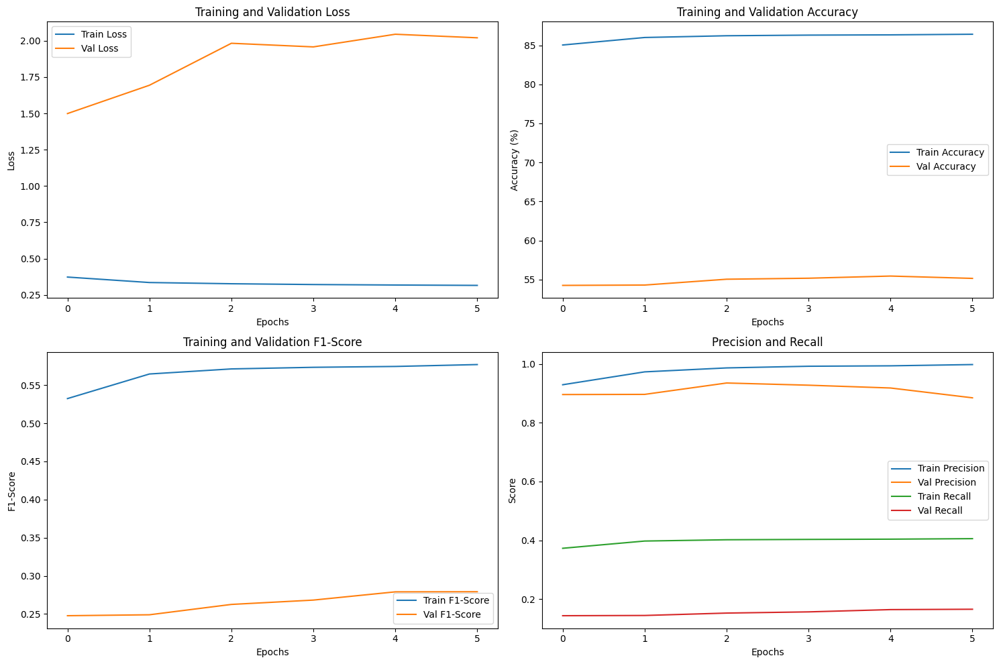

In [73]:
from sklearn.metrics import f1_score, precision_score, recall_score

# Listas para guardar métricas
metrics = {
    'train_loss': [],
    'val_loss': [],
    'train_acc': [],
    'val_acc': [],
    'train_f1': [],
    'val_f1': [],
    'train_precision': [],
    'val_precision': [],
    'train_recall': [],
    'val_recall': []
}

for epoch in range(30):  # Máximo de épocas
    # --- Fase de Entrenamiento ---
    model.train()
    epoch_train_loss = 0.0
    all_train_preds = []
    all_train_labels = []
    
    for images, labels, _ in tqdm(train_loader, desc=f"Train Epoch {epoch+1}"):
        images, labels = images.to(device), labels.float().to(device)
        
        optimizer.zero_grad()
        outputs = model(images).squeeze()
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        
        epoch_train_loss += loss.item()
        preds = (outputs > 0.5).float()
        
        all_train_preds.extend(preds.cpu().numpy())
        all_train_labels.extend(labels.cpu().numpy())
    
    # --- Cálculo de métricas de entrenamiento ---
    train_loss = epoch_train_loss / len(train_loader)
    train_acc = accuracy_score(all_train_labels, all_train_preds) * 100
    train_f1 = f1_score(all_train_labels, all_train_preds, zero_division=0)
    train_precision = precision_score(all_train_labels, all_train_preds, zero_division=0)
    train_recall = recall_score(all_train_labels, all_train_preds, zero_division=0)
    
    # --- Fase de Validación ---
    model.eval()
    epoch_val_loss = 0.0
    all_val_preds = []
    all_val_labels = []
    
    with torch.no_grad():
        for images, labels, _ in tqdm(val_loader, desc=f"Validation Epoch {epoch+1}"):
            images, labels = images.to(device), labels.float().to(device)
            
            outputs = model(images).squeeze()
            loss = criterion(outputs, labels)
            
            epoch_val_loss += loss.item()
            preds = (outputs > 0.5).float()
            
            all_val_preds.extend(preds.cpu().numpy())
            all_val_labels.extend(labels.cpu().numpy())
    
    # --- Cálculo de métricas de validación ---
    val_loss = epoch_val_loss / len(val_loader)
    val_acc = accuracy_score(all_val_labels, all_val_preds) * 100
    val_f1 = f1_score(all_val_labels, all_val_preds, zero_division=0)
    val_precision = precision_score(all_val_labels, all_val_preds, zero_division=0)
    val_recall = recall_score(all_val_labels, all_val_preds, zero_division=0)
    
    # --- Almacenar métricas ---
    metrics['train_loss'].append(train_loss)
    metrics['val_loss'].append(val_loss)
    metrics['train_acc'].append(train_acc)
    metrics['val_acc'].append(val_acc)
    metrics['train_f1'].append(train_f1)
    metrics['val_f1'].append(val_f1)
    metrics['train_precision'].append(train_precision)
    metrics['val_precision'].append(val_precision)
    metrics['train_recall'].append(train_recall)
    metrics['val_recall'].append(val_recall)
    
    # --- Mostrar métricas ---
    print(f"\nEpoch {epoch+1}:")
    print(f"Train Loss: {train_loss:.4f} | Val Loss: {val_loss:.4f}")
    print(f"Train Acc: {train_acc:.2f}% | Val Acc: {val_acc:.2f}%")
    print(f"Train F1: {train_f1:.4f} | Val F1: {val_f1:.4f}")
    print(f"Train Precision: {train_precision:.4f} | Val Precision: {val_precision:.4f}")
    print(f"Train Recall: {train_recall:.4f} | Val Recall: {val_recall:.4f}")
    
    # --- Early Stopping ---
    if val_loss < best_val_loss:
        best_val_loss = val_loss
        trigger_times = 0
        torch.save(model.state_dict(), 'best_finetuned_model.pth')
    else:
        trigger_times += 1
        if trigger_times >= patience:
            print("\nEarly stopping triggered!")
            break

# --- Visualización de métricas ---
plt.figure(figsize=(15, 10))

# Gráfico de Pérdida
plt.subplot(2, 2, 1)
plt.plot(metrics['train_loss'], label='Train Loss')
plt.plot(metrics['val_loss'], label='Val Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.title('Training and Validation Loss')

# Gráfico de Accuracy
plt.subplot(2, 2, 2)
plt.plot(metrics['train_acc'], label='Train Accuracy')
plt.plot(metrics['val_acc'], label='Val Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy (%)')
plt.legend()
plt.title('Training and Validation Accuracy')

# Gráfico de F1-Score
plt.subplot(2, 2, 3)
plt.plot(metrics['train_f1'], label='Train F1-Score')
plt.plot(metrics['val_f1'], label='Val F1-Score')
plt.xlabel('Epochs')
plt.ylabel('F1-Score')
plt.legend()
plt.title('Training and Validation F1-Score')

# Gráfico de Precision-Recall
plt.subplot(2, 2, 4)
plt.plot(metrics['train_precision'], label='Train Precision')
plt.plot(metrics['val_precision'], label='Val Precision')
plt.plot(metrics['train_recall'], label='Train Recall')
plt.plot(metrics['val_recall'], label='Val Recall')
plt.xlabel('Epochs')
plt.ylabel('Score')
plt.legend()
plt.title('Precision and Recall')

plt.tight_layout()
plt.show()

Validation Epoch 1: 100%|██████████| 293/293 [01:17<00:00,  3.80it/s]



Epoch 1:
Train Loss: 0.3132 | Val Loss: 1.8250
Train Acc: 86.43% | Val Acc: 55.15%
Train F1: 0.5773 | Val F1: 0.2782
Train Precision: 1.0000 | Val Precision: 0.8882
Train Recall: 0.4058 | Val Recall: 0.1649

Reporte de Pacientes (Slices Positivas/Total):
Paciente ID	True Label	Slices Positivas/Total
--------------------------------------------------------
55HASN	Sí	0/39
56MANX	No	0/297
57HTneNX	No	39/317
58MASH	Sí	19/267
59MMiNX	No	12/146
60HESN	Sí	0/276
61HASN	Sí	0/298
62HENX	No	0/184
63MESH	Sí	0/151
65HANX	No	0/307
66HBSN	Sí	0/451
67HCnpNX	No	0/385
68MANX	No	0/193
69MCnpSN	Sí	0/314
70HENX	No	0/66
71MTmNX	No	0/336
72MASH	Sí	385/385
73MASN	Sí	1/275

¡Mejor modelo guardado!


Validation Epoch 2: 100%|██████████| 293/293 [00:24<00:00, 12.20it/s]



Epoch 2:
Train Loss: 0.3144 | Val Loss: 2.3292
Train Acc: 86.40% | Val Acc: 55.41%
Train F1: 0.5766 | Val F1: 0.2778
Train Precision: 0.9971 | Val Precision: 0.9178
Train Recall: 0.4055 | Val Recall: 0.1637

Reporte de Pacientes (Slices Positivas/Total):
Paciente ID	True Label	Slices Positivas/Total
--------------------------------------------------------
55HASN	Sí	0/39
56MANX	No	0/297
57HTneNX	No	24/317
58MASH	Sí	13/267
59MMiNX	No	12/146
60HESN	Sí	0/276
61HASN	Sí	0/298
62HENX	No	0/184
63MESH	Sí	0/151
65HANX	No	0/307
66HBSN	Sí	0/451
67HCnpNX	No	0/385
68MANX	No	0/193
69MCnpSN	Sí	1/314
70HENX	No	0/66
71MTmNX	No	0/336
72MASH	Sí	385/385
73MASN	Sí	3/275


Validation Epoch 3: 100%|██████████| 293/293 [00:45<00:00,  6.44it/s]



Epoch 3:
Train Loss: 0.3124 | Val Loss: 2.1556
Train Acc: 86.40% | Val Acc: 55.24%
Train F1: 0.5766 | Val F1: 0.2785
Train Precision: 0.9971 | Val Precision: 0.8960
Train Recall: 0.4055 | Val Recall: 0.1649

Reporte de Pacientes (Slices Positivas/Total):
Paciente ID	True Label	Slices Positivas/Total
--------------------------------------------------------
55HASN	Sí	0/39
56MANX	No	0/297
57HTneNX	No	33/317
58MASH	Sí	19/267
59MMiNX	No	14/146
60HESN	Sí	0/276
61HASN	Sí	0/298
62HENX	No	0/184
63MESH	Sí	0/151
65HANX	No	0/307
66HBSN	Sí	0/451
67HCnpNX	No	0/385
68MANX	No	0/193
69MCnpSN	Sí	0/314
70HENX	No	0/66
71MTmNX	No	0/336
72MASH	Sí	385/385
73MASN	Sí	1/275


Validation Epoch 4: 100%|██████████| 293/293 [01:19<00:00,  3.70it/s]



Epoch 4:
Train Loss: 0.3128 | Val Loss: 2.2590
Train Acc: 86.40% | Val Acc: 55.54%
Train F1: 0.5764 | Val F1: 0.2784
Train Precision: 0.9979 | Val Precision: 0.9306
Train Recall: 0.4052 | Val Recall: 0.1637

Reporte de Pacientes (Slices Positivas/Total):
Paciente ID	True Label	Slices Positivas/Total
--------------------------------------------------------
55HASN	Sí	0/39
56MANX	No	0/297
57HTneNX	No	25/317
58MASH	Sí	16/267
59MMiNX	No	5/146
60HESN	Sí	0/276
61HASN	Sí	0/298
62HENX	No	0/184
63MESH	Sí	0/151
65HANX	No	0/307
66HBSN	Sí	0/451
67HCnpNX	No	0/385
68MANX	No	0/193
69MCnpSN	Sí	0/314
70HENX	No	0/66
71MTmNX	No	0/336
72MASH	Sí	385/385
73MASN	Sí	1/275


Validation Epoch 5: 100%|██████████| 293/293 [00:23<00:00, 12.30it/s]



Epoch 5:
Train Loss: 0.3106 | Val Loss: 2.7844
Train Acc: 86.42% | Val Acc: 55.75%
Train F1: 0.5774 | Val F1: 0.2758
Train Precision: 0.9972 | Val Precision: 0.9681
Train Recall: 0.4064 | Val Recall: 0.1608

Reporte de Pacientes (Slices Positivas/Total):
Paciente ID	True Label	Slices Positivas/Total
--------------------------------------------------------
55HASN	Sí	0/39
56MANX	No	0/297
57HTneNX	No	12/317
58MASH	Sí	9/267
59MMiNX	No	1/146
60HESN	Sí	0/276
61HASN	Sí	0/298
62HENX	No	0/184
63MESH	Sí	0/151
65HANX	No	0/307
66HBSN	Sí	0/451
67HCnpNX	No	0/385
68MANX	No	0/193
69MCnpSN	Sí	0/314
70HENX	No	0/66
71MTmNX	No	0/336
72MASH	Sí	385/385
73MASN	Sí	1/275


Validation Epoch 6: 100%|██████████| 293/293 [00:49<00:00,  5.96it/s]



Epoch 6:
Train Loss: 0.3117 | Val Loss: 2.5401
Train Acc: 86.41% | Val Acc: 55.73%
Train F1: 0.5770 | Val F1: 0.2773
Train Precision: 0.9979 | Val Precision: 0.9590
Train Recall: 0.4058 | Val Recall: 0.1621

Reporte de Pacientes (Slices Positivas/Total):
Paciente ID	True Label	Slices Positivas/Total
--------------------------------------------------------
55HASN	Sí	0/39
56MANX	No	0/297
57HTneNX	No	16/317
58MASH	Sí	12/267
59MMiNX	No	1/146
60HESN	Sí	0/276
61HASN	Sí	0/298
62HENX	No	0/184
63MESH	Sí	0/151
65HANX	No	0/307
66HBSN	Sí	0/451
67HCnpNX	No	0/385
68MANX	No	0/193
69MCnpSN	Sí	0/314
70HENX	No	0/66
71MTmNX	No	0/336
72MASH	Sí	385/385
73MASN	Sí	1/275

Early stopping triggered!


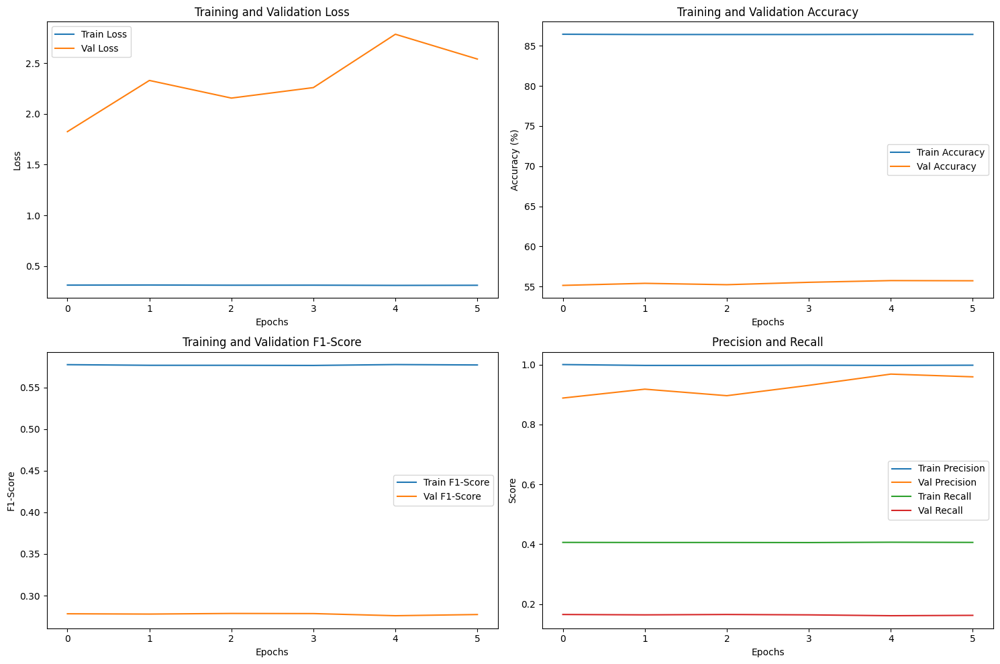


Reporte de pacientes guardado como patient_report_final.csv


In [77]:
from sklearn.metrics import f1_score, precision_score, recall_score, accuracy_score
from collections import defaultdict
import matplotlib.pyplot as plt
from tqdm import tqdm
import torch

# Listas para guardar métricas
metrics = {
    'train_loss': [],
    'val_loss': [],
    'train_acc': [],
    'val_acc': [],
    'train_f1': [],
    'val_f1': [],
    'train_precision': [],
    'val_precision': [],
    'train_recall': [],
    'val_recall': []
}

# Variables para early stopping
best_val_loss = float('inf')
trigger_times = 0
patience = 5

for epoch in range(30):  # Máximo de épocas
    # --- Fase de Entrenamiento ---
    model.train()
    epoch_train_loss = 0.0
    all_train_preds = []
    all_train_labels = []
    
    for images, labels, _ in tqdm(train_loader, desc=f"Train Epoch {epoch+1}"):
        images, labels = images.to(device), labels.float().to(device)
        
        optimizer.zero_grad()
        outputs = model(images).squeeze()
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        
        epoch_train_loss += loss.item()
        preds = (outputs > 0.5).float()
        
        all_train_preds.extend(preds.cpu().numpy())
        all_train_labels.extend(labels.cpu().numpy())
    
    # --- Cálculo de métricas de entrenamiento ---
    train_loss = epoch_train_loss / len(train_loader)
    train_acc = accuracy_score(all_train_labels, all_train_preds) * 100
    train_f1 = f1_score(all_train_labels, all_train_preds, zero_division=0)
    train_precision = precision_score(all_train_labels, all_train_preds, zero_division=0)
    train_recall = recall_score(all_train_labels, all_train_preds, zero_division=0)
    
    # --- Fase de Validación con Reporte por Paciente ---
    model.eval()
    epoch_val_loss = 0.0
    all_val_preds = []
    all_val_labels = []
    patient_report = defaultdict(lambda: {'true_label': None, 'positive_slices': 0, 'total_slices': 0})
    
    with torch.no_grad():
        for images, labels, patient_ids in tqdm(val_loader, desc=f"Validation Epoch {epoch+1}"):
            images, labels = images.to(device), labels.float().to(device)
            
            outputs = model(images).squeeze()
            loss = criterion(outputs, labels)
            
            epoch_val_loss += loss.item()
            preds = (outputs > 0.5).float()
            
            # Actualizar reporte por paciente
            for i, pid in enumerate(patient_ids):
                pid_str = str(pid.item()) if isinstance(pid, torch.Tensor) else str(pid)
                if patient_report[pid_str]['true_label'] is None:
                    patient_report[pid_str]['true_label'] = 'Sí' if labels[i].item() == 1 else 'No'
                patient_report[pid_str]['positive_slices'] += preds[i].item()
                patient_report[pid_str]['total_slices'] += 1
            
            all_val_preds.extend(preds.cpu().numpy())
            all_val_labels.extend(labels.cpu().numpy())
    
    # --- Cálculo de métricas de validación ---
    val_loss = epoch_val_loss / len(val_loader)
    val_acc = accuracy_score(all_val_labels, all_val_preds) * 100
    val_f1 = f1_score(all_val_labels, all_val_preds, zero_division=0)
    val_precision = precision_score(all_val_labels, all_val_preds, zero_division=0)
    val_recall = recall_score(all_val_labels, all_val_preds, zero_division=0)
    
    # --- Almacenar métricas ---
    metrics['train_loss'].append(train_loss)
    metrics['val_loss'].append(val_loss)
    metrics['train_acc'].append(train_acc)
    metrics['val_acc'].append(val_acc)
    metrics['train_f1'].append(train_f1)
    metrics['val_f1'].append(val_f1)
    metrics['train_precision'].append(train_precision)
    metrics['val_precision'].append(val_precision)
    metrics['train_recall'].append(train_recall)
    metrics['val_recall'].append(val_recall)
    
    # --- Mostrar métricas ---
    print(f"\nEpoch {epoch+1}:")
    print(f"Train Loss: {train_loss:.4f} | Val Loss: {val_loss:.4f}")
    print(f"Train Acc: {train_acc:.2f}% | Val Acc: {val_acc:.2f}%")
    print(f"Train F1: {train_f1:.4f} | Val F1: {val_f1:.4f}")
    print(f"Train Precision: {train_precision:.4f} | Val Precision: {val_precision:.4f}")
    print(f"Train Recall: {train_recall:.4f} | Val Recall: {val_recall:.4f}")
    
    # --- Mostrar reporte por paciente ---
    print("\nReporte de Pacientes (Slices Positivas/Total):")
    print("Paciente ID\tTrue Label\tSlices Positivas/Total")
    print("--------------------------------------------------------")
    for pid, data in sorted(patient_report.items()):
        print(f"{pid}\t{data['true_label']}\t{int(data['positive_slices'])}/{data['total_slices']}")
    
    # --- Early Stopping ---
    if val_loss < best_val_loss:
        best_val_loss = val_loss
        trigger_times = 0
        torch.save(model.state_dict(), 'best_finetuned_model.pth')
        print("\n¡Mejor modelo guardado!")
    else:
        trigger_times += 1
        if trigger_times >= patience:
            print("\nEarly stopping triggered!")
            break

# --- Visualización de métricas ---
plt.figure(figsize=(15, 10))

# Gráfico de Pérdida
plt.subplot(2, 2, 1)
plt.plot(metrics['train_loss'], label='Train Loss')
plt.plot(metrics['val_loss'], label='Val Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.title('Training and Validation Loss')

# Gráfico de Accuracy
plt.subplot(2, 2, 2)
plt.plot(metrics['train_acc'], label='Train Accuracy')
plt.plot(metrics['val_acc'], label='Val Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy (%)')
plt.legend()
plt.title('Training and Validation Accuracy')

# Gráfico de F1-Score
plt.subplot(2, 2, 3)
plt.plot(metrics['train_f1'], label='Train F1-Score')
plt.plot(metrics['val_f1'], label='Val F1-Score')
plt.xlabel('Epochs')
plt.ylabel('F1-Score')
plt.legend()
plt.title('Training and Validation F1-Score')

# Gráfico de Precision-Recall
plt.subplot(2, 2, 4)
plt.plot(metrics['train_precision'], label='Train Precision')
plt.plot(metrics['val_precision'], label='Val Precision')
plt.plot(metrics['train_recall'], label='Train Recall')
plt.plot(metrics['val_recall'], label='Val Recall')
plt.xlabel('Epochs')
plt.ylabel('Score')
plt.legend()
plt.title('Precision and Recall')

plt.tight_layout()
plt.show()

# --- Guardar reporte final de pacientes ---
def save_patient_report(patient_report, filename="patient_report_final.csv"):
    import pandas as pd
    report_data = []
    for pid, data in patient_report.items():
        report_data.append({
            'Paciente ID': pid,
            'True Label': data['true_label'],
            'Slices Positivas': int(data['positive_slices']),
            'Total Slices': data['total_slices'],
            '% Positivas': f"{data['positive_slices']/data['total_slices']:.1%}" if data['total_slices'] > 0 else '0%'
        })
    
    df = pd.DataFrame(report_data)
    df.to_csv(filename, index=False)
    print(f"\nReporte de pacientes guardado como {filename}")

save_patient_report(patient_report)

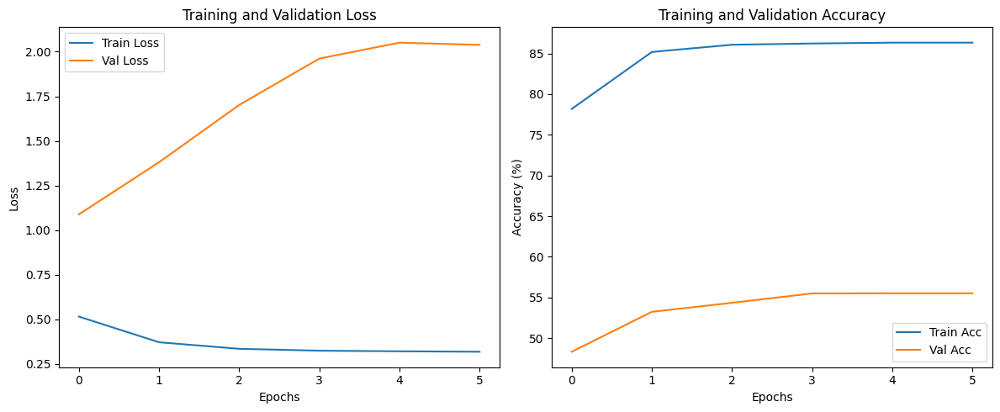

In [69]:
import matplotlib.pyplot as plt

plt.figure(figsize=(12, 5))

# Gráfico de pérdida
plt.subplot(1, 2, 1)
plt.plot(train_losses, label='Train Loss')
plt.plot(val_losses, label='Val Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.title('Training and Validation Loss')

# Gráfico de accuracy
plt.subplot(1, 2, 2)
plt.plot(train_accs, label='Train Acc')
plt.plot(val_accs, label='Val Acc')
plt.xlabel('Epochs')
plt.ylabel('Accuracy (%)')
plt.legend()
plt.title('Training and Validation Accuracy')

plt.tight_layout()
plt.show()

In [70]:
# Cargar el mejor modelo guardado
model.load_state_dict(torch.load('best_finetuned_model.pth'))
model.eval()

# Evaluación detallada
from sklearn.metrics import classification_report, confusion_matrix

all_preds = []
all_labels = []

with torch.no_grad():
    for images, labels, _ in val_loader:
        images, labels = images.to(device), labels.to(device)
        outputs = model(images).squeeze()
        preds = (outputs > 0.5).float()
        
        all_preds.extend(preds.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())

print("Classification Report:")
print(classification_report(all_labels, all_preds))
print("\nConfusion Matrix:")
print(confusion_matrix(all_labels, all_preds))

Classification Report:
              precision    recall  f1-score   support

           0       0.48      0.98      0.64      2231
           1       0.64      0.03      0.06      2456

    accuracy                           0.48      4687
   macro avg       0.56      0.51      0.35      4687
weighted avg       0.56      0.48      0.34      4687


Confusion Matrix:
[[2187   44]
 [2378   78]]


# Segmentación de pulmones

In [ ]:
import os
import numpy as np
from torch.utils.data import Dataset

class LungCTDataset(Dataset):
    def __init__(self, data_dir, mask_dir, labels_dict, transform=None):
        self.data_dir = data_dir
        self.mask_dir = mask_dir
        self.patients = list(labels_dict.keys())
        self.labels = labels_dict
        self.transform = transform

    def __len__(self):
        return len(self.patients)

    def __getitem__(self, idx):
        patient_id = self.patients[idx]

        # Cargar volumen
        volume_path = os.path.join(self.data_dir, f"{patient_id}.npy")
        volume = np.load(volume_path)

        # Cargar máscara alineada
        mask_path = os.path.join(self.mask_dir, f"{patient_id}.npy")
        if os.path.exists(mask_path):
            mask = np.load(mask_path).astype(bool)
            if mask.shape != volume.shape:
                raise ValueError(f"Dimensiones no coinciden para {patient_id}: {volume.shape} vs {mask.shape}")
            volume = volume * mask
        else:
            print(f" No se encontró máscara para {patient_id}, usando volumen completo.")

        # Expandir dimensiones para PyTorch (C, D, H, W)
        volume = np.expand_dims(volume, axis=0)  
        label = self.labels[patient_id]

        if self.transform:
            volume = self.transform(volume)

        return volume, torch.tensor(label, dtype=torch.long)


In [ ]:
import os
import numpy as np
from torch.utils.data import Dataset
import torch

class LungCTDataset_solo_mask(Dataset):
    def __init__(self, data_dir, mask_dir, labels_dict, transform=None):
        self.data_dir = data_dir
        self.mask_dir = mask_dir
        self.patients = list(labels_dict.keys())
        self.labels = labels_dict
        self.transform = transform

    def __len__(self):
        return len(self.patients)

    def __getitem__(self, idx):
        patient_id = self.patients[idx]

        # Cargar volumen
        volume_path = os.path.join(self.data_dir, f"{patient_id}.npy")
        volume = np.load(volume_path)

        # Cargar máscara alineada
        mask_path = os.path.join(self.mask_dir, f"{patient_id}.npy")
        if os.path.exists(mask_path):
            mask = np.load(mask_path).astype(bool)
            if mask.shape != volume.shape:
                raise ValueError(f"Dimensiones no coinciden para {patient_id}: {volume.shape} vs {mask.shape}")
            
            # Enmascarar el volumen
            volume[~mask] = -1024  # Poner el fondo como aire

            # Normalización dentro de la máscara
            # if np.any(mask):
            #     min_val = volume[mask].min()
            #     max_val = volume[mask].max()
                
            #     # Evitar divisiones por cero
            #     if max_val - min_val > 0:
            #         volume[mask] = (volume[mask] - min_val) / (max_val - min_val + 1e-8)
            #     else:
            #         volume[mask] = 0.0
        else:
            print(f" No se encontró máscara para {patient_id}, usando volumen completo.")

        # Expandir dimensiones para PyTorch (C, D, H, W)
        volume = np.expand_dims(volume, axis=0)  
        label = self.labels[patient_id]

        if self.transform:
            volume = self.transform(volume)

        return volume, torch.tensor(label, dtype=torch.long)


In [ ]:
# NO VOLVER A EJECUTAR
#MASCARAS DE NII A NPY

import nibabel as nib
def convertir_mascaras_nodulos_a_npy(segment_dir, output_dir):
    os.makedirs(output_dir, exist_ok=True)
    archivos = [f for f in os.listdir(segment_dir) if f.endswith("_nod.nii")]

    for archivo in archivos:
        nombre = archivo.replace("_nod.nii", "")
        path_nifti = os.path.join(segment_dir, archivo)
        salida_npy = os.path.join(output_dir, f"{nombre}_mask.npy")

        try:
            mask = nib.load(path_nifti).get_fdata() > 0
            mask = mask.astype(np.uint8)
            np.save(salida_npy, mask)
            print(f" Guardada máscara binaria para {nombre}")
        except Exception as e:
            print(f" Error con {archivo}: {e}")

In [18]:
segment_dir = "./segmentacion/segmentaciones_nodulos_preprocesados"
output_dir = "./segmentacion/mascaras_np_preprocesadas"

In [10]:
# NO VOLVER A EJECUTAR
convertir_mascaras_nodulos_a_npy(segment_dir, output_dir)

✅ Guardada máscara binaria para 10MANX
✅ Guardada máscara binaria para 11HASh
✅ Guardada máscara binaria para 12HNSN
✅ Guardada máscara binaria para 13HANX
✅ Guardada máscara binaria para 15MANX
✅ Guardada máscara binaria para 16HLNX
✅ Guardada máscara binaria para 17MANX
✅ Guardada máscara binaria para 18MANX
✅ Guardada máscara binaria para 19MANX
✅ Guardada máscara binaria para 1MASh
✅ Guardada máscara binaria para 22MTNX
✅ Guardada máscara binaria para 23MMNX
✅ Guardada máscara binaria para 24MANX
✅ Guardada máscara binaria para 25HTNX
✅ Guardada máscara binaria para 26HMNX
✅ Guardada máscara binaria para 27HASD
✅ Guardada máscara binaria para 28HCGNX
✅ Guardada máscara binaria para 29HMeSX
✅ Guardada máscara binaria para 2HENX
✅ Guardada máscara binaria para 30MANX
✅ Guardada máscara binaria para 31MGNX
✅ Guardada máscara binaria para 32HENX
✅ Guardada máscara binaria para 33MANX
✅ Guardada máscara binaria para 34MASN
✅ Guardada máscara binaria para 35HENX
✅ Guardada máscara binari

In [11]:
MASK_DIR = "./segmentacion/mascaras_np"
MASK_DIR_PREPROCESSED = "./segmentacion/mascaras_preprocesadas_bien"

In [58]:
ruta_mask = "segmentacion/segmentaciones_nodulos/10MANX_nod.nii"
mask = nib.load(ruta_mask).get_fdata()

print("Valores únicos en la máscara:", np.unique(mask))

Valores únicos en la máscara: [0. 1. 2.]


In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import os

def mostrar_volumen_vs_mascara_sin_reescalar(patient_ids, data_dir, mask_dir, num_slices=3):
    """
    Muestra cortes axiales del volumen original y el enmascarado con la máscara de pulmón.
    
    Args:
        patient_ids: lista de IDs de pacientes (sin extensión)
        data_dir: carpeta donde están los volúmenes .npy
        mask_dir: carpeta donde están las máscaras .npy
        num_slices: número de cortes axiales (centrados)
    """
    for pid in patient_ids:
        vol_path = os.path.join(data_dir, f"{pid}.npy")
        mask_path = os.path.join(mask_dir, f"{pid}.npy")

        if not os.path.exists(vol_path) or not os.path.exists(mask_path):
            print(f" Faltan datos para {pid}")
            continue

        vol = np.load(vol_path)
        mask = np.load(mask_path).astype(bool)


        if mask.shape != vol.shape:
            print(f" Dimensiones no coinciden para {pid}: {vol.shape} vs {mask.shape}, saltando.")
            continue

        vol_masked = vol * mask

        z_center = vol.shape[0] // 2
        step = vol.shape[0] // (num_slices + 1)
        slices = [z_center + step * i - (step * num_slices // 2) for i in range(num_slices)]

        fig, axes = plt.subplots(2, num_slices, figsize=(4 * num_slices, 6))
        fig.suptitle(f"Paciente: {pid}", fontsize=14)

        for i, z in enumerate(slices):
            axes[0, i].imshow(vol[z], cmap='gray')
            axes[0, i].set_title(f"Original (Z={z})")
            axes[0, i].axis('off')

            axes[1, i].imshow(vol_masked[z], cmap='gray')
            axes[1, i].set_title(f"Enmascarado (Z={z})")
            axes[1, i].axis('off')

        plt.tight_layout()
        plt.show()


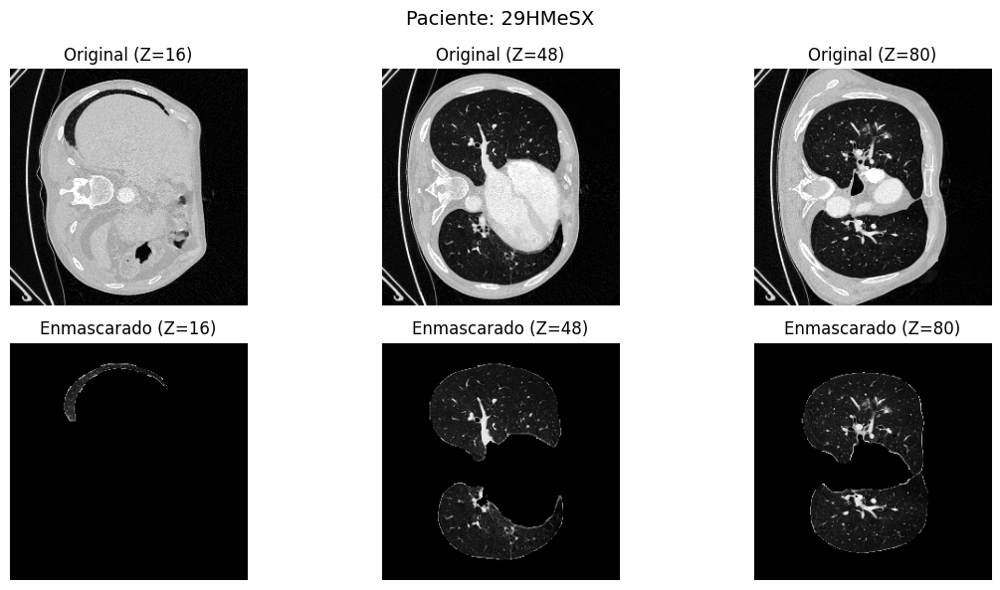

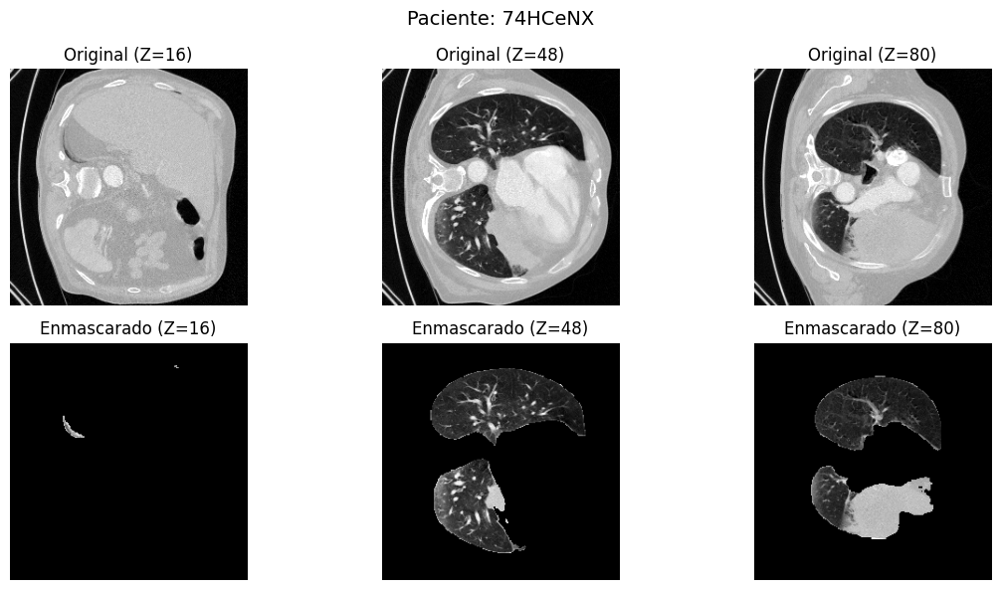

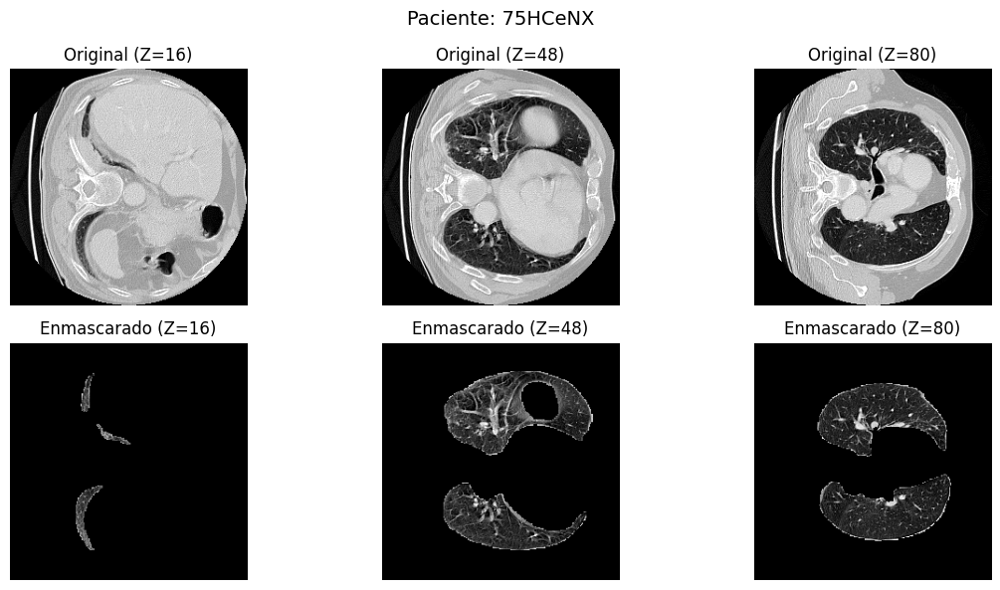

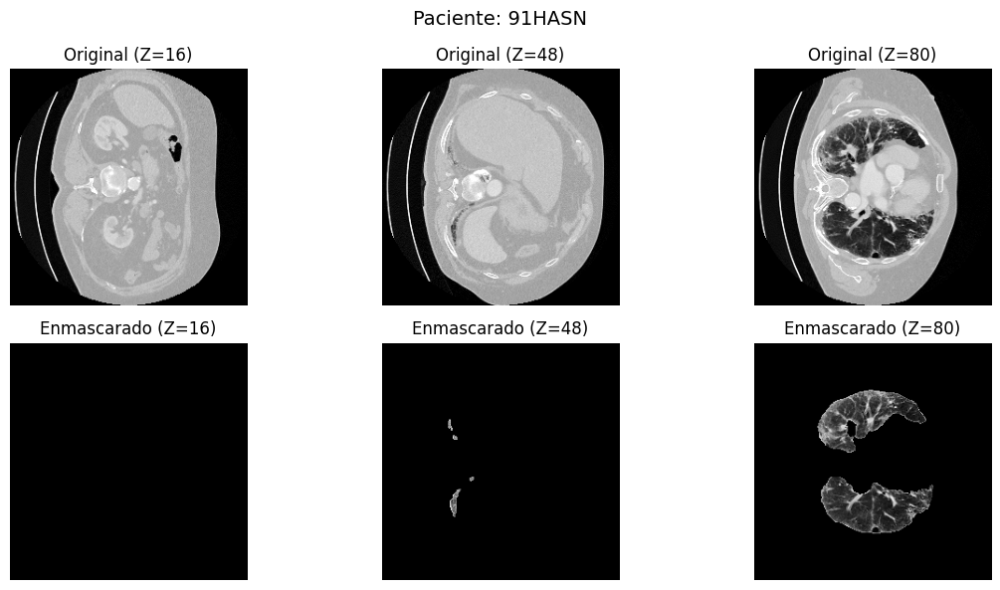

In [15]:
mostrar_volumen_vs_mascara_sin_reescalar(
    patient_ids=["29HMeSX", "74HCeNX", "75HCeNX", "91HASN"],
    data_dir="preprocesamientos2/resize_small_hu_m300_1400_separadas/npy/images",
    mask_dir="preprocesamientos2/resize_small_hu_m300_1400_separadas/npy/masks",
    num_slices=3
)

In [ ]:
def mostrar_volumen_vs_mascara_nifti(patient_ids, data_dir, mask_dir, num_slices=3):
    for pid in patient_ids:
        vol_path = os.path.join(data_dir, f"{pid}.nii.gz")
        mask_path = os.path.join(mask_dir, f"{pid}_mask.npy")

        if not os.path.exists(vol_path) or not os.path.exists(mask_path):
            print(f" Faltan datos para {pid}")
            continue

        vol = nib.load(vol_path).get_fdata()
        mask = np.load(mask_path).astype(bool)

        # Transponer a (z, y, x)
        vol = np.transpose(vol, (2, 1, 0))
        mask = np.transpose(mask, (2, 1, 0))

        if mask.shape != vol.shape:
            print(f" Dimensiones no coinciden para {pid}: {vol.shape} vs {mask.shape}, saltando.")
            continue

        vol_masked = vol * mask

        z_center = vol.shape[0] // 2
        step = vol.shape[0] // (num_slices + 1)
        slices = [z_center + step * i - (step * num_slices // 2) for i in range(num_slices)]

        fig, axes = plt.subplots(2, num_slices, figsize=(4 * num_slices, 6))
        fig.suptitle(f"Paciente: {pid}", fontsize=14)

        for i, z in enumerate(slices):
            axes[0, i].imshow(vol[z], cmap='gray')
            axes[0, i].set_title(f"Original (Z={z})")
            axes[0, i].axis('off')

            axes[1, i].imshow(vol_masked[z], cmap='gray')
            axes[1, i].set_title(f"Enmascarado (Z={z})")
            axes[1, i].axis('off')

        plt.tight_layout()
        plt.show()


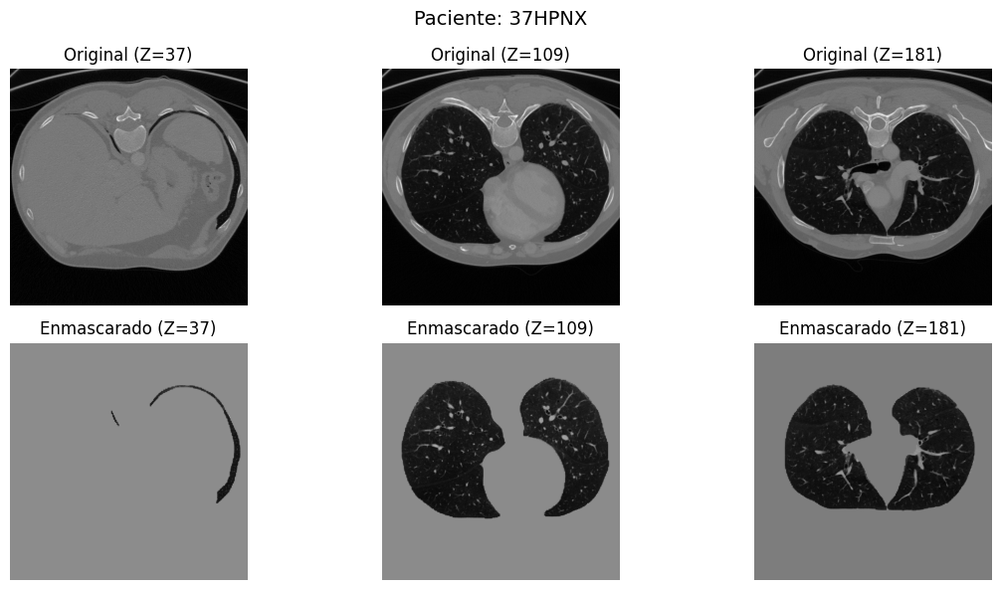

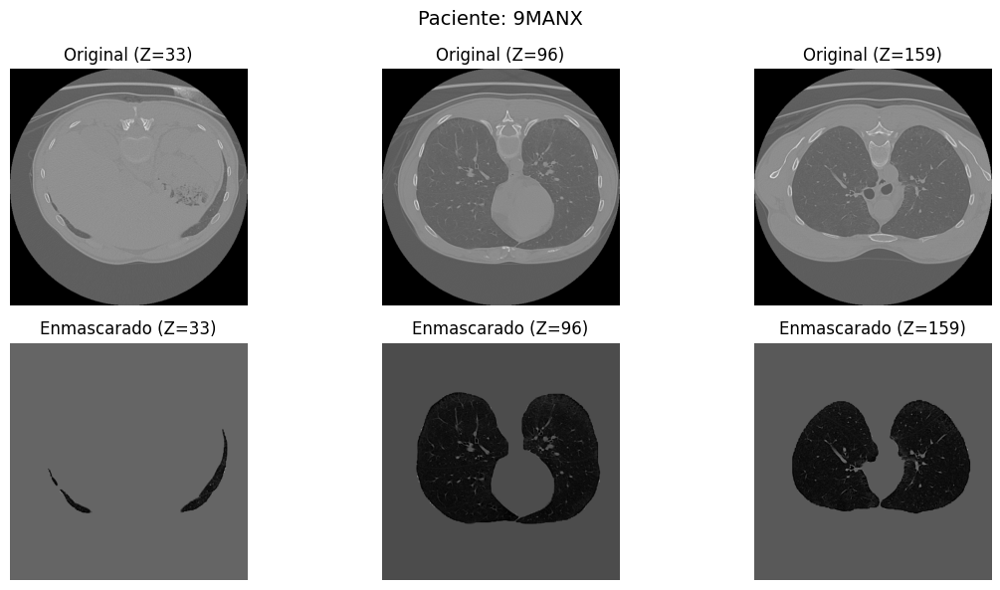

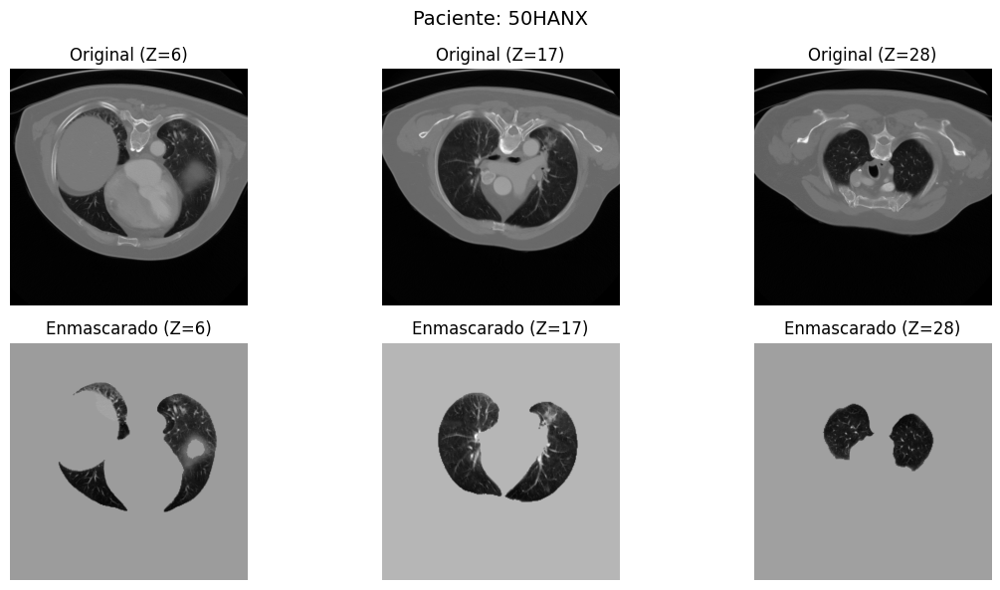

In [43]:
mostrar_volumen_vs_mascara_nifti(
    patient_ids=["37HPNX", "9MANX", "50HANX"],
    data_dir="./nifti_convertidos_anonimizados",  
    mask_dir=MASK_DIR,            
    num_slices=3
)

In [18]:
from monai.transforms import Compose, EnsureType

transform = Compose([EnsureType()])

In [15]:
from monai.transforms import (
    Compose, LoadImaged, EnsureChannelFirstd, NormalizeIntensityd,
    ResizeWithPadOrCropd, RandFlipd, RandAffined, RandGaussianNoised, ToTensord, ResizeD, TransposeD,
)
from torchvision import transforms

# Transformaciones para las imágenes
transform = transforms.Compose([
    EnsureChannelFirstd(keys=["image"]),    # (1, H, W, D)             
    TransposeD(keys=["image"], indices=(0, 3, 1, 2)),    # [1, D, H, W]
    ResizeD(keys=["image"], spatial_size=(128,256,256), mode="trilinear", align_corners=True), # (1, 128, 256, 256)
])

In [19]:
data_dir="preprocesamientos2/resize_small_separadas/npy/images"
mask_dir="preprocesamientos2/resize_small_separadas/npy/masks"

In [20]:
# Conversión de strings "Sí"/"No" a 1/0
labels_dict_numeric = {k: 1 if v == "Sí" else 0 for k, v in labels_dict.items()}

In [21]:
labels_dict_numeric

{'1MASh': 1,
 '2HENX': 0,
 '3HENX': 0,
 '4HLSh': 1,
 '5HANX': 0,
 '6MASN': 1,
 '7MPNX': 0,
 '8HENX': 0,
 '9MANX': 0,
 '10MANX': 0,
 '11HASh': 1,
 '12HNSN': 1,
 '13HANX': 0,
 '14MLNX': 0,
 '15MANX': 0,
 '16HLNX': 0,
 '17MANX': 0,
 '18MANX': 0,
 '19MANX': 0,
 '20MMNX': 0,
 '21MMiNX': 0,
 '22MTNX': 0,
 '23MMNX': 0,
 '24MANX': 0,
 '25HTNX': 0,
 '26HMNX': 0,
 '27HASD': 1,
 '28HCGNX': 0,
 '29HMeSX': 1,
 '30MANX': 0,
 '31MGNX': 0,
 '32HENX': 0,
 '33MANX': 0,
 '34MASN': 1,
 '35HENX': 0,
 '36HENX': 0,
 '37HPNX': 0,
 '38HANX': 0,
 '39MFNX': 0,
 '40HANX': 0,
 '41HAsNX': 0,
 '42HNnNX': 0,
 '43HESH': 1,
 '44MTmNX': 0,
 '45HNeSN': 1,
 '46HANX': 0,
 '47HESN': 1,
 '48HTtSN': 1,
 '49MMiSN': 1,
 '50HANX': 0,
 '51HFNX': 0,
 '52HLNX': 0,
 '53HANX': 0,
 '54HANX': 0,
 '55HASN': 1,
 '56MANX': 0,
 '57HTneNX': 0,
 '58MASH': 1,
 '59MMiNX': 0,
 '60HESN': 1,
 '61HASN': 1,
 '62HENX': 0,
 '63MESH': 1,
 '64MESH': 1,
 '65HANX': 0,
 '66HBSN': 1,
 '67HCnpNX': 0,
 '68MANX': 0,
 '69MCnpSN': 1,
 '70HENX': 0,
 '71MTmNX': 0

In [ ]:


# # Luego aplicar el filtrado
# excluir_ids = {"29HMeSX", "74HCeNX", "75HCeNX"}
# filtrado_labels_dict = {k: v for k, v in labels_dict_numeric.items() if k not in excluir_ids}


dataset = LungCTDataset(data_dir, mask_dir, labels_dict_numeric, transform=transform)


In [22]:
dataset = LungCTDataset(data_dir, mask_dir, labels_dict_numeric, transform=transform)


In [43]:
# División en 85% entrenamiento y 15% validación
train_size = int(0.85 * len(dataset))
val_size = len(dataset) - train_size
train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

In [ ]:
#holdout estratificado
from sklearn.model_selection import StratifiedShuffleSplit
from torch.utils.data import Subset

# Recuperar las etiquetas
labels = [dataset.labels[pid] for pid in dataset.patients]

# Definir el split estratificado
sss = StratifiedShuffleSplit(n_splits=1, test_size=0.2, random_state=9)

# Obtener los índices para train y val
train_idx, val_idx = next(sss.split(dataset.patients, labels))

# Crear los subsets
train_dataset = Subset(dataset, train_idx)
val_dataset = Subset(dataset, val_idx)

print(f" Número de muestras en entrenamiento: {len(train_dataset)}")
print(f" Número de muestras en validación: {len(val_dataset)}")


🔹 Número de muestras en entrenamiento: 80
🔹 Número de muestras en validación: 20


In [ ]:
from collections import Counter

train_labels = [dataset.labels[dataset.patients[i]] for i in train_idx]
val_labels = [dataset.labels[dataset.patients[i]] for i in val_idx]

print(f" Distribución en entrenamiento: {Counter(train_labels)}")
print(f" Distribución en validación: {Counter(val_labels)}")


🔍 Distribución en entrenamiento: Counter({0: 42, 1: 38})
🔍 Distribución en validación: Counter({0: 11, 1: 9})


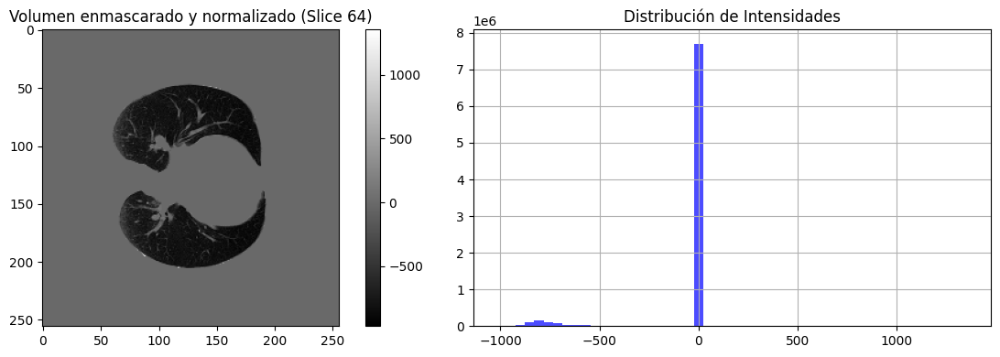

In [25]:
import matplotlib.pyplot as plt
import random

# Elegir un paciente aleatorio
idx = random.randint(0, len(dataset) - 1)
volume, label = dataset[idx]
volume = volume.squeeze()

# Visualización
slice_idx = volume.shape[0] // 2
plt.figure(figsize=(12, 4))

plt.subplot(1, 2, 1)
plt.imshow(volume[slice_idx], cmap='gray')
plt.title(f"Volumen enmascarado y normalizado (Slice {slice_idx})")
plt.colorbar()

plt.subplot(1, 2, 2)
plt.hist(volume.flatten(), bins=50, color='blue', alpha=0.7)
plt.title("Distribución de Intensidades")
plt.grid(True)

plt.tight_layout()
plt.show()


In [26]:
BATCH_SIZE=8

In [27]:
train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=2, pin_memory=True)
val_loader = DataLoader(val_dataset, batch_size=BATCH_SIZE, shuffle=False, num_workers=2, pin_memory=True)

In [28]:
#modelo MONAI
model = DenseNet121(
    spatial_dims=3,          # 3D
    in_channels=1,           # Canales de entrada
    out_channels=2,          # Salida binaria
    #pretrained=False,        # sin pesos preentrenados
    #dropout_prob=0.3         # Regularización
).to(device)

In [14]:
from monai.networks.nets import ResNet
import torch

# Definición de los bloques de entrada para cada capa de ResNet
def get_inplanes():
    return [64, 128, 256, 512]

# Inicialización del modelo
model = ResNet(
    block='basic',                         # Bloque básico de ResNet
    layers=(2, 2, 2, 2),                   # Número de bloques por capa
    block_inplanes=get_inplanes(),         # Tamaño de las capas (dimensionalidad interna)
    spatial_dims=3,                        # 3D CNN
    n_input_channels=1,                    # Canal de entrada (1 para imágenes en escala de grises)
    num_classes=2,                         # Número de clases (clasificación binaria)
    conv1_t_size=7,                        # Tamaño del kernel en la primera convolución
    conv1_t_stride=1,                      # Stride en la primera convolución
    no_max_pool=False,                     # No eliminar max pooling
    shortcut_type='B',                     # Tipo de shortcut
    widen_factor=1.0                       # Factor de expansión
).to(device)

# Comprobación del modelo con un ejemplo
x = torch.randn(1, 1, 128, 256, 256).to(device)  # (Batch, Channels, Depth, Height, Width)
output = model(x)
print("Output shape:", output.shape)  # Debe ser (1, 2)


Output shape: torch.Size([1, 2])


In [29]:
optimizer = optim.Adam(model.parameters(), lr=1e-3)
# Configuración de entrenamiento sin ponderacion de pesos
criterion = nn.CrossEntropyLoss()

In [ ]:
from sklearn.metrics import accuracy_score, f1_score, confusion_matrix, ConfusionMatrixDisplay
import numpy as np
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt
from tqdm import tqdm

def train_model(model, train_loader, val_loader, criterion, optimizer, device, epochs=10, save_path=None):
    best_val_gmean = 0.0

    for epoch in range(epochs):
        model.train()
        running_loss = 0.0
        all_preds, all_labels = [], []

        print(f"\n Epoch {epoch+1}/{epochs}")

        for inputs, labels in tqdm(train_loader):
            inputs, labels = inputs.to(device), labels.to(device)

            optimizer.zero_grad()
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()
            running_loss += loss.item()

            preds = torch.argmax(outputs, dim=1).cpu().numpy()
            all_preds.extend(preds)
            all_labels.extend(labels.cpu().numpy())

        acc = accuracy_score(all_labels, all_preds)
        f1 = f1_score(all_labels, all_preds)
        tpr, tnr, gmean = calcular_metricas_binarias(all_labels, all_preds)
        print(f" Entrenamiento — Loss: {running_loss:.4f} | Acc: {acc:.4f} | F1: {f1:.4f} | TPR: {tpr:.4f} | TNR: {tnr:.4f} | G-Mean: {gmean:.4f}")

        # Validación
        model.eval()
        val_loss = 0.0
        val_preds, val_labels = [], []

        with torch.no_grad():
            for val_inputs, val_labels_batch in val_loader:
                val_inputs, val_labels_batch = val_inputs.to(device), val_labels_batch.to(device)
                val_outputs = model(val_inputs)
                val_loss += criterion(val_outputs, val_labels_batch).item()

                val_preds_batch = torch.argmax(val_outputs, dim=1).cpu().numpy()
                val_preds.extend(val_preds_batch)
                val_labels.extend(val_labels_batch.cpu().numpy())

        val_acc = accuracy_score(val_labels, val_preds)
        val_f1 = f1_score(val_labels, val_preds)
        val_tpr, val_tnr, val_gmean = calcular_metricas_binarias(val_labels, val_preds)

        print(f" Validación   — Loss: {val_loss:.4f} | Acc: {val_acc:.4f} | F1: {val_f1:.4f} | TPR: {val_tpr:.4f} | TNR: {val_tnr:.4f} | G-Mean: {val_gmean:.4f}")

        # Guardar el mejor modelo por G-Mean
        if save_path and val_gmean > best_val_gmean:
            best_val_gmean = val_gmean
            torch.save(model.state_dict(), save_path)
            print(f" Guardado modelo (G-Mean {val_gmean:.4f}) en '{save_path}'")

    # Evaluar modelo final
    if save_path:
        model.load_state_dict(torch.load(save_path))
        model.eval()
        print(f"\n Cargado mejor modelo desde '{save_path}'")
        evaluar_modelo_final(model, val_loader, device)


def calcular_metricas_binarias(y_true, y_pred):
    cm = confusion_matrix(y_true, y_pred)
    if cm.shape != (2, 2):
        return 0, 0, 0  # No binario
    TN, FP, FN, TP = cm.ravel()
    tpr = TP / (TP + FN) if (TP + FN) > 0 else 0
    tnr = TN / (TN + FP) if (TN + FP) > 0 else 0
    gmean = np.sqrt(tpr * tnr)
    return tpr, tnr, gmean


def evaluar_modelo_final(model, val_loader, device):
    all_preds = []
    all_labels = []

    with torch.no_grad():
        for inputs, labels in val_loader:
            inputs = inputs.to(device)
            outputs = model(inputs)
            preds = torch.argmax(outputs, dim=1).cpu().numpy()
            all_preds.extend(preds)
            all_labels.extend(labels.cpu().numpy())

    cm = confusion_matrix(all_labels, all_preds)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm,
                                  display_labels=["No Complicación", "Complicación"])
    disp.plot(cmap='Blues')
    plt.title(" Matriz de Confusión (Mejor modelo por G-Mean)")
    plt.show()

    acc = accuracy_score(all_labels, all_preds)
    f1 = f1_score(all_labels, all_preds)
    tpr, tnr, gmean = calcular_metricas_binarias(all_labels, all_preds)

    print(f"\n Evaluación final:")
    print(f"   Accuracy: {acc:.4f}")
    print(f"   F1 Score: {f1:.4f}")
    print(f"   TPR: {tpr:.4f}")
    print(f"   TNR: {tnr:.4f}")
    print(f"   G-Mean: {gmean:.4f}")


In [ ]:
from sklearn.metrics import accuracy_score, f1_score, confusion_matrix, ConfusionMatrixDisplay
import numpy as np
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt
from tqdm import tqdm
from torch.optim.lr_scheduler import ReduceLROnPlateau

def train_model_ajustando_lr(model, train_loader, val_loader, criterion, optimizer, device, epochs=10, save_path=None):
    best_val_gmean = 0.0

    # Agregar el scheduler para el ajuste del learning rate
    scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=2, verbose=True)

    # Guardar los valores del learning rate para visualizar
    lrs = []

    for epoch in range(epochs):
        model.train()
        running_loss = 0.0
        all_preds, all_labels = [], []

        print(f"\n Epoch {epoch+1}/{epochs}")

        for inputs, labels in tqdm(train_loader):
            inputs, labels = inputs.to(device), labels.to(device)

            optimizer.zero_grad()
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()
            running_loss += loss.item()

            preds = torch.argmax(outputs, dim=1).cpu().numpy()
            all_preds.extend(preds)
            all_labels.extend(labels.cpu().numpy())

        # Guardar el learning rate actual
        current_lr = optimizer.param_groups[0]['lr']
        lrs.append(current_lr)

        acc = accuracy_score(all_labels, all_preds)
        f1 = f1_score(all_labels, all_preds)
        tpr, tnr, gmean = calcular_metricas_binarias(all_labels, all_preds)
        print(f" Entrenamiento — Loss: {running_loss:.4f} | Acc: {acc:.4f} | F1: {f1:.4f} | TPR: {tpr:.4f} | TNR: {tnr:.4f} | G-Mean: {gmean:.4f} | LR: {current_lr}")

        # Validación
        model.eval()
        val_loss = 0.0
        val_preds, val_labels = [], []

        with torch.no_grad():
            for val_inputs, val_labels_batch in val_loader:
                val_inputs, val_labels_batch = val_inputs.to(device), val_labels_batch.to(device)
                val_outputs = model(val_inputs)
                val_loss += criterion(val_outputs, val_labels_batch).item()

                val_preds_batch = torch.argmax(val_outputs, dim=1).cpu().numpy()
                val_preds.extend(val_preds_batch)
                val_labels.extend(val_labels_batch.cpu().numpy())

        val_acc = accuracy_score(val_labels, val_preds)
        val_f1 = f1_score(val_labels, val_preds)
        val_tpr, val_tnr, val_gmean = calcular_metricas_binarias(val_labels, val_preds)

        print(f" Validación   — Loss: {val_loss:.4f} | Acc: {val_acc:.4f} | F1: {val_f1:.4f} | TPR: {val_tpr:.4f} | TNR: {val_tnr:.4f} | G-Mean: {val_gmean:.4f}")

        # Scheduler: ajustar learning rate según la pérdida de validación
        scheduler.step(val_loss)

        # Guardar el mejor modelo por G-Mean
        if save_path and val_gmean > best_val_gmean:
            best_val_gmean = val_gmean
            torch.save(model.state_dict(), save_path)
            print(f" Guardado modelo (G-Mean {val_gmean:.4f}) en '{save_path}'")

    # Evaluar modelo final
    if save_path:
        model.load_state_dict(torch.load(save_path))
        model.eval()
        print(f"\n Cargado mejor modelo desde '{save_path}'")
        evaluar_modelo_final(model, val_loader, device)

    # Visualización del Learning Rate
    plt.figure(figsize=(6, 4))
    plt.plot(lrs, marker='o')
    plt.title("Evolución del Learning Rate")
    plt.xlabel("Época")
    plt.ylabel("Learning Rate")
    plt.grid()
    plt.show()


def calcular_metricas_binarias(y_true, y_pred):
    cm = confusion_matrix(y_true, y_pred)
    if cm.shape != (2, 2):
        return 0, 0, 0  # No binario
    TN, FP, FN, TP = cm.ravel()
    tpr = TP / (TP + FN) if (TP + FN) > 0 else 0
    tnr = TN / (TN + FP) if (TN + FP) > 0 else 0
    gmean = np.sqrt(tpr * tnr)
    return tpr, tnr, gmean


def evaluar_modelo_final(model, val_loader, device):
    all_preds = []
    all_labels = []

    with torch.no_grad():
        for inputs, labels in val_loader:
            inputs = inputs.to(device)
            outputs = model(inputs)
            preds = torch.argmax(outputs, dim=1).cpu().numpy()
            all_preds.extend(preds)
            all_labels.extend(labels.cpu().numpy())

    cm = confusion_matrix(all_labels, all_preds)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm,
                                  display_labels=["No Complicación", "Complicación"])
    disp.plot(cmap='Blues')
    plt.title(" Matriz de Confusión (Mejor modelo por G-Mean)")
    plt.show()

    acc = accuracy_score(all_labels, all_preds)
    f1 = f1_score(all_labels, all_preds)
    tpr, tnr, gmean = calcular_metricas_binarias(all_labels, all_preds)

    print(f"\n Evaluación final:")
    print(f"   Accuracy: {acc:.4f}")
    print(f"   F1 Score: {f1:.4f}")
    print(f"   TPR: {tpr:.4f}")
    print(f"   TNR: {tnr:.4f}")
    print(f"   G-Mean: {gmean:.4f}")


In [ ]:
from sklearn.metrics import accuracy_score, f1_score, confusion_matrix, ConfusionMatrixDisplay
import numpy as np
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt
from tqdm import tqdm
from torch.optim.lr_scheduler import ReduceLROnPlateau

def train_model_bs_virtual(model, train_loader, val_loader, criterion, optimizer, device, epochs=10, save_path=None, accumulation_steps=4):
    best_val_gmean = 0.0

    # Agregar el scheduler para el ajuste del learning rate
    scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=2, verbose=True)

    # Guardar los valores del learning rate para visualizar
    lrs = []

    for epoch in range(epochs):
        model.train()
        running_loss = 0.0
        all_preds, all_labels = [], []

        print(f"\n Epoch {epoch+1}/{epochs}")

        # Contador para acumulación de gradientes
        optimizer.zero_grad()
        for i, (inputs, labels) in enumerate(tqdm(train_loader)):
            inputs, labels = inputs.to(device), labels.to(device)

            outputs = model(inputs)
            loss = criterion(outputs, labels)
            loss.backward()

            # Acumulación de gradientes
            if (i + 1) % accumulation_steps == 0 or (i + 1) == len(train_loader):
                optimizer.step()
                optimizer.zero_grad()

            running_loss += loss.item()

            preds = torch.argmax(outputs, dim=1).cpu().numpy()
            all_preds.extend(preds)
            all_labels.extend(labels.cpu().numpy())

        # Guardar el learning rate actual
        current_lr = optimizer.param_groups[0]['lr']
        lrs.append(current_lr)

        acc = accuracy_score(all_labels, all_preds)
        f1 = f1_score(all_labels, all_preds)
        tpr, tnr, gmean = calcular_metricas_binarias(all_labels, all_preds)
        print(f"🔹 Entrenamiento — Loss: {running_loss:.4f} | Acc: {acc:.4f} | F1: {f1:.4f} | TPR: {tpr:.4f} | TNR: {tnr:.4f} | G-Mean: {gmean:.4f} | LR: {current_lr}")

        # Validación
        model.eval()
        val_loss = 0.0
        val_preds, val_labels = [], []

        with torch.no_grad():
            for val_inputs, val_labels_batch in val_loader:
                val_inputs, val_labels_batch = val_inputs.to(device), val_labels_batch.to(device)
                val_outputs = model(val_inputs)
                val_loss += criterion(val_outputs, val_labels_batch).item()

                val_preds_batch = torch.argmax(val_outputs, dim=1).cpu().numpy()
                val_preds.extend(val_preds_batch)
                val_labels.extend(val_labels_batch.cpu().numpy())

        val_acc = accuracy_score(val_labels, val_preds)
        val_f1 = f1_score(val_labels, val_preds)
        val_tpr, val_tnr, val_gmean = calcular_metricas_binarias(val_labels, val_preds)

        print(f" Validación   — Loss: {val_loss:.4f} | Acc: {val_acc:.4f} | F1: {val_f1:.4f} | TPR: {val_tpr:.4f} | TNR: {val_tnr:.4f} | G-Mean: {val_gmean:.4f}")

        # Scheduler: ajustar learning rate según la pérdida de validación
        scheduler.step(val_loss)

        # Guardar el mejor modelo por G-Mean
        if save_path and val_gmean > best_val_gmean:
            best_val_gmean = val_gmean
            torch.save(model.state_dict(), save_path)
            print(f" Guardado modelo (G-Mean {val_gmean:.4f}) en '{save_path}'")

    # Evaluar modelo final
    if save_path:
        model.load_state_dict(torch.load(save_path))
        model.eval()
        print(f"\n Cargado mejor modelo desde '{save_path}'")
        evaluar_modelo_final(model, val_loader, device)

    # Visualización del Learning Rate
    plt.figure(figsize=(6, 4))
    plt.plot(lrs, marker='o')
    plt.title("Evolución del Learning Rate")
    plt.xlabel("Época")
    plt.ylabel("Learning Rate")
    plt.grid()
    plt.show()


def calcular_metricas_binarias(y_true, y_pred):
    cm = confusion_matrix(y_true, y_pred)
    if cm.shape != (2, 2):
        return 0, 0, 0  # No binario
    TN, FP, FN, TP = cm.ravel()
    tpr = TP / (TP + FN) if (TP + FN) > 0 else 0
    tnr = TN / (TN + FP) if (TN + FP) > 0 else 0
    gmean = np.sqrt(tpr * tnr)
    return tpr, tnr, gmean


def evaluar_modelo_final(model, val_loader, device):
    all_preds = []
    all_labels = []

    with torch.no_grad():
        for inputs, labels in val_loader:
            inputs = inputs.to(device)
            outputs = model(inputs)
            preds = torch.argmax(outputs, dim=1).cpu().numpy()
            all_preds.extend(preds)
            all_labels.extend(labels.cpu().numpy())

    cm = confusion_matrix(all_labels, all_preds)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm,
                                  display_labels=["No Complicación", "Complicación"])
    disp.plot(cmap='Blues')
    plt.title(" Matriz de Confusión (Mejor modelo por G-Mean)")
    plt.show()

    acc = accuracy_score(all_labels, all_preds)
    f1 = f1_score(all_labels, all_preds)
    tpr, tnr, gmean = calcular_metricas_binarias(all_labels, all_preds)

    print(f"\n Evaluación final:")
    print(f"   Accuracy: {acc:.4f}")
    print(f"   F1 Score: {f1:.4f}")
    print(f"   TPR: {tpr:.4f}")
    print(f"   TNR: {tnr:.4f}")
    print(f"   G-Mean: {gmean:.4f}")


In [63]:
train_model(model, train_loader, val_loader, criterion, optimizer, device, epochs=10)


 Epoch 1/10


  0%|          | 0/15 [00:00<?, ?it/s]

100%|██████████| 15/15 [00:47<00:00,  3.17s/it]

🔹 Entrenamiento — Loss: 9.5825 | Accuracy: 0.6441 | F1: 0.0870


🔸 Validación   — Loss: 2.0385 | Accuracy: 0.6364 | F1: 0.0000

 Epoch 2/10


100%|██████████| 15/15 [00:31<00:00,  2.10s/it]

🔹 Entrenamiento — Loss: 8.8336 | Accuracy: 0.6949 | F1: 0.0000


🔸 Validación   — Loss: 1.9552 | Accuracy: 0.5455 | F1: 0.2857

 Epoch 3/10


100%|██████████| 15/15 [00:31<00:00,  2.11s/it]

🔹 Entrenamiento — Loss: 8.8195 | Accuracy: 0.6949 | F1: 0.1000


🔸 Validación   — Loss: 2.0346 | Accuracy: 0.6364 | F1: 0.3333

 Epoch 4/10


100%|██████████| 15/15 [00:31<00:00,  2.11s/it]

🔹 Entrenamiento — Loss: 8.4440 | Accuracy: 0.7119 | F1: 0.1905


🔸 Validación   — Loss: 2.4038 | Accuracy: 0.5455 | F1: 0.4444

 Epoch 5/10


100%|██████████| 15/15 [00:31<00:00,  2.11s/it]

🔹 Entrenamiento — Loss: 8.3858 | Accuracy: 0.6949 | F1: 0.1818


🔸 Validación   — Loss: 2.3034 | Accuracy: 0.6364 | F1: 0.3333

 Epoch 6/10


100%|██████████| 15/15 [00:31<00:00,  2.10s/it]

🔹 Entrenamiento — Loss: 7.8421 | Accuracy: 0.7458 | F1: 0.2857


🔸 Validación   — Loss: 2.5827 | Accuracy: 0.2727 | F1: 0.2000

 Epoch 7/10


100%|██████████| 15/15 [00:31<00:00,  2.10s/it]

🔹 Entrenamiento — Loss: 7.7048 | Accuracy: 0.7119 | F1: 0.3200


🔸 Validación   — Loss: 2.5280 | Accuracy: 0.5455 | F1: 0.0000

 Epoch 8/10


100%|██████████| 15/15 [00:31<00:00,  2.10s/it]

🔹 Entrenamiento — Loss: 6.3171 | Accuracy: 0.8136 | F1: 0.5926


🔸 Validación   — Loss: 2.6899 | Accuracy: 0.7273 | F1: 0.4000

 Epoch 9/10


100%|██████████| 15/15 [00:50<00:00,  3.39s/it]

🔹 Entrenamiento — Loss: 7.0701 | Accuracy: 0.7627 | F1: 0.4615


🔸 Validación   — Loss: 6.8316 | Accuracy: 0.4545 | F1: 0.5000

 Epoch 10/10


100%|██████████| 15/15 [00:31<00:00,  2.09s/it]

🔹 Entrenamiento — Loss: 7.0125 | Accuracy: 0.7966 | F1: 0.6000


🔸 Validación   — Loss: 4.0767 | Accuracy: 0.6364 | F1: 0.0000


In [16]:
import torch
import torch.nn as nn
from monai.networks.nets import resnet

class ResNet3D(nn.Module):
    def __init__(self, out_channels=2):
        super(ResNet3D, self).__init__()
        self.model = resnet.resnet50(spatial_dims=3, n_input_channels=1, num_classes=out_channels)

    def forward(self, x):
        return self.model(x)

# Inicialización
model = ResNet3D(out_channels=2).to(device)
optimizer = optim.Adam(model.parameters(), lr=1e-5)
criterion = nn.CrossEntropyLoss()

In [ ]:
from monai.networks.nets import EfficientNetBN
import torch
import torch.nn as nn

class EfficientNet3D(nn.Module):
    def __init__(self, spatial_dims=3, in_channels=1, out_channels=2):
        super(EfficientNet3D, self).__init__()
        self.model = EfficientNetBN(
            model_name='efficientnet-b0',
            spatial_dims=spatial_dims,
            in_channels=in_channels,
            num_classes=out_channels
        )
    
    def forward(self, x):
        return self.model(x)

# Inicialización
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = EfficientNet3D().to(device)

# Comprobación de tamaño de entrada y salida
x = torch.randn(1, 1, 128, 128, 128).to(device)  # (batch_size, channels, D, H, W)
output = model(x)
print("Output shape:", output.shape)  # Debe ser (1, 2) para clasificación binaria

optimizer = optim.Adam(model.parameters(), lr=1e-5)
criterion = nn.CrossEntropyLoss()

Output shape: torch.Size([1, 2])


In [16]:
from monai.networks.nets import VNet

class VNetClassifier(nn.Module):
    def __init__(self, out_channels=2):
        super(VNetClassifier, self).__init__()
        self.model = VNet(spatial_dims=3, in_channels=1, out_channels=out_channels)

    def forward(self, x):
        x = self.model(x)
        x = x.mean(dim=(2, 3, 4))  # Promedio global para clasificación
        return x

# Inicialización
model = VNetClassifier(out_channels=2).to(device)
optimizer = optim.Adam(model.parameters(), lr=1e-4)
criterion = nn.CrossEntropyLoss()

The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.



📘 Epoch 1/10


100%|██████████| 76/76 [00:56<00:00,  1.35it/s]

🔹 Entrenamiento — Loss: 57.8608 | Acc: 0.5789 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000 | LR: 1e-05


🔸 Validación   — Loss: 9.8215 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 2/10


100%|██████████| 76/76 [00:55<00:00,  1.37it/s]

🔹 Entrenamiento — Loss: 54.5869 | Acc: 0.5789 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000 | LR: 1e-05


🔸 Validación   — Loss: 9.6005 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 3/10


100%|██████████| 76/76 [00:55<00:00,  1.37it/s]

🔹 Entrenamiento — Loss: 52.3819 | Acc: 0.5789 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000 | LR: 1e-05


🔸 Validación   — Loss: 9.3098 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 4/10


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 51.1273 | Acc: 0.5789 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000 | LR: 1e-05


🔸 Validación   — Loss: 9.1898 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 5/10


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 50.6040 | Acc: 0.5789 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000 | LR: 1e-05


🔸 Validación   — Loss: 9.1834 | Acc: 0.7143 | F1: 0.5000 | TPR: 0.3333 | TNR: 1.0000 | G-Mean: 0.5774
✅ Guardado modelo (G-Mean 0.5774) en 'mejor_modelo_resnet_gmean.pth'

📘 Epoch 6/10


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 50.5480 | Acc: 0.5921 | F1: 0.1622 | TPR: 0.0938 | TNR: 0.9545 | G-Mean: 0.2991 | LR: 1e-05


🔸 Validación   — Loss: 9.2046 | Acc: 0.7143 | F1: 0.5000 | TPR: 0.3333 | TNR: 1.0000 | G-Mean: 0.5774

📘 Epoch 7/10


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 50.6587 | Acc: 0.6579 | F1: 0.5185 | TPR: 0.4375 | TNR: 0.8182 | G-Mean: 0.5983 | LR: 1e-05


🔸 Validación   — Loss: 9.2354 | Acc: 0.8571 | F1: 0.8000 | TPR: 0.6667 | TNR: 1.0000 | G-Mean: 0.8165
✅ Guardado modelo (G-Mean 0.8165) en 'mejor_modelo_resnet_gmean.pth'

📘 Epoch 8/10


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 50.7079 | Acc: 0.6579 | F1: 0.5667 | TPR: 0.5312 | TNR: 0.7500 | G-Mean: 0.6312 | LR: 1e-05


🔸 Validación   — Loss: 9.2110 | Acc: 0.7857 | F1: 0.6667 | TPR: 0.5000 | TNR: 1.0000 | G-Mean: 0.7071

📘 Epoch 9/10


100%|██████████| 76/76 [00:56<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 50.5995 | Acc: 0.6447 | F1: 0.5714 | TPR: 0.5625 | TNR: 0.7045 | G-Mean: 0.6295 | LR: 5e-06


🔸 Validación   — Loss: 9.1907 | Acc: 0.7857 | F1: 0.6667 | TPR: 0.5000 | TNR: 1.0000 | G-Mean: 0.7071

📘 Epoch 10/10


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 50.4725 | Acc: 0.6711 | F1: 0.5902 | TPR: 0.5625 | TNR: 0.7500 | G-Mean: 0.6495 | LR: 5e-06


🔸 Validación   — Loss: 9.1816 | Acc: 0.7143 | F1: 0.5000 | TPR: 0.3333 | TNR: 1.0000 | G-Mean: 0.5774

📥 Cargado mejor modelo desde 'mejor_modelo_resnet_gmean.pth'


You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
Glyph 128202 (\N{BAR CHART}) missing from font(s) DejaVu Sans.


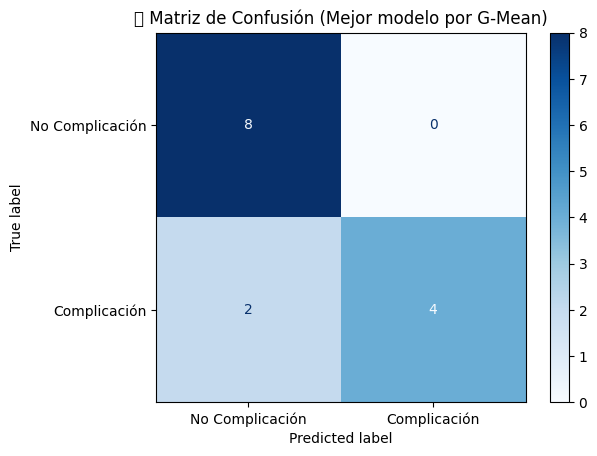


📌 Evaluación final:
   Accuracy: 0.8571
   F1 Score: 0.8000
   TPR: 0.6667
   TNR: 1.0000
   G-Mean: 0.8165


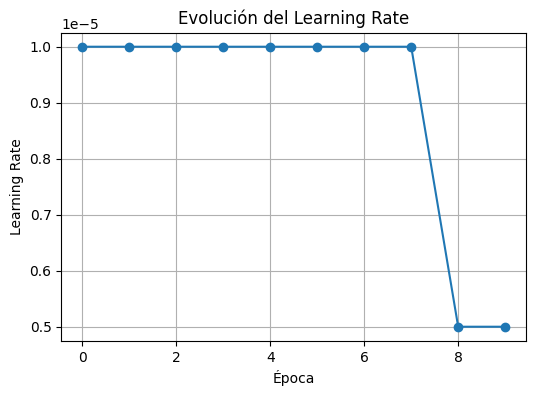

In [29]:
train_model_bs_virtual(model, train_loader, val_loader, criterion, optimizer, device, epochs=10, save_path="mejor_modelo_resnet_gmean.pth", accumulation_steps=76)

The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.



📘 Epoch 1/100


100%|██████████| 76/76 [00:56<00:00,  1.35it/s]

🔹 Entrenamiento — Loss: 54.6176 | Acc: 0.5789 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000 | LR: 0.0001


🔸 Validación   — Loss: 10.0998 | Acc: 0.5000 | F1: 0.3636 | TPR: 0.3333 | TNR: 0.6250 | G-Mean: 0.4564
✅ Guardado modelo (G-Mean 0.4564) en 'mejor_modelo_resnet_gmean_mas_epocas_3.pth'

📘 Epoch 2/100


100%|██████████| 76/76 [00:55<00:00,  1.37it/s]

🔹 Entrenamiento — Loss: 57.3725 | Acc: 0.4211 | F1: 0.5926 | TPR: 1.0000 | TNR: 0.0000 | G-Mean: 0.0000 | LR: 0.0001


🔸 Validación   — Loss: 9.9337 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 3/100


100%|██████████| 76/76 [00:55<00:00,  1.37it/s]

🔹 Entrenamiento — Loss: 51.6409 | Acc: 0.5789 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000 | LR: 0.0001


🔸 Validación   — Loss: 9.9602 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 4/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 51.7022 | Acc: 0.5789 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000 | LR: 0.0001


🔸 Validación   — Loss: 9.5668 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 5/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 50.2414 | Acc: 0.5789 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000 | LR: 0.0001


🔸 Validación   — Loss: 9.6381 | Acc: 0.5000 | F1: 0.5333 | TPR: 0.6667 | TNR: 0.3750 | G-Mean: 0.5000
✅ Guardado modelo (G-Mean 0.5000) en 'mejor_modelo_resnet_gmean_mas_epocas_3.pth'

📘 Epoch 6/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 50.3765 | Acc: 0.6842 | F1: 0.5714 | TPR: 0.5000 | TNR: 0.8182 | G-Mean: 0.6396 | LR: 0.0001


🔸 Validación   — Loss: 9.3820 | Acc: 0.6429 | F1: 0.2857 | TPR: 0.1667 | TNR: 1.0000 | G-Mean: 0.4082

📘 Epoch 7/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 49.4625 | Acc: 0.6447 | F1: 0.3077 | TPR: 0.1875 | TNR: 0.9773 | G-Mean: 0.4281 | LR: 0.0001


🔸 Validación   — Loss: 9.4320 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 8/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 49.0036 | Acc: 0.5789 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000 | LR: 0.0001


🔸 Validación   — Loss: 9.4355 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 9/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 48.6015 | Acc: 0.5789 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000 | LR: 0.0001


🔸 Validación   — Loss: 9.4031 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 10/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 47.7529 | Acc: 0.6447 | F1: 0.2703 | TPR: 0.1562 | TNR: 1.0000 | G-Mean: 0.3953 | LR: 5e-05


🔸 Validación   — Loss: 9.3475 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 11/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 47.4176 | Acc: 0.6711 | F1: 0.3590 | TPR: 0.2188 | TNR: 1.0000 | G-Mean: 0.4677 | LR: 5e-05


🔸 Validación   — Loss: 9.3288 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 12/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 47.0659 | Acc: 0.7500 | F1: 0.5957 | TPR: 0.4375 | TNR: 0.9773 | G-Mean: 0.6539 | LR: 5e-05


🔸 Validación   — Loss: 9.3129 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 13/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 46.6285 | Acc: 0.7500 | F1: 0.5957 | TPR: 0.4375 | TNR: 0.9773 | G-Mean: 0.6539 | LR: 5e-05


🔸 Validación   — Loss: 9.3120 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 14/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 46.1584 | Acc: 0.7500 | F1: 0.5778 | TPR: 0.4062 | TNR: 1.0000 | G-Mean: 0.6374 | LR: 5e-05


🔸 Validación   — Loss: 9.3082 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 15/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 45.7202 | Acc: 0.6974 | F1: 0.4390 | TPR: 0.2812 | TNR: 1.0000 | G-Mean: 0.5303 | LR: 5e-05


🔸 Validación   — Loss: 9.3462 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 16/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 45.2720 | Acc: 0.7105 | F1: 0.4762 | TPR: 0.3125 | TNR: 1.0000 | G-Mean: 0.5590 | LR: 5e-05


🔸 Validación   — Loss: 9.3301 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 17/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 44.7724 | Acc: 0.7500 | F1: 0.5778 | TPR: 0.4062 | TNR: 1.0000 | G-Mean: 0.6374 | LR: 5e-05


🔸 Validación   — Loss: 9.3227 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 18/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 44.2479 | Acc: 0.7763 | F1: 0.6383 | TPR: 0.4688 | TNR: 1.0000 | G-Mean: 0.6847 | LR: 2.5e-05


🔸 Validación   — Loss: 9.3107 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 19/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 43.9727 | Acc: 0.7763 | F1: 0.6383 | TPR: 0.4688 | TNR: 1.0000 | G-Mean: 0.6847 | LR: 2.5e-05


🔸 Validación   — Loss: 9.2658 | Acc: 0.6429 | F1: 0.2857 | TPR: 0.1667 | TNR: 1.0000 | G-Mean: 0.4082

📘 Epoch 20/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 43.6788 | Acc: 0.7763 | F1: 0.6383 | TPR: 0.4688 | TNR: 1.0000 | G-Mean: 0.6847 | LR: 2.5e-05


🔸 Validación   — Loss: 9.2877 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 21/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 43.3717 | Acc: 0.7763 | F1: 0.6383 | TPR: 0.4688 | TNR: 1.0000 | G-Mean: 0.6847 | LR: 2.5e-05


🔸 Validación   — Loss: 9.2804 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 22/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 43.0541 | Acc: 0.7763 | F1: 0.6383 | TPR: 0.4688 | TNR: 1.0000 | G-Mean: 0.6847 | LR: 2.5e-05


🔸 Validación   — Loss: 9.2932 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 23/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 42.7221 | Acc: 0.7763 | F1: 0.6383 | TPR: 0.4688 | TNR: 1.0000 | G-Mean: 0.6847 | LR: 1.25e-05


🔸 Validación   — Loss: 9.2852 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 24/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 42.5473 | Acc: 0.7763 | F1: 0.6383 | TPR: 0.4688 | TNR: 1.0000 | G-Mean: 0.6847 | LR: 1.25e-05


🔸 Validación   — Loss: 9.3368 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 25/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 42.3645 | Acc: 0.7763 | F1: 0.6383 | TPR: 0.4688 | TNR: 1.0000 | G-Mean: 0.6847 | LR: 1.25e-05


🔸 Validación   — Loss: 9.2853 | Acc: 0.6429 | F1: 0.2857 | TPR: 0.1667 | TNR: 1.0000 | G-Mean: 0.4082

📘 Epoch 26/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 42.1754 | Acc: 0.7763 | F1: 0.6383 | TPR: 0.4688 | TNR: 1.0000 | G-Mean: 0.6847 | LR: 6.25e-06


🔸 Validación   — Loss: 9.3628 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 27/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 42.0769 | Acc: 0.7763 | F1: 0.6383 | TPR: 0.4688 | TNR: 1.0000 | G-Mean: 0.6847 | LR: 6.25e-06


🔸 Validación   — Loss: 9.2715 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 28/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 41.9744 | Acc: 0.7895 | F1: 0.6667 | TPR: 0.5000 | TNR: 1.0000 | G-Mean: 0.7071 | LR: 6.25e-06


🔸 Validación   — Loss: 9.3136 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 29/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 41.8689 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 3.125e-06


🔸 Validación   — Loss: 9.3295 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 30/100


100%|██████████| 76/76 [00:55<00:00,  1.37it/s]

🔹 Entrenamiento — Loss: 41.8146 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 3.125e-06


🔸 Validación   — Loss: 9.2907 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 31/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 41.7590 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 3.125e-06


🔸 Validación   — Loss: 9.2963 | Acc: 0.6429 | F1: 0.2857 | TPR: 0.1667 | TNR: 1.0000 | G-Mean: 0.4082

📘 Epoch 32/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 41.7024 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 1.5625e-06


🔸 Validación   — Loss: 9.2992 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 33/100


100%|██████████| 76/76 [00:55<00:00,  1.37it/s]

🔹 Entrenamiento — Loss: 41.6735 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 1.5625e-06


🔸 Validación   — Loss: 9.2786 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 34/100


100%|██████████| 76/76 [00:55<00:00,  1.37it/s]

🔹 Entrenamiento — Loss: 41.6438 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 1.5625e-06


🔸 Validación   — Loss: 9.2712 | Acc: 0.6429 | F1: 0.2857 | TPR: 0.1667 | TNR: 1.0000 | G-Mean: 0.4082

📘 Epoch 35/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 41.6136 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 7.8125e-07


🔸 Validación   — Loss: 9.2932 | Acc: 0.6429 | F1: 0.2857 | TPR: 0.1667 | TNR: 1.0000 | G-Mean: 0.4082

📘 Epoch 36/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 41.5982 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 7.8125e-07


🔸 Validación   — Loss: 9.2873 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 37/100


100%|██████████| 76/76 [00:55<00:00,  1.37it/s]

🔹 Entrenamiento — Loss: 41.5826 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 7.8125e-07


🔸 Validación   — Loss: 9.2684 | Acc: 0.6429 | F1: 0.2857 | TPR: 0.1667 | TNR: 1.0000 | G-Mean: 0.4082

📘 Epoch 38/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 41.5667 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 3.90625e-07


🔸 Validación   — Loss: 9.3161 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 39/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 41.5587 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 3.90625e-07


🔸 Validación   — Loss: 9.2951 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 40/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 41.5506 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 3.90625e-07


🔸 Validación   — Loss: 9.2724 | Acc: 0.6429 | F1: 0.2857 | TPR: 0.1667 | TNR: 1.0000 | G-Mean: 0.4082

📘 Epoch 41/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 41.5424 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 1.953125e-07


🔸 Validación   — Loss: 9.2965 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 42/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 41.5383 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 1.953125e-07


🔸 Validación   — Loss: 9.3029 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 43/100


100%|██████████| 76/76 [00:55<00:00,  1.37it/s]

🔹 Entrenamiento — Loss: 41.5341 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 1.953125e-07


🔸 Validación   — Loss: 9.2887 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 44/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 41.5298 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 9.765625e-08


🔸 Validación   — Loss: 9.2931 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 45/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 41.5277 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 9.765625e-08


🔸 Validación   — Loss: 9.3133 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 46/100


100%|██████████| 76/76 [00:55<00:00,  1.37it/s]

🔹 Entrenamiento — Loss: 41.5256 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 9.765625e-08


🔸 Validación   — Loss: 9.2858 | Acc: 0.6429 | F1: 0.2857 | TPR: 0.1667 | TNR: 1.0000 | G-Mean: 0.4082

📘 Epoch 47/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 41.5234 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 4.8828125e-08


🔸 Validación   — Loss: 9.3037 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 48/100


100%|██████████| 76/76 [00:55<00:00,  1.37it/s]

🔹 Entrenamiento — Loss: 41.5223 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 4.8828125e-08


🔸 Validación   — Loss: 9.2949 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 49/100


100%|██████████| 76/76 [00:55<00:00,  1.37it/s]

🔹 Entrenamiento — Loss: 41.5212 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 4.8828125e-08


🔸 Validación   — Loss: 9.2933 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 50/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 41.5201 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 2.44140625e-08


🔸 Validación   — Loss: 9.3182 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 51/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 41.5196 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 2.44140625e-08


🔸 Validación   — Loss: 9.3136 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 52/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 41.5190 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 2.44140625e-08


🔸 Validación   — Loss: 9.2810 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 53/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 41.5185 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 1.220703125e-08


🔸 Validación   — Loss: 9.3005 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 54/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 41.5182 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 1.220703125e-08


🔸 Validación   — Loss: 9.3081 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 55/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 41.5179 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 1.220703125e-08


🔸 Validación   — Loss: 9.3027 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 56/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 41.5176 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 1.220703125e-08


🔸 Validación   — Loss: 9.2992 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 57/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 41.5173 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 1.220703125e-08


🔸 Validación   — Loss: 9.3472 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 58/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 41.5170 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 1.220703125e-08


🔸 Validación   — Loss: 9.2698 | Acc: 0.6429 | F1: 0.2857 | TPR: 0.1667 | TNR: 1.0000 | G-Mean: 0.4082

📘 Epoch 59/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 41.5168 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 1.220703125e-08


🔸 Validación   — Loss: 9.3031 | Acc: 0.6429 | F1: 0.2857 | TPR: 0.1667 | TNR: 1.0000 | G-Mean: 0.4082

📘 Epoch 60/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 41.5165 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 1.220703125e-08


🔸 Validación   — Loss: 9.3230 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 61/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 41.5162 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 1.220703125e-08


🔸 Validación   — Loss: 9.2940 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 62/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 41.5159 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 1.220703125e-08


🔸 Validación   — Loss: 9.2921 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 63/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 41.5156 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 1.220703125e-08


🔸 Validación   — Loss: 9.2896 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 64/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 41.5153 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 1.220703125e-08


🔸 Validación   — Loss: 9.3050 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 65/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 41.5150 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 1.220703125e-08


🔸 Validación   — Loss: 9.2795 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 66/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 41.5147 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 1.220703125e-08


🔸 Validación   — Loss: 9.3110 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 67/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 41.5144 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 1.220703125e-08


🔸 Validación   — Loss: 9.2659 | Acc: 0.7143 | F1: 0.5000 | TPR: 0.3333 | TNR: 1.0000 | G-Mean: 0.5774
✅ Guardado modelo (G-Mean 0.5774) en 'mejor_modelo_resnet_gmean_mas_epocas_3.pth'

📘 Epoch 68/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 41.5141 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 1.220703125e-08


🔸 Validación   — Loss: 9.2716 | Acc: 0.6429 | F1: 0.2857 | TPR: 0.1667 | TNR: 1.0000 | G-Mean: 0.4082

📘 Epoch 69/100


100%|██████████| 76/76 [00:55<00:00,  1.37it/s]

🔹 Entrenamiento — Loss: 41.5138 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 1.220703125e-08


🔸 Validación   — Loss: 9.3192 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 70/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 41.5135 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 1.220703125e-08


🔸 Validación   — Loss: 9.3197 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 71/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 41.5132 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 1.220703125e-08


🔸 Validación   — Loss: 9.3547 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 72/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 41.5129 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 1.220703125e-08


🔸 Validación   — Loss: 9.2943 | Acc: 0.6429 | F1: 0.2857 | TPR: 0.1667 | TNR: 1.0000 | G-Mean: 0.4082

📘 Epoch 73/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 41.5126 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 1.220703125e-08


🔸 Validación   — Loss: 9.2878 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 74/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 41.5123 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 1.220703125e-08


🔸 Validación   — Loss: 9.2845 | Acc: 0.6429 | F1: 0.2857 | TPR: 0.1667 | TNR: 1.0000 | G-Mean: 0.4082

📘 Epoch 75/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 41.5120 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 1.220703125e-08


🔸 Validación   — Loss: 9.3210 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 76/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 41.5117 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 1.220703125e-08


🔸 Validación   — Loss: 9.2972 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 77/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 41.5114 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 1.220703125e-08


🔸 Validación   — Loss: 9.3320 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 78/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 41.5111 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 1.220703125e-08


🔸 Validación   — Loss: 9.2819 | Acc: 0.6429 | F1: 0.2857 | TPR: 0.1667 | TNR: 1.0000 | G-Mean: 0.4082

📘 Epoch 79/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 41.5108 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 1.220703125e-08


🔸 Validación   — Loss: 9.2731 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 80/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 41.5105 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 1.220703125e-08


🔸 Validación   — Loss: 9.3054 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 81/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 41.5102 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 1.220703125e-08


🔸 Validación   — Loss: 9.2981 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 82/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 41.5099 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 1.220703125e-08


🔸 Validación   — Loss: 9.2871 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 83/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 41.5096 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 1.220703125e-08


🔸 Validación   — Loss: 9.2854 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 84/100


100%|██████████| 76/76 [00:55<00:00,  1.37it/s]

🔹 Entrenamiento — Loss: 41.5093 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 1.220703125e-08


🔸 Validación   — Loss: 9.2691 | Acc: 0.6429 | F1: 0.2857 | TPR: 0.1667 | TNR: 1.0000 | G-Mean: 0.4082

📘 Epoch 85/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 41.5090 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 1.220703125e-08


🔸 Validación   — Loss: 9.2977 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 86/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 41.5087 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 1.220703125e-08


🔸 Validación   — Loss: 9.2870 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 87/100


100%|██████████| 76/76 [00:55<00:00,  1.37it/s]

🔹 Entrenamiento — Loss: 41.5084 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 1.220703125e-08


🔸 Validación   — Loss: 9.3304 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 88/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 41.5081 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 1.220703125e-08


🔸 Validación   — Loss: 9.3240 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 89/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 41.5078 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 1.220703125e-08


🔸 Validación   — Loss: 9.2831 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 90/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 41.5075 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 1.220703125e-08


🔸 Validación   — Loss: 9.3128 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 91/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 41.5072 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 1.220703125e-08


🔸 Validación   — Loss: 9.3004 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 92/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 41.5069 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 1.220703125e-08


🔸 Validación   — Loss: 9.3531 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 93/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 41.5065 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 1.220703125e-08


🔸 Validación   — Loss: 9.2901 | Acc: 0.6429 | F1: 0.2857 | TPR: 0.1667 | TNR: 1.0000 | G-Mean: 0.4082

📘 Epoch 94/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 41.5062 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 1.220703125e-08


🔸 Validación   — Loss: 9.2914 | Acc: 0.6429 | F1: 0.2857 | TPR: 0.1667 | TNR: 1.0000 | G-Mean: 0.4082

📘 Epoch 95/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 41.5059 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 1.220703125e-08


🔸 Validación   — Loss: 9.3120 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 96/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 41.5056 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 1.220703125e-08


🔸 Validación   — Loss: 9.2799 | Acc: 0.6429 | F1: 0.2857 | TPR: 0.1667 | TNR: 1.0000 | G-Mean: 0.4082

📘 Epoch 97/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 41.5053 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 1.220703125e-08


🔸 Validación   — Loss: 9.3282 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 98/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 41.5050 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 1.220703125e-08


🔸 Validación   — Loss: 9.3248 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 99/100


100%|██████████| 76/76 [00:55<00:00,  1.37it/s]

🔹 Entrenamiento — Loss: 41.5047 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 1.220703125e-08


🔸 Validación   — Loss: 9.2980 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 100/100


100%|██████████| 76/76 [00:55<00:00,  1.36it/s]

🔹 Entrenamiento — Loss: 41.5044 | Acc: 0.8026 | F1: 0.6939 | TPR: 0.5312 | TNR: 1.0000 | G-Mean: 0.7289 | LR: 1.220703125e-08


🔸 Validación   — Loss: 9.3118 | Acc: 0.5714 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📥 Cargado mejor modelo desde 'mejor_modelo_resnet_gmean_mas_epocas_3.pth'


You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
Glyph 128202 (\N{BAR CHART}) missing from font(s) DejaVu Sans.


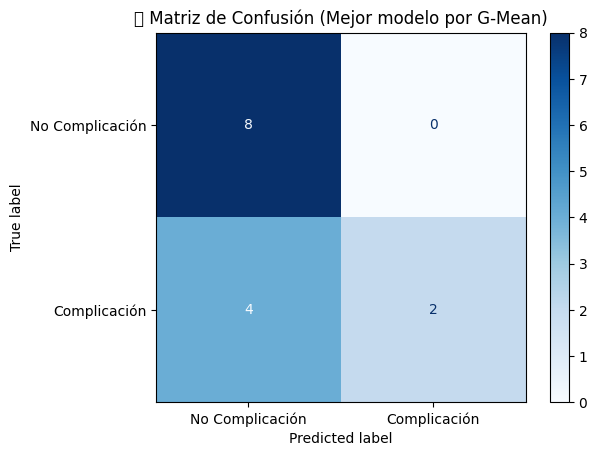


📌 Evaluación final:
   Accuracy: 0.7143
   F1 Score: 0.5000
   TPR: 0.3333
   TNR: 1.0000
   G-Mean: 0.5774


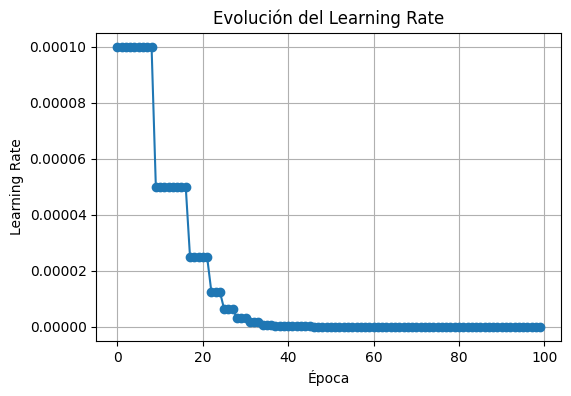

In [17]:
train_model_bs_virtual(model, train_loader, val_loader, criterion, optimizer, device, epochs=100, save_path="mejor_modelo_resnet_gmean_mas_epocas_3.pth", accumulation_steps=76)

The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.



📘 Epoch 1/50


100%|██████████| 9/9 [00:42<00:00,  4.77s/it]

🔹 Entrenamiento — Loss: 7.6305 | Acc: 0.4722 | F1: 0.4865 | TPR: 0.6000 | TNR: 0.3810 | G-Mean: 0.4781 | LR: 0.001


🔸 Validación   — Loss: 49.8933 | Acc: 0.4444 | F1: 0.6154 | TPR: 1.0000 | TNR: 0.0000 | G-Mean: 0.0000

📘 Epoch 2/50


100%|██████████| 9/9 [00:39<00:00,  4.42s/it]

🔹 Entrenamiento — Loss: 6.3258 | Acc: 0.5833 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000 | LR: 0.001


🔸 Validación   — Loss: 9.5156 | Acc: 0.4444 | F1: 0.6154 | TPR: 1.0000 | TNR: 0.0000 | G-Mean: 0.0000

📘 Epoch 3/50


100%|██████████| 9/9 [00:39<00:00,  4.41s/it]

🔹 Entrenamiento — Loss: 5.9866 | Acc: 0.5556 | F1: 0.4839 | TPR: 0.5000 | TNR: 0.5952 | G-Mean: 0.5455 | LR: 0.001


🔸 Validación   — Loss: 2.2018 | Acc: 0.4444 | F1: 0.1667 | TPR: 0.1250 | TNR: 0.7000 | G-Mean: 0.2958
✅ Guardado modelo (G-Mean 0.2958) en 'modelo_sin_hu.pth'

📘 Epoch 4/50


100%|██████████| 9/9 [00:39<00:00,  4.42s/it]

🔹 Entrenamiento — Loss: 6.0307 | Acc: 0.5694 | F1: 0.2051 | TPR: 0.1333 | TNR: 0.8810 | G-Mean: 0.3427 | LR: 0.001


🔸 Validación   — Loss: 2.4288 | Acc: 0.5556 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 5/50


100%|██████████| 9/9 [00:39<00:00,  4.42s/it]

🔹 Entrenamiento — Loss: 5.4251 | Acc: 0.6528 | F1: 0.5614 | TPR: 0.5333 | TNR: 0.7381 | G-Mean: 0.6274 | LR: 0.001


🔸 Validación   — Loss: 7.2114 | Acc: 0.5556 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 6/50


100%|██████████| 9/9 [00:39<00:00,  4.43s/it]

🔹 Entrenamiento — Loss: 4.8096 | Acc: 0.7639 | F1: 0.7119 | TPR: 0.7000 | TNR: 0.8095 | G-Mean: 0.7528 | LR: 0.001


🔸 Validación   — Loss: 2.5833 | Acc: 0.6111 | F1: 0.6957 | TPR: 1.0000 | TNR: 0.3000 | G-Mean: 0.5477
✅ Guardado modelo (G-Mean 0.5477) en 'modelo_sin_hu.pth'

📘 Epoch 7/50


100%|██████████| 9/9 [00:40<00:00,  4.47s/it]

🔹 Entrenamiento — Loss: 4.7874 | Acc: 0.7639 | F1: 0.7119 | TPR: 0.7000 | TNR: 0.8095 | G-Mean: 0.7528 | LR: 0.0005


🔸 Validación   — Loss: 1.6068 | Acc: 0.6111 | F1: 0.5882 | TPR: 0.6250 | TNR: 0.6000 | G-Mean: 0.6124
✅ Guardado modelo (G-Mean 0.6124) en 'modelo_sin_hu.pth'

📘 Epoch 8/50


100%|██████████| 9/9 [00:39<00:00,  4.42s/it]

🔹 Entrenamiento — Loss: 4.1044 | Acc: 0.8194 | F1: 0.7797 | TPR: 0.7667 | TNR: 0.8571 | G-Mean: 0.8106 | LR: 0.0005


🔸 Validación   — Loss: 1.8687 | Acc: 0.7222 | F1: 0.7619 | TPR: 1.0000 | TNR: 0.5000 | G-Mean: 0.7071
✅ Guardado modelo (G-Mean 0.7071) en 'modelo_sin_hu.pth'

📘 Epoch 9/50


100%|██████████| 9/9 [00:39<00:00,  4.43s/it]

🔹 Entrenamiento — Loss: 3.3872 | Acc: 0.8611 | F1: 0.8333 | TPR: 0.8333 | TNR: 0.8810 | G-Mean: 0.8568 | LR: 0.0005


🔸 Validación   — Loss: 1.7988 | Acc: 0.6667 | F1: 0.5714 | TPR: 0.5000 | TNR: 0.8000 | G-Mean: 0.6325

📘 Epoch 10/50


100%|██████████| 9/9 [00:39<00:00,  4.41s/it]

🔹 Entrenamiento — Loss: 3.1386 | Acc: 0.8750 | F1: 0.8525 | TPR: 0.8667 | TNR: 0.8810 | G-Mean: 0.8738 | LR: 0.0005


🔸 Validación   — Loss: 5.8912 | Acc: 0.5556 | F1: 0.6667 | TPR: 1.0000 | TNR: 0.2000 | G-Mean: 0.4472

📘 Epoch 11/50


100%|██████████| 9/9 [00:39<00:00,  4.44s/it]

🔹 Entrenamiento — Loss: 3.6358 | Acc: 0.8194 | F1: 0.7869 | TPR: 0.8000 | TNR: 0.8333 | G-Mean: 0.8165 | LR: 0.00025


🔸 Validación   — Loss: 2.1307 | Acc: 0.7222 | F1: 0.6154 | TPR: 0.5000 | TNR: 0.9000 | G-Mean: 0.6708

📘 Epoch 12/50


100%|██████████| 9/9 [00:39<00:00,  4.44s/it]

🔹 Entrenamiento — Loss: 2.2788 | Acc: 0.9583 | F1: 0.9508 | TPR: 0.9667 | TNR: 0.9524 | G-Mean: 0.9595 | LR: 0.00025


🔸 Validación   — Loss: 1.5606 | Acc: 0.6667 | F1: 0.6250 | TPR: 0.6250 | TNR: 0.7000 | G-Mean: 0.6614

📘 Epoch 13/50


100%|██████████| 9/9 [00:39<00:00,  4.43s/it]

🔹 Entrenamiento — Loss: 2.4663 | Acc: 0.9028 | F1: 0.8814 | TPR: 0.8667 | TNR: 0.9286 | G-Mean: 0.8971 | LR: 0.00025


🔸 Validación   — Loss: 4.3532 | Acc: 0.5556 | F1: 0.6364 | TPR: 0.8750 | TNR: 0.3000 | G-Mean: 0.5123

📘 Epoch 14/50


100%|██████████| 9/9 [00:39<00:00,  4.44s/it]

🔹 Entrenamiento — Loss: 2.3551 | Acc: 0.8750 | F1: 0.8475 | TPR: 0.8333 | TNR: 0.9048 | G-Mean: 0.8683 | LR: 0.00025


🔸 Validación   — Loss: 1.3292 | Acc: 0.7222 | F1: 0.6667 | TPR: 0.6250 | TNR: 0.8000 | G-Mean: 0.7071

📘 Epoch 15/50


100%|██████████| 9/9 [00:40<00:00,  4.45s/it]

🔹 Entrenamiento — Loss: 1.7297 | Acc: 0.9444 | F1: 0.9310 | TPR: 0.9000 | TNR: 0.9762 | G-Mean: 0.9373 | LR: 0.00025


🔸 Validación   — Loss: 3.7883 | Acc: 0.5556 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 16/50


100%|██████████| 9/9 [00:39<00:00,  4.44s/it]

🔹 Entrenamiento — Loss: 1.5919 | Acc: 0.9306 | F1: 0.9180 | TPR: 0.9333 | TNR: 0.9286 | G-Mean: 0.9309 | LR: 0.00025


🔸 Validación   — Loss: 1.7860 | Acc: 0.6667 | F1: 0.7000 | TPR: 0.8750 | TNR: 0.5000 | G-Mean: 0.6614

📘 Epoch 17/50


100%|██████████| 9/9 [00:40<00:00,  4.50s/it]

🔹 Entrenamiento — Loss: 2.3767 | Acc: 0.8750 | F1: 0.8364 | TPR: 0.7667 | TNR: 0.9524 | G-Mean: 0.8545 | LR: 0.00025


🔸 Validación   — Loss: 2.7745 | Acc: 0.7222 | F1: 0.6154 | TPR: 0.5000 | TNR: 0.9000 | G-Mean: 0.6708

📘 Epoch 18/50


100%|██████████| 9/9 [00:40<00:00,  4.46s/it]

🔹 Entrenamiento — Loss: 2.0296 | Acc: 0.9167 | F1: 0.9000 | TPR: 0.9000 | TNR: 0.9286 | G-Mean: 0.9142 | LR: 0.000125


🔸 Validación   — Loss: 2.4720 | Acc: 0.7222 | F1: 0.7619 | TPR: 1.0000 | TNR: 0.5000 | G-Mean: 0.7071

📘 Epoch 19/50


100%|██████████| 9/9 [00:41<00:00,  4.57s/it]

🔹 Entrenamiento — Loss: 1.8868 | Acc: 0.9444 | F1: 0.9355 | TPR: 0.9667 | TNR: 0.9286 | G-Mean: 0.9474 | LR: 0.000125


🔸 Validación   — Loss: 4.6365 | Acc: 0.6111 | F1: 0.6957 | TPR: 1.0000 | TNR: 0.3000 | G-Mean: 0.5477

📘 Epoch 20/50


100%|██████████| 9/9 [00:40<00:00,  4.47s/it]

🔹 Entrenamiento — Loss: 0.8990 | Acc: 1.0000 | F1: 1.0000 | TPR: 1.0000 | TNR: 1.0000 | G-Mean: 1.0000 | LR: 0.000125


🔸 Validación   — Loss: 2.7341 | Acc: 0.6111 | F1: 0.6667 | TPR: 0.8750 | TNR: 0.4000 | G-Mean: 0.5916

📘 Epoch 21/50


100%|██████████| 9/9 [00:40<00:00,  4.48s/it]

🔹 Entrenamiento — Loss: 1.0915 | Acc: 0.9583 | F1: 0.9524 | TPR: 1.0000 | TNR: 0.9286 | G-Mean: 0.9636 | LR: 6.25e-05


🔸 Validación   — Loss: 1.3665 | Acc: 0.6111 | F1: 0.6316 | TPR: 0.7500 | TNR: 0.5000 | G-Mean: 0.6124

📘 Epoch 22/50


100%|██████████| 9/9 [00:39<00:00,  4.44s/it]

🔹 Entrenamiento — Loss: 0.5822 | Acc: 1.0000 | F1: 1.0000 | TPR: 1.0000 | TNR: 1.0000 | G-Mean: 1.0000 | LR: 6.25e-05


🔸 Validación   — Loss: 2.2800 | Acc: 0.8333 | F1: 0.7692 | TPR: 0.6250 | TNR: 1.0000 | G-Mean: 0.7906
✅ Guardado modelo (G-Mean 0.7906) en 'modelo_sin_hu.pth'

📘 Epoch 23/50


100%|██████████| 9/9 [00:40<00:00,  4.46s/it]

🔹 Entrenamiento — Loss: 0.6909 | Acc: 0.9722 | F1: 0.9677 | TPR: 1.0000 | TNR: 0.9524 | G-Mean: 0.9759 | LR: 6.25e-05


🔸 Validación   — Loss: 3.1471 | Acc: 0.7778 | F1: 0.6667 | TPR: 0.5000 | TNR: 1.0000 | G-Mean: 0.7071

📘 Epoch 24/50


100%|██████████| 9/9 [00:40<00:00,  4.48s/it]

🔹 Entrenamiento — Loss: 0.7586 | Acc: 1.0000 | F1: 1.0000 | TPR: 1.0000 | TNR: 1.0000 | G-Mean: 1.0000 | LR: 3.125e-05


🔸 Validación   — Loss: 2.5328 | Acc: 0.7778 | F1: 0.6667 | TPR: 0.5000 | TNR: 1.0000 | G-Mean: 0.7071

📘 Epoch 25/50


100%|██████████| 9/9 [00:39<00:00,  4.44s/it]

🔹 Entrenamiento — Loss: 0.4951 | Acc: 1.0000 | F1: 1.0000 | TPR: 1.0000 | TNR: 1.0000 | G-Mean: 1.0000 | LR: 3.125e-05


🔸 Validación   — Loss: 2.1521 | Acc: 0.8333 | F1: 0.7692 | TPR: 0.6250 | TNR: 1.0000 | G-Mean: 0.7906

📘 Epoch 26/50


100%|██████████| 9/9 [00:39<00:00,  4.43s/it]

🔹 Entrenamiento — Loss: 1.4179 | Acc: 0.9444 | F1: 0.9333 | TPR: 0.9333 | TNR: 0.9524 | G-Mean: 0.9428 | LR: 3.125e-05


🔸 Validación   — Loss: 1.7040 | Acc: 0.6667 | F1: 0.6667 | TPR: 0.7500 | TNR: 0.6000 | G-Mean: 0.6708

📘 Epoch 27/50


100%|██████████| 9/9 [00:40<00:00,  4.48s/it]

🔹 Entrenamiento — Loss: 0.9076 | Acc: 0.9861 | F1: 0.9831 | TPR: 0.9667 | TNR: 1.0000 | G-Mean: 0.9832 | LR: 1.5625e-05


🔸 Validación   — Loss: 1.5785 | Acc: 0.6667 | F1: 0.6667 | TPR: 0.7500 | TNR: 0.6000 | G-Mean: 0.6708

📘 Epoch 28/50


100%|██████████| 9/9 [00:40<00:00,  4.46s/it]

🔹 Entrenamiento — Loss: 0.6538 | Acc: 1.0000 | F1: 1.0000 | TPR: 1.0000 | TNR: 1.0000 | G-Mean: 1.0000 | LR: 1.5625e-05


🔸 Validación   — Loss: 1.5265 | Acc: 0.6667 | F1: 0.6667 | TPR: 0.7500 | TNR: 0.6000 | G-Mean: 0.6708

📘 Epoch 29/50


100%|██████████| 9/9 [00:39<00:00,  4.43s/it]

🔹 Entrenamiento — Loss: 0.9188 | Acc: 0.9444 | F1: 0.9286 | TPR: 0.8667 | TNR: 1.0000 | G-Mean: 0.9309 | LR: 1.5625e-05


🔸 Validación   — Loss: 1.5008 | Acc: 0.6667 | F1: 0.6667 | TPR: 0.7500 | TNR: 0.6000 | G-Mean: 0.6708

📘 Epoch 30/50


100%|██████████| 9/9 [00:39<00:00,  4.42s/it]

🔹 Entrenamiento — Loss: 0.4143 | Acc: 1.0000 | F1: 1.0000 | TPR: 1.0000 | TNR: 1.0000 | G-Mean: 1.0000 | LR: 7.8125e-06


🔸 Validación   — Loss: 1.4969 | Acc: 0.6667 | F1: 0.6667 | TPR: 0.7500 | TNR: 0.6000 | G-Mean: 0.6708

📘 Epoch 31/50


100%|██████████| 9/9 [00:40<00:00,  4.45s/it]

🔹 Entrenamiento — Loss: 0.5480 | Acc: 1.0000 | F1: 1.0000 | TPR: 1.0000 | TNR: 1.0000 | G-Mean: 1.0000 | LR: 7.8125e-06


🔸 Validación   — Loss: 1.4980 | Acc: 0.7222 | F1: 0.7368 | TPR: 0.8750 | TNR: 0.6000 | G-Mean: 0.7246

📘 Epoch 32/50


100%|██████████| 9/9 [00:40<00:00,  4.45s/it]

🔹 Entrenamiento — Loss: 0.8278 | Acc: 1.0000 | F1: 1.0000 | TPR: 1.0000 | TNR: 1.0000 | G-Mean: 1.0000 | LR: 7.8125e-06


🔸 Validación   — Loss: 1.5130 | Acc: 0.6111 | F1: 0.5882 | TPR: 0.6250 | TNR: 0.6000 | G-Mean: 0.6124

📘 Epoch 33/50


100%|██████████| 9/9 [00:39<00:00,  4.41s/it]

🔹 Entrenamiento — Loss: 0.7330 | Acc: 1.0000 | F1: 1.0000 | TPR: 1.0000 | TNR: 1.0000 | G-Mean: 1.0000 | LR: 3.90625e-06


🔸 Validación   — Loss: 1.5192 | Acc: 0.6111 | F1: 0.5882 | TPR: 0.6250 | TNR: 0.6000 | G-Mean: 0.6124

📘 Epoch 34/50


100%|██████████| 9/9 [00:39<00:00,  4.41s/it]

🔹 Entrenamiento — Loss: 0.6936 | Acc: 0.9861 | F1: 0.9836 | TPR: 1.0000 | TNR: 0.9762 | G-Mean: 0.9880 | LR: 3.90625e-06


🔸 Validación   — Loss: 1.5340 | Acc: 0.6111 | F1: 0.5882 | TPR: 0.6250 | TNR: 0.6000 | G-Mean: 0.6124

📘 Epoch 35/50


100%|██████████| 9/9 [00:39<00:00,  4.41s/it]

🔹 Entrenamiento — Loss: 0.4040 | Acc: 1.0000 | F1: 1.0000 | TPR: 1.0000 | TNR: 1.0000 | G-Mean: 1.0000 | LR: 3.90625e-06


🔸 Validación   — Loss: 1.5348 | Acc: 0.6111 | F1: 0.5882 | TPR: 0.6250 | TNR: 0.6000 | G-Mean: 0.6124

📘 Epoch 36/50


100%|██████████| 9/9 [00:40<00:00,  4.45s/it]

🔹 Entrenamiento — Loss: 0.8415 | Acc: 1.0000 | F1: 1.0000 | TPR: 1.0000 | TNR: 1.0000 | G-Mean: 1.0000 | LR: 1.953125e-06


🔸 Validación   — Loss: 1.5261 | Acc: 0.6111 | F1: 0.5882 | TPR: 0.6250 | TNR: 0.6000 | G-Mean: 0.6124

📘 Epoch 37/50


100%|██████████| 9/9 [00:39<00:00,  4.43s/it]

🔹 Entrenamiento — Loss: 0.9004 | Acc: 0.9861 | F1: 0.9831 | TPR: 0.9667 | TNR: 1.0000 | G-Mean: 0.9832 | LR: 1.953125e-06


🔸 Validación   — Loss: 1.5431 | Acc: 0.6111 | F1: 0.5882 | TPR: 0.6250 | TNR: 0.6000 | G-Mean: 0.6124

📘 Epoch 38/50


100%|██████████| 9/9 [00:40<00:00,  4.47s/it]

🔹 Entrenamiento — Loss: 0.5327 | Acc: 1.0000 | F1: 1.0000 | TPR: 1.0000 | TNR: 1.0000 | G-Mean: 1.0000 | LR: 1.953125e-06


🔸 Validación   — Loss: 1.5499 | Acc: 0.6111 | F1: 0.5882 | TPR: 0.6250 | TNR: 0.6000 | G-Mean: 0.6124

📘 Epoch 39/50


100%|██████████| 9/9 [00:40<00:00,  4.46s/it]

🔹 Entrenamiento — Loss: 0.4569 | Acc: 1.0000 | F1: 1.0000 | TPR: 1.0000 | TNR: 1.0000 | G-Mean: 1.0000 | LR: 9.765625e-07


🔸 Validación   — Loss: 1.5553 | Acc: 0.6111 | F1: 0.5882 | TPR: 0.6250 | TNR: 0.6000 | G-Mean: 0.6124

📘 Epoch 40/50


100%|██████████| 9/9 [00:39<00:00,  4.43s/it]

🔹 Entrenamiento — Loss: 0.4666 | Acc: 1.0000 | F1: 1.0000 | TPR: 1.0000 | TNR: 1.0000 | G-Mean: 1.0000 | LR: 9.765625e-07


🔸 Validación   — Loss: 1.5278 | Acc: 0.6111 | F1: 0.5882 | TPR: 0.6250 | TNR: 0.6000 | G-Mean: 0.6124

📘 Epoch 41/50


100%|██████████| 9/9 [00:39<00:00,  4.43s/it]

🔹 Entrenamiento — Loss: 0.3920 | Acc: 1.0000 | F1: 1.0000 | TPR: 1.0000 | TNR: 1.0000 | G-Mean: 1.0000 | LR: 9.765625e-07


🔸 Validación   — Loss: 1.5377 | Acc: 0.6111 | F1: 0.5882 | TPR: 0.6250 | TNR: 0.6000 | G-Mean: 0.6124

📘 Epoch 42/50


100%|██████████| 9/9 [00:40<00:00,  4.45s/it]

🔹 Entrenamiento — Loss: 0.4191 | Acc: 1.0000 | F1: 1.0000 | TPR: 1.0000 | TNR: 1.0000 | G-Mean: 1.0000 | LR: 4.8828125e-07


🔸 Validación   — Loss: 1.5295 | Acc: 0.6111 | F1: 0.5882 | TPR: 0.6250 | TNR: 0.6000 | G-Mean: 0.6124

📘 Epoch 43/50


100%|██████████| 9/9 [00:40<00:00,  4.47s/it]

🔹 Entrenamiento — Loss: 0.4838 | Acc: 1.0000 | F1: 1.0000 | TPR: 1.0000 | TNR: 1.0000 | G-Mean: 1.0000 | LR: 4.8828125e-07


🔸 Validación   — Loss: 1.5703 | Acc: 0.6111 | F1: 0.5882 | TPR: 0.6250 | TNR: 0.6000 | G-Mean: 0.6124

📘 Epoch 44/50


100%|██████████| 9/9 [00:39<00:00,  4.42s/it]

🔹 Entrenamiento — Loss: 0.5770 | Acc: 1.0000 | F1: 1.0000 | TPR: 1.0000 | TNR: 1.0000 | G-Mean: 1.0000 | LR: 4.8828125e-07


🔸 Validación   — Loss: 1.5417 | Acc: 0.6111 | F1: 0.5882 | TPR: 0.6250 | TNR: 0.6000 | G-Mean: 0.6124

📘 Epoch 45/50


100%|██████████| 9/9 [00:39<00:00,  4.43s/it]

🔹 Entrenamiento — Loss: 0.4060 | Acc: 1.0000 | F1: 1.0000 | TPR: 1.0000 | TNR: 1.0000 | G-Mean: 1.0000 | LR: 2.44140625e-07


🔸 Validación   — Loss: 1.5457 | Acc: 0.6111 | F1: 0.5882 | TPR: 0.6250 | TNR: 0.6000 | G-Mean: 0.6124

📘 Epoch 46/50


100%|██████████| 9/9 [00:39<00:00,  4.43s/it]

🔹 Entrenamiento — Loss: 0.4075 | Acc: 1.0000 | F1: 1.0000 | TPR: 1.0000 | TNR: 1.0000 | G-Mean: 1.0000 | LR: 2.44140625e-07


🔸 Validación   — Loss: 1.5654 | Acc: 0.6111 | F1: 0.5882 | TPR: 0.6250 | TNR: 0.6000 | G-Mean: 0.6124

📘 Epoch 47/50


100%|██████████| 9/9 [00:39<00:00,  4.42s/it]

🔹 Entrenamiento — Loss: 0.4143 | Acc: 1.0000 | F1: 1.0000 | TPR: 1.0000 | TNR: 1.0000 | G-Mean: 1.0000 | LR: 2.44140625e-07


🔸 Validación   — Loss: 1.5557 | Acc: 0.6111 | F1: 0.5882 | TPR: 0.6250 | TNR: 0.6000 | G-Mean: 0.6124

📘 Epoch 48/50


100%|██████████| 9/9 [00:39<00:00,  4.43s/it]

🔹 Entrenamiento — Loss: 1.0735 | Acc: 0.9722 | F1: 0.9655 | TPR: 0.9333 | TNR: 1.0000 | G-Mean: 0.9661 | LR: 1.220703125e-07


🔸 Validación   — Loss: 1.5975 | Acc: 0.6111 | F1: 0.5882 | TPR: 0.6250 | TNR: 0.6000 | G-Mean: 0.6124

📘 Epoch 49/50


100%|██████████| 9/9 [00:40<00:00,  4.50s/it]

🔹 Entrenamiento — Loss: 0.4612 | Acc: 1.0000 | F1: 1.0000 | TPR: 1.0000 | TNR: 1.0000 | G-Mean: 1.0000 | LR: 1.220703125e-07


🔸 Validación   — Loss: 1.5769 | Acc: 0.6111 | F1: 0.5882 | TPR: 0.6250 | TNR: 0.6000 | G-Mean: 0.6124

📘 Epoch 50/50


100%|██████████| 9/9 [00:39<00:00,  4.44s/it]

🔹 Entrenamiento — Loss: 0.4323 | Acc: 1.0000 | F1: 1.0000 | TPR: 1.0000 | TNR: 1.0000 | G-Mean: 1.0000 | LR: 1.220703125e-07


🔸 Validación   — Loss: 1.5479 | Acc: 0.6111 | F1: 0.5882 | TPR: 0.6250 | TNR: 0.6000 | G-Mean: 0.6124

📥 Cargado mejor modelo desde 'modelo_sin_hu.pth'


You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
Glyph 128202 (\N{BAR CHART}) missing from font(s) DejaVu Sans.


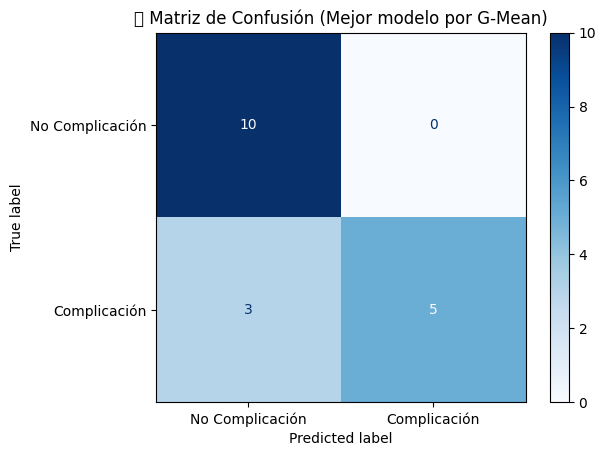


📌 Evaluación final:
   Accuracy: 0.8333
   F1 Score: 0.7692
   TPR: 0.6250
   TNR: 1.0000
   G-Mean: 0.7906


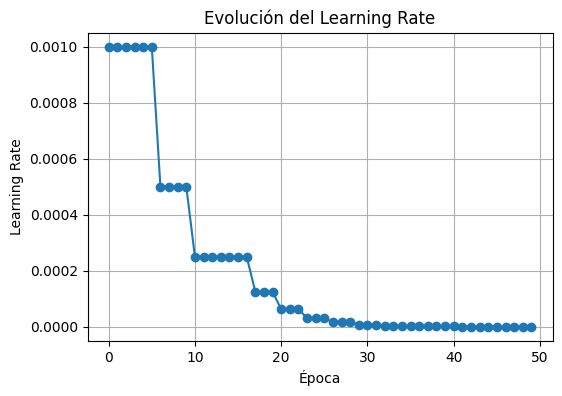

In [20]:
train_model_bs_virtual(model, train_loader, val_loader, criterion, optimizer, device, epochs=50, save_path="modelo_sin_hu.pth", accumulation_steps=4)

The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.



📘 Epoch 1/30


100%|██████████| 10/10 [01:05<00:00,  6.56s/it]

🔹 Entrenamiento — Loss: 6.8574 | Acc: 0.5375 | F1: 0.6408 | TPR: 0.8684 | TNR: 0.2381 | G-Mean: 0.4547 | LR: 0.001


🔸 Validación   — Loss: 152.4041 | Acc: 0.5500 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 2/30


100%|██████████| 10/10 [00:44<00:00,  4.44s/it]

🔹 Entrenamiento — Loss: 8.1573 | Acc: 0.5250 | F1: 0.1364 | TPR: 0.0789 | TNR: 0.9286 | G-Mean: 0.2708 | LR: 0.001


🔸 Validación   — Loss: 1518.8285 | Acc: 0.4500 | F1: 0.6207 | TPR: 1.0000 | TNR: 0.0000 | G-Mean: 0.0000

📘 Epoch 3/30


100%|██████████| 10/10 [00:44<00:00,  4.43s/it]

🔹 Entrenamiento — Loss: 7.6845 | Acc: 0.5375 | F1: 0.4638 | TPR: 0.4211 | TNR: 0.6429 | G-Mean: 0.5203 | LR: 0.001


🔸 Validación   — Loss: 43.9531 | Acc: 0.4500 | F1: 0.6207 | TPR: 1.0000 | TNR: 0.0000 | G-Mean: 0.0000

📘 Epoch 4/30


100%|██████████| 10/10 [00:44<00:00,  4.43s/it]

🔹 Entrenamiento — Loss: 6.8371 | Acc: 0.5625 | F1: 0.6067 | TPR: 0.7105 | TNR: 0.4286 | G-Mean: 0.5518 | LR: 0.001


🔸 Validación   — Loss: 11.6318 | Acc: 0.4500 | F1: 0.6207 | TPR: 1.0000 | TNR: 0.0000 | G-Mean: 0.0000

📘 Epoch 5/30


100%|██████████| 10/10 [00:44<00:00,  4.42s/it]

🔹 Entrenamiento — Loss: 6.6164 | Acc: 0.6000 | F1: 0.5897 | TPR: 0.6053 | TNR: 0.5952 | G-Mean: 0.6002 | LR: 0.001


🔸 Validación   — Loss: 16.9004 | Acc: 0.4500 | F1: 0.6207 | TPR: 1.0000 | TNR: 0.0000 | G-Mean: 0.0000

📘 Epoch 6/30


100%|██████████| 10/10 [00:44<00:00,  4.43s/it]

🔹 Entrenamiento — Loss: 6.3009 | Acc: 0.6750 | F1: 0.6750 | TPR: 0.7105 | TNR: 0.6429 | G-Mean: 0.6758 | LR: 0.001


🔸 Validación   — Loss: 12.1018 | Acc: 0.4500 | F1: 0.6207 | TPR: 1.0000 | TNR: 0.0000 | G-Mean: 0.0000

📘 Epoch 7/30


100%|██████████| 10/10 [00:44<00:00,  4.42s/it]

🔹 Entrenamiento — Loss: 6.0340 | Acc: 0.6750 | F1: 0.6667 | TPR: 0.6842 | TNR: 0.6667 | G-Mean: 0.6754 | LR: 0.001


🔸 Validación   — Loss: 5.3898 | Acc: 0.4500 | F1: 0.5926 | TPR: 0.8889 | TNR: 0.0909 | G-Mean: 0.2843
✅ Guardado modelo (G-Mean 0.2843) en 'modelo_100_pacientes.pth'

📘 Epoch 8/30


100%|██████████| 10/10 [00:44<00:00,  4.43s/it]

🔹 Entrenamiento — Loss: 5.9210 | Acc: 0.6500 | F1: 0.6500 | TPR: 0.6842 | TNR: 0.6190 | G-Mean: 0.6508 | LR: 0.001


🔸 Validación   — Loss: 2.9479 | Acc: 0.4500 | F1: 0.5926 | TPR: 0.8889 | TNR: 0.0909 | G-Mean: 0.2843

📘 Epoch 9/30


100%|██████████| 10/10 [00:44<00:00,  4.42s/it]

🔹 Entrenamiento — Loss: 5.3495 | Acc: 0.7500 | F1: 0.7297 | TPR: 0.7105 | TNR: 0.7857 | G-Mean: 0.7472 | LR: 0.001


🔸 Validación   — Loss: 2.9283 | Acc: 0.5500 | F1: 0.6400 | TPR: 0.8889 | TNR: 0.2727 | G-Mean: 0.4924
✅ Guardado modelo (G-Mean 0.4924) en 'modelo_100_pacientes.pth'

📘 Epoch 10/30


100%|██████████| 10/10 [00:44<00:00,  4.43s/it]

🔹 Entrenamiento — Loss: 4.7585 | Acc: 0.7875 | F1: 0.7671 | TPR: 0.7368 | TNR: 0.8333 | G-Mean: 0.7836 | LR: 0.001


🔸 Validación   — Loss: 2.3370 | Acc: 0.6000 | F1: 0.2000 | TPR: 0.1111 | TNR: 1.0000 | G-Mean: 0.3333

📘 Epoch 11/30


100%|██████████| 10/10 [00:44<00:00,  4.42s/it]

🔹 Entrenamiento — Loss: 5.1057 | Acc: 0.7250 | F1: 0.7027 | TPR: 0.6842 | TNR: 0.7619 | G-Mean: 0.7220 | LR: 0.001


🔸 Validación   — Loss: 38.0552 | Acc: 0.4500 | F1: 0.6207 | TPR: 1.0000 | TNR: 0.0000 | G-Mean: 0.0000

📘 Epoch 12/30


100%|██████████| 10/10 [00:44<00:00,  4.45s/it]

🔹 Entrenamiento — Loss: 5.3727 | Acc: 0.7625 | F1: 0.7397 | TPR: 0.7105 | TNR: 0.8095 | G-Mean: 0.7584 | LR: 0.001


🔸 Validación   — Loss: 12.2536 | Acc: 0.4500 | F1: 0.6207 | TPR: 1.0000 | TNR: 0.0000 | G-Mean: 0.0000

📘 Epoch 13/30


100%|██████████| 10/10 [00:44<00:00,  4.43s/it]

🔹 Entrenamiento — Loss: 5.0722 | Acc: 0.8250 | F1: 0.8108 | TPR: 0.7895 | TNR: 0.8571 | G-Mean: 0.8226 | LR: 0.001


🔸 Validación   — Loss: 3.2727 | Acc: 0.6500 | F1: 0.6957 | TPR: 0.8889 | TNR: 0.4545 | G-Mean: 0.6356
✅ Guardado modelo (G-Mean 0.6356) en 'modelo_100_pacientes.pth'

📘 Epoch 14/30


100%|██████████| 10/10 [00:44<00:00,  4.45s/it]

🔹 Entrenamiento — Loss: 4.5246 | Acc: 0.7750 | F1: 0.7692 | TPR: 0.7895 | TNR: 0.7619 | G-Mean: 0.7756 | LR: 0.0005


🔸 Validación   — Loss: 2.1776 | Acc: 0.7500 | F1: 0.6154 | TPR: 0.4444 | TNR: 1.0000 | G-Mean: 0.6667
✅ Guardado modelo (G-Mean 0.6667) en 'modelo_100_pacientes.pth'

📘 Epoch 15/30


100%|██████████| 10/10 [00:44<00:00,  4.47s/it]

🔹 Entrenamiento — Loss: 4.0995 | Acc: 0.8375 | F1: 0.8267 | TPR: 0.8158 | TNR: 0.8571 | G-Mean: 0.8362 | LR: 0.0005


🔸 Validación   — Loss: 2.2989 | Acc: 0.6500 | F1: 0.3636 | TPR: 0.2222 | TNR: 1.0000 | G-Mean: 0.4714

📘 Epoch 16/30


100%|██████████| 10/10 [00:44<00:00,  4.47s/it]

🔹 Entrenamiento — Loss: 4.0639 | Acc: 0.8125 | F1: 0.8101 | TPR: 0.8421 | TNR: 0.7857 | G-Mean: 0.8134 | LR: 0.0005


🔸 Validación   — Loss: 2.1685 | Acc: 0.7000 | F1: 0.6667 | TPR: 0.6667 | TNR: 0.7273 | G-Mean: 0.6963
✅ Guardado modelo (G-Mean 0.6963) en 'modelo_100_pacientes.pth'

📘 Epoch 17/30


100%|██████████| 10/10 [00:44<00:00,  4.46s/it]

🔹 Entrenamiento — Loss: 3.7109 | Acc: 0.8000 | F1: 0.7838 | TPR: 0.7632 | TNR: 0.8333 | G-Mean: 0.7975 | LR: 0.0005


🔸 Validación   — Loss: 5.2119 | Acc: 0.5500 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 18/30


100%|██████████| 10/10 [00:44<00:00,  4.48s/it]

🔹 Entrenamiento — Loss: 2.8997 | Acc: 0.9000 | F1: 0.8919 | TPR: 0.8684 | TNR: 0.9286 | G-Mean: 0.8980 | LR: 0.0005


🔸 Validación   — Loss: 2.8528 | Acc: 0.6500 | F1: 0.5333 | TPR: 0.4444 | TNR: 0.8182 | G-Mean: 0.6030

📘 Epoch 19/30


100%|██████████| 10/10 [00:44<00:00,  4.47s/it]

🔹 Entrenamiento — Loss: 3.8618 | Acc: 0.8125 | F1: 0.8148 | TPR: 0.8684 | TNR: 0.7619 | G-Mean: 0.8134 | LR: 0.0005


🔸 Validación   — Loss: 5.1224 | Acc: 0.5500 | F1: 0.6400 | TPR: 0.8889 | TNR: 0.2727 | G-Mean: 0.4924

📘 Epoch 20/30


100%|██████████| 10/10 [00:44<00:00,  4.46s/it]

🔹 Entrenamiento — Loss: 2.5668 | Acc: 0.8875 | F1: 0.8831 | TPR: 0.8947 | TNR: 0.8810 | G-Mean: 0.8878 | LR: 0.00025


🔸 Validación   — Loss: 2.3485 | Acc: 0.7500 | F1: 0.6667 | TPR: 0.5556 | TNR: 0.9091 | G-Mean: 0.7107
✅ Guardado modelo (G-Mean 0.7107) en 'modelo_100_pacientes.pth'

📘 Epoch 21/30


100%|██████████| 10/10 [00:44<00:00,  4.46s/it]

🔹 Entrenamiento — Loss: 4.3771 | Acc: 0.7875 | F1: 0.7792 | TPR: 0.7895 | TNR: 0.7857 | G-Mean: 0.7876 | LR: 0.00025


🔸 Validación   — Loss: 4.6346 | Acc: 0.5500 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 22/30


100%|██████████| 10/10 [00:44<00:00,  4.44s/it]

🔹 Entrenamiento — Loss: 1.8550 | Acc: 0.9625 | F1: 0.9600 | TPR: 0.9474 | TNR: 0.9762 | G-Mean: 0.9617 | LR: 0.00025


🔸 Validación   — Loss: 3.3632 | Acc: 0.6000 | F1: 0.2000 | TPR: 0.1111 | TNR: 1.0000 | G-Mean: 0.3333

📘 Epoch 23/30


100%|██████████| 10/10 [00:44<00:00,  4.45s/it]

🔹 Entrenamiento — Loss: 2.4036 | Acc: 0.9250 | F1: 0.9167 | TPR: 0.8684 | TNR: 0.9762 | G-Mean: 0.9207 | LR: 0.000125


🔸 Validación   — Loss: 1.9607 | Acc: 0.7500 | F1: 0.6154 | TPR: 0.4444 | TNR: 1.0000 | G-Mean: 0.6667

📘 Epoch 24/30


100%|██████████| 10/10 [00:44<00:00,  4.47s/it]

🔹 Entrenamiento — Loss: 1.9271 | Acc: 0.9625 | F1: 0.9589 | TPR: 0.9211 | TNR: 1.0000 | G-Mean: 0.9597 | LR: 0.000125


🔸 Validación   — Loss: 2.6952 | Acc: 0.6000 | F1: 0.6667 | TPR: 0.8889 | TNR: 0.3636 | G-Mean: 0.5685

📘 Epoch 25/30


100%|██████████| 10/10 [00:44<00:00,  4.45s/it]

🔹 Entrenamiento — Loss: 1.2896 | Acc: 1.0000 | F1: 1.0000 | TPR: 1.0000 | TNR: 1.0000 | G-Mean: 1.0000 | LR: 0.000125


🔸 Validación   — Loss: 3.0999 | Acc: 0.6500 | F1: 0.6957 | TPR: 0.8889 | TNR: 0.4545 | G-Mean: 0.6356

📘 Epoch 26/30


100%|██████████| 10/10 [00:44<00:00,  4.42s/it]

🔹 Entrenamiento — Loss: 1.3719 | Acc: 1.0000 | F1: 1.0000 | TPR: 1.0000 | TNR: 1.0000 | G-Mean: 1.0000 | LR: 0.000125


🔸 Validación   — Loss: 2.7741 | Acc: 0.6000 | F1: 0.6000 | TPR: 0.6667 | TNR: 0.5455 | G-Mean: 0.6030

📘 Epoch 27/30


100%|██████████| 10/10 [00:44<00:00,  4.42s/it]

🔹 Entrenamiento — Loss: 2.0874 | Acc: 0.9250 | F1: 0.9211 | TPR: 0.9211 | TNR: 0.9286 | G-Mean: 0.9248 | LR: 6.25e-05


🔸 Validación   — Loss: 2.5601 | Acc: 0.7000 | F1: 0.6250 | TPR: 0.5556 | TNR: 0.8182 | G-Mean: 0.6742

📘 Epoch 28/30


100%|██████████| 10/10 [00:44<00:00,  4.42s/it]

🔹 Entrenamiento — Loss: 3.0538 | Acc: 0.9000 | F1: 0.9000 | TPR: 0.9474 | TNR: 0.8571 | G-Mean: 0.9011 | LR: 6.25e-05


🔸 Validación   — Loss: 2.4065 | Acc: 0.7000 | F1: 0.5714 | TPR: 0.4444 | TNR: 0.9091 | G-Mean: 0.6356

📘 Epoch 29/30


100%|██████████| 10/10 [00:44<00:00,  4.43s/it]

🔹 Entrenamiento — Loss: 1.1252 | Acc: 0.9750 | F1: 0.9737 | TPR: 0.9737 | TNR: 0.9762 | G-Mean: 0.9749 | LR: 6.25e-05


🔸 Validación   — Loss: 2.1547 | Acc: 0.7000 | F1: 0.5714 | TPR: 0.4444 | TNR: 0.9091 | G-Mean: 0.6356

📘 Epoch 30/30


100%|██████████| 10/10 [00:44<00:00,  4.42s/it]

🔹 Entrenamiento — Loss: 1.7425 | Acc: 0.9375 | F1: 0.9333 | TPR: 0.9211 | TNR: 0.9524 | G-Mean: 0.9366 | LR: 3.125e-05


🔸 Validación   — Loss: 2.1547 | Acc: 0.7000 | F1: 0.5714 | TPR: 0.4444 | TNR: 0.9091 | G-Mean: 0.6356

📥 Cargado mejor modelo desde 'modelo_100_pacientes.pth'


You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
Glyph 128202 (\N{BAR CHART}) missing from font(s) DejaVu Sans.


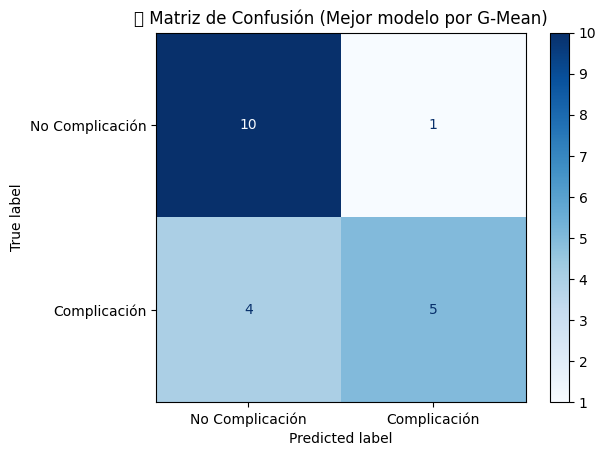


📌 Evaluación final:
   Accuracy: 0.7500
   F1 Score: 0.6667
   TPR: 0.5556
   TNR: 0.9091
   G-Mean: 0.7107


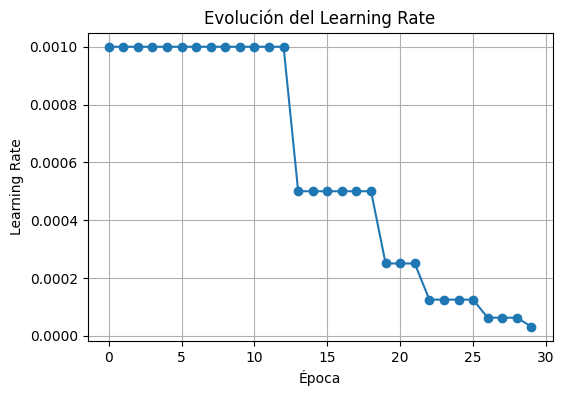

In [31]:
train_model_bs_virtual(model, train_loader, val_loader, criterion, optimizer, device, epochs=30, save_path="modelo_100_pacientes.pth", accumulation_steps=8)

In [ ]:
val_indices = val_dataset.indices 
val_patient_ids = [dataset.patients[i] for i in val_indices]
val_labels_dict = {pid: dataset.labels[pid] for pid in val_patient_ids}


In [97]:
print(type(val_dataset))  # Debe decir: torch.utils.data.dataset.Subset


<class 'torch.utils.data.dataset.Subset'>


In [ ]:
def get_prediction_info(model, val_labels_dict, device, data_dir):
    """
    Devuelve una lista de tuplas (ruta_volumen, etiqueta_real, etiqueta_predicha) del conjunto de validación.
    """
    model.eval()
    casos = []

    for patient_id, true_label in val_labels_dict.items():
        volume_path = os.path.join(data_dir, f"{patient_id}.npy")

        if not os.path.exists(volume_path):
            print(f" No se encontró el volumen para {patient_id}: {volume_path}")
            continue

        try:
            volume = np.load(volume_path)
            #volume = apply_3d_window(volume, window_level=-600, window_width=1500)
            volume = np.clip(volume, 0, 1)
            volume = np.expand_dims(volume, axis=0).astype(np.float32)
            tensor = torch.tensor(volume).unsqueeze(0).to(device)

            with torch.no_grad():
                output = model(tensor)
                pred = torch.argmax(output, dim=1).item()

            casos.append((volume_path, true_label, pred))
        except Exception as e:
            print(f" Error procesando {patient_id}: {e}")

    return casos


In [ ]:
def get_prediction_info(model, val_labels_dict, device, data_dir, mask_dir):
    """
    Devuelve una lista de tuplas (ruta_volumen, etiqueta_real, etiqueta_predicha) del conjunto de validación.
    Aplica la máscara igual que en el dataset de entrenamiento.
    """
    model.eval()
    casos = []

    for patient_id, true_label in val_labels_dict.items():
        volume_path = os.path.join(data_dir, f"{patient_id}.npy")
        mask_path = os.path.join(mask_dir, f"{patient_id}.npy")

        if not os.path.exists(volume_path):
            print(f" No se encontró el volumen para {patient_id}: {volume_path}")
            continue

        try:
            volume = np.load(volume_path)

            # Aplicar máscara
            if os.path.exists(mask_path):
                mask = np.load(mask_path).astype(bool)
                if mask.shape != volume.shape:
                    print(f" Dimensiones distintas: {volume.shape} vs {mask.shape} para {patient_id}")
                    continue
                volume = volume * mask
            else:
                print(f" No se encontró máscara para {patient_id}, se usará volumen completo")

            # Normalización
            volume = np.clip(volume, 0, 1)
            volume = np.expand_dims(volume, axis=0).astype(np.float32)
            tensor = torch.tensor(volume).unsqueeze(0).to(device)

            with torch.no_grad():
                output = model(tensor)
                pred = torch.argmax(output, dim=1).item()

            casos.append((volume_path, true_label, pred))

        except Exception as e:
            print(f" Error procesando {patient_id}: {e}")

    return casos


In [10]:
model.load_state_dict(torch.load("modelo_sin_hu.pth"))
model.eval()

You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.


DenseNet121(
  (features): Sequential(
    (conv0): Conv3d(1, 64, kernel_size=(7, 7, 7), stride=(2, 2, 2), padding=(3, 3, 3), bias=False)
    (norm0): BatchNorm3d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu0): ReLU(inplace=True)
    (pool0): MaxPool3d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (denseblock1): _DenseBlock(
      (denselayer1): _DenseLayer(
        (layers): Sequential(
          (norm1): BatchNorm3d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (relu1): ReLU(inplace=True)
          (conv1): Conv3d(64, 128, kernel_size=(1, 1, 1), stride=(1, 1, 1), bias=False)
          (norm2): BatchNorm3d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (relu2): ReLU(inplace=True)
          (conv2): Conv3d(128, 32, kernel_size=(3, 3, 3), stride=(1, 1, 1), padding=(1, 1, 1), bias=False)
        )
      )
      (denselayer2): _DenseLayer(
        (layers): Sequential(
 

In [33]:
device = "cuda" if torch.cuda.is_available() else "cpu"

model = DenseNet121(spatial_dims=3, in_channels=1, out_channels=2)
model.load_state_dict(torch.load("modelo_100_pacientes.pth"))
model.to(device)
model.eval()

You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.


DenseNet121(
  (features): Sequential(
    (conv0): Conv3d(1, 64, kernel_size=(7, 7, 7), stride=(2, 2, 2), padding=(3, 3, 3), bias=False)
    (norm0): BatchNorm3d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu0): ReLU(inplace=True)
    (pool0): MaxPool3d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (denseblock1): _DenseBlock(
      (denselayer1): _DenseLayer(
        (layers): Sequential(
          (norm1): BatchNorm3d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (relu1): ReLU(inplace=True)
          (conv1): Conv3d(64, 128, kernel_size=(1, 1, 1), stride=(1, 1, 1), bias=False)
          (norm2): BatchNorm3d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (relu2): ReLU(inplace=True)
          (conv2): Conv3d(128, 32, kernel_size=(3, 3, 3), stride=(1, 1, 1), padding=(1, 1, 1), bias=False)
        )
      )
      (denselayer2): _DenseLayer(
        (layers): Sequential(
 

In [34]:
from torch.utils.data import DataLoader
from sklearn.metrics import accuracy_score

dataloader = DataLoader(dataset, batch_size=1, shuffle=False)

preds = []
reals = []
volumes = []

with torch.no_grad():
    for vol, label in tqdm(dataloader):
        vol = vol.to(device)
        output = model(vol)
        pred = torch.argmax(output, dim=1).item()
        real = label.item()
        preds.append(pred)
        reals.append(real)
        volumes.append(vol.cpu())


100%|██████████| 100/100 [00:14<00:00,  6.92it/s]


In [35]:
correctos = []
fallos = []

for i, (p, r) in enumerate(zip(preds, reals)):
    if p == r:
        correctos.append((i, p, volumes[i]))
    else:
        fallos.append((i, p, volumes[i]))


In [36]:
from pytorch_grad_cam import GradCAM
from pytorch_grad_cam.utils.model_targets import ClassifierOutputTarget
from pytorch_grad_cam.utils.image import show_cam_on_image
import numpy as np
import matplotlib.pyplot as plt

def get_last_conv_layer(model):
    for layer in reversed(model.features):
        if isinstance(layer, torch.nn.Conv3d):
            return layer
        if hasattr(layer, 'layers'):
            for sub in reversed(layer.layers):
                if isinstance(sub, torch.nn.Conv3d):
                    return sub
    raise ValueError("No se encontró una capa Conv3d válida")

def show_gradcam_on_volume(model, volume, label):
    model.train()  # se necesitan gradientes
    target_layers = [get_last_conv_layer(model)]
    cam = GradCAM(model=model, target_layers=target_layers)

    input_tensor = volume.to(device)
    targets = [ClassifierOutputTarget(label)]

    with torch.enable_grad():
        grayscale_cam = cam(input_tensor=input_tensor, targets=targets)[0]

    D = grayscale_cam.shape[0]

    for i in range(0, D, max(1, D // 6)):
        plt.figure(figsize=(6, 6))
        slice_img = input_tensor.cpu().numpy()[0, 0, i]
        norm_img = (slice_img - slice_img.min()) / (slice_img.max() - slice_img.min() + 1e-8)
        rgb_img = np.repeat(norm_img[..., np.newaxis], 3, axis=-1)
        heatmap = grayscale_cam[i]
        result = show_cam_on_image(rgb_img.astype(np.float32), heatmap, use_rgb=True)
        plt.imshow(result)
        plt.title(f"Slice {i}")
        plt.axis("off")
        plt.show()


In [37]:
import ipywidgets as widgets
from IPython.display import display

def interactive_gradcam(model, volume, pred_label, true_label, patient_id="???"):
    model.train()
    target_layers = [get_last_conv_layer(model)]
    cam = GradCAM(model=model, target_layers=target_layers)
    input_tensor = volume.to(device)
    targets = [ClassifierOutputTarget(pred_label)]

    with torch.enable_grad():
        grayscale_cam = cam(input_tensor=input_tensor, targets=targets)[0]

    D = grayscale_cam.shape[0]
    title_info = f" Paciente: {patient_id} | Predicho: {pred_label} | Real: {true_label} | {'Correcto' if pred_label==true_label else 'Incorrecto'}"

    def show_slice(i):
        slice_img = input_tensor.cpu().numpy()[0, 0, i]
        norm_img = (slice_img - slice_img.min()) / (slice_img.max() - slice_img.min() + 1e-8)
        rgb_img = np.repeat(norm_img[..., np.newaxis], 3, axis=-1)
        heatmap = grayscale_cam[i]
        result = show_cam_on_image(rgb_img.astype(np.float32), heatmap, use_rgb=True)
        plt.figure(figsize=(6, 6))
        plt.imshow(result)
        plt.title(f"{title_info}\nSlice {i}")
        plt.axis("off")
        plt.show()

    slider = widgets.IntSlider(value=D//2, min=0, max=D-1)
    widgets.interact(show_slice, i=slider)

In [38]:
#un fallo 
# Ver el primer error del modelo
i, pred, vol = fallos[0]
true = reals[i]
patient_id = dataset.patients[i]
interactive_gradcam(model, vol, pred, true, patient_id)


interactive(children=(IntSlider(value=64, description='i', max=127), Output()), _dom_classes=('widget-interact…

In [ ]:
#un acierto
i, pred, vol = correctos[4]
true = reals[i]
patient_id = dataset.patients[i]
interactive_gradcam(model, vol, pred, true, patient_id)


interactive(children=(IntSlider(value=64, description='i', max=127), Output()), _dom_classes=('widget-interact…

In [ ]:

from pytorch_grad_cam import GradCAM
from pytorch_grad_cam.utils.model_targets import ClassifierOutputTarget
from pytorch_grad_cam.utils.image import show_cam_on_image


def get_last_conv_layer(model):
    # Buscar última capa convolucional del encoder DenseNet de MONAI
    for layer in reversed(model.features):
        if isinstance(layer, nn.Conv3d):
            return layer
        if hasattr(layer, 'layers'):  # DenseBlock o Transition
            for sub in reversed(layer.layers):
                if isinstance(sub, nn.Conv3d):
                    return sub
    raise ValueError("No se encontró una capa Conv3d válida en el modelo")


def apply_gradcam(model, volume, label, device, example_id=""):
    model.train()  
    target_layers = [get_last_conv_layer(model)]
    cam = GradCAM(model=model, target_layers=target_layers)

    input_tensor = volume.to(device)
    targets = [ClassifierOutputTarget(label)]
    
    with torch.enable_grad():  #  se necesitan gradientes para CAM
        grayscale_cam = cam(input_tensor=input_tensor, targets=targets)[0]  # [D, H, W]

    for idx in range(0, grayscale_cam.shape[0], max(1, grayscale_cam.shape[0] // 6)):
        plt.figure(figsize=(6, 6))
        img = input_tensor.cpu().numpy()[0, 0, idx]
        norm_img = (img - img.min()) / (img.max() - img.min() + 1e-8)
        heatmap = grayscale_cam[idx]
        rgb_img = np.repeat(norm_img[..., np.newaxis], 3, axis=-1)  # Convierte (H,W) → (H,W,3)
        result = show_cam_on_image(rgb_img.astype(np.float32), heatmap, use_rgb=True)


        output_dir = f"gradcam_outputs10/class_{label}/"
        os.makedirs(output_dir, exist_ok=True)
        path = os.path.join(output_dir, f"{example_id}_slice_{idx}.png")
        plt.imsave(path, result)
        plt.close()



def visualizar_gradcams(model, dataset, val_idx, device):
    print("Mostrando ejemplos de Grad-CAM...")

    from collections import defaultdict
    correctos = defaultdict(list)
    incorrectos = defaultdict(list)

    loader = DataLoader(Subset(dataset, val_idx), batch_size=1, shuffle=False)
    model.eval()

    for i, (vol, label) in enumerate(loader):
        vol = vol.to(device)
        pred = torch.argmax(model(vol), dim=1).item()
        real = label.item()

        if pred == real:
            correctos[real].append(vol)
        else:
            incorrectos[real].append(vol)

    for clase in [0, 1]:
        print(f"\n Correctos clase {clase}")
        for v in correctos[clase][:2]:
            apply_gradcam(model, v, clase, device, example_id=f"{clase}_correcto_{i}")

        print(f"\n Fallos clase {clase}")
        for v in incorrectos[clase][:2]:
            apply_gradcam(model, v, clase, device, example_id=f"{clase}_fallo_{i}")


In [30]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.ndimage import zoom
import torch
import torch.nn as nn
import ipywidgets as widgets
from IPython.display import display

def mostrar_gradcam_interactivo(model, input_tensor, target_class, device):
    model.eval()
    input_tensor = input_tensor.to(device)

    activations = []
    gradients = []

    def save_activation(module, input, output):
        activations.append(output)

    def save_gradient(module, grad_input, grad_output):
        gradients.append(grad_output[0])

    # Hook en la última capa convolucional
    final_conv = None
    for name, module in reversed(list(model.named_modules())):
        if isinstance(module, nn.Conv3d):
            final_conv = module
            break

    if final_conv is None:
        print(" No se encontró ninguna capa Conv3D.")
        return

    h1 = final_conv.register_forward_hook(save_activation)
    h2 = final_conv.register_full_backward_hook(save_gradient)

    # Forward + backward
    output = model(input_tensor)
    model.zero_grad()
    loss = output[0, target_class]
    loss.backward()

    if not gradients or not activations:
        print(" No se registraron activaciones o gradientes.")
        h1.remove()
        h2.remove()
        return

    grads = gradients[0].cpu().numpy()[0]
    acts = activations[0].detach().cpu().numpy()[0]

    weights = np.mean(grads, axis=(1, 2, 3))
    cam = np.zeros(acts.shape[1:], dtype=np.float32)
    for i, w in enumerate(weights):
        cam += w * acts[i]

    cam = np.maximum(cam, 0)
    cam = cam / cam.max() if cam.max() > 0 else cam

    original_volume = input_tensor.cpu().numpy()[0, 0]
    cam_resized = zoom(cam, (
        original_volume.shape[0] / cam.shape[0],
        original_volume.shape[1] / cam.shape[1],
        original_volume.shape[2] / cam.shape[2]
    ))

    def visualizar_slice(z):
        fig, ax = plt.subplots(figsize=(6, 6))
        ax.imshow(original_volume[z], cmap='gray')
        ax.imshow(cam_resized[z], cmap='jet', alpha=0.4)
        ax.set_title(f"Grad-CAM — Clase {target_class} — Slice Z={z}")
        ax.axis('off')
        plt.show()

    slider = widgets.IntSlider(
        min=0, max=original_volume.shape[0]-1, step=1,
        value=original_volume.shape[0] // 2,
        description='Z-Slice'
    )

    widgets.interact(visualizar_slice, z=slider)

    h1.remove()
    h2.remove()


In [ ]:
vol = np.load("/mnt/homeGPU/mcribilles/TFG/preprocesamientos2/resize_small_separadas/npy/images/85HASN.npy")
vol = np.clip(vol, 0, 1)
vol = np.expand_dims(vol, axis=0).astype(np.float32)
tensor = torch.tensor(vol).unsqueeze(0)

mostrar_gradcam_interactivo(model, tensor, target_class=1, device=device)

interactive(children=(IntSlider(value=64, description='Z-Slice', max=127), Output()), _dom_classes=('widget-in…

In [ ]:
from sklearn.model_selection import StratifiedKFold
from torch.utils.data import Subset
import numpy as np

def cross_validate(model_class, dataset, k=5, device='cuda', epochs=10, save_path_prefix="modelo_fold"):
    """
    Ejecuta validación cruzada con k-fold sobre un dataset.
    
    model_class: función que devuelve un nuevo modelo (sin entrenar).
    dataset: instancia de tu LungCTDataset.
    k: número de folds.
    """
    skf = StratifiedKFold(n_splits=k, shuffle=True, random_state=42)
    labels = [dataset.labels[pid] for pid in dataset.patients]

    for fold, (train_idx, val_idx) in enumerate(skf.split(dataset.patients, labels)):
        print(f"\n Fold {fold+1}/{k}")

        train_subset = Subset(dataset, train_idx)
        val_subset = Subset(dataset, val_idx)

        train_loader = DataLoader(train_subset, batch_size=8, shuffle=True, num_workers=2)
        val_loader = DataLoader(val_subset, batch_size=8, shuffle=False, num_workers=2)

        model = model_class().to(device)
        optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)
        criterion = nn.CrossEntropyLoss()

        save_path = f"{save_path_prefix}_fold{fold+1}.pth"
        train_model(model, train_loader, val_loader, criterion, optimizer, device, epochs=epochs, save_path=save_path)


In [16]:
def build_model():
    return DenseNet121(spatial_dims=3, in_channels=1, out_channels=2)

In [ ]:
vol = np.load("/mnt/homeGPU/mcribilles/TFG/preprocesamientos2/resize_small_hu_m600_1500_separadas/npy/images/9MANX.npy")
vol = np.clip(vol, 0, 1)
vol = np.expand_dims(vol, axis=0).astype(np.float32)
tensor = torch.tensor(vol).unsqueeze(0)

mostrar_gradcam_interactivo(model, tensor, target_class=1, device=device)

interactive(children=(IntSlider(value=64, description='Z-Slice', max=127), Output()), _dom_classes=('widget-in…

Preentrenamiento con el modelo generico de internet


In [56]:
model = DenseNet121(
    spatial_dims=3,
    in_channels=1,
    out_channels=2  # Aquí definimos 2 clases
)

In [40]:
# Definición de la función para instanciar el modelo
def crear_modelo():
    model = DenseNet121(spatial_dims=3, in_channels=1, out_channels=2)
    
    # Cargamos el estado del modelo preentrenado
    state_dict = torch.load("./modelos/modelo_preentrenado_generico_3d_tipos_cancer.pth")
    
    # Quitamos la capa de salida preentrenada (4 clases)
    del state_dict['class_layers.out.weight']
    del state_dict['class_layers.out.bias']
    
    # Cargamos solo las capas intermedias
    missing, unexpected = model.load_state_dict(state_dict, strict=False)
    
    # Mostramos qué se ha cargado y qué no
    print(f"Capas no encontradas (se inicializan aleatoriamente): {missing}")
    print(f"Capas inesperadas (no se han usado): {unexpected}")
    
    return model


In [50]:
print(f"Total pacientes en el dataset: {len(dataset)}")
print(f"Ejemplo de etiqueta (0 o 1): {dataset[0][1]}")

Total pacientes en el dataset: 70
Ejemplo de etiqueta (0 o 1): 1


WeightedRandomSampler

In [95]:
from collections import Counter
import torch

def get_weighted_sampler(dataset, indices=None):
    """
    Genera un WeightedRandomSampler para balancear el muestreo en el DataLoader.
    Args:
        dataset: Instancia de LungCTDataset.
        indices: Lista de índices opcional para un subset.
    Returns:
        sampler: Instancia de WeightedRandomSampler.
    """
    if indices is None:
        indices = list(range(len(dataset)))

    # Recuperar los IDs de los pacientes y las etiquetas correspondientes
    patients = [dataset.patients[i] for i in indices]
    labels = [dataset.labels[patient_id] for patient_id in patients]

    # Contar las clases
    class_counts = Counter(labels)
    print(f" Distribución de clases en el fold: {class_counts}")

    # Calcular pesos inversos a la frecuencia
    class_weights = {label: 1.0 / count for label, count in class_counts.items()}

    # Asignar pesos a cada muestra del subset
    weights = [class_weights[label] for label in labels]

    # Crear el sampler
    sampler = torch.utils.data.WeightedRandomSampler(weights, len(weights), replacement=True)
    return sampler


In [ ]:
# Crear el sampler ponderado
weighted_sampler = get_weighted_sampler(dataset)

# Crear el DataLoader con el sampler
train_loader = DataLoader(dataset, batch_size=4, sampler=weighted_sampler, num_workers=2)


📊 Distribución de clases en el fold: Counter({0: 49, 1: 21})


In [84]:
class EarlyStopping:
    def __init__(self, patience=5, delta=0):
        self.patience = patience
        self.delta = delta
        self.best_score = None
        self.counter = 0
        self.early_stop = False

    def __call__(self, val_gmean):
        if self.best_score is None:
            self.best_score = val_gmean
        elif val_gmean < self.best_score + self.delta:
            self.counter += 1
            if self.counter >= self.patience:
                print("⏸ Early stopping activado.")
                self.early_stop = True
        else:
            self.best_score = val_gmean
            self.counter = 0


In [ ]:
from sklearn.model_selection import StratifiedKFold
from torch.utils.data import Subset
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import numpy as np
import matplotlib.pyplot as plt
import torch

def cross_validate(model_class, dataset, k=5, device='cuda', epochs=10, save_path_prefix="modelo_fold"):
    """
    Ejecuta validación cruzada con k-fold sobre un dataset.
    
    model_class: función que devuelve un nuevo modelo (sin entrenar).
    dataset: instancia de tu LungCTDataset.
    k: número de folds.
    """
    skf = StratifiedKFold(n_splits=k, shuffle=True, random_state=42)
    labels = [dataset.labels[pid] for pid in dataset.patients]
    
    # Inicializar la matriz de confusión acumulada
    confusion_matrix_total = np.zeros((2, 2), dtype=int)

    for fold, (train_idx, val_idx) in enumerate(skf.split(dataset.patients, labels)):
        print(f"\n Fold {fold+1}/{k}")

        train_subset = Subset(dataset, train_idx)
        val_subset = Subset(dataset, val_idx)

        # Sampler para el balanceo
        #weighted_sampler = get_weighted_sampler(dataset, indices=train_idx)
        
        #train_loader = DataLoader(train_subset, batch_size=4, sampler=weighted_sampler, num_workers=2)
        train_loader = DataLoader(train_subset, batch_size=4, shuffle=True, num_workers=2)
        val_loader = DataLoader(val_subset, batch_size=4, shuffle=False, num_workers=2)

        model = model_class().to(device)
        optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)
        criterion = nn.CrossEntropyLoss()

        save_path = f"{save_path_prefix}_fold{fold+1}.pth"
        early_stopping = EarlyStopping(patience=5)

        # Entrenar de golpe todas las épocas
        train_model(model, train_loader, val_loader, criterion, optimizer, device, epochs=epochs, save_path=save_path)
        
        # Evaluar en el fold y acumular la matriz de confusión
        all_preds, all_labels = [], []
        model.eval()
        with torch.no_grad():
            for val_inputs, val_labels_batch in val_loader:
                val_inputs = val_inputs.to(device)
                val_outputs = model(val_inputs)
                val_preds_batch = torch.argmax(val_outputs, dim=1).cpu().numpy()
                all_preds.extend(val_preds_batch)
                all_labels.extend(val_labels_batch.numpy())

        # Matriz de confusión individual por fold
        cm = confusion_matrix(all_labels, all_preds)
        print(f"\n Matriz de Confusión - Fold {fold + 1}:")
        disp = ConfusionMatrixDisplay(confusion_matrix=cm,
                                      display_labels=["No Complicación", "Complicación"])
        disp.plot(cmap='Blues')
        plt.title(f"Matriz de Confusión - Fold {fold + 1}")
        plt.show()

        # Acumular la matriz de confusión
        confusion_matrix_total += cm

    # Mostrar matriz de confusión acumulada
    print("\n Matriz de Confusión Acumulada:")
    disp = ConfusionMatrixDisplay(confusion_matrix=confusion_matrix_total,
                                  display_labels=["No Complicación", "Complicación"])
    disp.plot(cmap='Blues')
    plt.title("Matriz de Confusión Acumulada - K-Fold Cross Validation")
    plt.show()


In [ ]:
def build_model():
    return DenseNet121(spatial_dims=3, in_channels=1, out_channels=2)

Ponderacion en la funcion de perdida para que se centre en la clase minoritaria

In [53]:
# Calcular los pesos inversos a la frecuencia
from collections import Counter
import torch.nn as nn

# Contar los elementos de cada clase
labels = [dataset.labels[pid] for pid in dataset.patients]
class_counts = Counter(labels)

# Calcular pesos inversamente proporcionales a la cantidad de ejemplos
total = sum(class_counts.values())
weights = [total / class_counts[i] for i in range(len(class_counts))]

# Normalización para que el peso mayor no sea exagerado
weights = [min(w, 10) for w in weights]  # Aquí he puesto un límite de 10

# Crear un tensor de pesos
class_weights = torch.FloatTensor(weights).to(device)

# Definir la loss con pesos
criterion = nn.CrossEntropyLoss(weight=class_weights)


In [54]:
def build_model():
    return DenseNet121(spatial_dims=3, in_channels=1, out_channels=2, dropout_prob=0.4)

Focal Loss

In [112]:
import torch
import torch.nn as nn

class FocalLoss(nn.Module):
    def __init__(self, alpha=1, gamma=2):
        super(FocalLoss, self).__init__()
        self.alpha = alpha
        self.gamma = gamma
        self.cross_entropy = nn.CrossEntropyLoss(reduction='none')
    
    def forward(self, outputs, targets):
        ce_loss = self.cross_entropy(outputs, targets)
        pt = torch.exp(-ce_loss)  # probabilidad del target
        focal_loss = self.alpha * (1 - pt) ** self.gamma * ce_loss
        return focal_loss.mean()
        
# Usar FocalLoss en vez de CrossEntropyLoss
criterion = FocalLoss(alpha=2, gamma=2)


In [113]:
def build_model():
    return DenseNet121(spatial_dims=3, in_channels=1, out_channels=2, dropout_prob=0.4)


🔁 Fold 1/5

📘 Epoch 1/10


100%|██████████| 14/14 [00:31<00:00,  2.25s/it]

🔹 Entrenamiento — Loss: 8.5787 | Acc: 0.7143 | F1: 0.1111 | TPR: 0.0625 | TNR: 0.9750 | G-Mean: 0.2469


🔸 Validación   — Loss: 2.6498 | Acc: 0.6429 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 2/10


100%|██████████| 14/14 [00:31<00:00,  2.26s/it]

🔹 Entrenamiento — Loss: 8.6617 | Acc: 0.6964 | F1: 0.0000 | TPR: 0.0000 | TNR: 0.9750 | G-Mean: 0.0000


🔸 Validación   — Loss: 2.7104 | Acc: 0.6429 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 3/10


100%|██████████| 14/14 [00:31<00:00,  2.26s/it]

🔹 Entrenamiento — Loss: 8.5219 | Acc: 0.7143 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000


🔸 Validación   — Loss: 2.6530 | Acc: 0.6429 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 4/10


100%|██████████| 14/14 [00:31<00:00,  2.26s/it]

🔹 Entrenamiento — Loss: 8.6465 | Acc: 0.7143 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000


🔸 Validación   — Loss: 2.6475 | Acc: 0.6429 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 5/10


100%|██████████| 14/14 [00:31<00:00,  2.26s/it]

🔹 Entrenamiento — Loss: 7.8726 | Acc: 0.7143 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000


🔸 Validación   — Loss: 2.6472 | Acc: 0.6429 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 6/10


100%|██████████| 14/14 [00:31<00:00,  2.26s/it]

🔹 Entrenamiento — Loss: 8.5171 | Acc: 0.7143 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000


🔸 Validación   — Loss: 2.6744 | Acc: 0.6429 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 7/10


100%|██████████| 14/14 [00:31<00:00,  2.26s/it]

🔹 Entrenamiento — Loss: 8.6993 | Acc: 0.7143 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000


🔸 Validación   — Loss: 2.6848 | Acc: 0.6429 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 8/10


100%|██████████| 14/14 [00:31<00:00,  2.27s/it]

🔹 Entrenamiento — Loss: 8.4827 | Acc: 0.7143 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000


🔸 Validación   — Loss: 2.6638 | Acc: 0.6429 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 9/10


100%|██████████| 14/14 [00:31<00:00,  2.26s/it]

🔹 Entrenamiento — Loss: 9.3927 | Acc: 0.6786 | F1: 0.0000 | TPR: 0.0000 | TNR: 0.9500 | G-Mean: 0.0000


🔸 Validación   — Loss: 2.6537 | Acc: 0.6429 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 10/10


100%|██████████| 14/14 [00:31<00:00,  2.26s/it]

🔹 Entrenamiento — Loss: 8.6012 | Acc: 0.7143 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000


🔸 Validación   — Loss: 2.6646 | Acc: 0.6429 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📥 Cargado mejor modelo desde 'modelo_fold_fold1.pth'


You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
Glyph 128202 (\N{BAR CHART}) missing from font(s) DejaVu Sans.


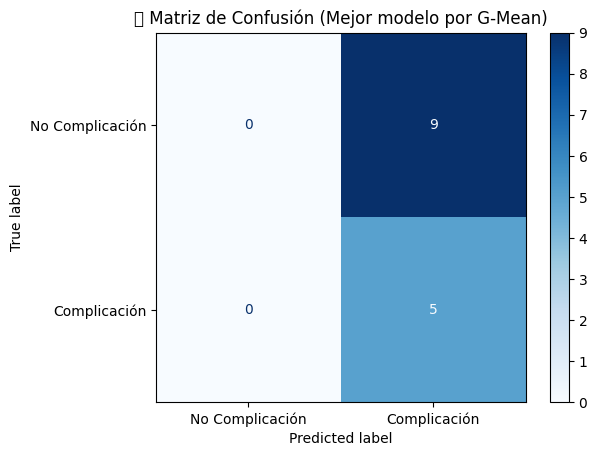


📌 Evaluación final:
   Accuracy: 0.3571
   F1 Score: 0.5263
   TPR: 1.0000
   TNR: 0.0000
   G-Mean: 0.0000

📊 Matriz de Confusión - Fold 1:


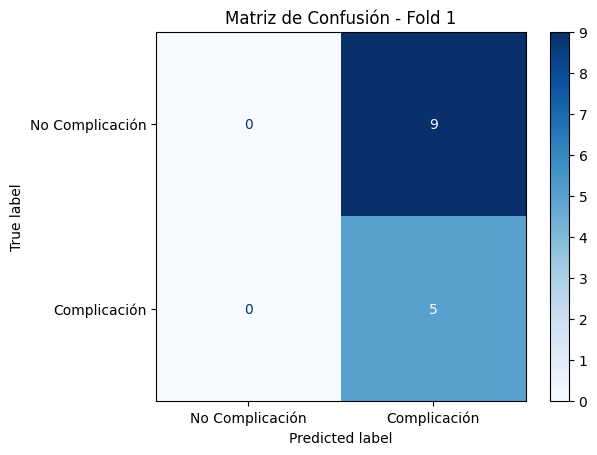


🔁 Fold 2/5

📘 Epoch 1/10


100%|██████████| 14/14 [00:31<00:00,  2.26s/it]

🔹 Entrenamiento — Loss: 9.9837 | Acc: 0.4464 | F1: 0.2439 | TPR: 0.2941 | TNR: 0.5128 | G-Mean: 0.3884


🔸 Validación   — Loss: 3.1784 | Acc: 0.2857 | F1: 0.4444 | TPR: 1.0000 | TNR: 0.0000 | G-Mean: 0.0000

📘 Epoch 2/10


100%|██████████| 14/14 [00:31<00:00,  2.27s/it]

🔹 Entrenamiento — Loss: 8.7101 | Acc: 0.6786 | F1: 0.0000 | TPR: 0.0000 | TNR: 0.9744 | G-Mean: 0.0000


🔸 Validación   — Loss: 2.7399 | Acc: 0.7143 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 3/10


100%|██████████| 14/14 [00:31<00:00,  2.26s/it]

🔹 Entrenamiento — Loss: 8.7493 | Acc: 0.6786 | F1: 0.0000 | TPR: 0.0000 | TNR: 0.9744 | G-Mean: 0.0000


🔸 Validación   — Loss: 2.5399 | Acc: 0.7143 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 4/10


100%|██████████| 14/14 [00:31<00:00,  2.28s/it]

🔹 Entrenamiento — Loss: 9.0711 | Acc: 0.6964 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000


🔸 Validación   — Loss: 2.4980 | Acc: 0.7143 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 5/10


100%|██████████| 14/14 [00:31<00:00,  2.26s/it]

🔹 Entrenamiento — Loss: 8.5665 | Acc: 0.6786 | F1: 0.0000 | TPR: 0.0000 | TNR: 0.9744 | G-Mean: 0.0000


🔸 Validación   — Loss: 2.5115 | Acc: 0.7143 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 6/10


100%|██████████| 14/14 [00:31<00:00,  2.27s/it]

🔹 Entrenamiento — Loss: 8.8011 | Acc: 0.6964 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000


🔸 Validación   — Loss: 2.5948 | Acc: 0.7143 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 7/10


100%|██████████| 14/14 [00:31<00:00,  2.27s/it]

🔹 Entrenamiento — Loss: 9.4998 | Acc: 0.6964 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000


🔸 Validación   — Loss: 2.5651 | Acc: 0.7143 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 8/10


100%|██████████| 14/14 [00:31<00:00,  2.27s/it]

🔹 Entrenamiento — Loss: 8.9309 | Acc: 0.6964 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000


🔸 Validación   — Loss: 2.5209 | Acc: 0.7143 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 9/10


100%|██████████| 14/14 [00:31<00:00,  2.27s/it]

🔹 Entrenamiento — Loss: 8.7471 | Acc: 0.6786 | F1: 0.0000 | TPR: 0.0000 | TNR: 0.9744 | G-Mean: 0.0000


🔸 Validación   — Loss: 2.5314 | Acc: 0.7143 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 10/10


100%|██████████| 14/14 [00:31<00:00,  2.27s/it]

🔹 Entrenamiento — Loss: 8.6553 | Acc: 0.6786 | F1: 0.0000 | TPR: 0.0000 | TNR: 0.9744 | G-Mean: 0.0000


🔸 Validación   — Loss: 2.5711 | Acc: 0.7143 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📥 Cargado mejor modelo desde 'modelo_fold_fold2.pth'


You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
Glyph 128202 (\N{BAR CHART}) missing from font(s) DejaVu Sans.


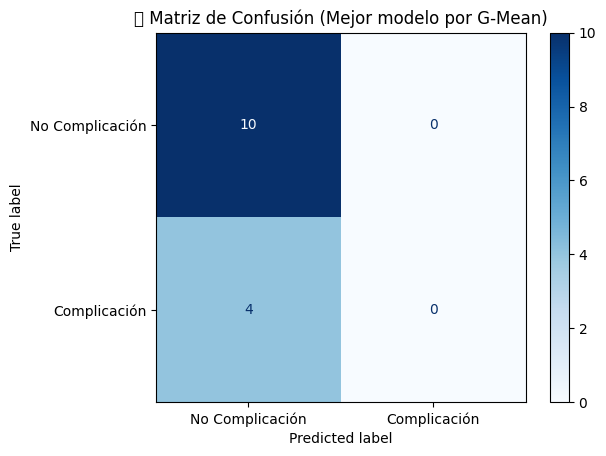


📌 Evaluación final:
   Accuracy: 0.7143
   F1 Score: 0.0000
   TPR: 0.0000
   TNR: 1.0000
   G-Mean: 0.0000

📊 Matriz de Confusión - Fold 2:


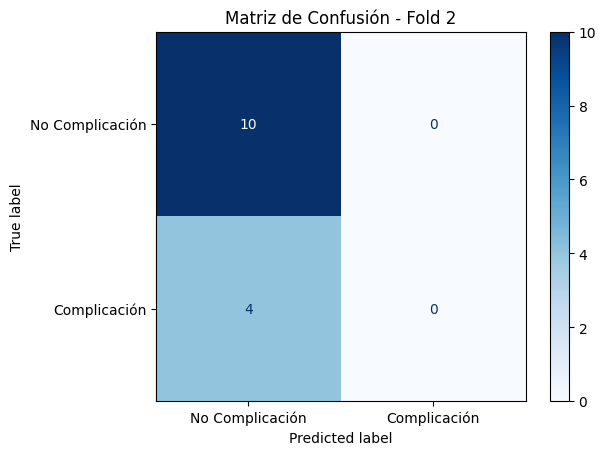


🔁 Fold 3/5

📘 Epoch 1/10


100%|██████████| 14/14 [00:31<00:00,  2.27s/it]

🔹 Entrenamiento — Loss: 8.7366 | Acc: 0.6964 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000


🔸 Validación   — Loss: 2.5173 | Acc: 0.7143 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 2/10


100%|██████████| 14/14 [00:31<00:00,  2.27s/it]

🔹 Entrenamiento — Loss: 8.7824 | Acc: 0.6964 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000


🔸 Validación   — Loss: 2.6453 | Acc: 0.7143 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 3/10


100%|██████████| 14/14 [00:31<00:00,  2.27s/it]

🔹 Entrenamiento — Loss: 8.4203 | Acc: 0.6964 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000


🔸 Validación   — Loss: 2.5730 | Acc: 0.7143 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 4/10


100%|██████████| 14/14 [00:31<00:00,  2.27s/it]

🔹 Entrenamiento — Loss: 9.2044 | Acc: 0.6964 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000


🔸 Validación   — Loss: 2.5830 | Acc: 0.7143 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 5/10


100%|██████████| 14/14 [00:31<00:00,  2.26s/it]

🔹 Entrenamiento — Loss: 9.0017 | Acc: 0.6786 | F1: 0.0000 | TPR: 0.0000 | TNR: 0.9744 | G-Mean: 0.0000


🔸 Validación   — Loss: 2.6060 | Acc: 0.7143 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 6/10


100%|██████████| 14/14 [00:31<00:00,  2.28s/it]

🔹 Entrenamiento — Loss: 8.8831 | Acc: 0.6964 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000


🔸 Validación   — Loss: 2.6073 | Acc: 0.7143 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 7/10


100%|██████████| 14/14 [00:31<00:00,  2.27s/it]

🔹 Entrenamiento — Loss: 9.0259 | Acc: 0.6786 | F1: 0.0000 | TPR: 0.0000 | TNR: 0.9744 | G-Mean: 0.0000


🔸 Validación   — Loss: 2.8036 | Acc: 0.2857 | F1: 0.4444 | TPR: 1.0000 | TNR: 0.0000 | G-Mean: 0.0000

📘 Epoch 8/10


100%|██████████| 14/14 [00:31<00:00,  2.27s/it]

🔹 Entrenamiento — Loss: 8.9217 | Acc: 0.6964 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000


🔸 Validación   — Loss: 2.5831 | Acc: 0.7143 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 9/10


100%|██████████| 14/14 [00:31<00:00,  2.28s/it]

🔹 Entrenamiento — Loss: 9.4592 | Acc: 0.6429 | F1: 0.0000 | TPR: 0.0000 | TNR: 0.9231 | G-Mean: 0.0000


🔸 Validación   — Loss: 2.6070 | Acc: 0.7143 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 10/10


100%|██████████| 14/14 [00:31<00:00,  2.26s/it]

🔹 Entrenamiento — Loss: 9.1436 | Acc: 0.6964 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000


🔸 Validación   — Loss: 2.5131 | Acc: 0.7143 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000


You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.



📥 Cargado mejor modelo desde 'modelo_fold_fold3.pth'


Glyph 128202 (\N{BAR CHART}) missing from font(s) DejaVu Sans.


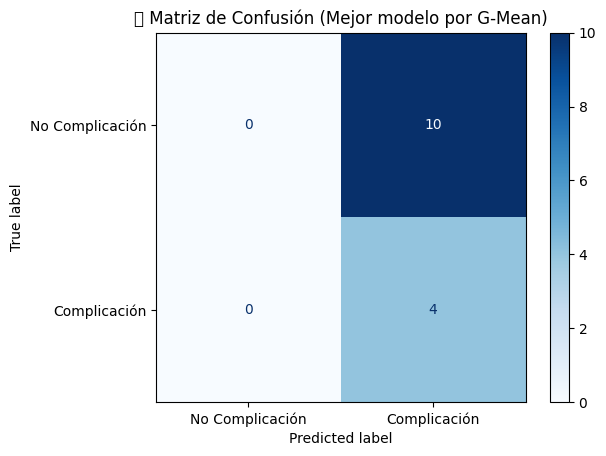


📌 Evaluación final:
   Accuracy: 0.2857
   F1 Score: 0.4444
   TPR: 1.0000
   TNR: 0.0000
   G-Mean: 0.0000

📊 Matriz de Confusión - Fold 3:


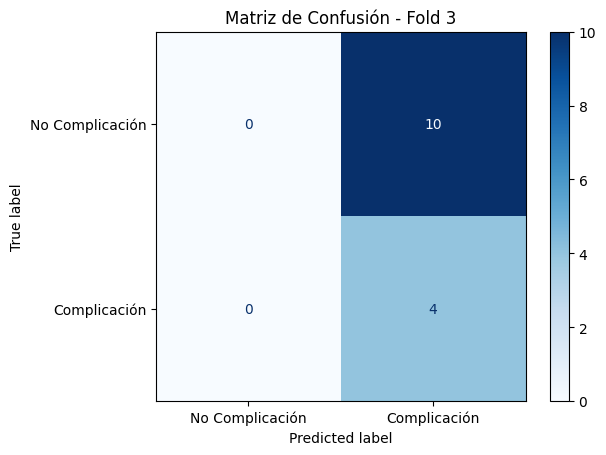


🔁 Fold 4/5

📘 Epoch 1/10


100%|██████████| 14/14 [00:31<00:00,  2.26s/it]

🔹 Entrenamiento — Loss: 8.8092 | Acc: 0.6964 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000


🔸 Validación   — Loss: 2.5990 | Acc: 0.7143 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 2/10


100%|██████████| 14/14 [00:31<00:00,  2.27s/it]

🔹 Entrenamiento — Loss: 8.4284 | Acc: 0.6964 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000


🔸 Validación   — Loss: 2.5739 | Acc: 0.7143 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 3/10


100%|██████████| 14/14 [00:31<00:00,  2.27s/it]

🔹 Entrenamiento — Loss: 9.0435 | Acc: 0.6964 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000


🔸 Validación   — Loss: 2.7360 | Acc: 0.7143 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 4/10


100%|██████████| 14/14 [00:31<00:00,  2.26s/it]

🔹 Entrenamiento — Loss: 9.0503 | Acc: 0.6964 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000


🔸 Validación   — Loss: 2.6142 | Acc: 0.7143 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 5/10


100%|██████████| 14/14 [00:31<00:00,  2.26s/it]

🔹 Entrenamiento — Loss: 8.6851 | Acc: 0.6786 | F1: 0.0000 | TPR: 0.0000 | TNR: 0.9744 | G-Mean: 0.0000


🔸 Validación   — Loss: 2.4951 | Acc: 0.7143 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 6/10


100%|██████████| 14/14 [00:31<00:00,  2.28s/it]

🔹 Entrenamiento — Loss: 8.7841 | Acc: 0.6964 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000


🔸 Validación   — Loss: 2.5122 | Acc: 0.7143 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 7/10


100%|██████████| 14/14 [00:31<00:00,  2.27s/it]

🔹 Entrenamiento — Loss: 9.0932 | Acc: 0.6607 | F1: 0.0000 | TPR: 0.0000 | TNR: 0.9487 | G-Mean: 0.0000


🔸 Validación   — Loss: 2.5711 | Acc: 0.7143 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 8/10


100%|██████████| 14/14 [00:31<00:00,  2.27s/it]

🔹 Entrenamiento — Loss: 9.0412 | Acc: 0.6964 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000


🔸 Validación   — Loss: 2.5315 | Acc: 0.7143 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 9/10


100%|██████████| 14/14 [00:31<00:00,  2.27s/it]

🔹 Entrenamiento — Loss: 8.9528 | Acc: 0.6964 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000


🔸 Validación   — Loss: 2.5054 | Acc: 0.7143 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 10/10


100%|██████████| 14/14 [00:31<00:00,  2.27s/it]

🔹 Entrenamiento — Loss: 8.7951 | Acc: 0.6964 | F1: 0.1053 | TPR: 0.0588 | TNR: 0.9744 | G-Mean: 0.2394


🔸 Validación   — Loss: 2.4884 | Acc: 0.7143 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000


You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.



📥 Cargado mejor modelo desde 'modelo_fold_fold4.pth'


Glyph 128202 (\N{BAR CHART}) missing from font(s) DejaVu Sans.


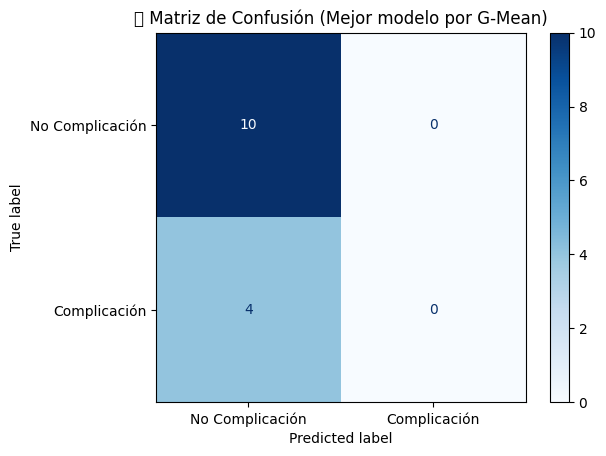


📌 Evaluación final:
   Accuracy: 0.7143
   F1 Score: 0.0000
   TPR: 0.0000
   TNR: 1.0000
   G-Mean: 0.0000

📊 Matriz de Confusión - Fold 4:


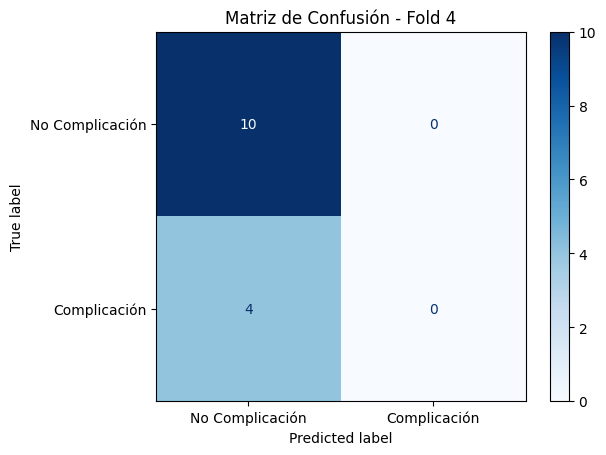


🔁 Fold 5/5

📘 Epoch 1/10


100%|██████████| 14/14 [00:31<00:00,  2.26s/it]

🔹 Entrenamiento — Loss: 9.1987 | Acc: 0.6250 | F1: 0.2759 | TPR: 0.2353 | TNR: 0.7949 | G-Mean: 0.4325


🔸 Validación   — Loss: 2.8100 | Acc: 0.2857 | F1: 0.4444 | TPR: 1.0000 | TNR: 0.0000 | G-Mean: 0.0000

📘 Epoch 2/10


100%|██████████| 14/14 [00:31<00:00,  2.27s/it]

🔹 Entrenamiento — Loss: 8.9050 | Acc: 0.6786 | F1: 0.0000 | TPR: 0.0000 | TNR: 0.9744 | G-Mean: 0.0000


🔸 Validación   — Loss: 2.6848 | Acc: 0.7143 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 3/10


100%|██████████| 14/14 [00:31<00:00,  2.27s/it]

🔹 Entrenamiento — Loss: 8.4595 | Acc: 0.6964 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000


🔸 Validación   — Loss: 2.6764 | Acc: 0.7143 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 4/10


100%|██████████| 14/14 [00:31<00:00,  2.26s/it]

🔹 Entrenamiento — Loss: 8.7601 | Acc: 0.6964 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000


🔸 Validación   — Loss: 2.6105 | Acc: 0.7143 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000

📘 Epoch 5/10


100%|██████████| 14/14 [00:31<00:00,  2.27s/it]

🔹 Entrenamiento — Loss: 8.7807 | Acc: 0.6964 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000


🔸 Validación   — Loss: 2.7989 | Acc: 0.2857 | F1: 0.4444 | TPR: 1.0000 | TNR: 0.0000 | G-Mean: 0.0000

📘 Epoch 6/10


100%|██████████| 14/14 [00:31<00:00,  2.27s/it]

🔹 Entrenamiento — Loss: 8.3970 | Acc: 0.6964 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000


🔸 Validación   — Loss: 3.3890 | Acc: 0.2857 | F1: 0.4444 | TPR: 1.0000 | TNR: 0.0000 | G-Mean: 0.0000

📘 Epoch 7/10


100%|██████████| 14/14 [00:31<00:00,  2.26s/it]

🔹 Entrenamiento — Loss: 8.9473 | Acc: 0.6607 | F1: 0.0000 | TPR: 0.0000 | TNR: 0.9487 | G-Mean: 0.0000


🔸 Validación   — Loss: 3.1443 | Acc: 0.2857 | F1: 0.4444 | TPR: 1.0000 | TNR: 0.0000 | G-Mean: 0.0000

📘 Epoch 8/10


100%|██████████| 14/14 [00:31<00:00,  2.27s/it]

🔹 Entrenamiento — Loss: 8.8162 | Acc: 0.6964 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000


🔸 Validación   — Loss: 2.8741 | Acc: 0.2857 | F1: 0.4444 | TPR: 1.0000 | TNR: 0.0000 | G-Mean: 0.0000

📘 Epoch 9/10


100%|██████████| 14/14 [00:31<00:00,  2.27s/it]

🔹 Entrenamiento — Loss: 8.8418 | Acc: 0.6964 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000


🔸 Validación   — Loss: 2.8366 | Acc: 0.2857 | F1: 0.4444 | TPR: 1.0000 | TNR: 0.0000 | G-Mean: 0.0000

📘 Epoch 10/10


100%|██████████| 14/14 [00:31<00:00,  2.26s/it]

🔹 Entrenamiento — Loss: 8.8140 | Acc: 0.6786 | F1: 0.0000 | TPR: 0.0000 | TNR: 0.9744 | G-Mean: 0.0000


🔸 Validación   — Loss: 2.6743 | Acc: 0.7143 | F1: 0.0000 | TPR: 0.0000 | TNR: 1.0000 | G-Mean: 0.0000


You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.



📥 Cargado mejor modelo desde 'modelo_fold_fold5.pth'


Glyph 128202 (\N{BAR CHART}) missing from font(s) DejaVu Sans.


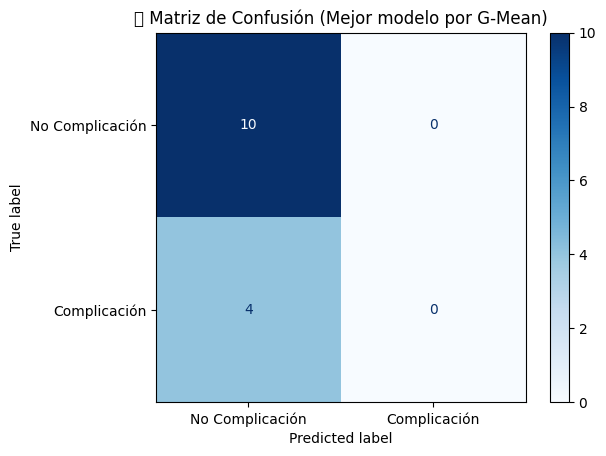


📌 Evaluación final:
   Accuracy: 0.7143
   F1 Score: 0.0000
   TPR: 0.0000
   TNR: 1.0000
   G-Mean: 0.0000

📊 Matriz de Confusión - Fold 5:


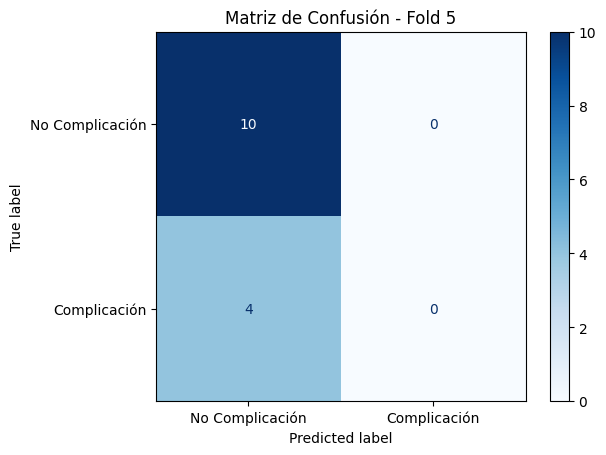


📊 Matriz de Confusión Acumulada:


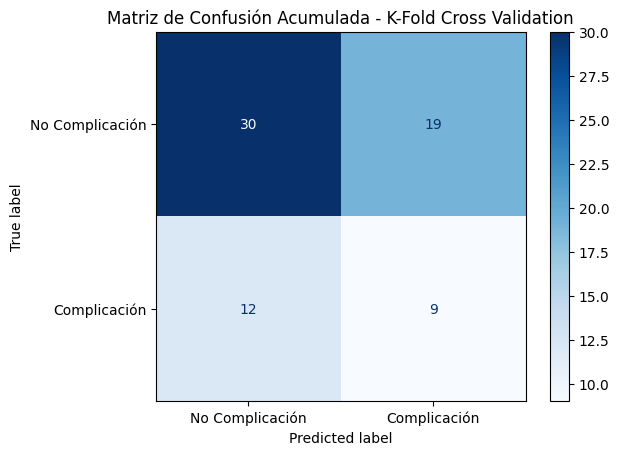

In [114]:
cross_validate(build_model, dataset, k=5, device=device, epochs=10)

Aumento de datos de la clase minoritaria

In [ ]:
from monai.transforms import (
    RandFlipd, RandRotate90d, RandZoomd, Compose, EnsureType
)

transform = Compose([
    EnsureType(),
    RandFlipd(keys=["image"], prob=0.5, spatial_axis=0),
    RandRotate90d(keys=["image"], prob=0.5, max_k=2),
    RandZoomd(keys=["image"], prob=0.5, min_zoom=0.9, max_zoom=1.1)
])

In [ ]:
def build_model():
    return DenseNet121(spatial_dims=3, in_channels=1, out_channels=2, dropout_prob=0.4)

In [ ]:
cross_validate(build_model, dataset, k=5, device=device, epochs=10)

## Método clásico Aprendizaje automático

Leyendo el TFG de Germán me he dado cuenta que los principales riesgos de tener una complicación es HTA (hipertension arterial) y enfisema. Entonces voy a probar solo con los datos clínicos a hacer un random forest y ver como clasifica de bien o de mal 

In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt
import seaborn as sns

datos_filtrados = pd.read_csv("./datos_filtrados.csv", na_values="NaN", sep = ",") # Definimos na_values para identificar bien los valores perdidos
df = pd.read_csv(datos_filtrados)

In [ ]:
# Variable objetivo: binaria (1 = Sí, 0 = No)
df["Complicación"] = df["Complicación"].map({"Sí": 1, "No": 0})

Vamos a quedarnos solo con las dos variables

In [ ]:
# Variables binarias a partir de textos
df["HTA"] = df["Factor_riesgo"].str.contains("HTA", case=False, na=False).astype(int)
df["Enfisema"] = df["Patología pulmonar"].str.contains("Enfisema", case=False, na=False).astype(int)

In [ ]:
# Codificar variables categóricas
label_cols = ["Sexo", "Tipo_cáncer", "TC"]
for col in label_cols:
    df[col] = LabelEncoder().fit_transform(df[col])

In [ ]:
# Columnas seleccionadas para entrenamiento
features = ["Edad", "Sexo", "Tipo_cáncer", "HTA", "Enfisema"]
X = df[features]
y = df["Complicación"]

In [ ]:
# Escalar las variables numéricas
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(
    X_scaled, y, test_size=0.3, stratify=y, random_state=42
)


In [ ]:
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)
y_pred = model.predict(X_test)

In [ ]:
print("\n Reporte de clasificación:")
print(classification_report(y_test, y_pred, target_names=["Sin complicación", "Con complicación"]))

cm = confusion_matrix(y_test, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=["Sin complicación", "Con complicación"])
disp.plot(cmap="Blues")
plt.title("Matriz de Confusión")
plt.show()


In [ ]:
importances = pd.DataFrame({
    "Característica": features,
    "Importancia": model.feature_importances_
}).sort_values(by="Importancia", ascending=False)

sns.barplot(data=importances, x="Importancia", y="Característica")
plt.title("Importancia de Características (Random Forest)")
plt.show()

## GAN

In [ ]:
import os
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader, Subset
from monai.transforms import Compose, EnsureType
from sklearn.model_selection import StratifiedShuffleSplit
from tqdm import tqdm

print(" Iniciando el script de GAN para imágenes de TC de pulmón...")

In [ ]:
# Dataset
class LungCTDataset(Dataset):
    def __init__(self, data_dir, mask_dir, labels_dict, transform=None):
        self.data_dir = data_dir
        self.mask_dir = mask_dir
        self.patients = list(labels_dict.keys())
        self.labels = labels_dict
        self.transform = transform

    def __len__(self):
        return len(self.patients)

    def __getitem__(self, idx):
        patient_id = self.patients[idx]
        volume_path = os.path.join(self.data_dir, f"{patient_id}.npy")
        mask_path = os.path.join(self.mask_dir, f"{patient_id}.npy")

        if not os.path.exists(volume_path):
            raise FileNotFoundError(f" Archivo de volumen no encontrado: {volume_path}")

        volume = np.load(volume_path)

        if os.path.exists(mask_path):
            mask = np.load(mask_path).astype(bool)
            volume = volume * mask
        else:
            print(f" Máscara no encontrada para {patient_id}, se usa el volumen completo.")

        volume = np.expand_dims(volume, axis=0)  # (C, D, H, W)
        if self.transform:
            volume = self.transform(volume)
        return volume, torch.tensor(self.labels[patient_id], dtype=torch.long)


# Generator and Discriminator
class Generator3D(nn.Module):
    def __init__(self, z_dim=100, out_channels=1):
        super().__init__()
        self.net = nn.Sequential(
            nn.ConvTranspose3d(z_dim, 128, 4, 1, 0),
            nn.BatchNorm3d(128),
            nn.ReLU(True),
            nn.ConvTranspose3d(128, 64, 4, 2, 1),
            nn.BatchNorm3d(64),
            nn.ReLU(True),
            nn.ConvTranspose3d(64, 32, 4, 2, 1),
            nn.BatchNorm3d(32),
            nn.ReLU(True),
            nn.ConvTranspose3d(32, out_channels, 4, 2, 1),
            nn.Tanh()
        )

    def forward(self, z):
        return self.net(z)

class Discriminator3D(nn.Module):
    def __init__(self, in_channels=1):
        super().__init__()
        self.net = nn.Sequential(
            nn.Conv3d(in_channels, 32, 4, 2, 1),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv3d(32, 64, 4, 2, 1),
            nn.BatchNorm3d(64),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv3d(64, 128, 4, 2, 1),
            nn.BatchNorm3d(128),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv3d(128, 1, 4, 1, 0),
            nn.Sigmoid()
        )

    def forward(self, x):
        return self.net(x)


# GAN Training
def train_gan(generator, discriminator, data_loader, device, epochs=50, z_dim=100):
    print(" Comenzando el entrenamiento de la GAN...")
    criterion = nn.BCELoss()
    optimizer_G = optim.Adam(generator.parameters(), lr=1e-4)
    optimizer_D = optim.Adam(discriminator.parameters(), lr=1e-4)

    generator.train()
    discriminator.train()

    for epoch in range(epochs):
        print(f"\n Epoch {epoch+1}/{epochs}...")
        pbar = tqdm(data_loader, desc=f"Epoch {epoch+1}", leave=True)
        for step, (real_data, labels) in enumerate(pbar):
            if not torch.any(labels == 1):
                pbar.set_postfix_str(" Sin complicaciones")
                continue

            real_data = real_data[labels == 1].to(device)
            batch_size = real_data.size(0)
            pbar.set_postfix_str(f" Batch con {batch_size} complicaciones")

            real_labels = torch.ones(batch_size, 1, 1, 1, 1, device=device)
            fake_labels = torch.zeros(batch_size, 1, 1, 1, 1, device=device)

            z = torch.randn(batch_size, z_dim, 1, 1, 1, device=device)
            fake_data = generator(z)

            real_output = discriminator(real_data)
            fake_output = discriminator(fake_data.detach())
            d_loss = criterion(real_output, real_labels) + criterion(fake_output, fake_labels)

            optimizer_D.zero_grad()
            d_loss.backward()
            optimizer_D.step()

            fake_output = discriminator(fake_data)
            g_loss = criterion(fake_output, real_labels)

            optimizer_G.zero_grad()
            g_loss.backward()
            optimizer_G.step()

        print(f" Epoch {epoch+1}/{epochs} completado | D Loss: {d_loss.item():.4f} | G Loss: {g_loss.item():.4f}")


# Generate Synthetic Samples
def generate_synthetic_samples(generator, n_samples=10, z_dim=100, device="cuda"):
    print(f"\n Generando {n_samples} muestras sintéticas...")
    os.makedirs("synthetic", exist_ok=True)
    generator.eval()
    with torch.no_grad():
        z = torch.randn(n_samples, z_dim, 1, 1, 1).to(device)
        generated = generator(z).cpu().numpy()
        for i, sample in enumerate(tqdm(generated, desc="Guardando volúmenes sintéticos")):
            np.save(f"synthetic/complication_{i}.npy", sample[0])

# uso
if __name__ == "__main__":
    print(" Script iniciado")
    device = "cuda" if torch.cuda.is_available() else "cpu"
    print(f"💻 Usando dispositivo: {device}")
    data_dir = "preprocesamientos2/resize_small_separadas/npy/images"
    mask_dir = "preprocesamientos2/resize_small_separadas/npy/masks"

    import pandas as pd
    print(" Leyendo archivo CSV de etiquetas...")
    df = pd.read_csv("./datos_clinicos/datos_filtrados.csv")
    labels_dict = {k: 1 if str(v).lower() in ["sí", "si", "yes", "1", "true"] else 0 for k, v in zip(df.Id_paciente, df.Complicación)}
    transform = Compose([EnsureType()])

    print(" Cargando dataset...")
    dataset = LungCTDataset(data_dir, mask_dir, labels_dict, transform=transform)
    labels = [dataset.labels[pid] for pid in dataset.patients]

    print(f" Dataset total: {len(dataset)} pacientes")
    print(f" Distribución etiquetas: {dict(pd.Series(labels).value_counts())}")

    sss = StratifiedShuffleSplit(n_splits=1, test_size=0.1, random_state=42)
    train_idx, _ = next(sss.split(dataset.patients, labels))

    # Solo pacientes con complicación
    train_idx = [i for i in train_idx if dataset[i][1] == 1]
    print(f" Pacientes con complicación en train: {len(train_idx)}")

    train_dataset = Subset(dataset, train_idx)
    train_loader = DataLoader(train_dataset, batch_size=4, shuffle=True, num_workers=2)

    print(" Iniciando entrenamiento del GAN...")
    generator = Generator3D().to(device)
    discriminator = Discriminator3D().to(device)

    train_gan(generator, discriminator, train_loader, device, epochs=30)
    generate_synthetic_samples(generator, n_samples=10, device=device)